# Models
- Three models:
    - A: vs_decision_model (doctor current decision-making): After seeing the vitalsign from the past n hours to the present, how should the doctor set the ventilator settings to ensure the final success of weaning?
        - input: baseline + current vitalsign + previous n hr vitalsign (e.g., n=1) + previous ventilator settings
		- output: current ventilator settings
		- cohort: only use label = 1 stay_id for training
    - B: vs_affect_model
        - input: baseline + current vitalsign + previous n hr vitalsign + current ventilator settings + previous n hr ventilator settings
		- output: next 1 hr vitalsign
		- cohort: all
    - C: weaning_prediction_model
        - input: 24 rows flatten into 1 row
		- output: weaning label 0 / 1
		- cohort: all

## Model A: vs_decision_model

- steps:
    - Generate new columns
        - create_change_label: change or not between 1hr on the ventilator_settings
        - create_change_value: change value
        - create_change_label_value_aug: back fill aug_prev_n_hr as create_change_label_aug and create_change_value_aug
    - Statistics:
        - number of change in ventilator_settings features
        - get possible values range (currently not use)
        - statistic on the change of ventilator_mode, and the relationship between other ventilator settings change
    - Preprocessing
        - Split dataset
        - Dealing with imbalance issue
    - Model
        - directly regression
        - first do classification, then regression
    - Training
    - Visualization
    - Evaluation
    - Inference

### import package

In [327]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor, XGBClassifier
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns  # for enhanced plotting styles (optional)
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, mean_squared_error
from sklearn.neural_network import MLPClassifier, MLPRegressor
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, f1_score
from sklearn.metrics import roc_curve, auc

pd.set_option('display.max_columns', None)
pd.options.mode.chained_assignment = None  # default='warn'

### Read in data

In [401]:
pre_24_merged_30_rows_df = pd.read_csv("data/data_by_table/pre_24_merged_30_rows_12_07.csv")
group_pre_1hr_visi_vese_positive_train_df = pd.read_csv("data/model_data/group_pre_1hr_visi_vese_positive_train.csv")
group_pre_1hr_visi_vese_negative_train_df = pd.read_csv("data/model_data/group_pre_1hr_visi_vese_negative_train.csv")
group_pre_1hr_visi_vese_positive_val_df = pd.read_csv("data/model_data/group_pre_1hr_visi_vese_positive_val.csv")
group_pre_1hr_visi_vese_negative_val_df = pd.read_csv("data/model_data/group_pre_1hr_visi_vese_negative_val.csv")
group_pre_1hr_visi_vese_positive_test_df = pd.read_csv("data/model_data/group_pre_1hr_visi_vese_positive_test.csv")
group_pre_1hr_visi_vese_negative_test_df = pd.read_csv("data/model_data/group_pre_1hr_visi_vese_negative_test.csv")
group_pre_1hr_visi_vese_positive_train_df

,subject_id,stay_id,hadm_id,charttime,before_weaning_hr,label,age_now,gender,insurance,race,first_careunit,admission_type,weight_kg,height_cm,tobacco,heart_rate,sbp,dbp,mbp,spo2,resp_rate,tidal_volume_observed,RSBI,minute_ventilation,peep,fio2,respiratory_rate_set,plateau_pressure,ventilator_mode,ventilator_mode_group,heart_rate_prev_1h,sbp_prev_1h,dbp_prev_1h,mbp_prev_1h,spo2_prev_1h,resp_rate_prev_1h,tidal_volume_observed_prev_1h,RSBI_prev_1h,minute_ventilation_prev_1h,peep_prev_1h,fio2_prev_1h,respiratory_rate_set_prev_1h,plateau_pressure_prev_1h,ventilator_mode_prev_1h,ventilator_mode_group_prev_1h
0,14569364,30005707,20870580,2144-01-11 21:00:00,22.0,1,83,M,Medicare,WHITE,Surgical Intensive Care Unit (SICU),EW EMER.,72.0,169.333333,0,73.0,112.0,41.0,67.0,95.0,17.0,530.0,32.075472,9.010,5.0,40.0,10.0,17.0,MMV/PSV/AutoFlow,Complete Support,67.0,115.0,54.0,74.0,94.0,11.0,530.0,20.754717,5.830,5.0,40.0,10.0,17.0,MMV/PSV/AutoFlow,Complete Support
1,14569364,30005707,20870580,2144-01-11 22:00:00,21.0,1,83,M,Medicare,WHITE,Surgical Intensive Care Unit (SICU),EW EMER.,72.0,169.333333,0,72.0,117.0,51.0,72.0,96.0,15.0,530.0,28.301887,7.950,5.0,40.0,10.0,17.0,MMV/PSV/AutoFlow,Complete Support,73.0,112.0,41.0,67.0,95.0,17.0,530.0,32.075472,9.010,5.0,40.0,10.0,17.0,MMV/PSV/AutoFlow,Complete Support
2,14569364,30005707,20870580,2144-01-11 23:00:00,20.0,1,83,M,Medicare,WHITE,Surgical Intensive Care Unit (SICU),EW EMER.,72.0,169.333333,0,73.0,123.0,50.0,74.0,95.0,15.0,530.0,28.301887,7.950,5.0,40.0,10.0,17.0,MMV/PSV/AutoFlow,Complete Support,72.0,117.0,51.0,72.0,96.0,15.0,530.0,28.301887,7.950,5.0,40.0,10.0,17.0,MMV/PSV/AutoFlow,Complete Support
3,14569364,30005707,20870580,2144-01-12 00:00:00,19.0,1,83,M,Medicare,WHITE,Surgical Intensive Care Unit (SICU),EW EMER.,72.0,169.333333,0,72.0,133.0,57.0,83.0,97.0,17.0,498.0,34.136546,8.466,5.0,40.0,10.0,11.0,MMV/PSV/AutoFlow,Complete Support,73.0,123.0,50.0,74.0,95.0,15.0,530.0,28.301887,7.950,5.0,40.0,10.0,17.0,MMV/PSV/AutoFlow,Complete Support
4,14569364,30005707,20870580,2144-01-12 01:00:00,18.0,1,83,M,Medicare,WHITE,Surgical Intensive Care Unit (SICU),EW EMER.,72.0,169.333333,0,63.0,115.0,48.0,71.0,96.0,14.0,498.0,28.112450,6.972,5.0,40.0,10.0,11.0,MMV/PSV/AutoFlow,Complete Support,72.0,133.0,57.0,83.0,97.0,17.0,498.0,34.136546,8.466,5.0,40.0,10.0,11.0,MMV/PSV/AutoFlow,Complete Support
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27181,10128085,39990093,27136294,2145-08-15 04:00:00,4.0,1,54,M,Other,WHITE,Cardiac Vascular Intensive Care Unit (CVICU),SURGICAL SAME DAY ADMISSION,134.1,185.000000,1,85.0,94.0,56.0,69.0,98.0,15.0,591.0,25.380711,8.865,5.0,40.0,0.0,24.0,CPAP/PSV,Minimal Support,91.0,115.0,67.0,82.0,97.0,25.0,591.0,42.301184,14.775,5.0,40.0,0.0,24.0,CPAP/PSV,Minimal Support
27182,10128085,39990093,27136294,2145-08-15 05:00:00,3.0,1,54,M,Other,WHITE,Cardiac Vascular Intensive Care Unit (CVICU),SURGICAL SAME DAY ADMISSION,134.1,185.000000,1,84.0,103.0,60.0,74.0,99.0,16.0,620.0,25.806452,9.920,5.0,40.0,0.0,24.0,CPAP/PSV,Minimal Support,85.0,94.0,56.0,69.0,98.0,15.0,591.0,25.380711,8.865,5.0,40.0,0.0,24.0,CPAP/PSV,Minimal Support
27183,10128085,39990093,27136294,2145-08-15 06:00:00,2.0,1,54,M,Other,WHITE,Cardiac Vascular Intensive Care Unit (CVICU),SURGICAL SAME DAY ADMISSION,134.1,185.000000,1,89.0,121.0,69.0,85.0,97.0,24.0,620.0,38.709677,14.880,5.0,40.0,0.0,24.0,CPAP/PSV,Minimal Support,84.0,103.0,60.0,74.0,99.0,16.0,620.0,25.806452,9.920,5.0,40.0,0.0,24.0,CPAP/PSV,Minimal Support
27184,10128085,39990093,27136294,2145-08-15 07:00:00,1.0,1,54,M,Other,WHITE,Cardiac Vascular Intensive Care Unit (CVICU),SURGICAL SAME DAY ADMISSION,134.1,185.000000,1,103.0,125.0,69.0,86.0,98.0,25.0,620.0,40.322581,15.500,5.0,40.0,0.0,24.0,CPAP/PSV,Minimal Support,89.0,121.0,69.0,85.0,97.0,24.0,620.0,38.709677,14.880,5.0,40.0,0.0,24.0,CPAP/PSV,Minimal Support


In [578]:
print(f'positive_train:\t{len(group_pre_1hr_visi_vese_positive_train_df)}')
print(f'positive_val:\t{len(group_pre_1hr_visi_vese_positive_val_df)}')
print(f'positive_test:\t{len(group_pre_1hr_visi_vese_positive_test_df)}')
print(f'negative_train:\t{len(group_pre_1hr_visi_vese_negative_train_df)}')
print(f'negative_val:\t{len(group_pre_1hr_visi_vese_negative_val_df)}')
print(f'negative_test:\t{len(group_pre_1hr_visi_vese_negative_test_df)}')

whole_train = (len(group_pre_1hr_visi_vese_positive_train_df) + len(group_pre_1hr_visi_vese_negative_train_df))
whole_val = (len(group_pre_1hr_visi_vese_positive_val_df) + len(group_pre_1hr_visi_vese_negative_val_df))
whole_test = (len(group_pre_1hr_visi_vese_positive_test_df) + len(group_pre_1hr_visi_vese_negative_test_df))
whole_num = whole_train + whole_val + whole_test
print(f"train:val:test = {round(whole_train*100/whole_num)}:{round(whole_val*100/whole_num)}:{round(whole_test*100/whole_num)}")
positive_num = len(group_pre_1hr_visi_vese_positive_train_df) + len(group_pre_1hr_visi_vese_positive_val_df) + len(group_pre_1hr_visi_vese_positive_test_df)
negative_num = len(group_pre_1hr_visi_vese_negative_train_df) + len(group_pre_1hr_visi_vese_negative_val_df) + len(group_pre_1hr_visi_vese_negative_test_df)
print(f"positive:negative = {round(positive_num*100/whole_num)}:{round(negative_num*100/whole_num)}")

positive_train:	27186
positive_val:	4002
positive_test:	7728
negative_train:	15594
negative_val:	2300
negative_test:	4439
train:val:test = 70:10:20
positive:negative = 64:36


In [583]:
print(f'positive_train:\t{len(group_pre_1hr_visi_vese_positive_train_df)/23}')
print(f'positive_val:\t{len(group_pre_1hr_visi_vese_positive_val_df)/23}')
print(f'positive_test:\t{len(group_pre_1hr_visi_vese_positive_test_df)/23}')
print(f'negative_train:\t{len(group_pre_1hr_visi_vese_negative_train_df)/23}')
print(f'negative_val:\t{len(group_pre_1hr_visi_vese_negative_val_df)/23}')
print(f'negative_test:\t{len(group_pre_1hr_visi_vese_negative_test_df)/23}')

whole_train = (len(group_pre_1hr_visi_vese_positive_train_df) + len(group_pre_1hr_visi_vese_negative_train_df))
whole_val = (len(group_pre_1hr_visi_vese_positive_val_df) + len(group_pre_1hr_visi_vese_negative_val_df))
whole_test = (len(group_pre_1hr_visi_vese_positive_test_df) + len(group_pre_1hr_visi_vese_negative_test_df))
whole_num = whole_train + whole_val + whole_test
print(f"train:val:test = {round(whole_train*100/whole_num)}:{round(whole_val*100/whole_num)}:{round(whole_test*100/whole_num)}")
positive_num = len(group_pre_1hr_visi_vese_positive_train_df) + len(group_pre_1hr_visi_vese_positive_val_df) + len(group_pre_1hr_visi_vese_positive_test_df)
negative_num = len(group_pre_1hr_visi_vese_negative_train_df) + len(group_pre_1hr_visi_vese_negative_val_df) + len(group_pre_1hr_visi_vese_negative_test_df)
print(f"positive:negative = {round(positive_num*100/whole_num)}:{round(negative_num*100/whole_num)}")

positive_train:	1182.0
positive_val:	174.0
positive_test:	336.0
negative_train:	678.0
negative_val:	100.0
negative_test:	193.0
train:val:test = 70:10:20
positive:negative = 64:36


### Generate new columns

generate the change features, for function create_change_label(), is use for two steps model:

1. classification of the change ventilator settings or not: keep the same settings OR change
2. regression of those predict as change: if classify as chagne, then predict the change value

In [402]:
def create_percentage_change_features(df, features): # TODO: currently not use this function, it might not be useful
    # Define the previous hour columns
    prev_hour_columns = [f'{feature}_prev_1h' for feature in features]

    # Create new columns for percentage change
    for feature, prev_feature in zip(features, prev_hour_columns):
        new_column_name = f'{feature}_change_percent'
        df[new_column_name] = (df[feature] - df[prev_feature]) / df[prev_feature] * 100

    return df

def create_change_label(df, features):
    # Define the previous hour columns
    prev_hour_columns = [f'{feature}_prev_1h' for feature in features]

    # Create new columns for change label for each of the features
    for feature, prev_feature in zip(features, prev_hour_columns):
        new_column_name = f'{feature}_change_label'
        df[new_column_name] = np.where(df[feature] - df[prev_feature] == 0, 0, 1)

    return df

def create_change_value(df, features):
    # Define the previous hour columns
    prev_hour_columns = [f'{feature}_prev_1h' for feature in features]

    # Create new columns for change label for each of the features
    for feature, prev_feature in zip(features, prev_hour_columns):
        new_column_name = f'{feature}_change_value'
        df[new_column_name] = df[feature] - df[prev_feature]

    return df

def create_change_label_value_aug(df, features, aug_prev_n_hr):
    df = df.sort_values(['stay_id', 'before_weaning_hr'], ascending=[True, False]).reset_index(drop=True)

    for feature in features:
        # Create column names for the original and augmented change label and value
        change_label_col = f'{feature}_change_label'
        change_value_col = f'{feature}_change_value'
        change_label_aug_col = f'{feature}_change_label_aug'
        change_value_aug_col = f'{feature}_change_value_aug'

        df[change_label_aug_col] = df[change_label_col]
        df[change_value_aug_col] = df[change_value_col]
        
        # Identify rows where the original change label is 1
        change_rows = df[(df[change_label_col] == 1)]

        # Iterate over rows with original change label as 1
        for _, row in change_rows.iterrows():
            stay_id = row['stay_id']
            current_index = row.name

            # Backfill the augmented columns only for the specified number of previous hours
            for j in range(1, aug_prev_n_hr + 1):
                prev_row_index = current_index - j
                # Check if the previous row is within the same stay_id and has the same hour
                if prev_row_index >= 0 and df.at[prev_row_index, 'stay_id'] == stay_id:
                    # Check if the augmented label is already set to 1
                    if df.at[prev_row_index, change_label_aug_col] == 1:
                        break  # Break the loop if the condition is met
                    else:
                        df.at[prev_row_index, change_label_aug_col] = 1
                        df.at[prev_row_index, change_value_aug_col] = df.at[current_index, change_value_col]
                else:
                    break  # Break the loop if the condition is not met

    return df    

def generate_change_col(group_pre_1hr_visi_vese_df, features, aug_prev_n_hr=3):
    group_pre_1hr_visi_vese_change_label_df = create_change_label(group_pre_1hr_visi_vese_df, features)
    group_pre_1hr_visi_vese_change_label_value_df = create_change_value(group_pre_1hr_visi_vese_change_label_df, features)
    group_pre_1hr_visi_vese_change_label_value_aug_df = create_change_label_value_aug(group_pre_1hr_visi_vese_change_label_value_df, features, aug_prev_n_hr)
    return group_pre_1hr_visi_vese_change_label_value_aug_df

using aggregation for smooth the change of the features (mean of 6 hours).

In [403]:
def temporal_aggregation(df, time_span=3): # TODO: currently not use this function, it might not be useful, since for doctor making decision, more than 1 hour might change a lot
    # Convert 'charttime' to datetime
    df['charttime'] = pd.to_datetime(df['charttime'])

    # Create a new column for time spans
    df['time_span'] = df['charttime'].dt.floor(f'{time_span}H')

    # Specify columns to aggregate
    columns_to_aggregate = ['age_now', 'RSBI', 'minute_ventilation', 'peep', 'fio2',
                             'tidal_volume_observed', 'respiratory_rate_set', 'plateau_pressure',
                             'heart_rate', 'sbp', 'dbp', 'mbp', 'resp_rate', 'spo2']

    # Create a dictionary for aggregation functions
    aggregation_functions = {col: 'mean' for col in columns_to_aggregate}

    # Perform aggregation
    aggregated_df = df.groupby(['stay_id', 'time_span']).agg(aggregation_functions).reset_index()

    # Keep 'label' column as it is, assuming it does not change within each time span
    aggregated_df['label'] = df.groupby(['stay_id', 'time_span'])['label'].first().values

    # return aggregated_df.drop(columns=['charttime', 'before_weaning_hr', 'time_span'])
    return aggregated_df

# Apply temporal aggregation to your dataframe
time_aggregated_df = temporal_aggregation(pre_24_merged_30_rows_df, time_span=3)

Mainly, doctor can set the ventilator_settings, include 'peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure' ('ventilator_mode'and 'ventilator_mode_group')

In [404]:
ventilator_settings = ['peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure']
aug_prev_n_hr = 3
group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df = generate_change_col(group_pre_1hr_visi_vese_positive_train_df, ventilator_settings, aug_prev_n_hr) 
group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df = generate_change_col(group_pre_1hr_visi_vese_negative_train_df, ventilator_settings, aug_prev_n_hr)
group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df = generate_change_col(group_pre_1hr_visi_vese_positive_val_df, ventilator_settings, aug_prev_n_hr) 
group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df = generate_change_col(group_pre_1hr_visi_vese_negative_val_df, ventilator_settings, aug_prev_n_hr)
group_pre_1hr_visi_vese_change_label_value_aug_positive_test_df = generate_change_col(group_pre_1hr_visi_vese_positive_test_df, ventilator_settings, aug_prev_n_hr) 
group_pre_1hr_visi_vese_change_label_value_aug_negative_test_df = generate_change_col(group_pre_1hr_visi_vese_negative_test_df, ventilator_settings, aug_prev_n_hr)

### Statistics

take a look at the possible value of each of the features, for some as discrete, others are continuous

In [5]:
def get_possible_values(dataframe):
    possible_values = {}

    for column in dataframe.columns:
        values = dataframe[column].unique()
        if dataframe[column].dtype in ['int64', 'float64']:
            if len(values) < 100:
                # If the number of unique values is small, consider it discrete
                possible_values[column] = sorted(values)
            else:
                # If the number of unique values is large, consider it continuous and get the range
                min_val, max_val = dataframe[column].min(), dataframe[column].max()
                possible_values[column] = (min_val, max_val)
        # else:
            # possible_values[column] = sorted(values)

    return possible_values

# Example usage
possible_values = get_possible_values(pre_24_merged_30_rows_df)
print(possible_values)

{'subject_id': (10003400, 19999840), 'stay_id': (30005707, 39995735), 'hadm_id': (20001361, 29999098), 'before_weaning_hr': [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21.0, 22.0, 23.0], 'age_now': [21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 98], 'weight_kg': (1.0, 188.0), 'height_cm': (118.0, 199.0), 'tobacco': [0, 1], 'RSBI': (1.8975332068311197, 26000.0), 'minute_ventilation': (0.0, 36.989), 'peep': (0.0, 20.0), 'fio2': [21.0, 24.0, 25.0, 28.0, 30.0, 31.0, 32.0, 35.0, 36.0, 40.0, 45.0, 50.0, 55.0, 60.0, 65.0, 70.0, 75.0, 80.0, 90.0, 95.0, 96.0, 98.0, 100.0], 'tidal_volume_observed': (0.0, 1240.0), 'respiratory_rate_set': [0.0, 4.0, 5.0, 6.0, 7.0, 8.0, 8.5, 9.

Statistics on the change of the ventilatior settings: we can observe that most of the time (more than 94%) will keep the same as previous hr

In [405]:
def count_feature_change(df, feature, prev_feature):
    # Counters for increase, decrease, and same
    increase_count = 0
    decrease_count = 0
    same_count = 0

    # Iterate through rows
    for index, row in df.iterrows():
        current_val = row[feature]
        prev_val = row[prev_feature]

        # Compare values
        if current_val > prev_val:
            increase_count += 1
        elif current_val < prev_val:
            decrease_count += 1
        else:
            same_count += 1

    # Calculate ratios
    total_rows = len(df)
    increase_ratio = round(increase_count / total_rows, 2)
    decrease_ratio = round(decrease_count / total_rows, 2)
    same_ratio = round(same_count / total_rows, 2)
    print(f"increase: {increase_ratio}, decrease: {decrease_ratio}, same: {same_ratio}")
    print(f"increase: {increase_count}, decrease: {decrease_count}, same: {same_count}")
    # Return counts
    return {"increase": increase_count, "decrease": decrease_count, "same": same_count}


In [406]:
# ventilator_settings = ['peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h']
ventilator_settings = ['peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure']
print("===== positive label =====")
for feature in ventilator_settings:
    print(f'feature: {feature}')
    prev_feature = feature + '_prev_1h'
    feature_change_counts = count_feature_change(group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df, feature, prev_feature)

===== positive label =====
feature: peep
increase: 0.02, decrease: 0.04, same: 0.94
increase: 541, decrease: 987, same: 25658
feature: fio2
increase: 0.02, decrease: 0.01, same: 0.96
increase: 652, decrease: 388, same: 26146
feature: respiratory_rate_set
increase: 0.0, decrease: 0.01, same: 0.99
increase: 96, decrease: 187, same: 26903
feature: plateau_pressure
increase: 0.01, decrease: 0.01, same: 0.97
increase: 321, decrease: 394, same: 26471


In [407]:
print("===== negative label =====")
for feature in ventilator_settings:
    print(f'feature: {feature}')
    prev_feature = feature + '_prev_1h'
    feature_change_counts = count_feature_change(group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df, feature, prev_feature)

===== negative label =====
feature: peep
increase: 0.03, decrease: 0.03, same: 0.94
increase: 394, decrease: 544, same: 14656
feature: fio2
increase: 0.02, decrease: 0.02, same: 0.96
increase: 385, decrease: 292, same: 14917
feature: respiratory_rate_set
increase: 0.01, decrease: 0.01, same: 0.99
increase: 107, decrease: 116, same: 15371
feature: plateau_pressure
increase: 0.03, decrease: 0.03, same: 0.95
increase: 400, decrease: 391, same: 14803


statistic on the change of ventilator_mode, and the relationship between other ventilator settings change

In [345]:
change_ventilator_mode_group_df = group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df[group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df["ventilator_mode_group"] != group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df["ventilator_mode_group_prev_1h"]]
# change_ventilator_mode_group_df[["peep", "peep_prev_1h", "fio2", "fio2_prev_1h", "respiratory_rate_set", "respiratory_rate_set_prev_1h", "plateau_pressure", "plateau_pressure_prev_1h", "ventilator_mode_group", "ventilator_mode_group_prev_1h", "ventilator_mode_group_prev_1h"]][:48]
change_ventilator_mode_group_sub_df = change_ventilator_mode_group_df[["stay_id", "label", "peep_change_value", "fio2_change_value", "respiratory_rate_set_change_value", "plateau_pressure_change_value", "ventilator_mode", "ventilator_mode_prev_1h", "ventilator_mode_group", "ventilator_mode_group_prev_1h"]]

In [346]:
list(change_ventilator_mode_group_sub_df[change_ventilator_mode_group_sub_df["peep_change_value"] != 0]["stay_id"])

[30005707,
 30296462,
 30340472,
 30421531,
 30491485,
 30563924,
 30617843,
 30642130,
 30642130,
 30642894,
 30813888,
 30813888,
 30832709,
 30832709,
 30848264,
 30934771,
 30997427,
 30997427,
 31032149,
 31032149,
 31040465,
 31045843,
 31077365,
 31316842,
 31378564,
 31395458,
 31395458,
 31436871,
 31520661,
 31568902,
 31652566,
 31660475,
 31766968,
 31770175,
 31953583,
 32013274,
 32070739,
 32164739,
 32267135,
 32367987,
 32486736,
 32486736,
 32486736,
 32500302,
 32500302,
 32523157,
 32534625,
 32553397,
 32556479,
 32716984,
 32744241,
 32744303,
 32744303,
 32744303,
 32819021,
 32843623,
 32890994,
 33042587,
 33046699,
 33281149,
 33311011,
 33366679,
 33366679,
 33464058,
 33575284,
 33618765,
 33627924,
 33627924,
 33708180,
 33816926,
 33834452,
 33864573,
 33881344,
 33976324,
 33992775,
 34111160,
 34124022,
 34124022,
 34212201,
 34257353,
 34288205,
 34294325,
 34367685,
 34460244,
 34547342,
 34659580,
 34680745,
 34773087,
 34773087,
 34798155,
 34844618,

In [408]:
features = ['peep_change_value', 'fio2_change_value', 'respiratory_rate_set_change_value', 'plateau_pressure_change_value', 'ventilator_mode_prev_1h']
# non_zero_counts = temp_df[features][temp_df[features] != 0].groupby(temp_df['ventilator_mode']).mean()
non_zero_counts = change_ventilator_mode_group_sub_df[features][change_ventilator_mode_group_sub_df[features] != 0].groupby(change_ventilator_mode_group_sub_df['ventilator_mode']).count()

# Display the result
non_zero_counts

,peep_change_value,fio2_change_value,respiratory_rate_set_change_value,plateau_pressure_change_value,ventilator_mode_prev_1h
ventilator_mode,,,,,
APRV,1,0,0,0,1
APV (cmv),0,0,0,0,1
CMV,0,0,0,0,2
CMV/ASSIST,4,6,9,7,45
CMV/ASSIST/AutoFlow,14,18,22,26,107
CMV/AutoFlow,1,0,0,0,1
CPAP,0,0,0,0,2
CPAP/PPS,2,1,1,1,10
CPAP/PSV,106,38,21,2,416


In [409]:
features = ['peep_change_value', 'fio2_change_value', 'respiratory_rate_set_change_value', 'plateau_pressure_change_value']
non_zero_counts = change_ventilator_mode_group_sub_df[features][change_ventilator_mode_group_sub_df[features] != 0].groupby(change_ventilator_mode_group_sub_df['ventilator_mode_group']).count()

# Display the result
non_zero_counts

,peep_change_value,fio2_change_value,respiratory_rate_set_change_value,plateau_pressure_change_value
ventilator_mode_group,,,,
Complete Support,35,29,71,39
Minimal Support,158,47,35,7


## Intuition model: directly do regression

### helper function

for visualize_predict_ground_truth, there are three plots:
1. Ground Truth vs. log(count_by_value)
2. Ground Truth vs. {feature}_prev_1hr
3. Ground Truth vs. Predictions

In [546]:
ventilator_settings

['peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure']

In [562]:
ventilator_settings_ranges = {
    'peep': (-0.5, 22),
    'fio2': (18, 100),
    'respiratory_rate_set': (-0.5, 40),
    'plateau_pressure': (-0.5, 40)
}

In [556]:
def split_data(train_df, val_df, X_cols, y_col):
    X_train = train_df[X_cols]
    y_train = train_df[y_col]

    X_val = val_df[X_cols]
    y_val = val_df[y_col]

    return X_train, y_train, X_val, y_val

def print_regression_metrics(y_true, y_pred, prefix):
    mse = mean_squared_error(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)

    print(f"{prefix} Mean Squared Error (MSE): {mse:.4f}")
    print(f"{prefix} Mean Absolute Error (MAE): {mae:.4f}")
    print(f"{prefix} R-squared (R2): {r2:.4f}")
    print()

def print_classification_metrics(y_true, y_pred, prefix):
    print(f"{prefix} Classification Report:")
    print(classification_report(y_true, y_pred))
    print()
    # show_AUROC(y_true, y_pred, prefix)

def show_AUROC(y_true, y_pred, prefix):
    # Assuming y_true and y_pred are your true labels and predicted probabilities
    fpr, tpr, thresholds = roc_curve(y_true, y_pred)
    roc_auc = auc(fpr, tpr)

    # Plotting the ROC curve
    plt.figure(figsize=(8, 8))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'{prefix} ROC')
    plt.legend(loc='lower right')
    plt.show()

def visualize_predict_ground_truth(X, y_ground_truth, y_pred, feature, visual_mode, title=""):
    # Scatter plot with different colors based on 'before_weaning_hr'
    plt.figure(figsize=(8, 8))
    
    if visual_mode == 1:
        # 1. Ground Truth vs. count_by_value
        X['count_by_value'] = X.groupby(f"{feature}_prev_1h")[f"{feature}_prev_1h"].transform('count')
        X['log_count'] = np.log1p(X['count_by_value']).round().astype(int)
        sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')
        plt.title(f"{feature}: {feature}_current_hr vs. {feature}_prev_1hr")
        plt.xlabel(f"{feature}_current_hr")
        plt.ylabel(f"{feature}_prev_1hr")
        plt.legend(title='log(Count)')
        plt.show()
        # Drop the temporary column after plotting
        X.drop('count_by_value', axis=1, inplace=True)
    elif visual_mode == 2:
        # 2. Ground Truth vs. {feature}_prev_1hr
        noise_level = 0.1
        X[f"{feature}_prev_1h"] += np.random.normal(0, noise_level, size=len(X))
        sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')
        plt.title(f"{feature}: {feature}_current_hr vs. {feature}_prev_1hr")
        plt.xlabel(f"{feature}_current_hr")
        plt.ylabel(f"{feature}_prev_1hr")
        plt.legend(title='Before Weaning Hour', bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.show()
    elif visual_mode == 3:
        # 3. Ground Truth vs. Predictions
        sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')
        if title != "":
            plt.title(f"{feature}: {title}")
        else:
            plt.title(f"{feature}: Ground Truth vs. Predictions")
        plt.xlabel("Ground Truth")
        plt.ylabel("Predictions")
        plt.legend(title='Before Weaning Hour', bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.show()
    elif visual_mode == 4:
        # 3. Ground Truth vs. Predictions
        sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')

        # Get the feature-specific y-axis range
        y_range = ventilator_settings_ranges.get(feature, None)
        
        if y_range:
            plt.xlim(y_range)  # Set x-axis limits based on the feature
            plt.ylim(y_range)  # Set y-axis limits based on the feature
        else:
            plt.autoscale(axis='y')  # Use automatic scaling if no specific range is defined

        if title != "":
            plt.title(f"{feature}: {title}")
        else:
            plt.title(f"{feature}: Ground Truth vs. Predictions")

        plt.xlabel("Ground Truth")
        plt.ylabel("Predictions")
        plt.legend(title='Before Weaning Hour', bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.show()

directly do regression

In [533]:
def intuition_regression_model(X_train, y_train, X_val, y_val, vese, visual_mode):
    model = XGBRegressor()
    model.fit(X_train, y_train)
    # Predictions on training set
    y_train_pred = model.predict(X_train)
    print_regression_metrics(y_train, y_train_pred, "Training Set")

    # Predictions on validation set
    y_val_pred = model.predict(X_val)
    print_regression_metrics(y_val, y_val_pred, "Validation Set")

    print("----- train -----")
    visualize_predict_ground_truth(X_train, y_train, y_train_pred, vese, visual_mode, "Training set")
    print("----- val -----")
    visualize_predict_ground_truth(X_val, y_val, y_val_pred, vese, visual_mode, "Validation set")
    
    return model

## Visualization of the Ground Truth and Prediction / Previous hour

#### 1. Ground Truth vs. log(count_by_value)

In [534]:
ventilator_settings = ['peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure']
X_cols = ['before_weaning_hr', 'age_now', 'weight_kg', 'height_cm', 'tobacco', # 'gender', 
          'heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 'tidal_volume_observed', 'RSBI', 'minute_ventilation', 
          'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h',
          'mbp_prev_1h', 'spo2_prev_1h', 'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h',
          'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h']

====== ventilator_settings: peep =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.3595
Training Set Mean Absolute Error (MAE): 0.2338
Training Set R-squared (R2): 0.9393

Validation Set Mean Squared Error (MSE): 1.1219
Validation Set Mean Absolute Error (MAE): 0.4445
Validation Set R-squared (R2): 0.8063

----- train -----


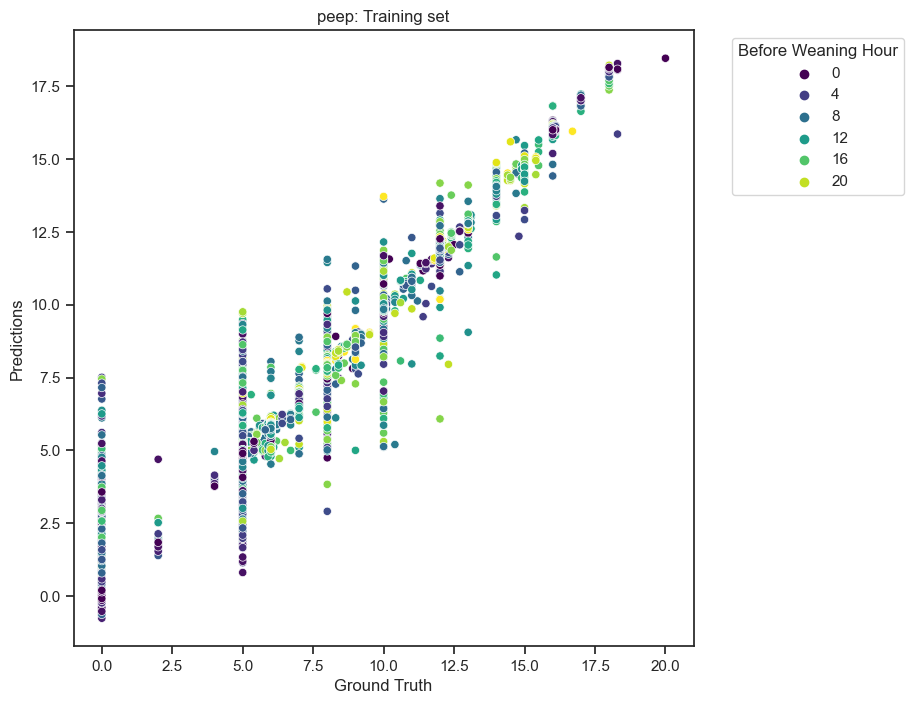

----- val -----


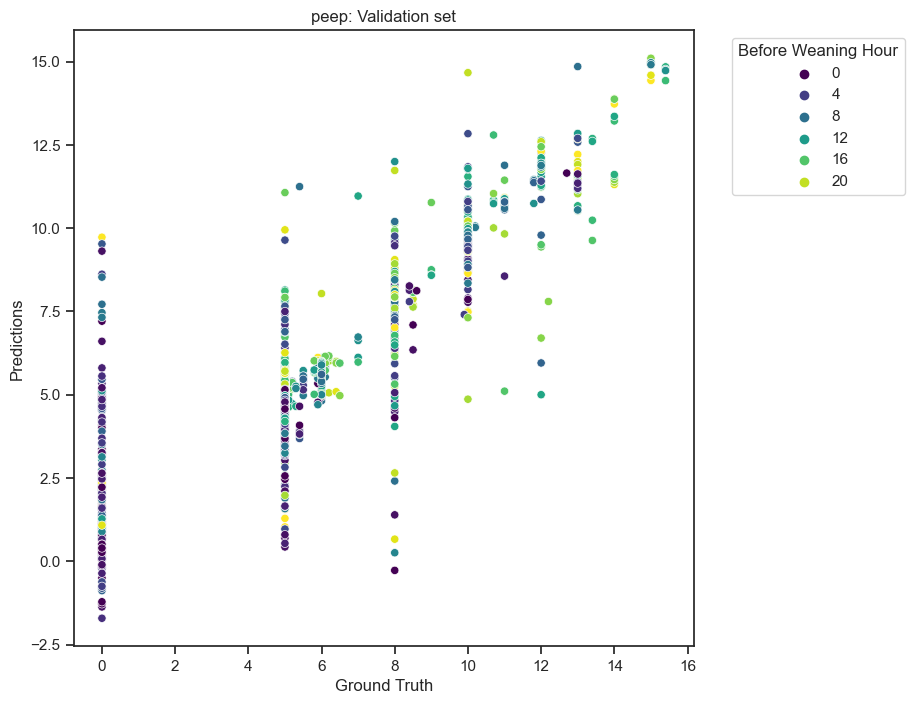

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 5.6546
positive change row train Mean Absolute Error (MAE): 1.9317
positive change row train R-squared (R2): 0.6044



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


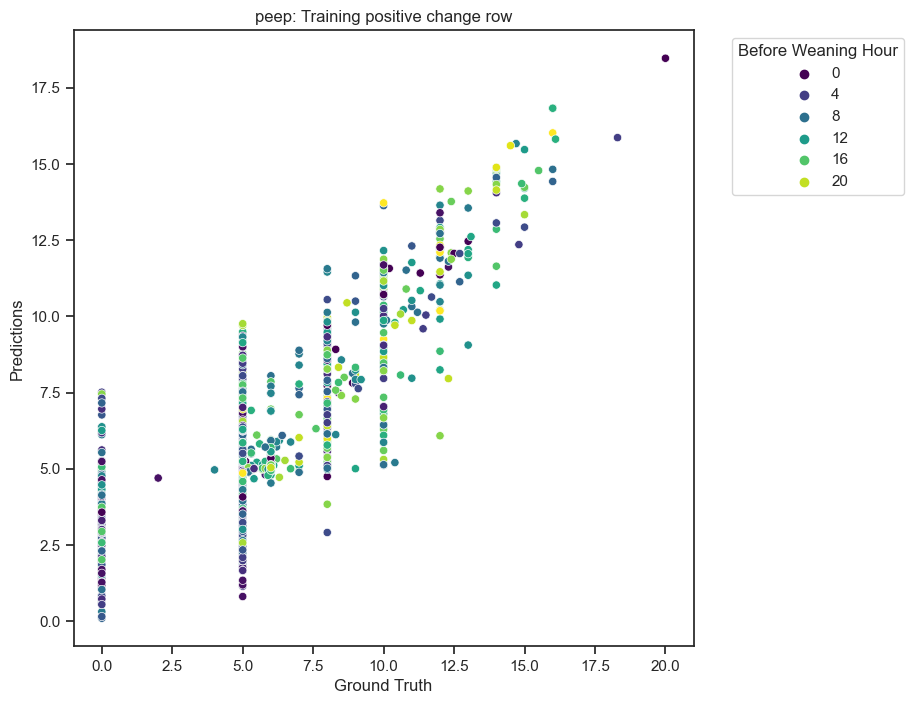

positive change row val Mean Squared Error (MSE): 13.5760
positive change row val Mean Absolute Error (MAE): 3.0363
positive change row val R-squared (R2): 0.0608



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


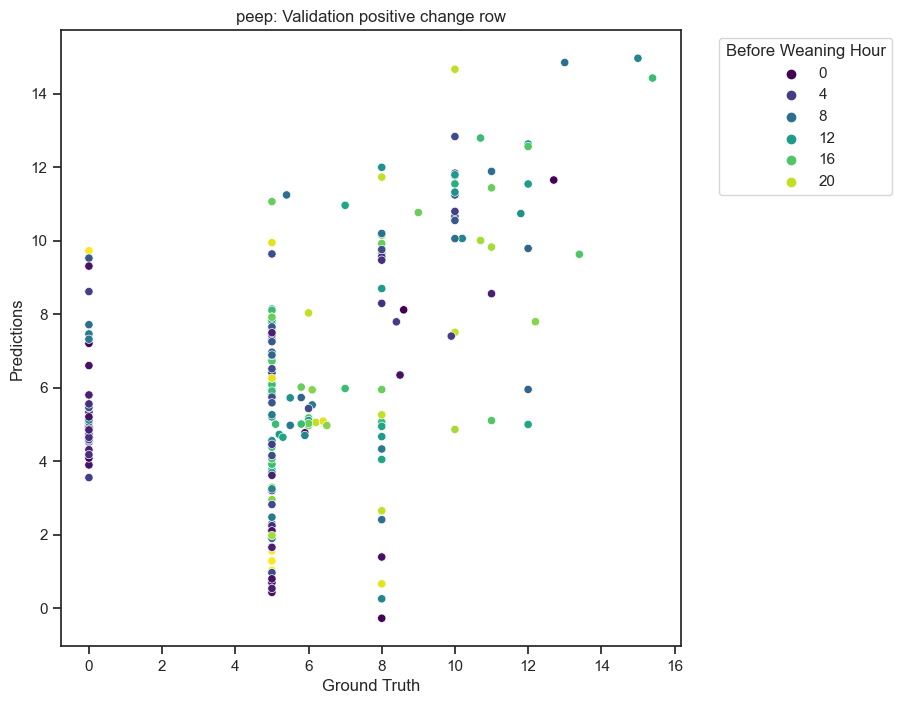

----- negative label -----
negative label Mean Squared Error (MSE): 1.5897
negative label Mean Absolute Error (MAE): 0.5611
negative label R-squared (R2): 0.8616



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


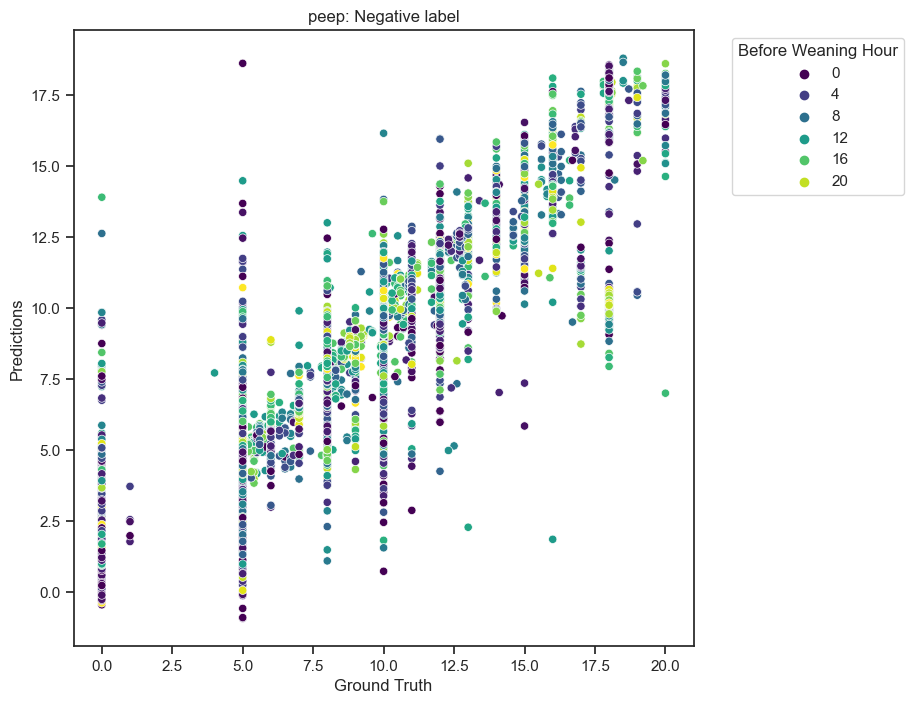

----- negative label change row -----
negative change row Mean Squared Error (MSE): 11.5292
negative change row Mean Absolute Error (MAE): 2.6299
negative change row R-squared (R2): 0.4645



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


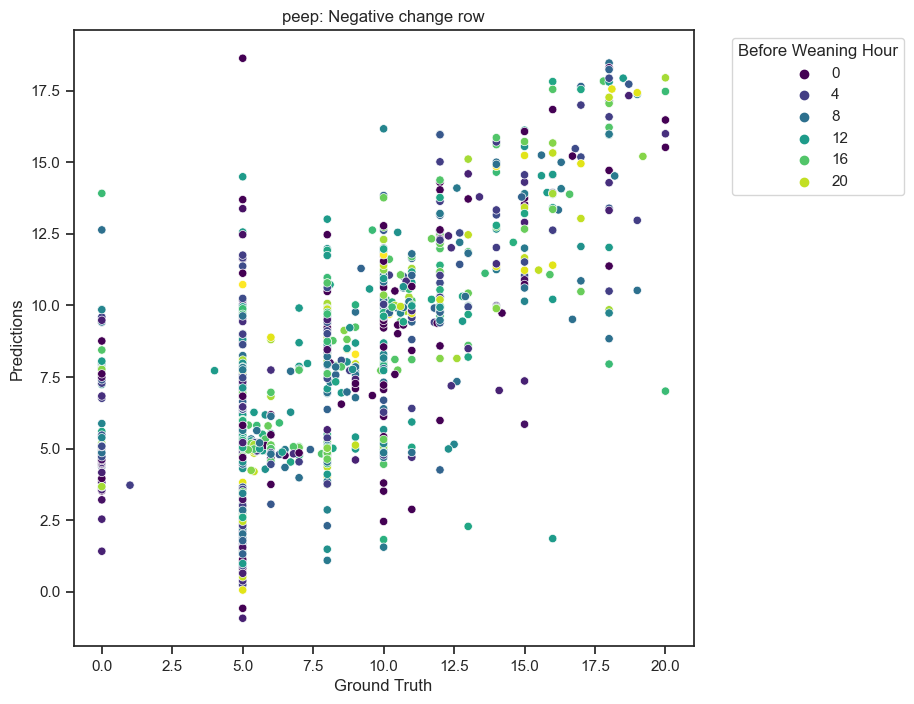

====== ventilator_settings: fio2 =====
----- positive label -----
Training Set Mean Squared Error (MSE): 4.5649
Training Set Mean Absolute Error (MAE): 0.6629
Training Set R-squared (R2): 0.9453

Validation Set Mean Squared Error (MSE): 25.6386
Validation Set Mean Absolute Error (MAE): 1.5680
Validation Set R-squared (R2): 0.6938

----- train -----


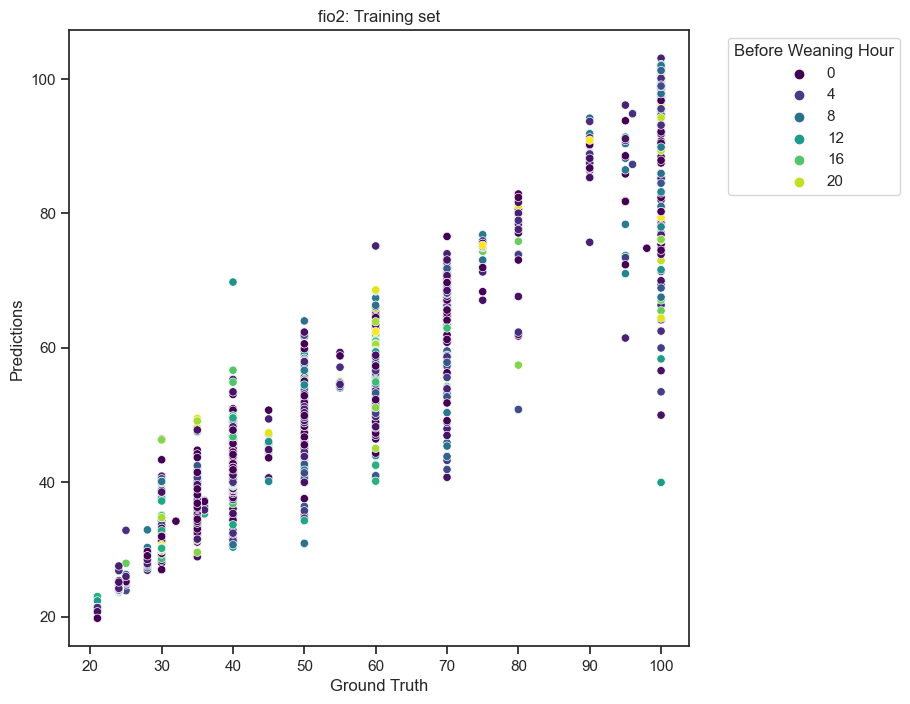

----- val -----


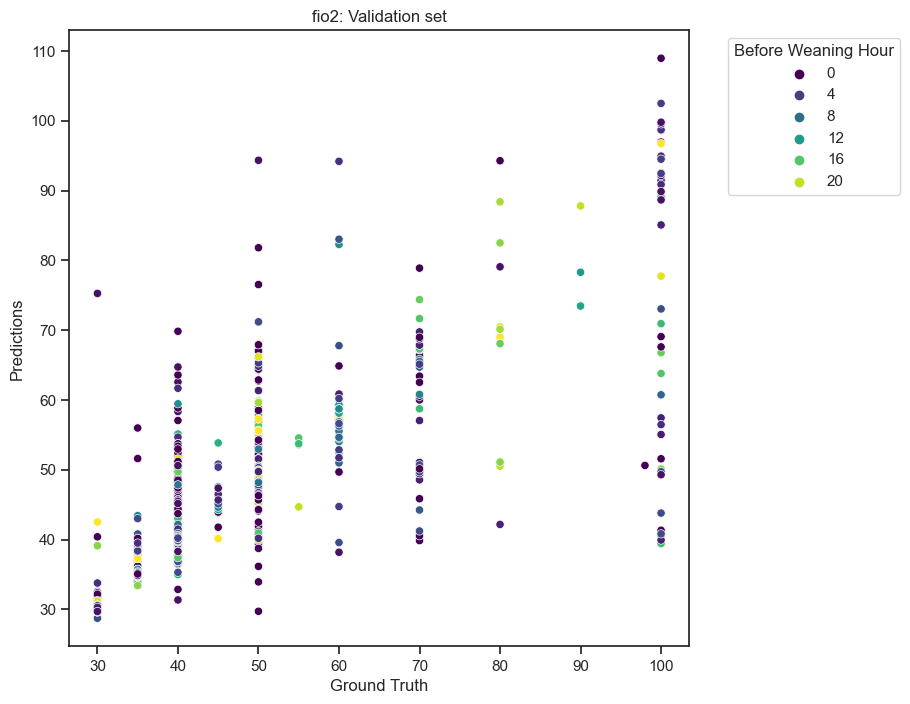

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 104.8810
positive change row train Mean Absolute Error (MAE): 7.7425
positive change row train R-squared (R2): 0.6998



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


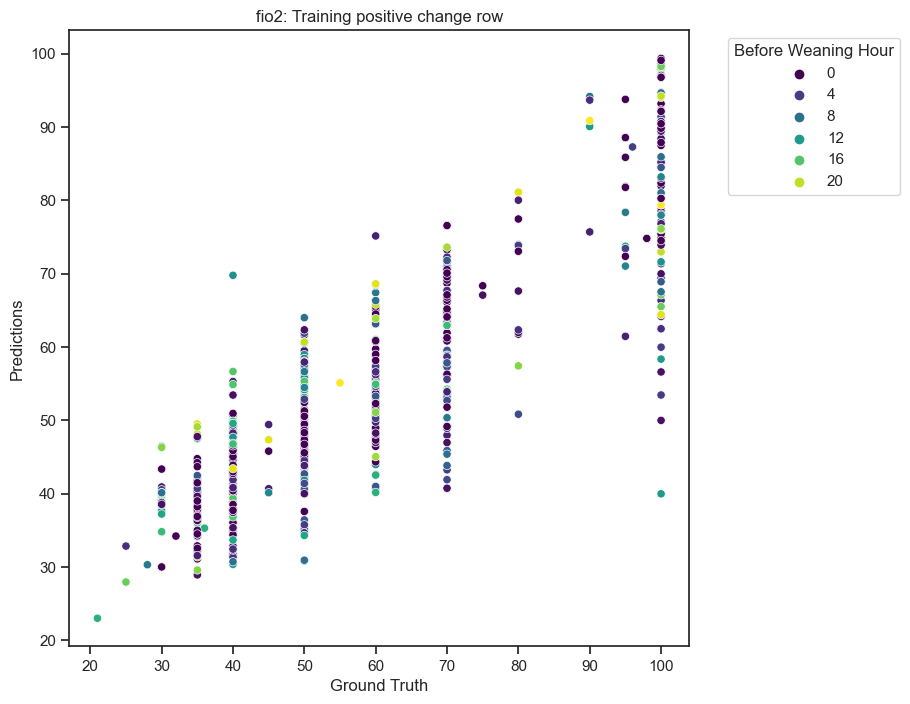

positive change row val Mean Squared Error (MSE): 469.9732
positive change row val Mean Absolute Error (MAE): 16.6167
positive change row val R-squared (R2): -0.2724



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


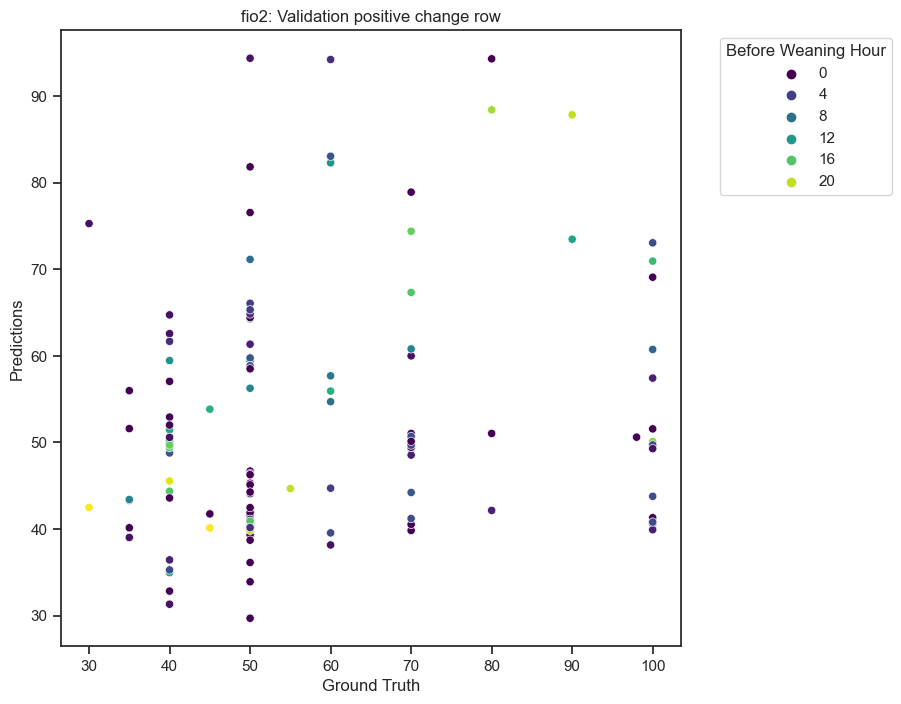

----- negative label -----
negative label Mean Squared Error (MSE): 75.7004
negative label Mean Absolute Error (MAE): 3.0021
negative label R-squared (R2): 0.6426



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


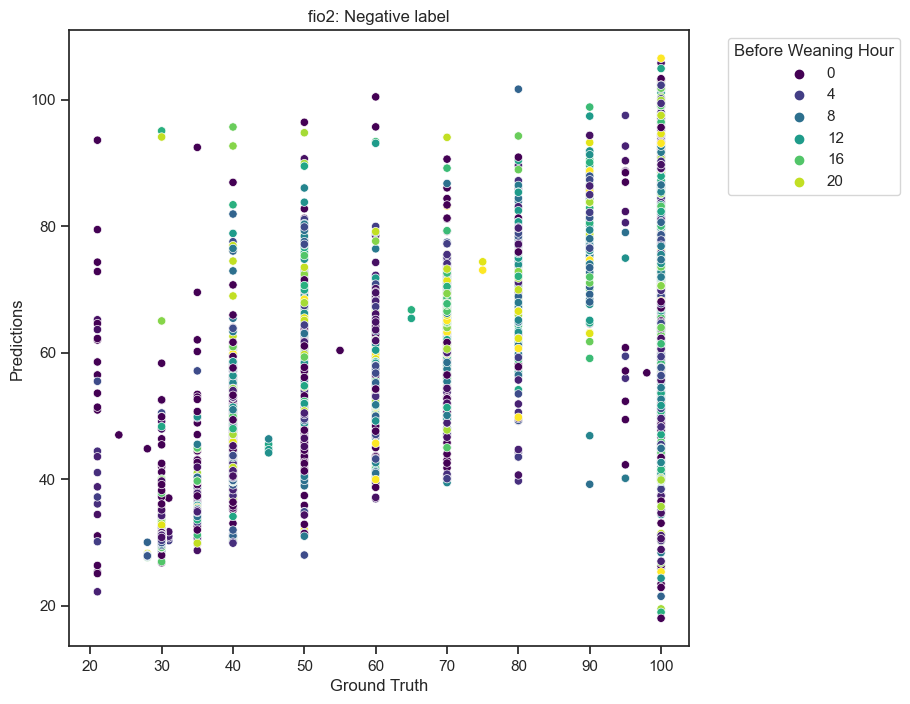

----- negative label change row -----
negative change row Mean Squared Error (MSE): 566.6953
negative change row Mean Absolute Error (MAE): 17.9268
negative change row R-squared (R2): -0.1837



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


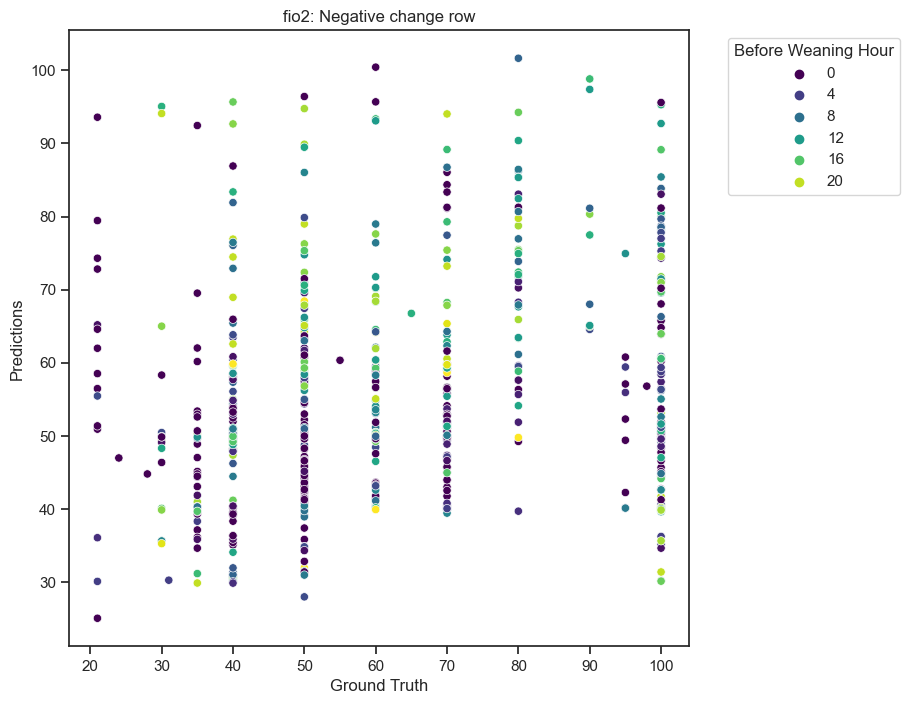

====== ventilator_settings: respiratory_rate_set =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.1081
Training Set Mean Absolute Error (MAE): 0.0871
Training Set R-squared (R2): 0.9970

Validation Set Mean Squared Error (MSE): 1.5334
Validation Set Mean Absolute Error (MAE): 0.2825
Validation Set R-squared (R2): 0.9618

----- train -----


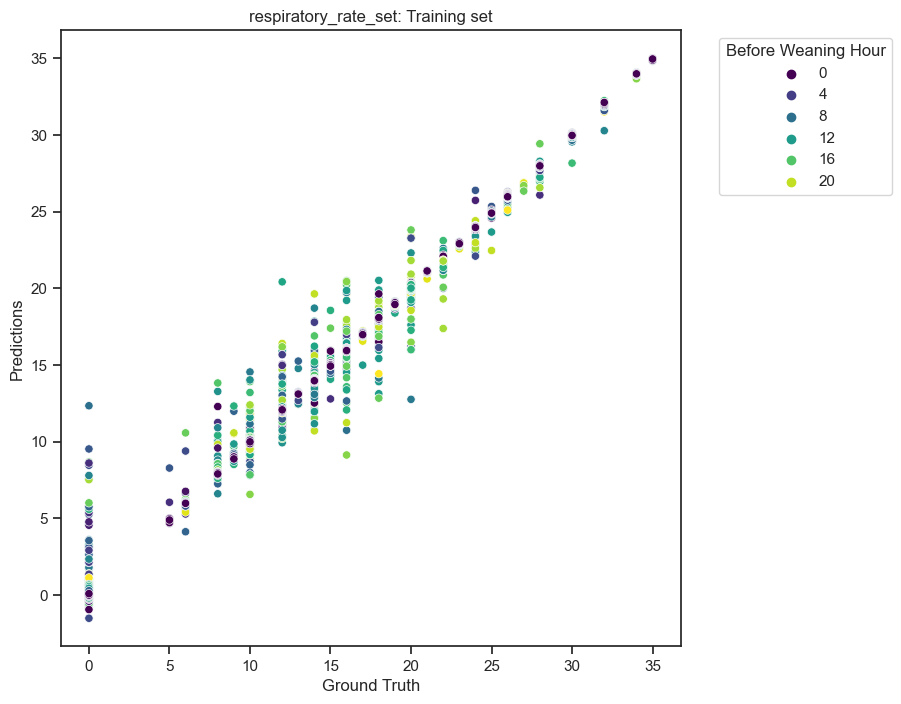

----- val -----


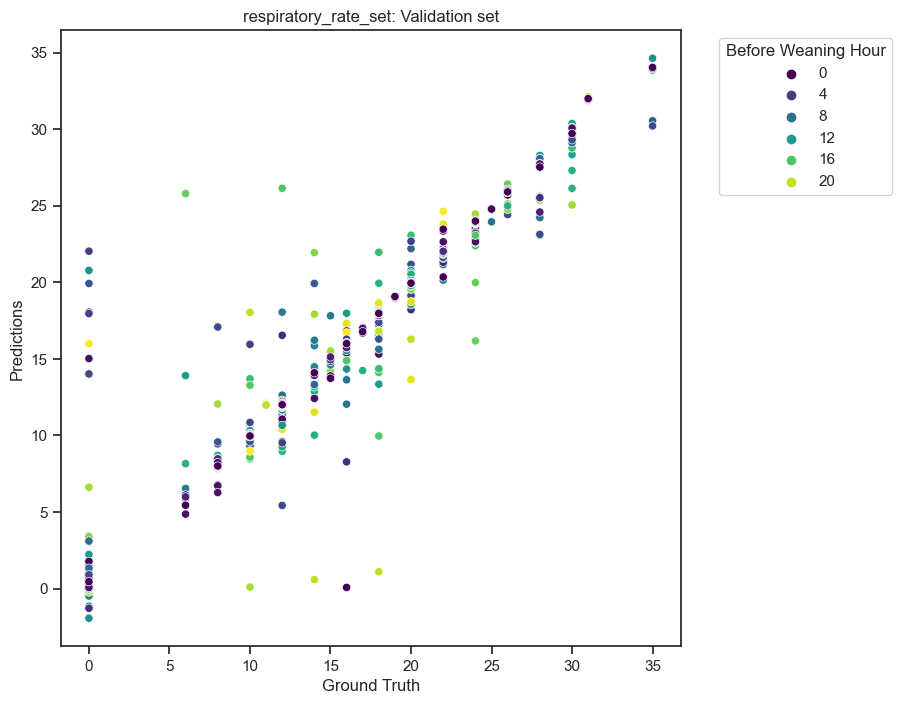

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 9.2056
positive change row train Mean Absolute Error (MAE): 2.4499
positive change row train R-squared (R2): 0.7869



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


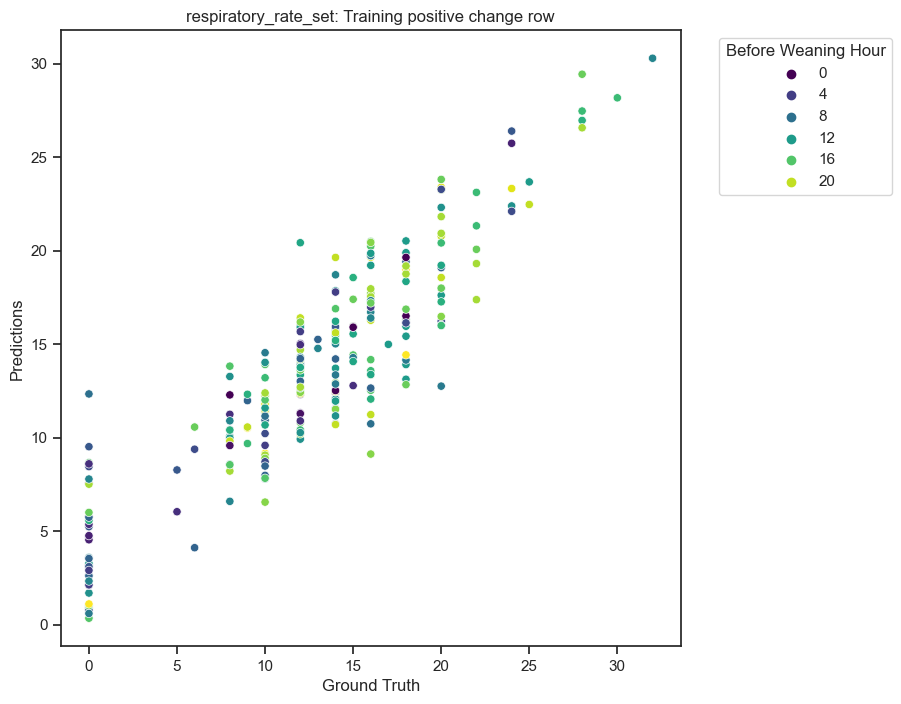

positive change row val Mean Squared Error (MSE): 114.1885
positive change row val Mean Absolute Error (MAE): 8.6673
positive change row val R-squared (R2): -1.2787



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


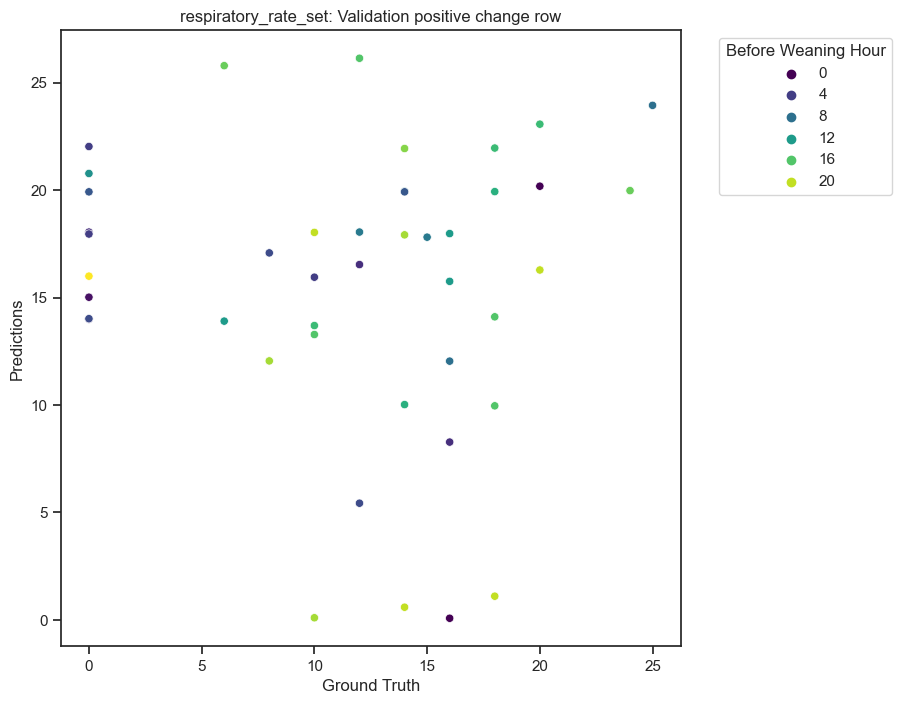

----- negative label -----
negative label Mean Squared Error (MSE): 1.6832
negative label Mean Absolute Error (MAE): 0.3664
negative label R-squared (R2): 0.9604



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


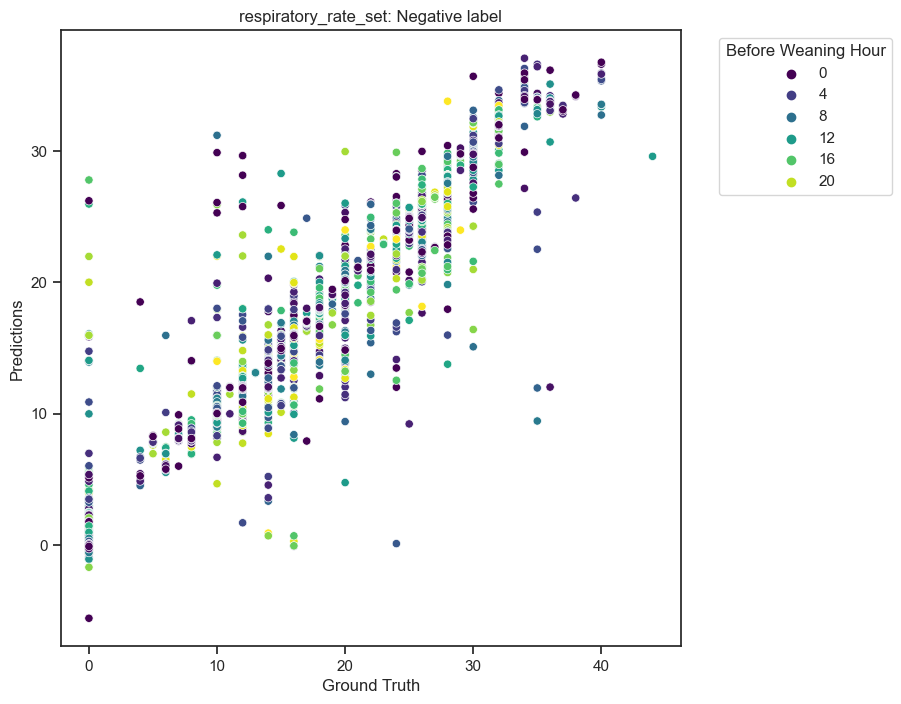

----- negative label change row -----
negative change row Mean Squared Error (MSE): 74.2134
negative change row Mean Absolute Error (MAE): 6.5194
negative change row R-squared (R2): -0.0549



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


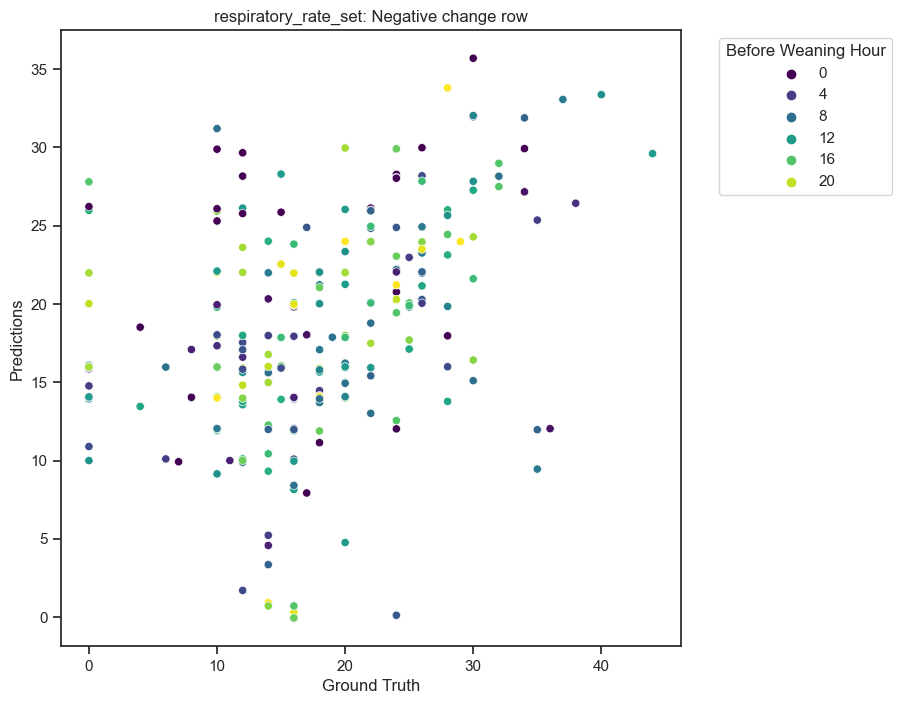

====== ventilator_settings: plateau_pressure =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.0758
Training Set Mean Absolute Error (MAE): 0.0814
Training Set R-squared (R2): 0.9962

Validation Set Mean Squared Error (MSE): 0.4310
Validation Set Mean Absolute Error (MAE): 0.1941
Validation Set R-squared (R2): 0.9745

----- train -----


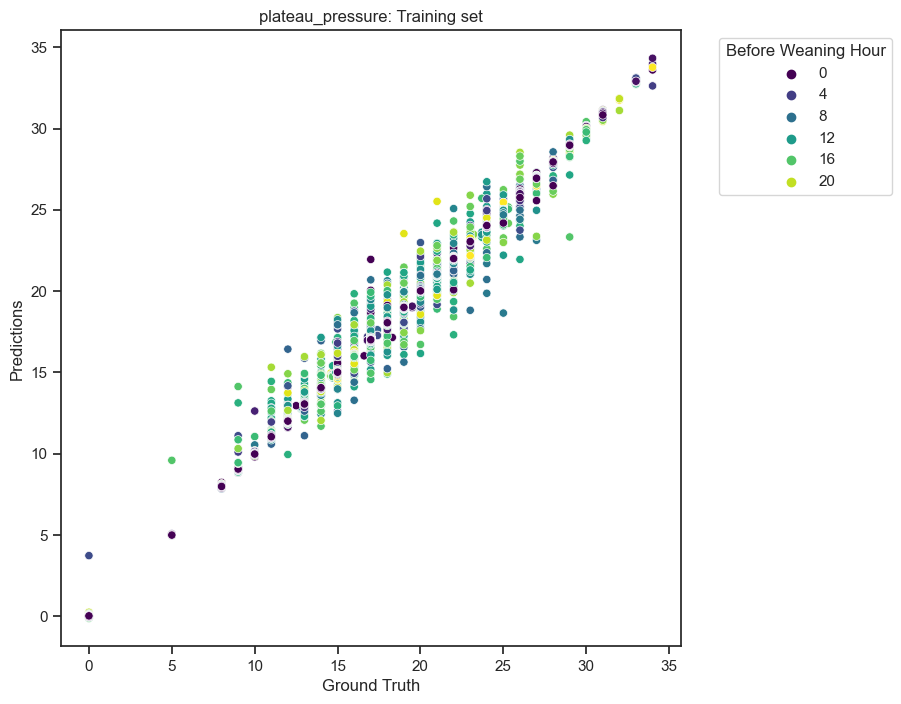

----- val -----


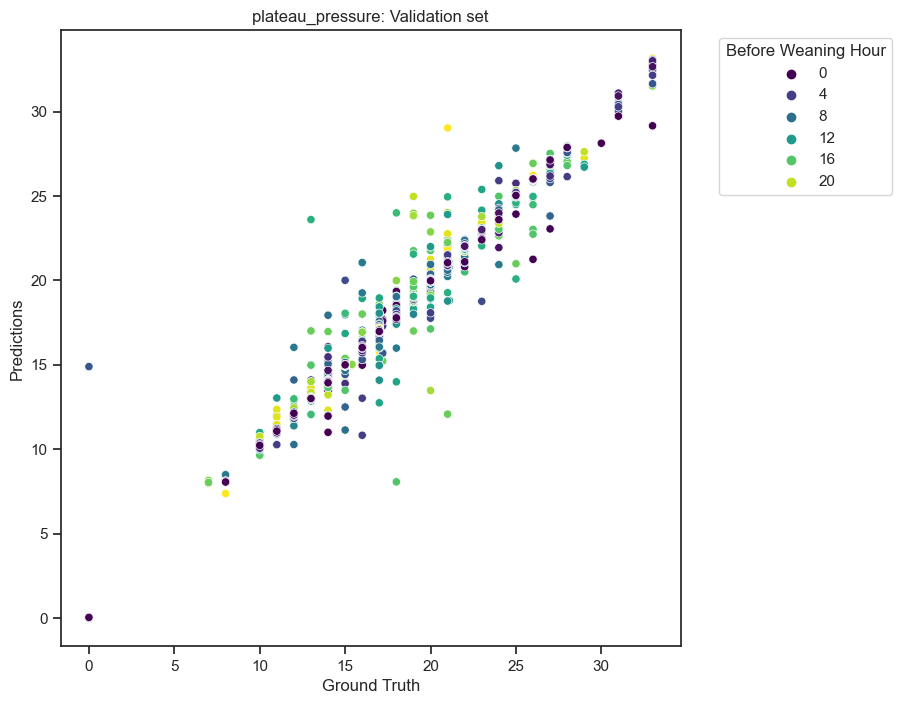

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 2.6805
positive change row train Mean Absolute Error (MAE): 1.3842
positive change row train R-squared (R2): 0.8575



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


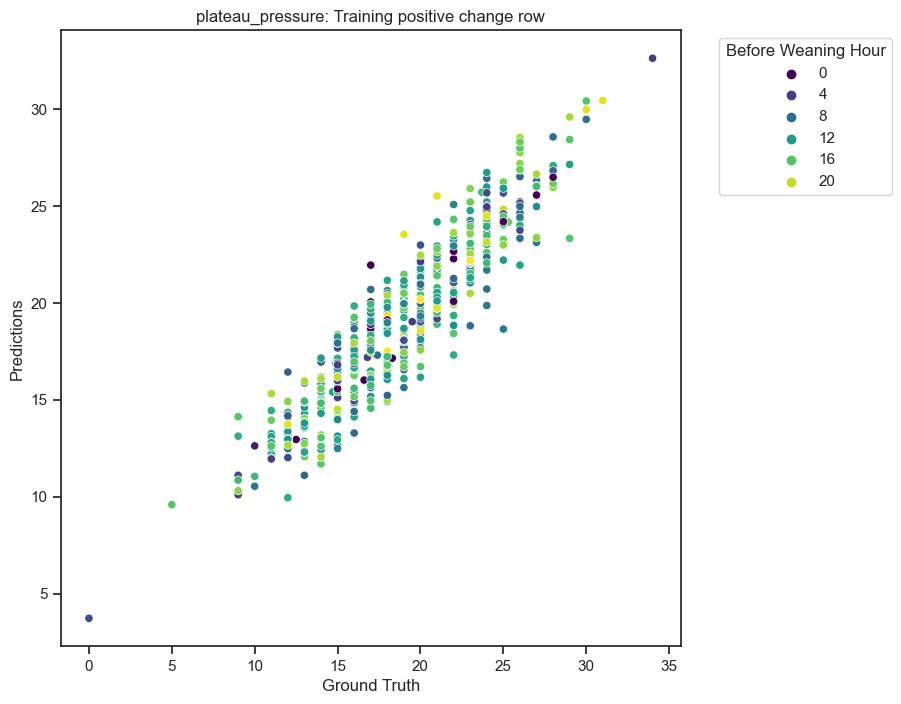

positive change row val Mean Squared Error (MSE): 11.3904
positive change row val Mean Absolute Error (MAE): 2.5965
positive change row val R-squared (R2): 0.4185



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


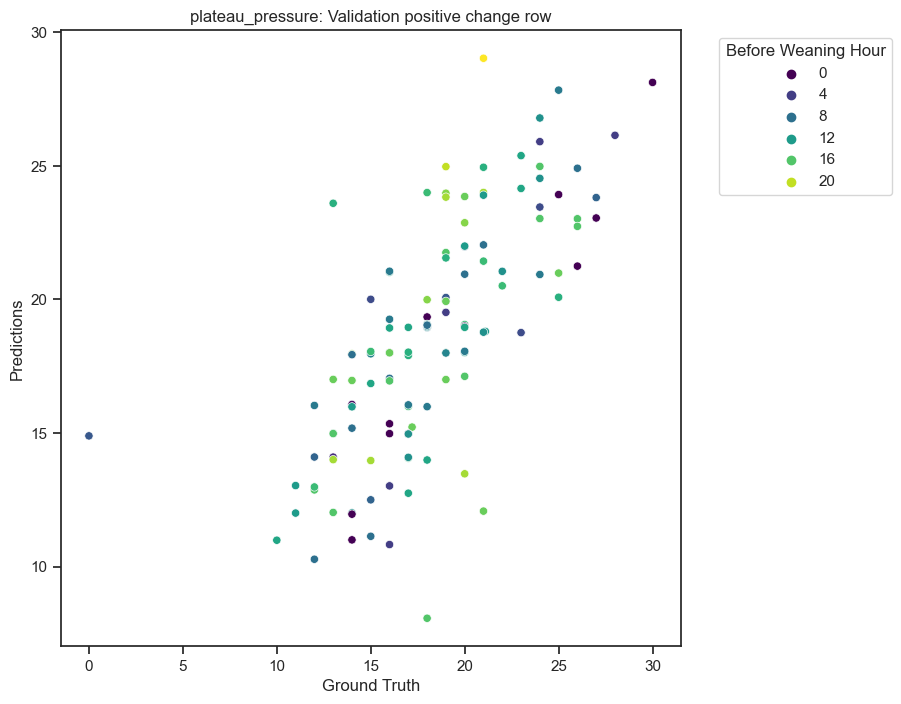

----- negative label -----
negative label Mean Squared Error (MSE): 0.9793
negative label Mean Absolute Error (MAE): 0.3506
negative label R-squared (R2): 0.9679



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


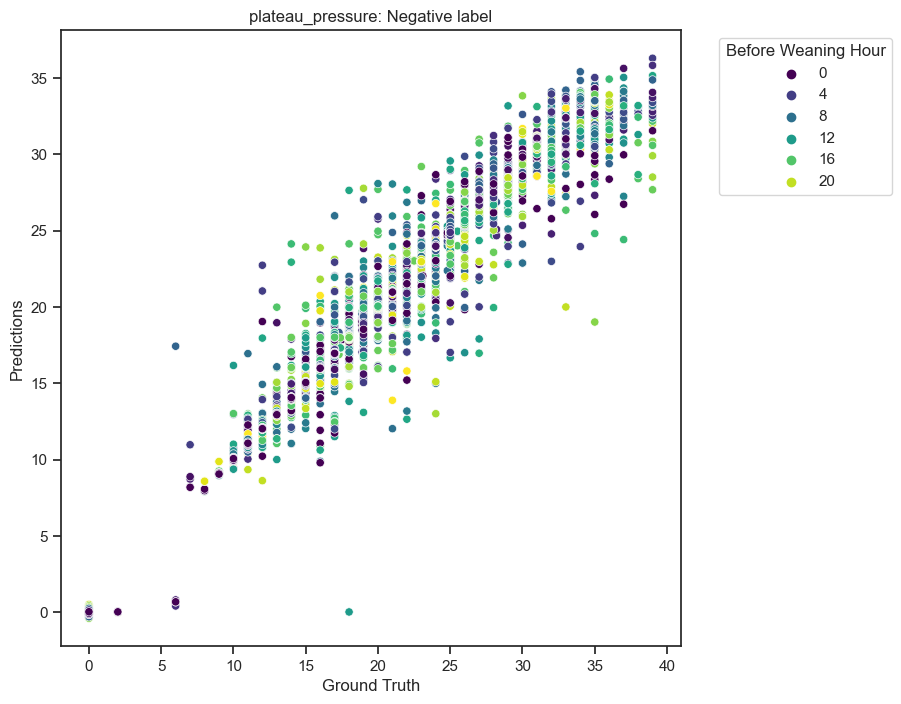

----- negative label change row -----
negative change row Mean Squared Error (MSE): 10.6575
negative change row Mean Absolute Error (MAE): 2.4550
negative change row R-squared (R2): 0.7010



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


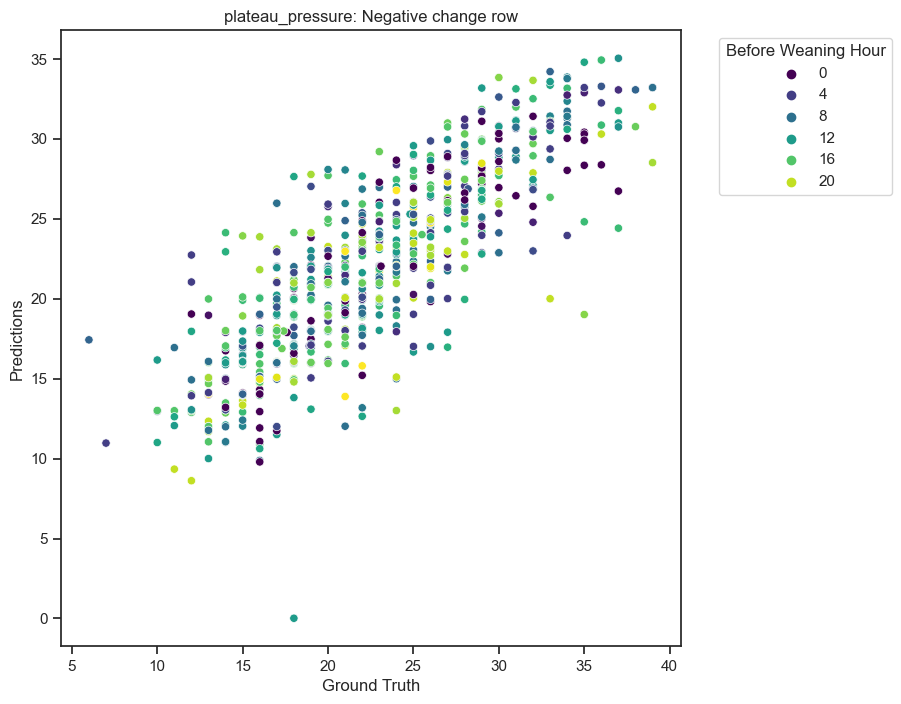

In [535]:
visual_mode = 3
intuition_model_A_dict = {}
for vese in ventilator_settings:
    print(f'====== ventilator_settings: {vese} =====')
    print('----- positive label -----')
    # X_train, y_train, X_val, y_val, X_test, y_test = split_data(group_pre_1hr_visi_vese_df, X_cols, vese)
    X_train, y_train, X_val, y_val = split_data(group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df,
                                                group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df, X_cols, vese)
    model = intuition_regression_model(X_train, y_train, X_val, y_val, vese, visual_mode)
    intuition_model_A_dict[vese] = model
    
    print('----- positive label change row -----')
    vese_change_row_train_df = group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df[group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df[f"{vese}_change_label"] == 1]
    vese_change_row_val_df = group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df[group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df[f"{vese}_change_label"] == 1]
    X_train_change, y_train_change, X_val_change, y_val_change = split_data(vese_change_row_train_df,
                                                                            vese_change_row_val_df, X_cols, vese)
    y_train_change_pred = model.predict(X_train_change)
    print_regression_metrics(y_train_change, y_train_change_pred, "positive change row train")
    visualize_predict_ground_truth(X_train_change, y_train_change, y_train_change_pred, vese, visual_mode, "Training positive change row")
    y_val_change_pred = model.predict(X_val_change)
    print_regression_metrics(y_val_change, y_val_change_pred, "positive change row val")
    visualize_predict_ground_truth(X_val_change, y_val_change, y_val_change_pred, vese, visual_mode, "Validation positive change row")

    print('----- negative label -----')
    X_train_negative, y_train_negative, X_val_negative, y_val_negative = split_data(group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df,
                                                                                    group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df, X_cols, vese)
    X_val_df = pd.concat([X_train_negative, X_val_negative], axis=0)
    y_val_df = pd.concat([y_train_negative, y_val_negative], axis=0)
    y_val_pred = model.predict(X_val_df)
    print_regression_metrics(y_val_df, y_val_pred, "negative label")
    visualize_predict_ground_truth(X_val_df, y_val_df, y_val_pred, vese, visual_mode, "Negative label")

    print('----- negative label change row -----')
    vese_change_row_train_df = group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df[group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df[f"{vese}_change_label"] == 1]
    vese_change_row_val_df = group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df[group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df[f"{vese}_change_label"] == 1]
    X_train_change, y_train_change, X_val_change, y_val_change = split_data(vese_change_row_train_df,
                                                                            vese_change_row_val_df, X_cols, vese)
    X_val_df = pd.concat([X_train_change, X_val_change], axis=0)
    y_val_df = pd.concat([y_train_change, y_val_change], axis=0)
    y_train_change_pred = model.predict(X_val_df)
    print_regression_metrics(y_val_df, y_train_change_pred, "negative change row")
    visualize_predict_ground_truth(X_val_df, y_val_df, y_train_change_pred, vese, visual_mode, "Negative change row")

====== ventilator_settings: peep =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.3595
Training Set Mean Absolute Error (MAE): 0.2338
Training Set R-squared (R2): 0.9393

Validation Set Mean Squared Error (MSE): 1.1219
Validation Set Mean Absolute Error (MAE): 0.4445
Validation Set R-squared (R2): 0.8063

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 5.6546
positive change row train Mean Absolute Error (MAE): 1.9317
positive change row train R-squared (R2): 0.6044



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


positive change row val Mean Squared Error (MSE): 13.5760
positive change row val Mean Absolute Error (MAE): 3.0363
positive change row val R-squared (R2): 0.0608



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


----- negative label -----
negative label Mean Squared Error (MSE): 1.5897
negative label Mean Absolute Error (MAE): 0.5611
negative label R-squared (R2): 0.8616



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


----- negative label change row -----
negative change row Mean Squared Error (MSE): 11.5292
negative change row Mean Absolute Error (MAE): 2.6299
negative change row R-squared (R2): 0.4645

====== ventilator_settings: fio2 =====
----- positive label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


Training Set Mean Squared Error (MSE): 4.5649
Training Set Mean Absolute Error (MAE): 0.6629
Training Set R-squared (R2): 0.9453

Validation Set Mean Squared Error (MSE): 25.6386
Validation Set Mean Absolute Error (MAE): 1.5680
Validation Set R-squared (R2): 0.6938

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 104.8810
positive change row train Mean Absolute Error (MAE): 7.7425
positive change row train R-squared (R2): 0.6998

positive change row val Mean Squared Error (MSE): 469.9732
positive change row val Mean Absolute Error (MAE): 16.6167
positive change row val R-squared (R2): -0.2724



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')
C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


----- negative label -----
negative label Mean Squared Error (MSE): 75.7004
negative label Mean Absolute Error (MAE): 3.0021
negative label R-squared (R2): 0.6426



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


----- negative label change row -----
negative change row Mean Squared Error (MSE): 566.6953
negative change row Mean Absolute Error (MAE): 17.9268
negative change row R-squared (R2): -0.1837

====== ventilator_settings: respiratory_rate_set =====
----- positive label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


Training Set Mean Squared Error (MSE): 0.1081
Training Set Mean Absolute Error (MAE): 0.0871
Training Set R-squared (R2): 0.9970

Validation Set Mean Squared Error (MSE): 1.5334
Validation Set Mean Absolute Error (MAE): 0.2825
Validation Set R-squared (R2): 0.9618

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 9.2056
positive change row train Mean Absolute Error (MAE): 2.4499
positive change row train R-squared (R2): 0.7869

positive change row val Mean Squared Error (MSE): 114.1885
positive change row val Mean Absolute Error (MAE): 8.6673
positive change row val R-squared (R2): -1.2787



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')
C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


----- negative label -----
negative label Mean Squared Error (MSE): 1.6832
negative label Mean Absolute Error (MAE): 0.3664
negative label R-squared (R2): 0.9604



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


----- negative label change row -----
negative change row Mean Squared Error (MSE): 74.2134
negative change row Mean Absolute Error (MAE): 6.5194
negative change row R-squared (R2): -0.0549

====== ventilator_settings: plateau_pressure =====
----- positive label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


Training Set Mean Squared Error (MSE): 0.0758
Training Set Mean Absolute Error (MAE): 0.0814
Training Set R-squared (R2): 0.9962

Validation Set Mean Squared Error (MSE): 0.4310
Validation Set Mean Absolute Error (MAE): 0.1941
Validation Set R-squared (R2): 0.9745

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 2.6805
positive change row train Mean Absolute Error (MAE): 1.3842
positive change row train R-squared (R2): 0.8575

positive change row val Mean Squared Error (MSE): 11.3904
positive change row val Mean Absolute Error (MAE): 2.5965
positive change row val R-squared (R2): 0.4185



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')
C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


----- negative label -----
negative label Mean Squared Error (MSE): 0.9793
negative label Mean Absolute Error (MAE): 0.3506
negative label R-squared (R2): 0.9679



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


----- negative label change row -----
negative change row Mean Squared Error (MSE): 10.6575
negative change row Mean Absolute Error (MAE): 2.4550
negative change row R-squared (R2): 0.7010



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3161982452.py:49: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['log_count'][:len(y_pred)], palette='viridis')


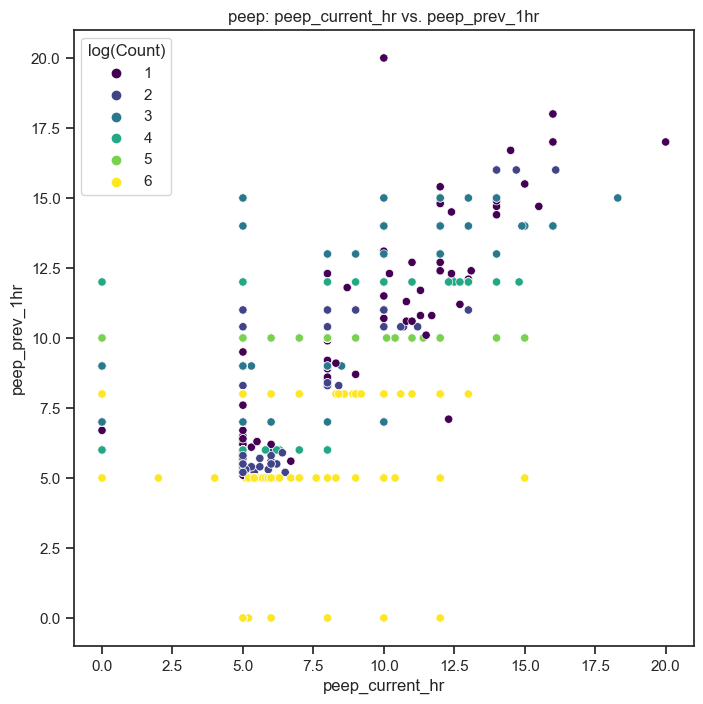

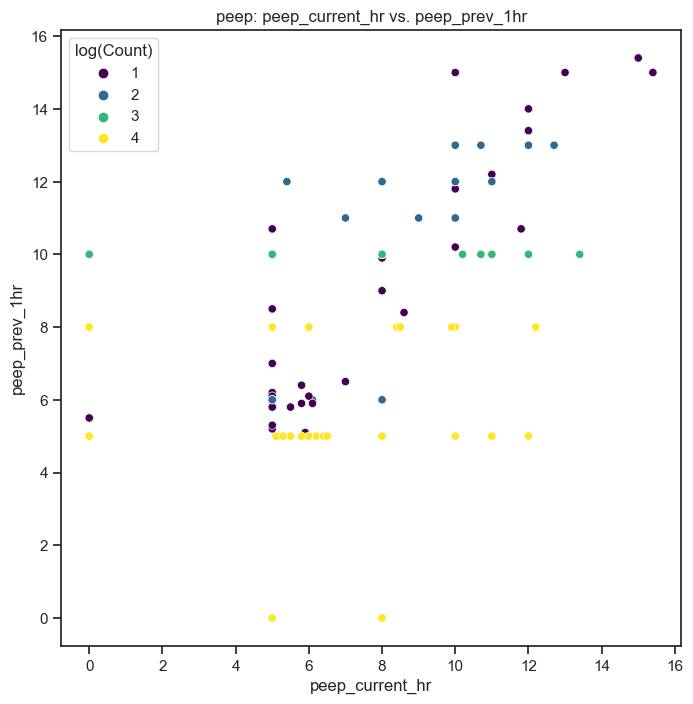

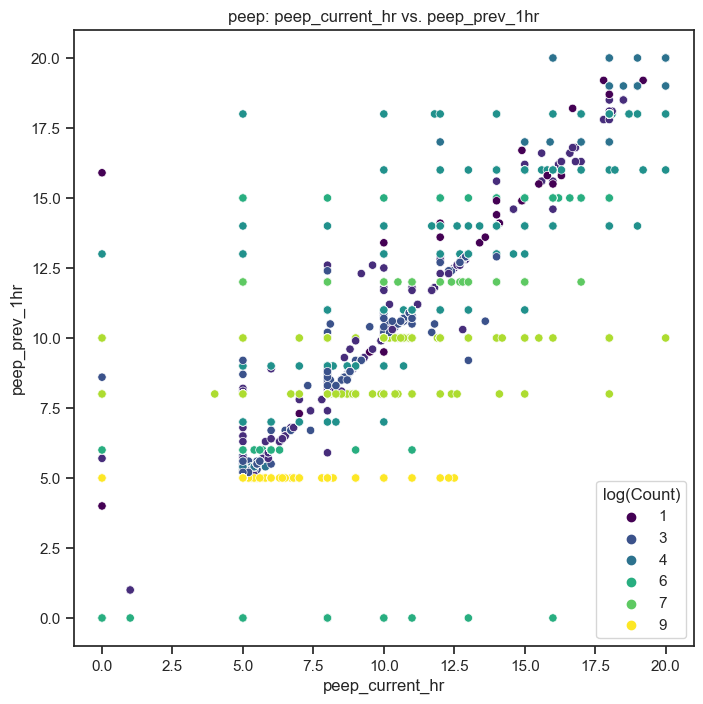

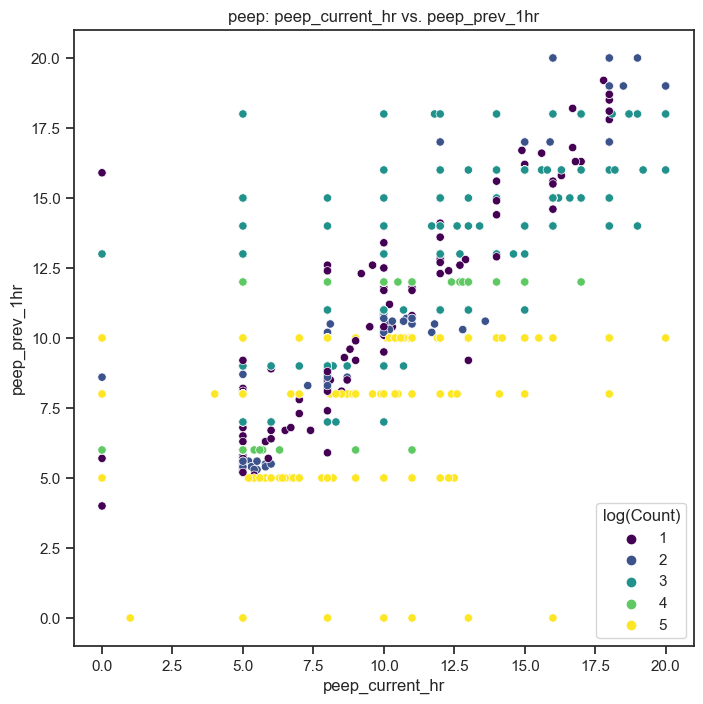

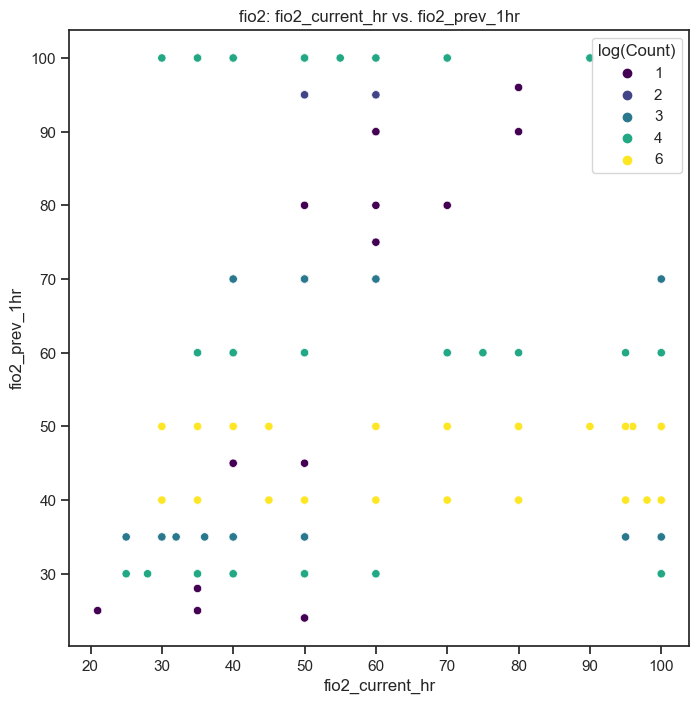

...

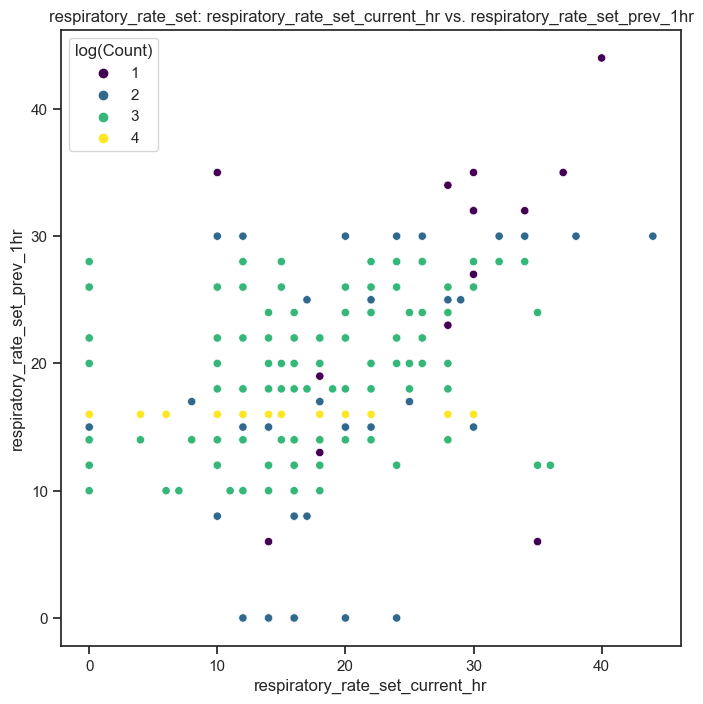

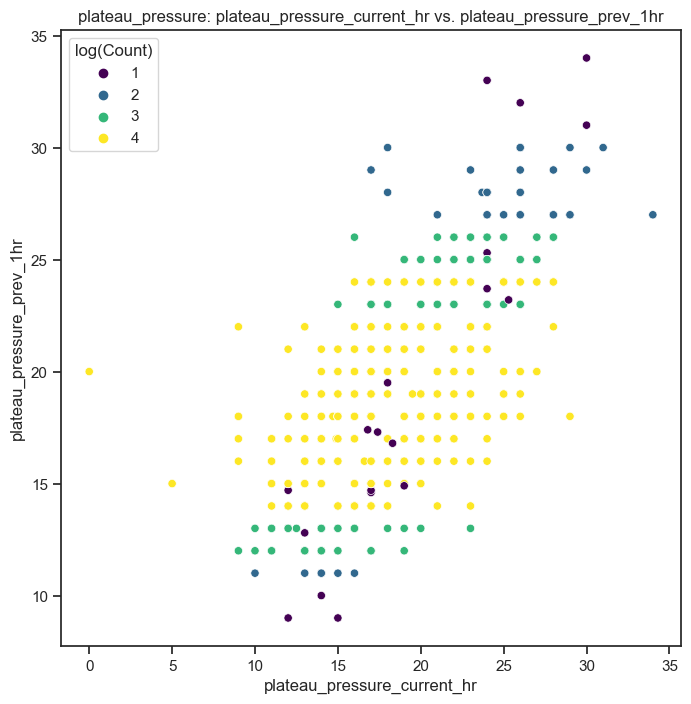

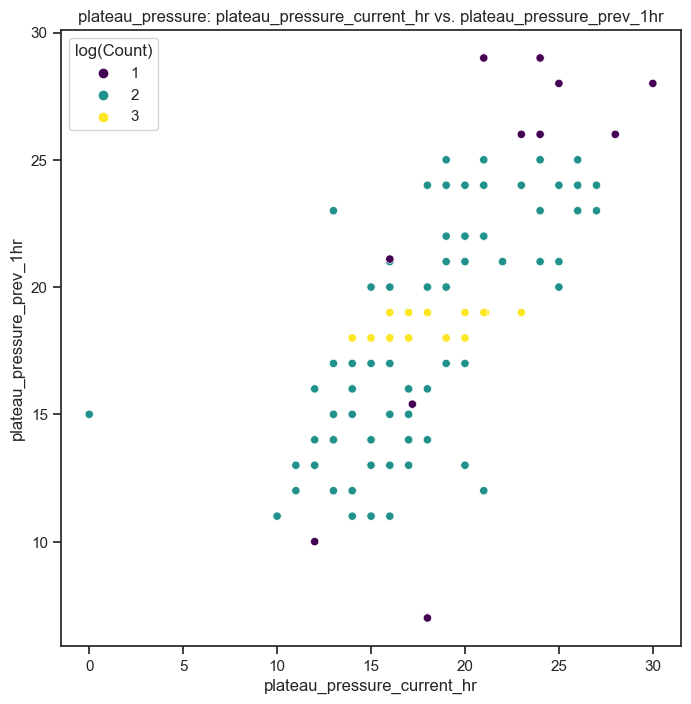

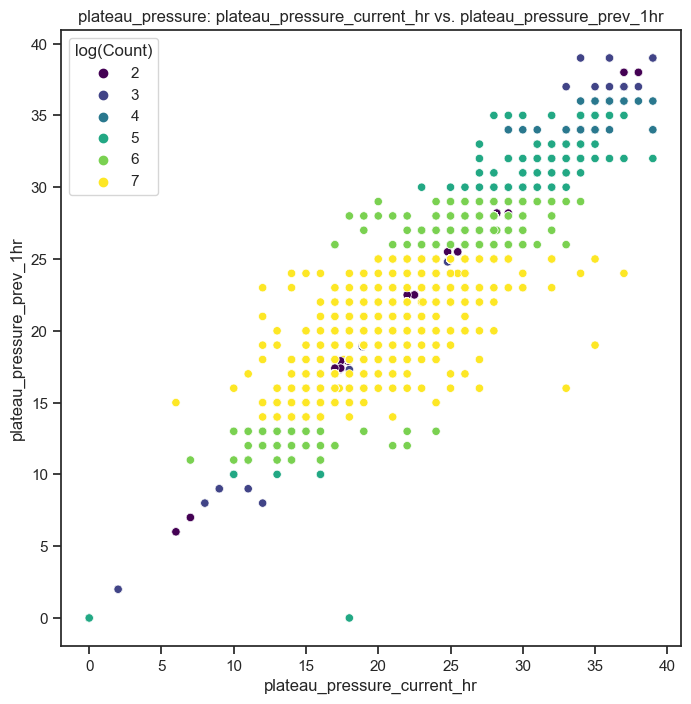

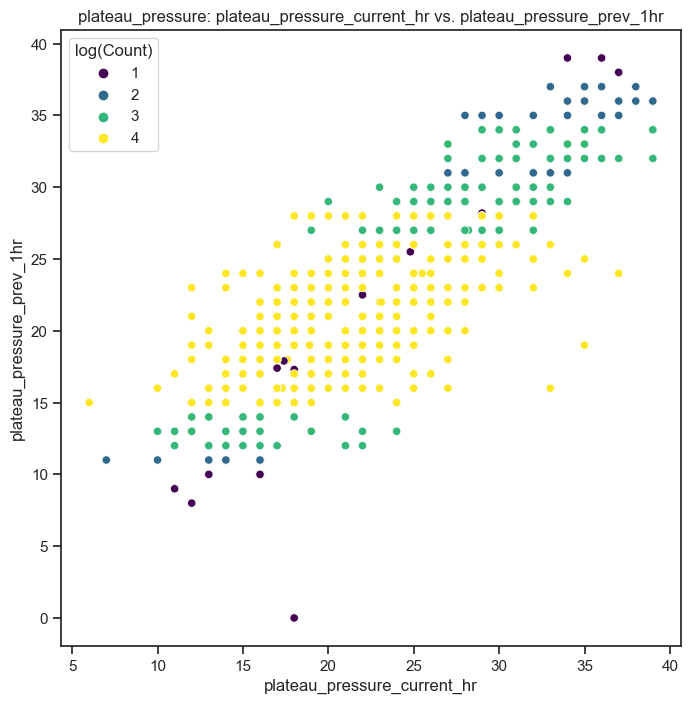

In [431]:
visual_mode = 1
for vese in ventilator_settings:
    print(f'====== ventilator_settings: {vese} =====')
    print('----- positive label -----')
    # X_train, y_train, X_val, y_val, X_test, y_test = split_data(group_pre_1hr_visi_vese_df, X_cols, vese)
    X_train, y_train, X_val, y_val = split_data(group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df,
                                                group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df, X_cols, vese)
    model = intuition_regression_model(X_train, y_train, X_val, y_val, vese, visual_mode)
    
    print('----- positive label change row -----')
    vese_change_row_train_df = group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df[group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df[f"{vese}_change_label"] == 1]
    vese_change_row_val_df = group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df[group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df[f"{vese}_change_label"] == 1]
    X_train_change, y_train_change, X_val_change, y_val_change = split_data(vese_change_row_train_df,
                                                                            vese_change_row_val_df, X_cols, vese)
    y_train_change_pred = model.predict(X_train_change)
    print_regression_metrics(y_train_change, y_train_change_pred, "positive change row train")
    visualize_predict_ground_truth(X_train_change, y_train_change, y_train_change_pred, vese, visual_mode)
    y_val_change_pred = model.predict(X_val_change)
    print_regression_metrics(y_val_change, y_val_change_pred, "positive change row val")
    visualize_predict_ground_truth(X_val_change, y_val_change, y_val_change_pred, vese, visual_mode)

    print('----- negative label -----')
    X_train_negative, y_train_negative, X_val_negative, y_val_negative = split_data(group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df,
                                                                                    group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df, X_cols, vese)
    X_val_df = pd.concat([X_train_negative, X_val_negative], axis=0)
    y_val_df = pd.concat([y_train_negative, y_val_negative], axis=0)
    y_val_pred = model.predict(X_val_df)
    print_regression_metrics(y_val_df, y_val_pred, "negative label")
    visualize_predict_ground_truth(X_val_df, y_val_df, y_val_pred, vese, visual_mode)

    print('----- negative label change row -----')
    vese_change_row_train_df = group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df[group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df[f"{vese}_change_label"] == 1]
    vese_change_row_val_df = group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df[group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df[f"{vese}_change_label"] == 1]
    X_train_change, y_train_change, X_val_change, y_val_change = split_data(vese_change_row_train_df,
                                                                            vese_change_row_val_df, X_cols, vese)
    X_val_df = pd.concat([X_train_change, X_val_change], axis=0)
    y_val_df = pd.concat([y_train_change, y_val_change], axis=0)
    y_train_change_pred = model.predict(X_val_df)
    print_regression_metrics(y_val_df, y_train_change_pred, "negative change row")
    visualize_predict_ground_truth(X_val_df, y_val_df, y_train_change_pred, vese, visual_mode)

#### prev(with noise) vs. ground truth

====== ventilator_settings: peep =====
----- positive label -----


Training Set Mean Squared Error (MSE): 0.3595
Training Set Mean Absolute Error (MAE): 0.2338
Training Set R-squared (R2): 0.9393

Validation Set Mean Squared Error (MSE): 1.1219
Validation Set Mean Absolute Error (MAE): 0.4445
Validation Set R-squared (R2): 0.8063

----- train -----


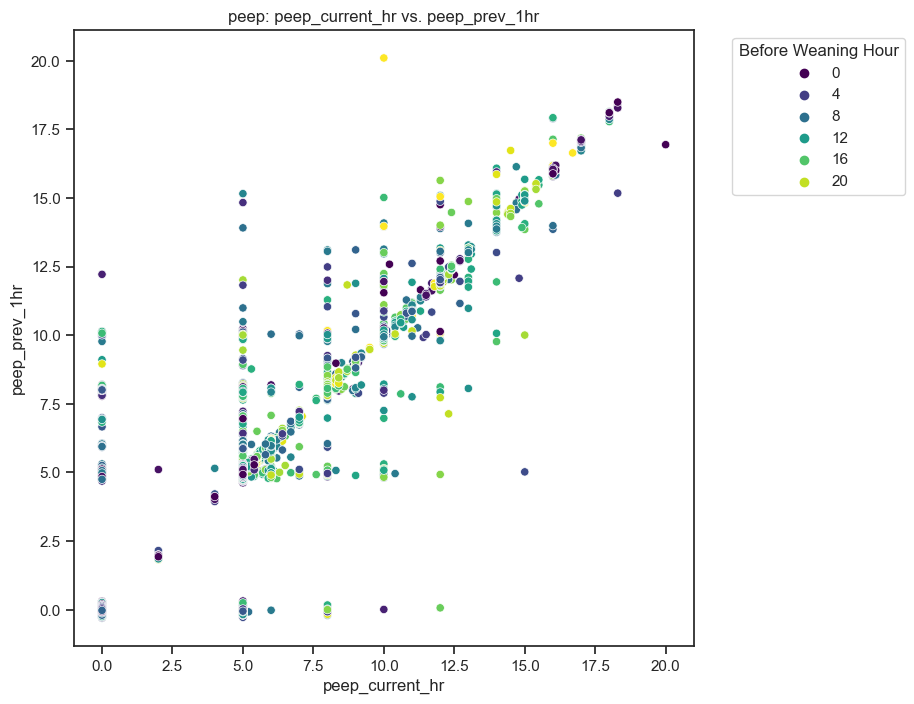

----- val -----


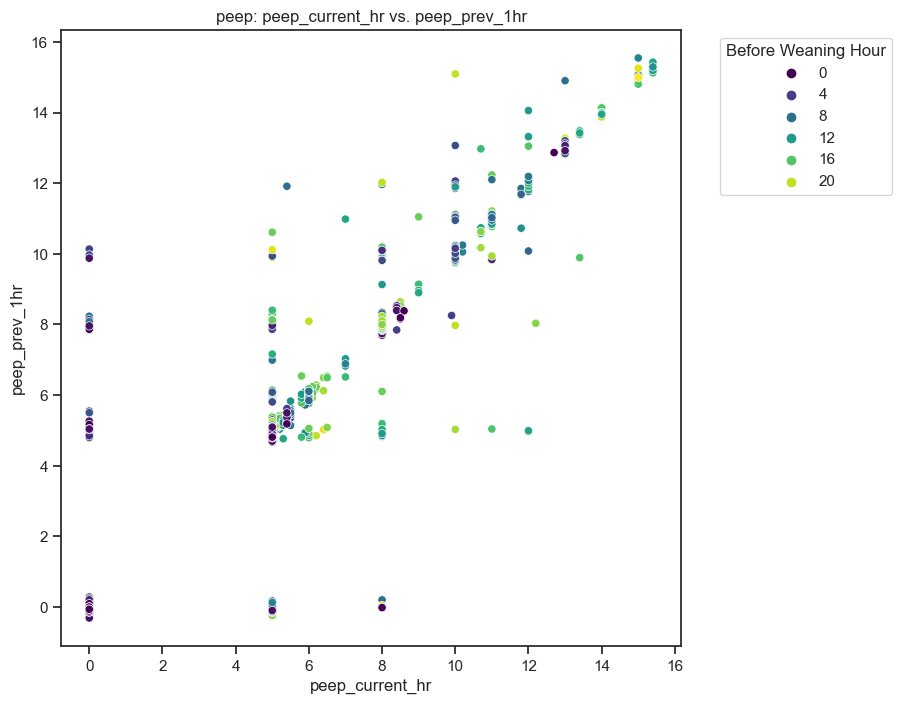

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\236036.py:81: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


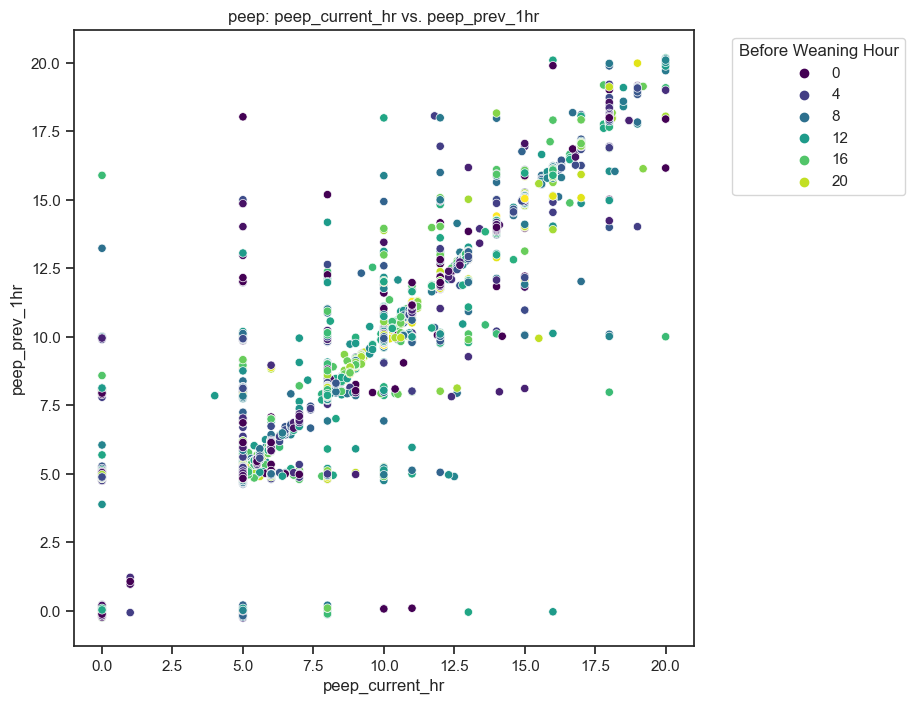

====== ventilator_settings: fio2 =====
----- positive label -----
Training Set Mean Squared Error (MSE): 4.5649
Training Set Mean Absolute Error (MAE): 0.6629
Training Set R-squared (R2): 0.9453

Validation Set Mean Squared Error (MSE): 25.6386
Validation Set Mean Absolute Error (MAE): 1.5680
Validation Set R-squared (R2): 0.6938

----- train -----


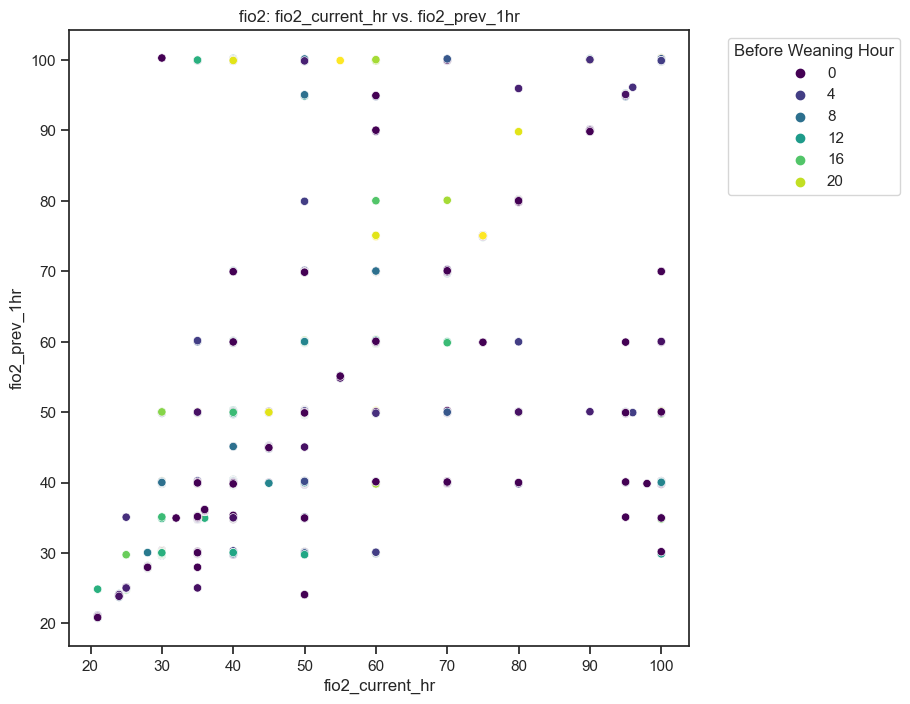

----- val -----


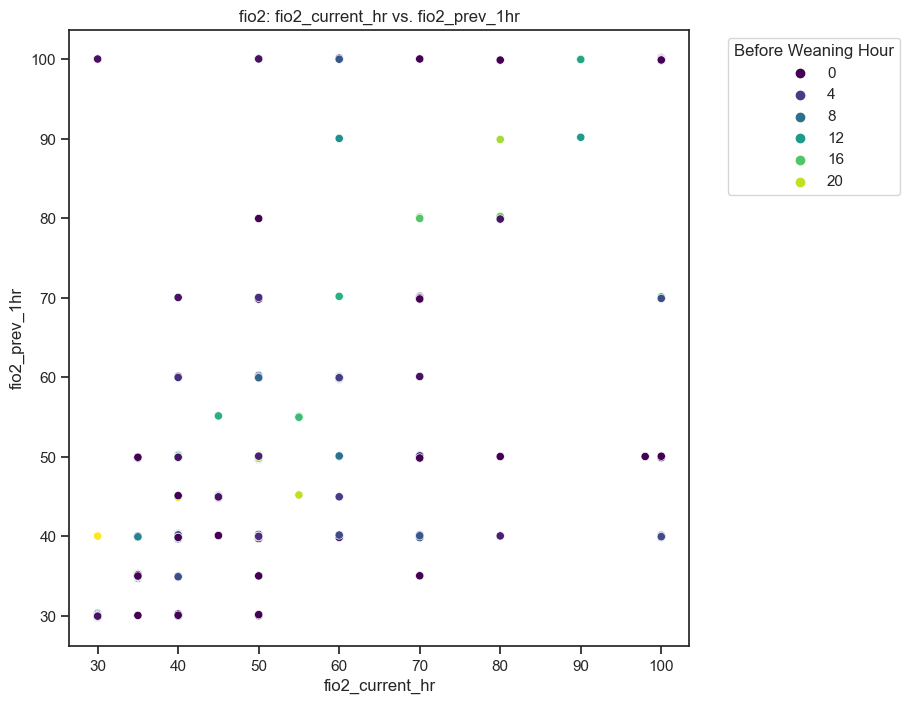

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\236036.py:81: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


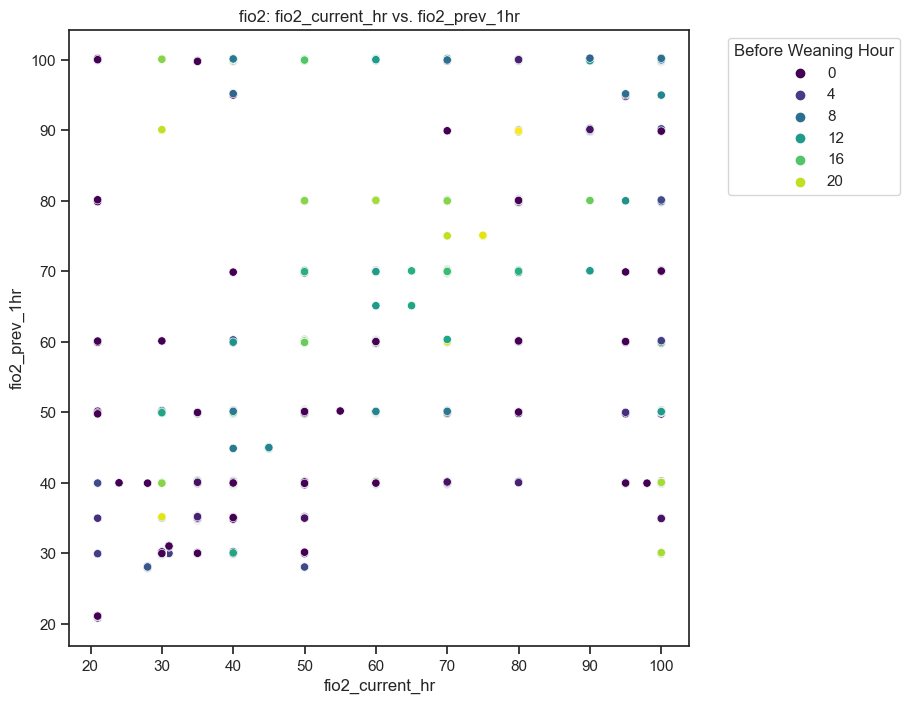

====== ventilator_settings: respiratory_rate_set =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.1081
Training Set Mean Absolute Error (MAE): 0.0871
Training Set R-squared (R2): 0.9970

Validation Set Mean Squared Error (MSE): 1.5334
Validation Set Mean Absolute Error (MAE): 0.2825
Validation Set R-squared (R2): 0.9618

----- train -----


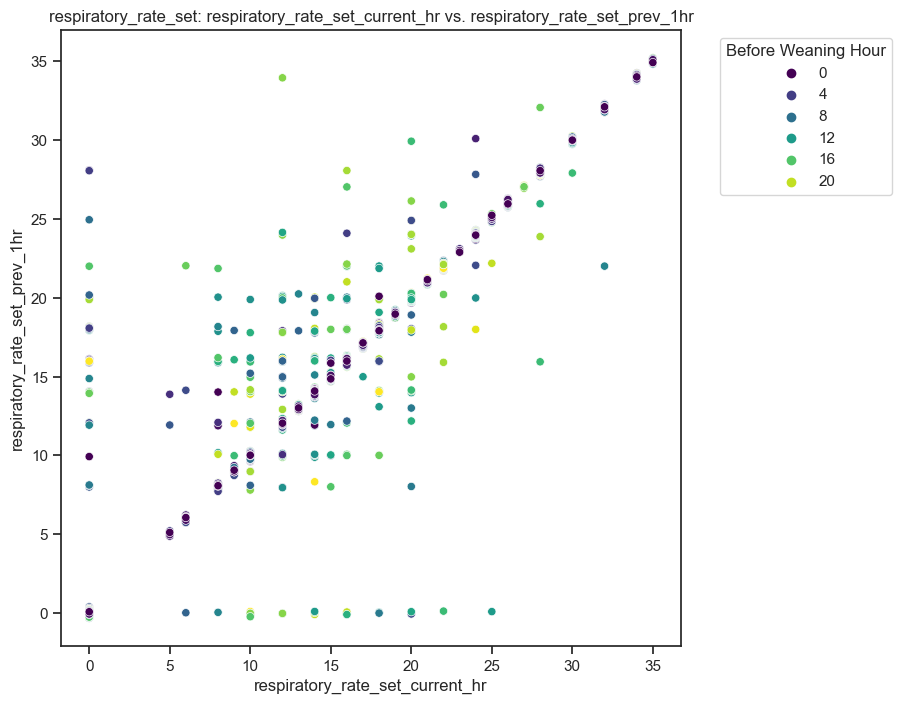

----- val -----


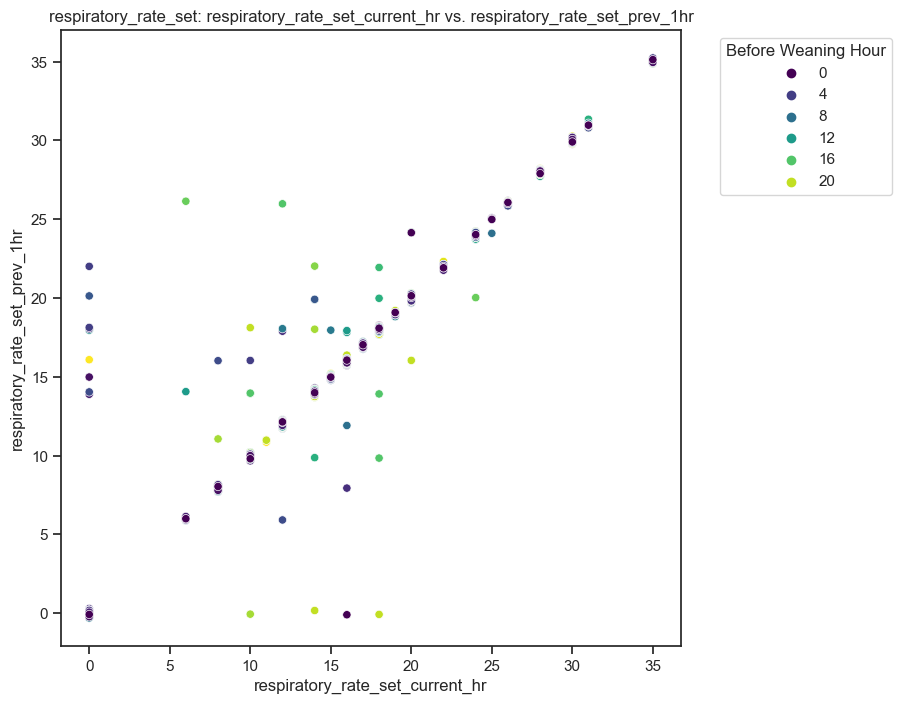

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\236036.py:81: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


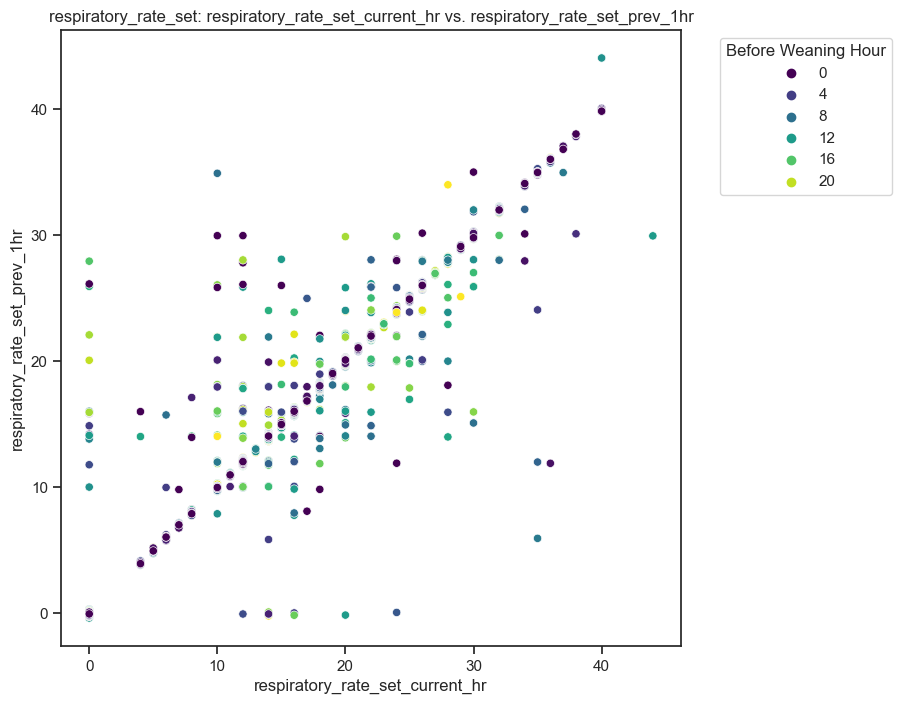

====== ventilator_settings: plateau_pressure =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.0758
Training Set Mean Absolute Error (MAE): 0.0814
Training Set R-squared (R2): 0.9962

Validation Set Mean Squared Error (MSE): 0.4310
Validation Set Mean Absolute Error (MAE): 0.1941
Validation Set R-squared (R2): 0.9745

----- train -----


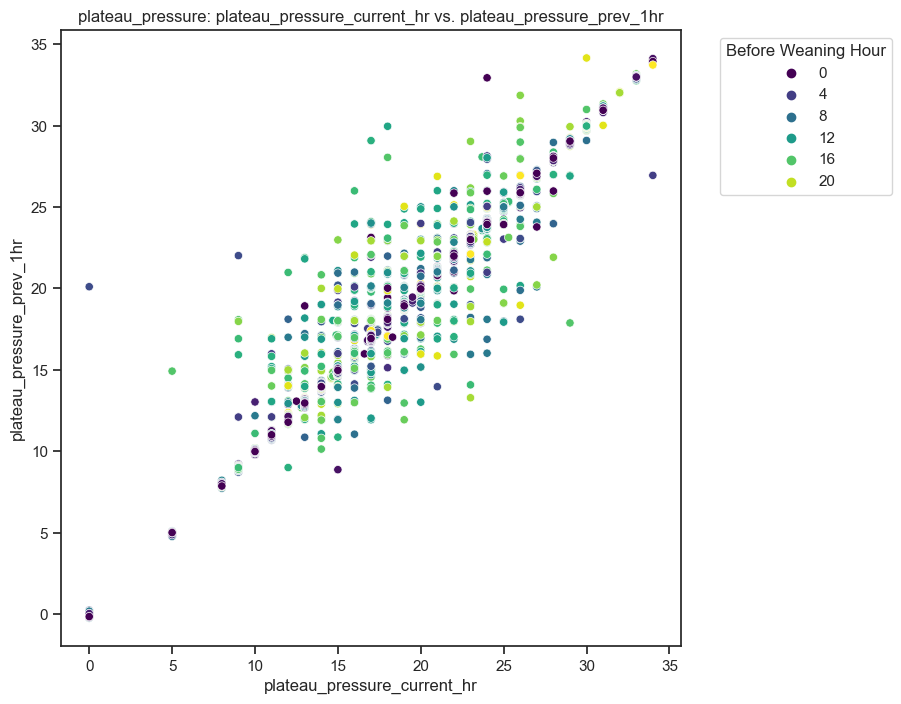

----- val -----


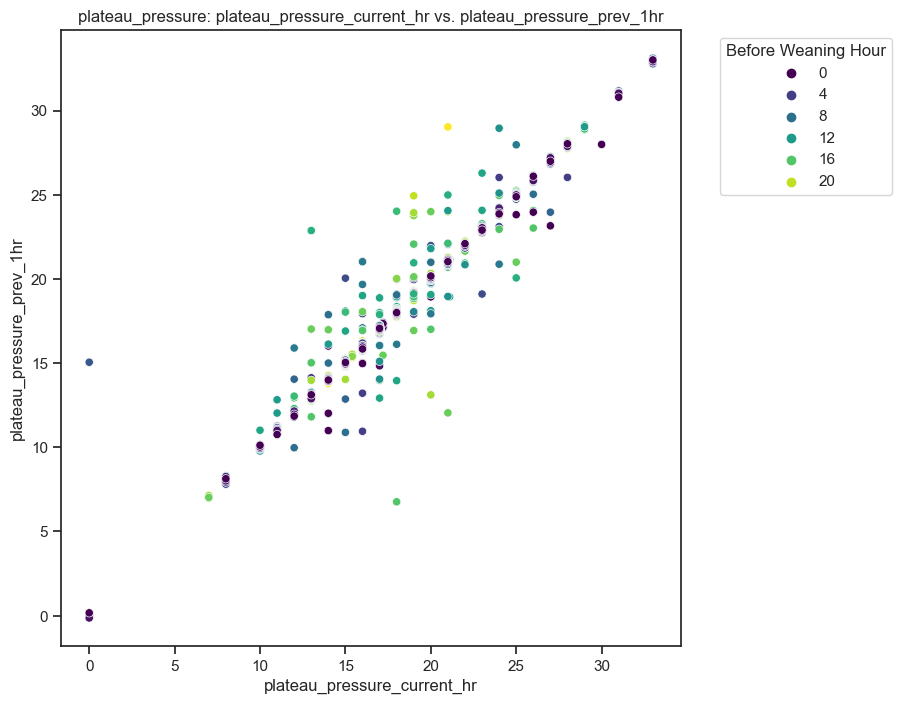

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\236036.py:81: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


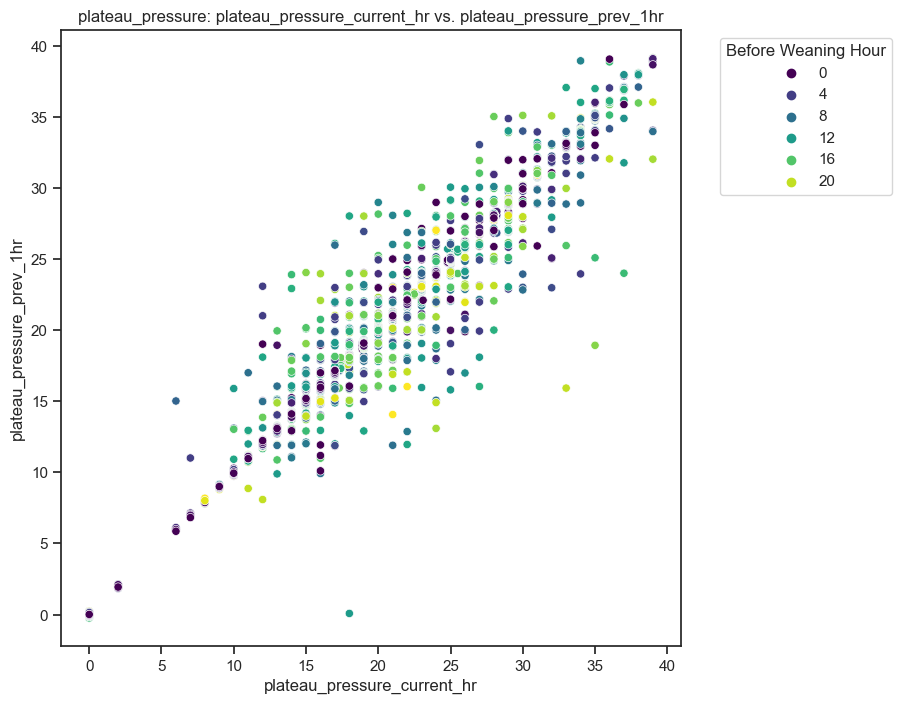

In [347]:
visual_mode = 2
for vese in ventilator_settings:
    print(f'====== ventilator_settings: {vese} =====')
    print('----- positive label -----')
    # X_train, y_train, X_val, y_val, X_test, y_test = split_data(group_pre_1hr_visi_vese_df, X_cols, vese)
    X_train, y_train, X_val, y_val = split_data(group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df,
                                                group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df, X_cols, vese)
    model = intuition_regression_model(X_train, y_train, X_val, y_val, vese, visual_mode)
    print('----- negative label -----')
    X_train_negative, y_train_negative, X_val_negative, y_val_negative = split_data(group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df,
                                                                                    group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df, X_cols, vese)
    X_val_df = pd.concat([X_train_negative, X_val_negative], axis=0)
    y_val_df = pd.concat([y_train_negative, y_val_negative], axis=0)
    y_val_pred = model.predict(X_val_df)
    visualize_predict_ground_truth(X_val_df, y_val_df, y_val_pred, vese, visual_mode)

====== ventilator_settings: peep =====
----- positive label -----


Training Set Mean Squared Error (MSE): 0.3083
Training Set Mean Absolute Error (MAE): 0.2269
Training Set R-squared (R2): 0.9482

Validation Set Mean Squared Error (MSE): 1.0924
Validation Set Mean Absolute Error (MAE): 0.4342
Validation Set R-squared (R2): 0.8007

Test Set Mean Squared Error (MSE): 1.1336
Test Set Mean Absolute Error (MAE): 0.4513
Test Set R-squared (R2): 0.8037



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


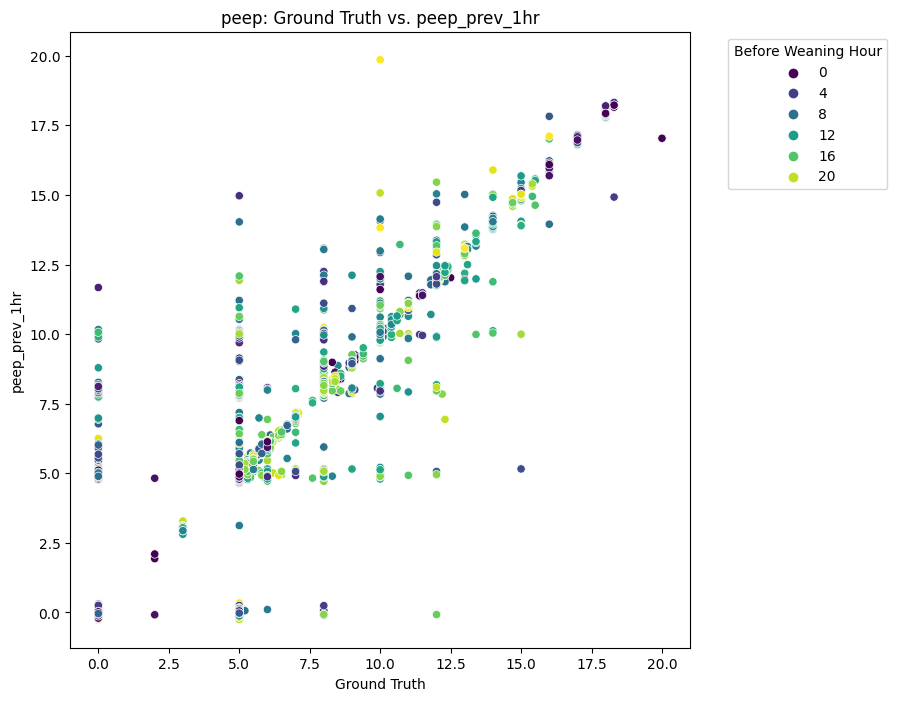

C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


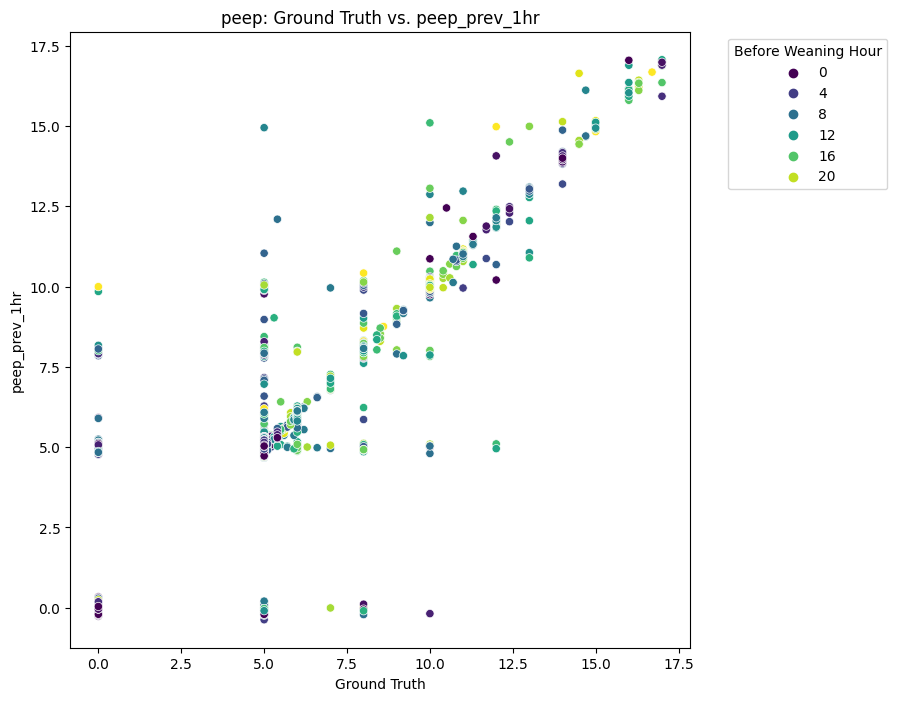

C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


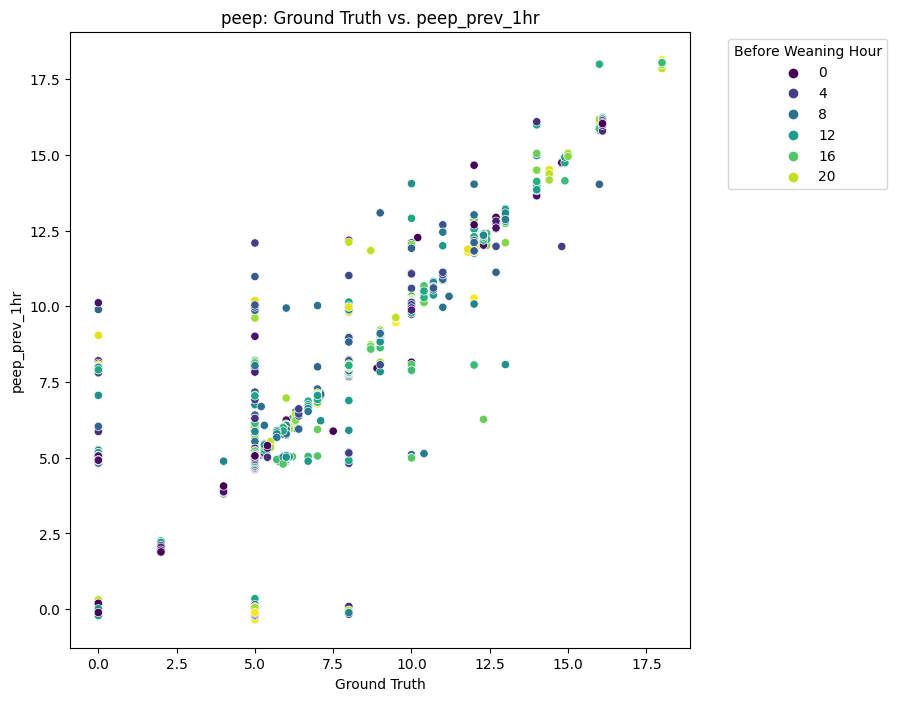

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


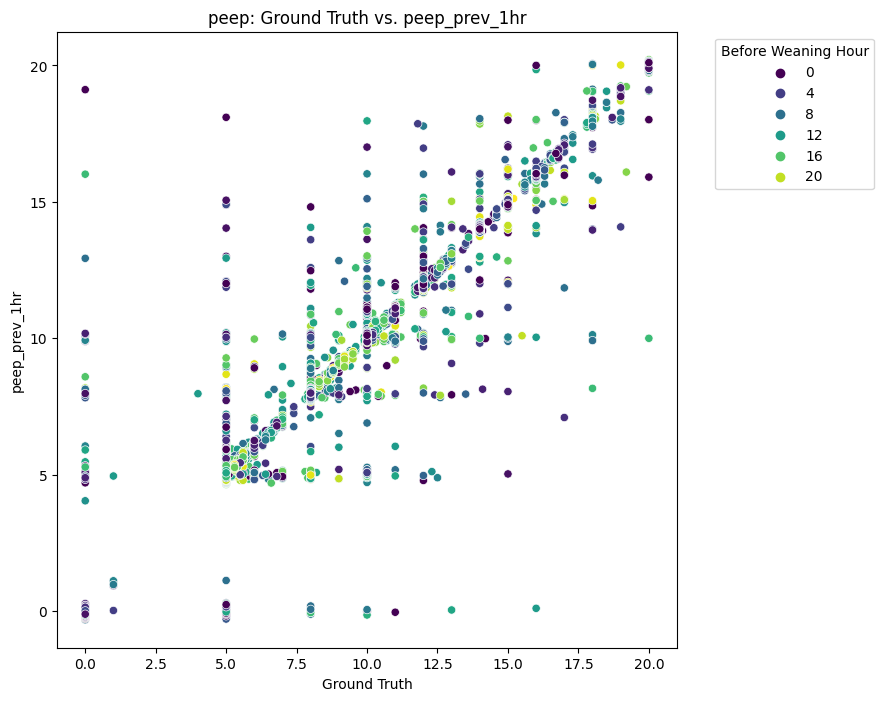

====== ventilator_settings: fio2 =====
----- positive label -----
Training Set Mean Squared Error (MSE): 4.0024
Training Set Mean Absolute Error (MAE): 0.6850
Training Set R-squared (R2): 0.9549

Validation Set Mean Squared Error (MSE): 25.6536
Validation Set Mean Absolute Error (MAE): 1.5430
Validation Set R-squared (R2): 0.6910

Test Set Mean Squared Error (MSE): 21.3183
Test Set Mean Absolute Error (MAE): 1.4367
Test Set R-squared (R2): 0.7288



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


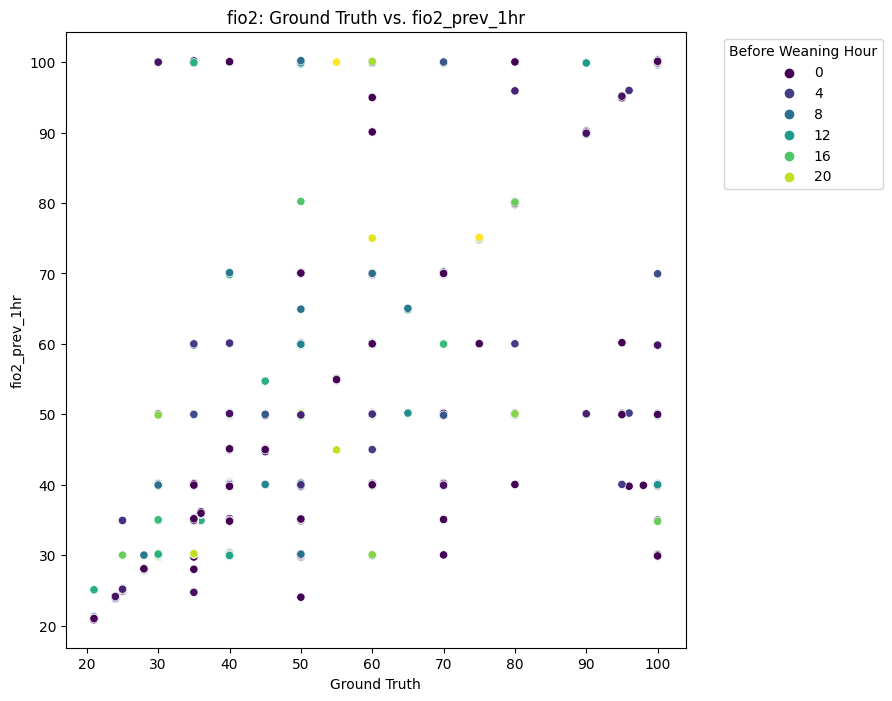

C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


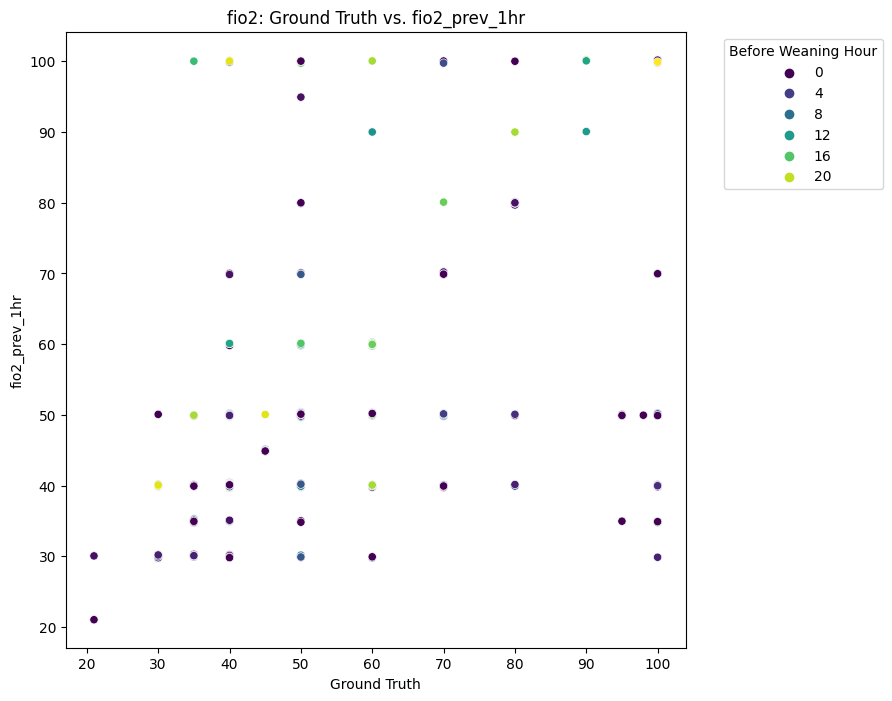

C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


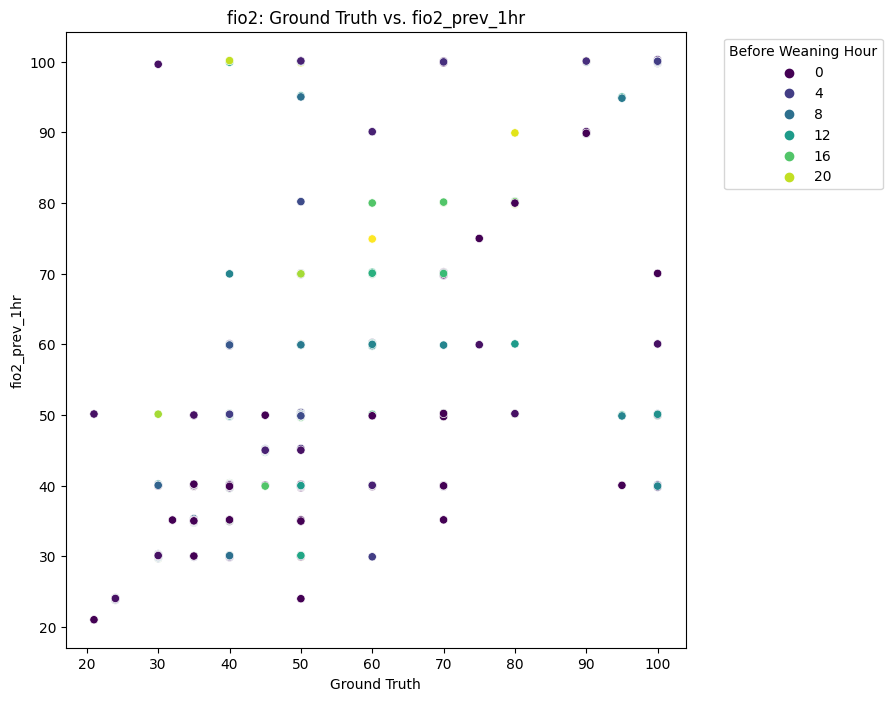

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


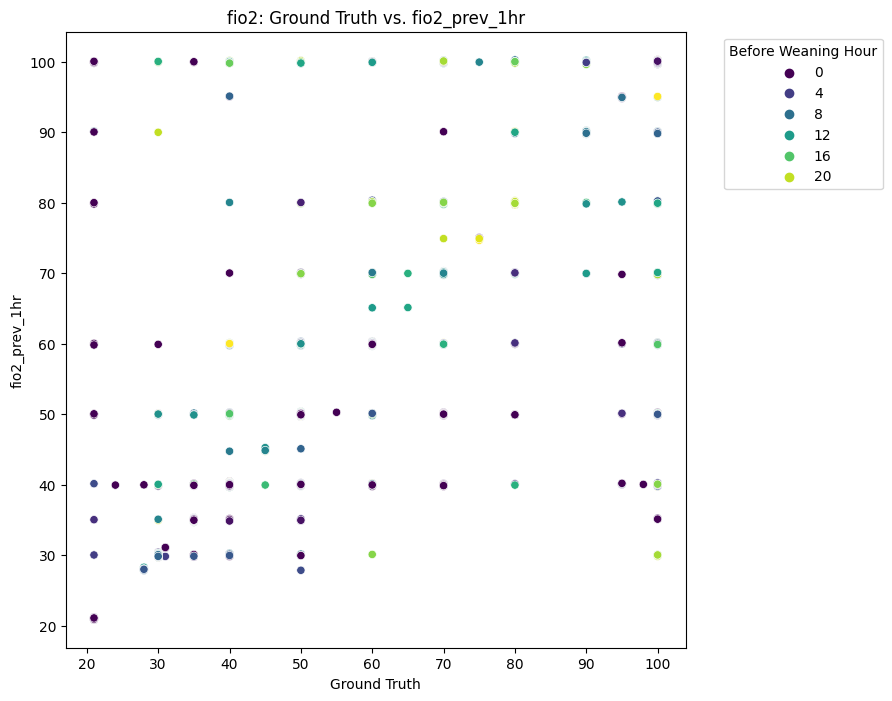

====== ventilator_settings: respiratory_rate_set =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.0853
Training Set Mean Absolute Error (MAE): 0.0844
Training Set R-squared (R2): 0.9977

Validation Set Mean Squared Error (MSE): 1.8037
Validation Set Mean Absolute Error (MAE): 0.2977
Validation Set R-squared (R2): 0.9507

Test Set Mean Squared Error (MSE): 1.7439
Test Set Mean Absolute Error (MAE): 0.3099
Test Set R-squared (R2): 0.9543



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


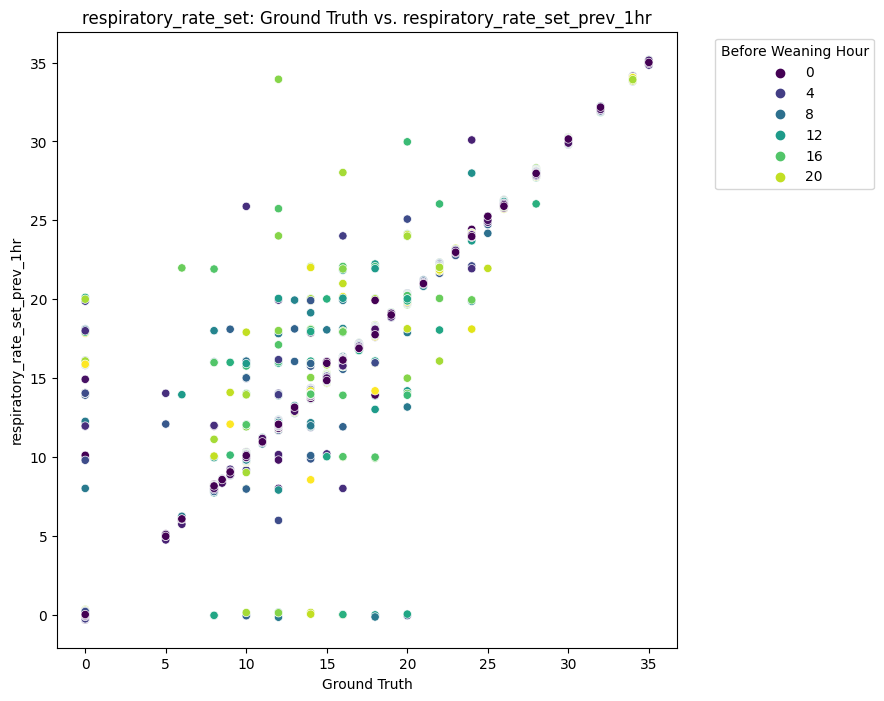

C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


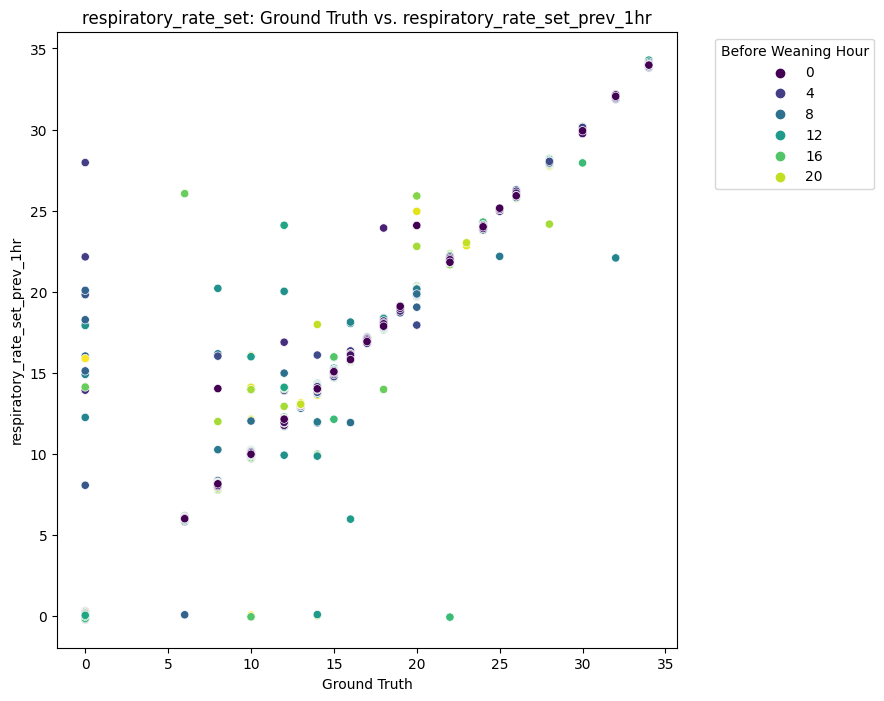

C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


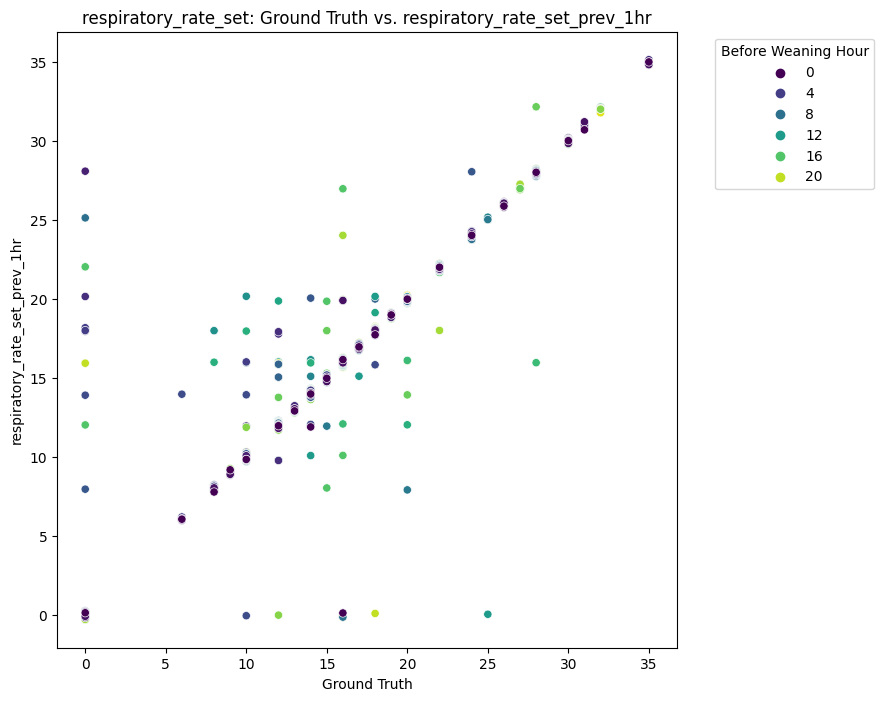

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


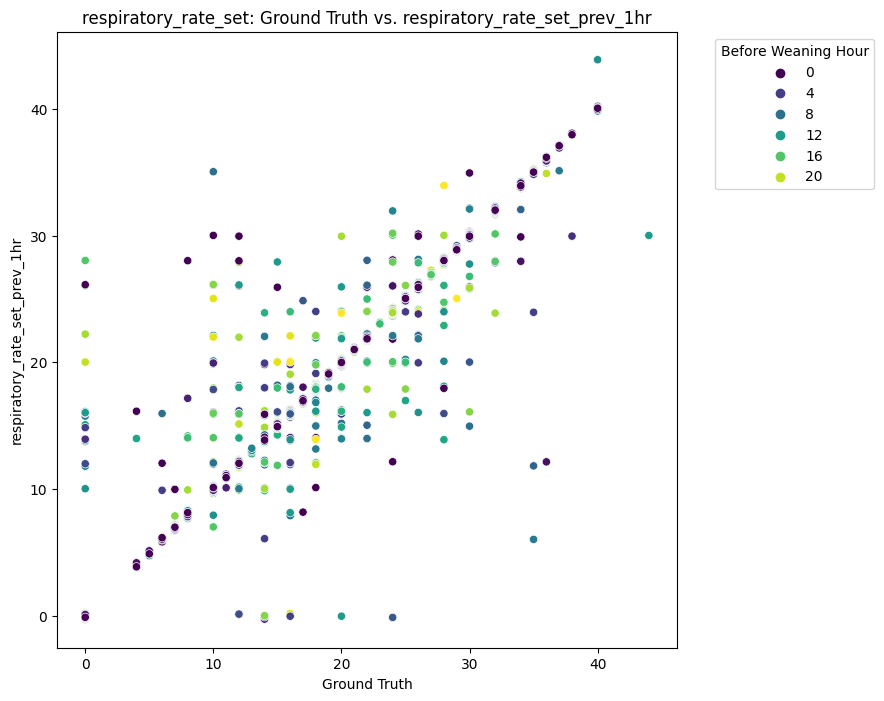

====== ventilator_settings: plateau_pressure =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.0660
Training Set Mean Absolute Error (MAE): 0.0827
Training Set R-squared (R2): 0.9966

Validation Set Mean Squared Error (MSE): 0.3327
Validation Set Mean Absolute Error (MAE): 0.1759
Validation Set R-squared (R2): 0.9846

Test Set Mean Squared Error (MSE): 0.3870
Test Set Mean Absolute Error (MAE): 0.1909
Test Set R-squared (R2): 0.9802



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


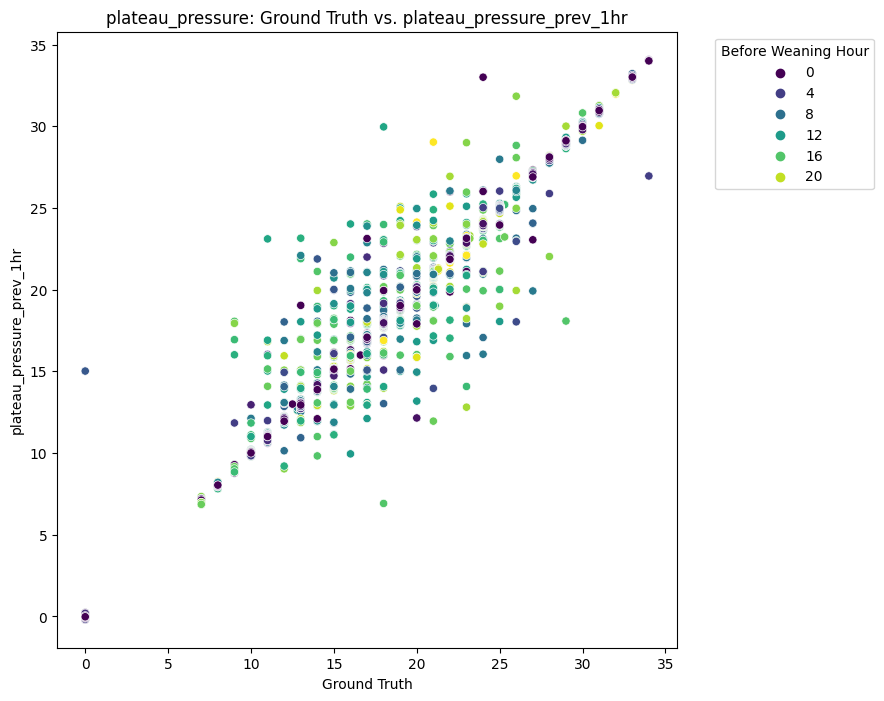

C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


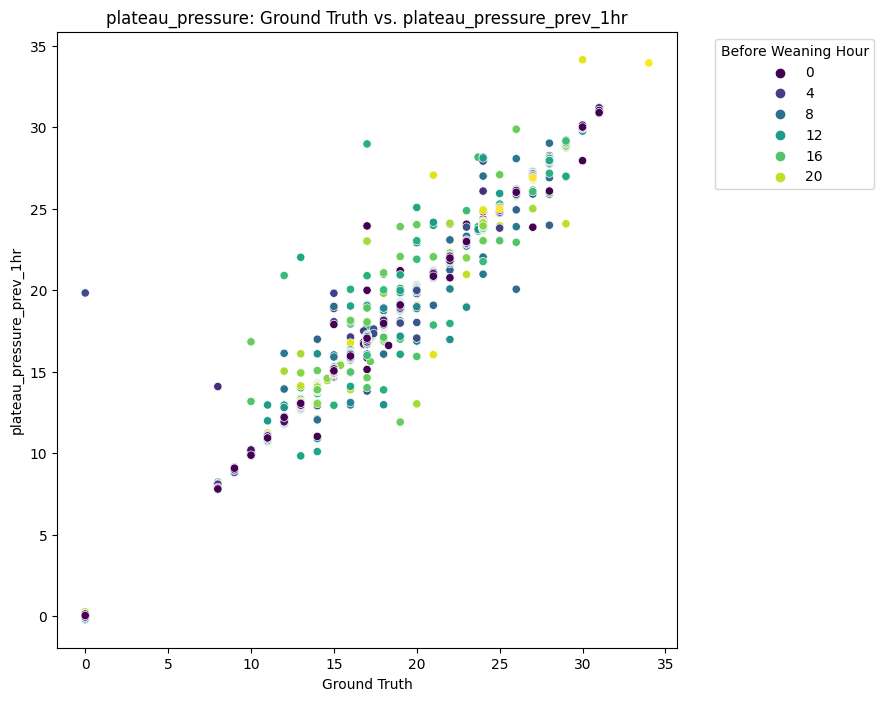

C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


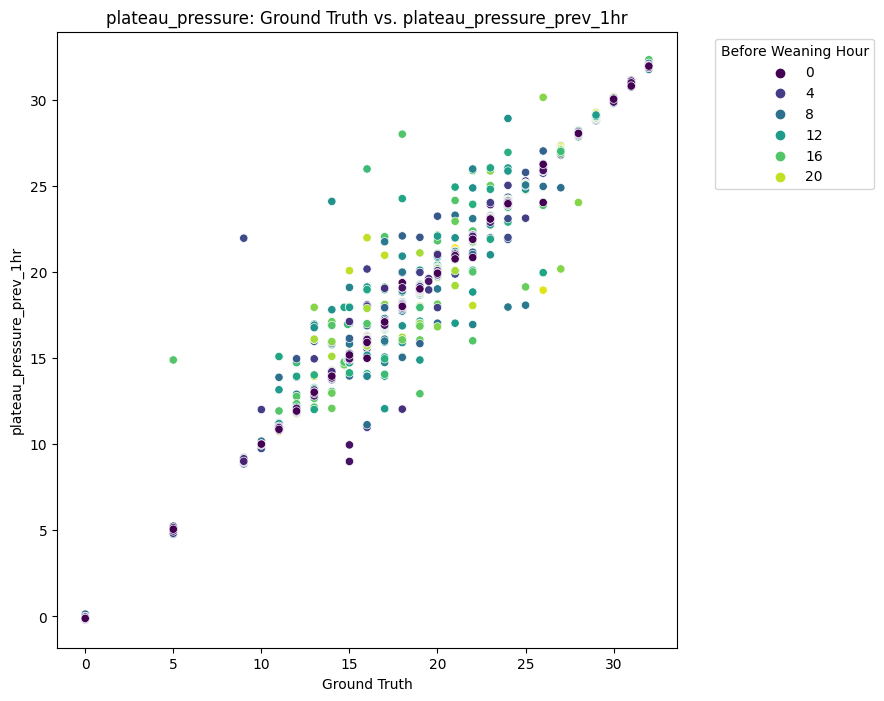

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\956868329.py:51: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=X[f"{feature}_prev_1h"], hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


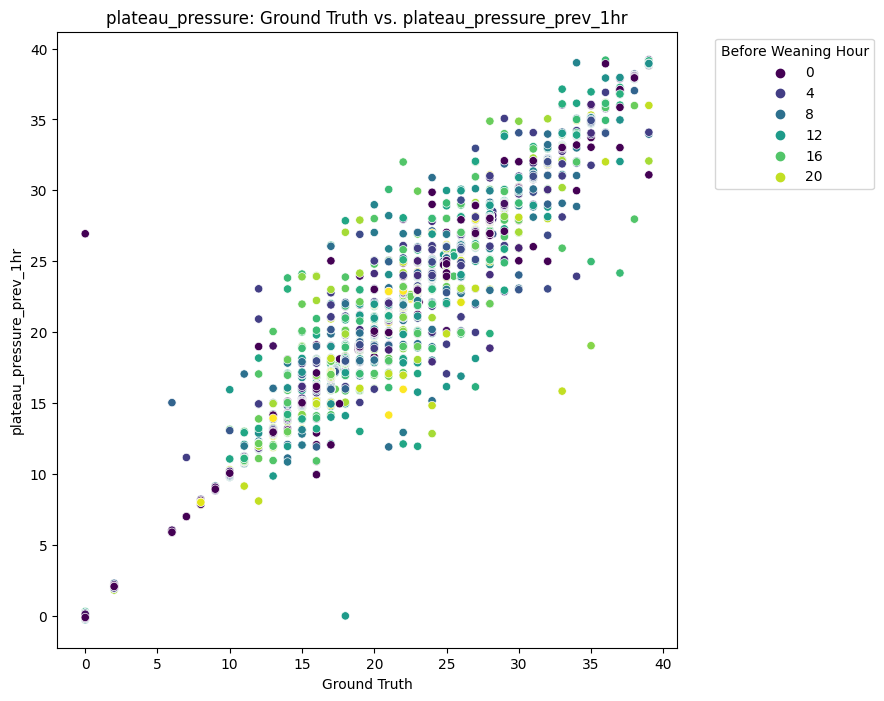

In [18]:
visual_mode = 2
for vese in ventilator_settings:
    print(f'====== ventilator_settings: {vese} =====')
    print('----- positive label -----')
    X_train, y_train, X_val, y_val, X_test, y_test = split_data(group_pre_1hr_visi_vese_df, X_cols, vese)
    model = intuition_regression_model(X_train, y_train, X_val, y_val, X_test, y_test, vese, visual_mode)
    print('----- negative label -----')
    X_train_negative, y_train_negative, X_val_negative, y_val_negative, X_test_negative, y_test_negative = split_data(group_pre_1hr_visi_vese_negative_df, X_cols, vese)
    X_val_df = pd.concat([X_train_negative, X_val_negative, X_test_negative], axis=0)
    y_val_df = pd.concat([y_train_negative, y_val_negative, y_test_negative], axis=0)
    y_val_pred = model.predict(X_val_df)
    visualize_predict_ground_truth(X_val_df, y_val_df, y_val_pred, vese, visual_mode)

#### prediction vs. ground truth

====== ventilator_settings: peep =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.3595
Training Set Mean Absolute Error (MAE): 0.2338
Training Set R-squared (R2): 0.9393

Validation Set Mean Squared Error (MSE): 1.1219
Validation Set Mean Absolute Error (MAE): 0.4445
Validation Set R-squared (R2): 0.8063

----- train -----


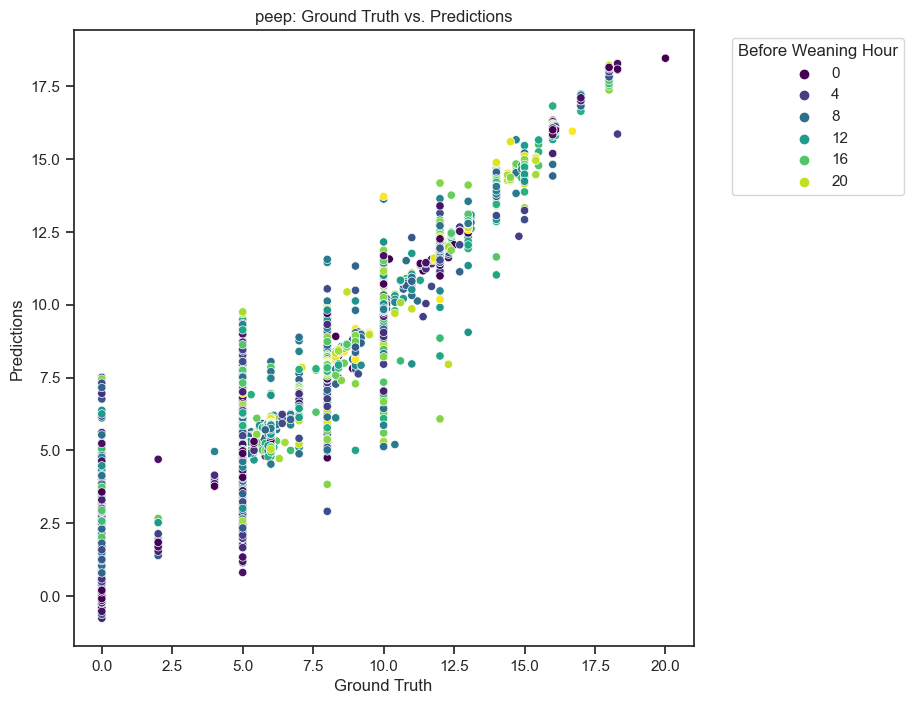

----- val -----


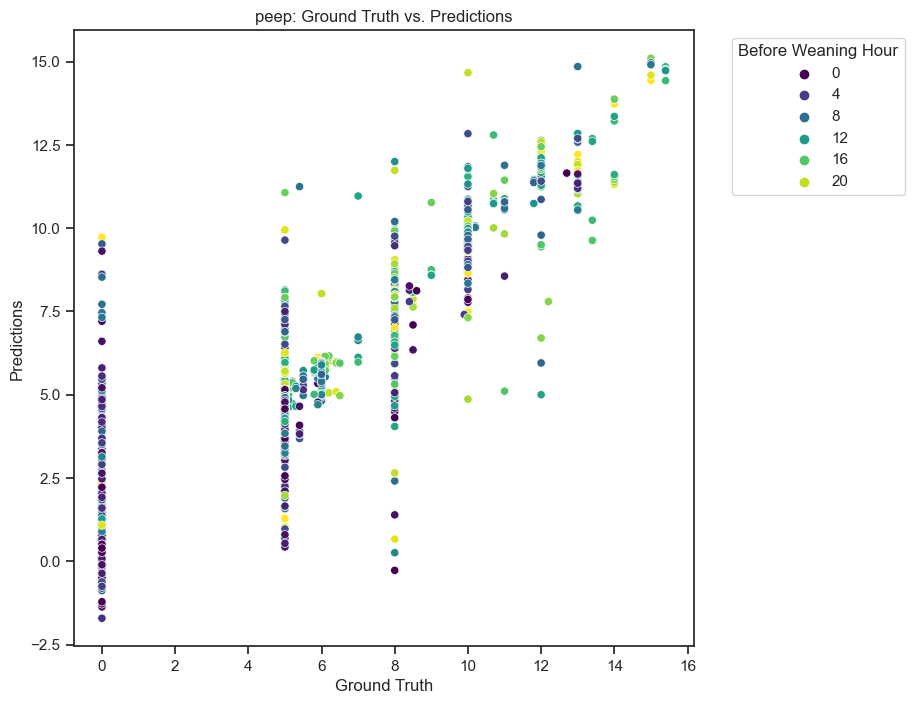

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 5.6546
positive change row train Mean Absolute Error (MAE): 1.9317
positive change row train R-squared (R2): 0.6044



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


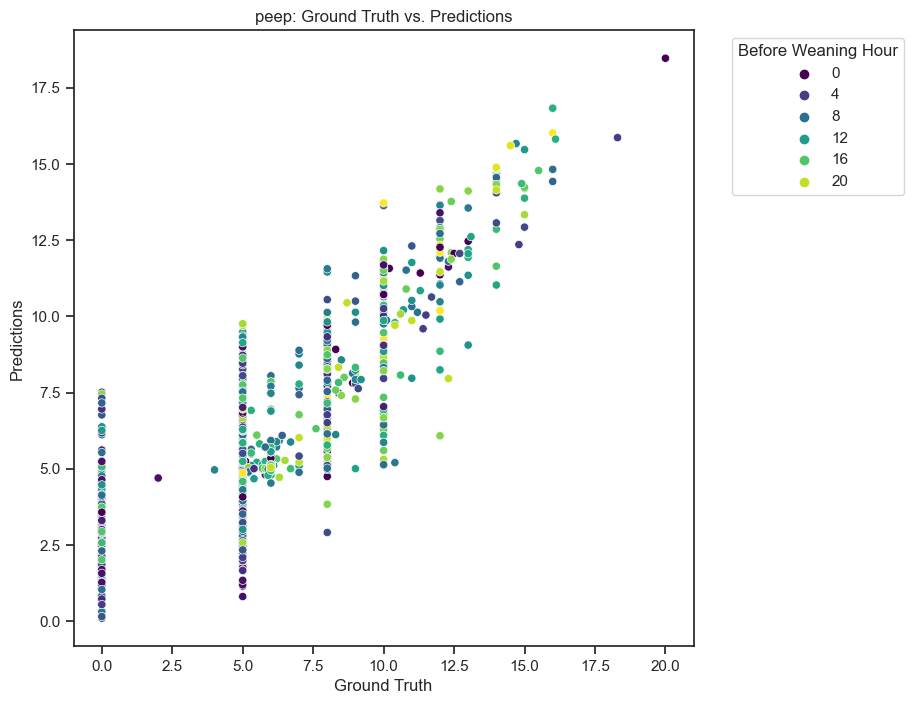

positive change row val Mean Squared Error (MSE): 13.5760
positive change row val Mean Absolute Error (MAE): 3.0363
positive change row val R-squared (R2): 0.0608



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


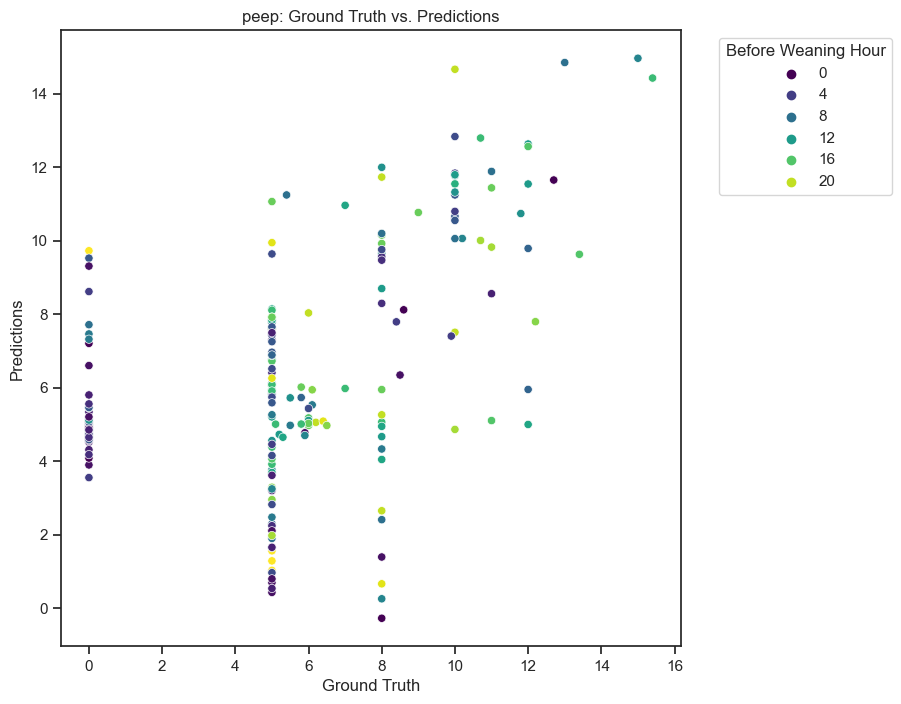

----- negative label -----
negative label Mean Squared Error (MSE): 1.5897
negative label Mean Absolute Error (MAE): 0.5611
negative label R-squared (R2): 0.8616



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


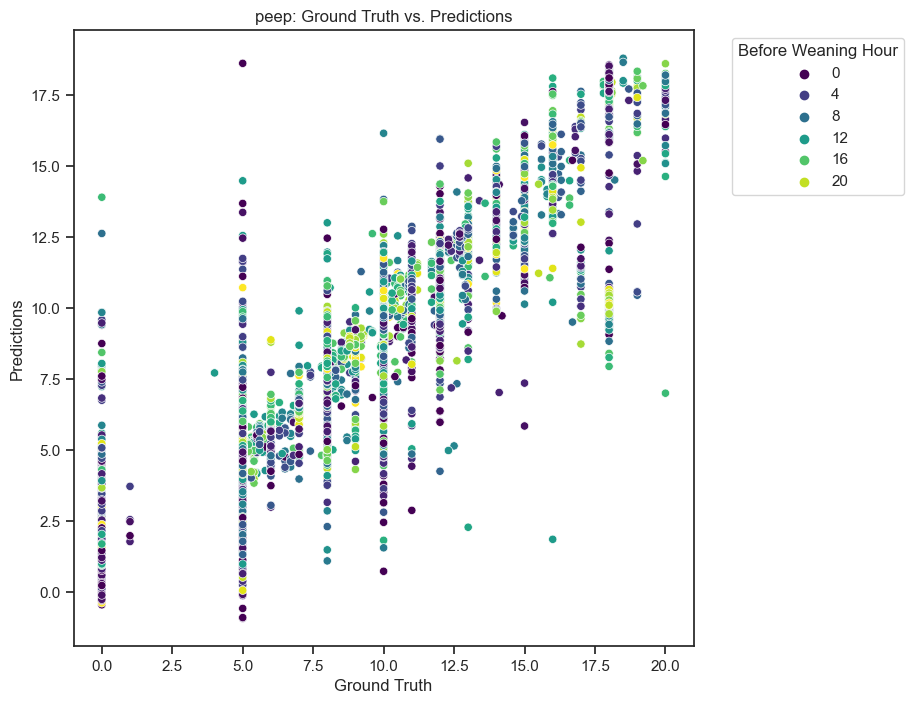

----- negative label change row -----
negative change row Mean Squared Error (MSE): 11.5292
negative change row Mean Absolute Error (MAE): 2.6299
negative change row R-squared (R2): 0.4645



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


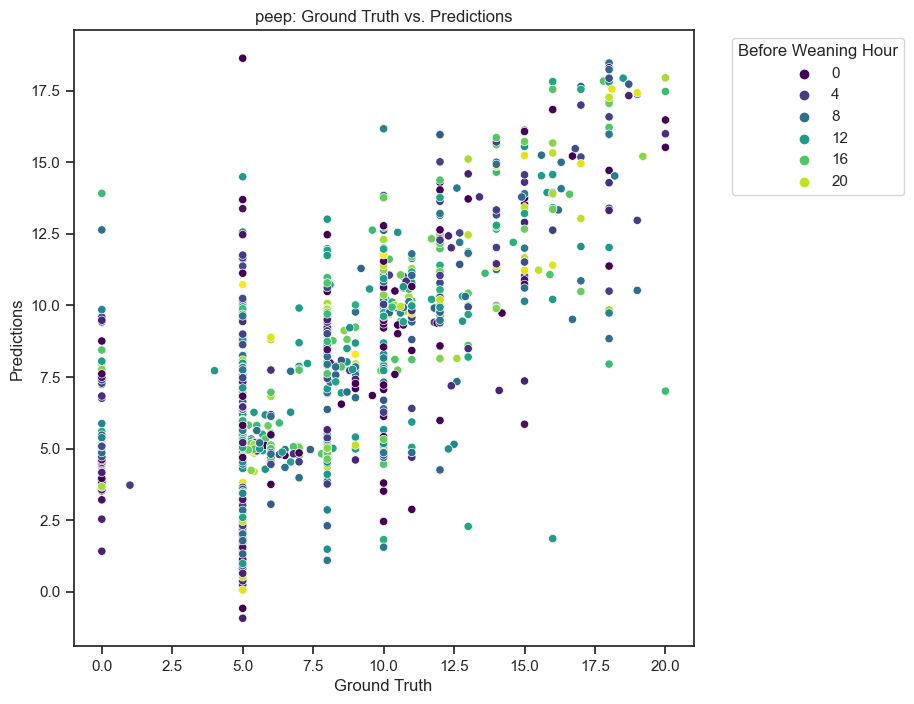

====== ventilator_settings: fio2 =====
----- positive label -----
Training Set Mean Squared Error (MSE): 4.5649
Training Set Mean Absolute Error (MAE): 0.6629
Training Set R-squared (R2): 0.9453

Validation Set Mean Squared Error (MSE): 25.6386
Validation Set Mean Absolute Error (MAE): 1.5680
Validation Set R-squared (R2): 0.6938

----- train -----


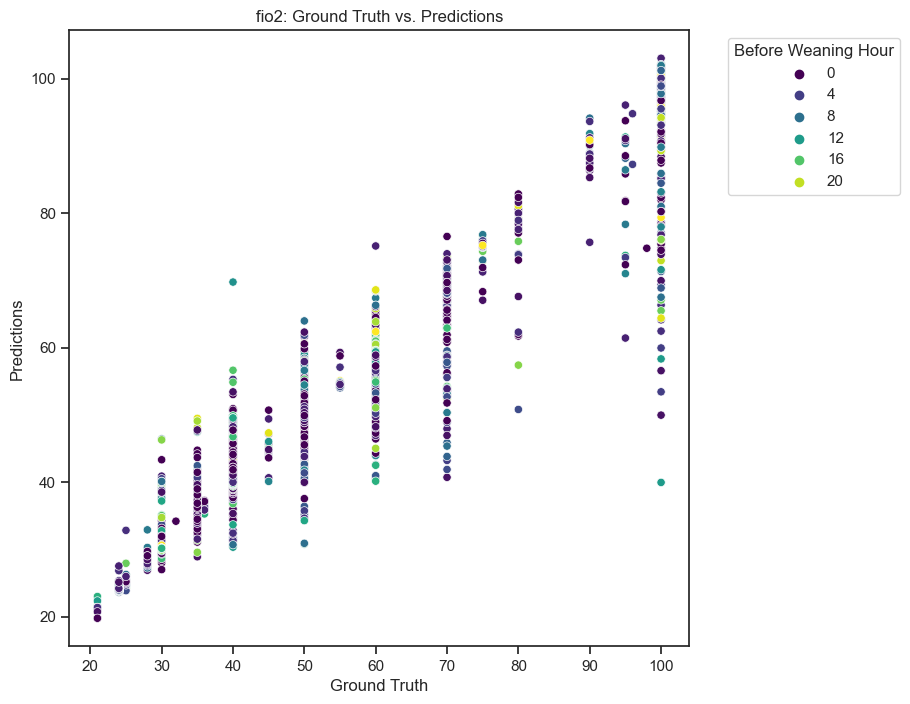

----- val -----


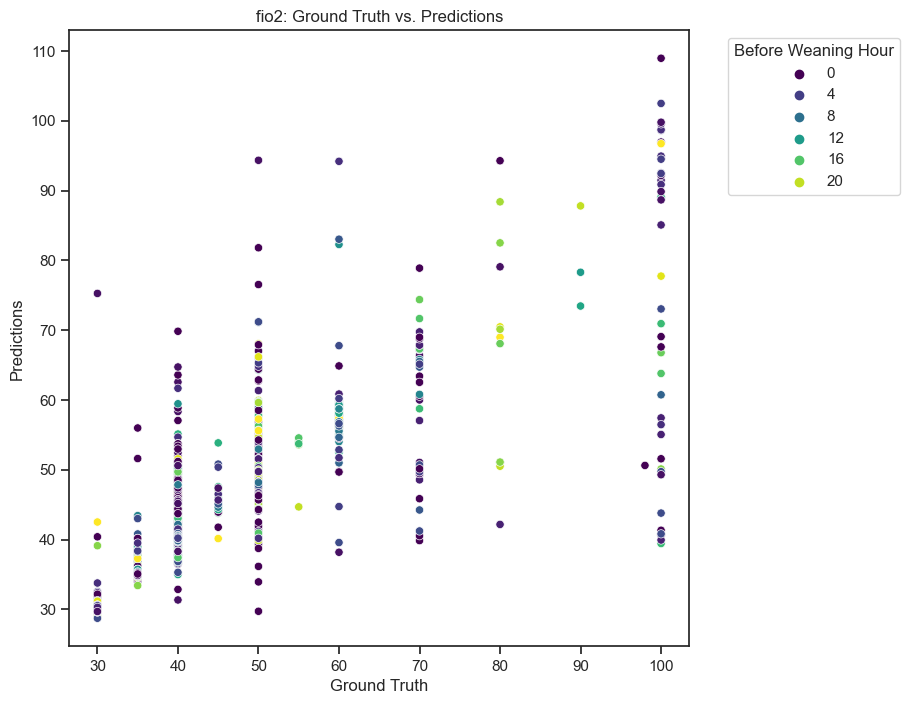

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 104.8810
positive change row train Mean Absolute Error (MAE): 7.7425
positive change row train R-squared (R2): 0.6998



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


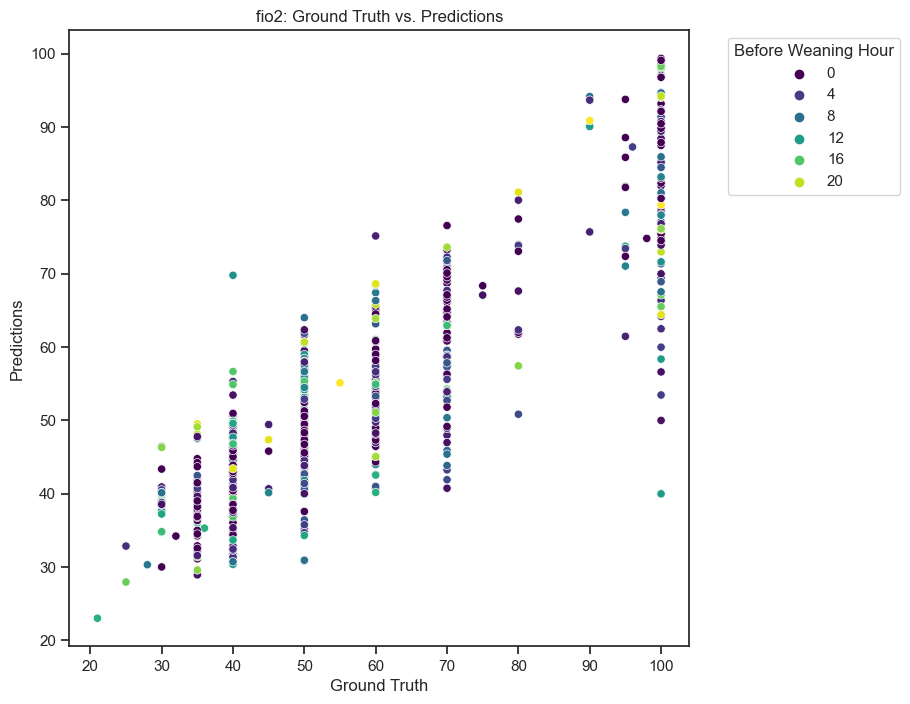

positive change row val Mean Squared Error (MSE): 469.9732
positive change row val Mean Absolute Error (MAE): 16.6167
positive change row val R-squared (R2): -0.2724



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


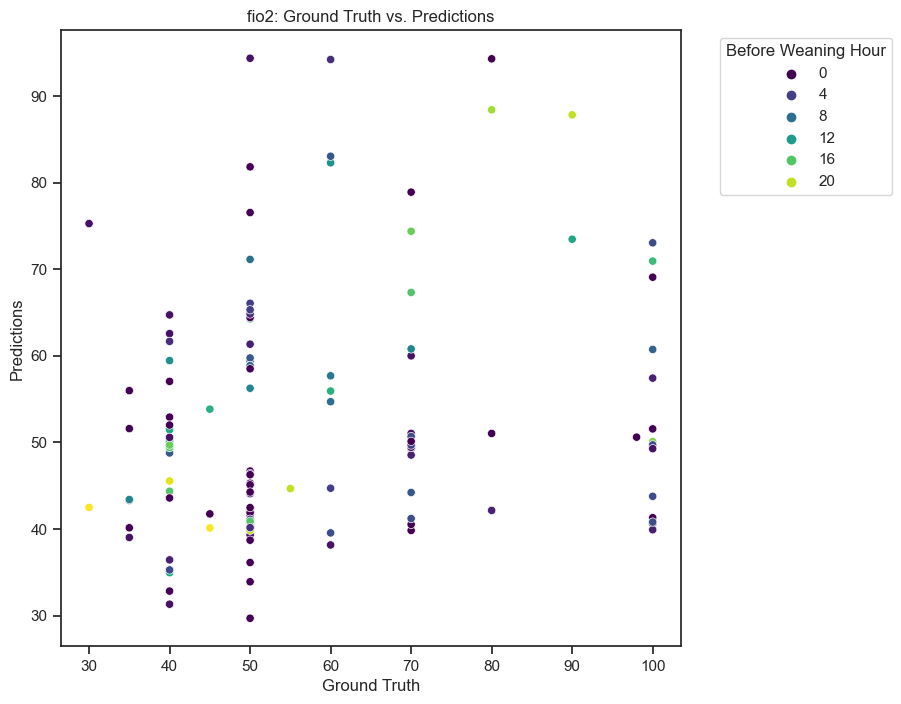

----- negative label -----
negative label Mean Squared Error (MSE): 75.7004
negative label Mean Absolute Error (MAE): 3.0021
negative label R-squared (R2): 0.6426



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


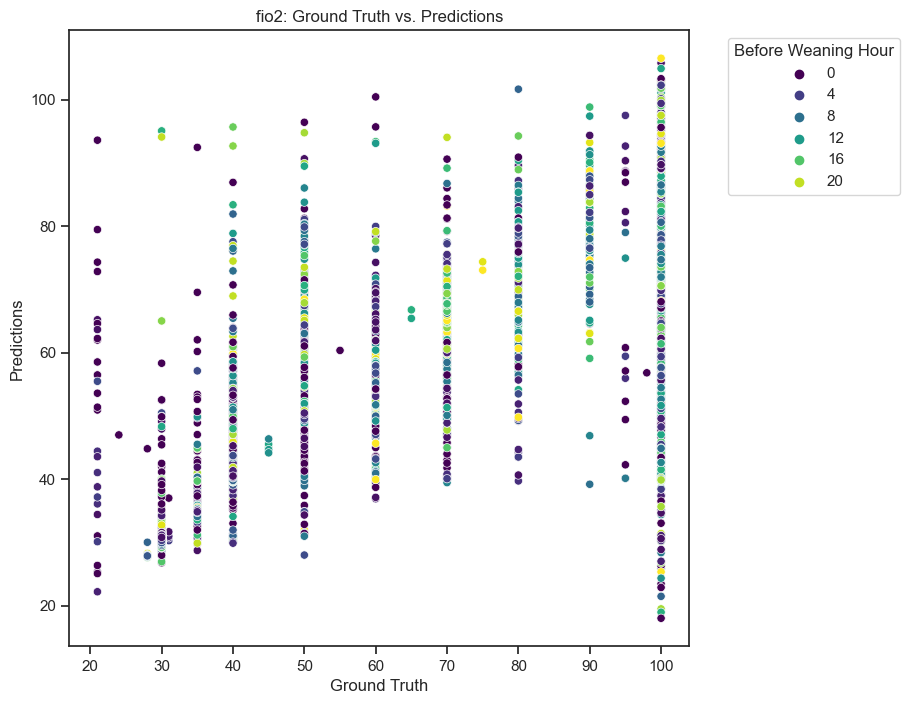

----- negative label change row -----
negative change row Mean Squared Error (MSE): 566.6953
negative change row Mean Absolute Error (MAE): 17.9268
negative change row R-squared (R2): -0.1837



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


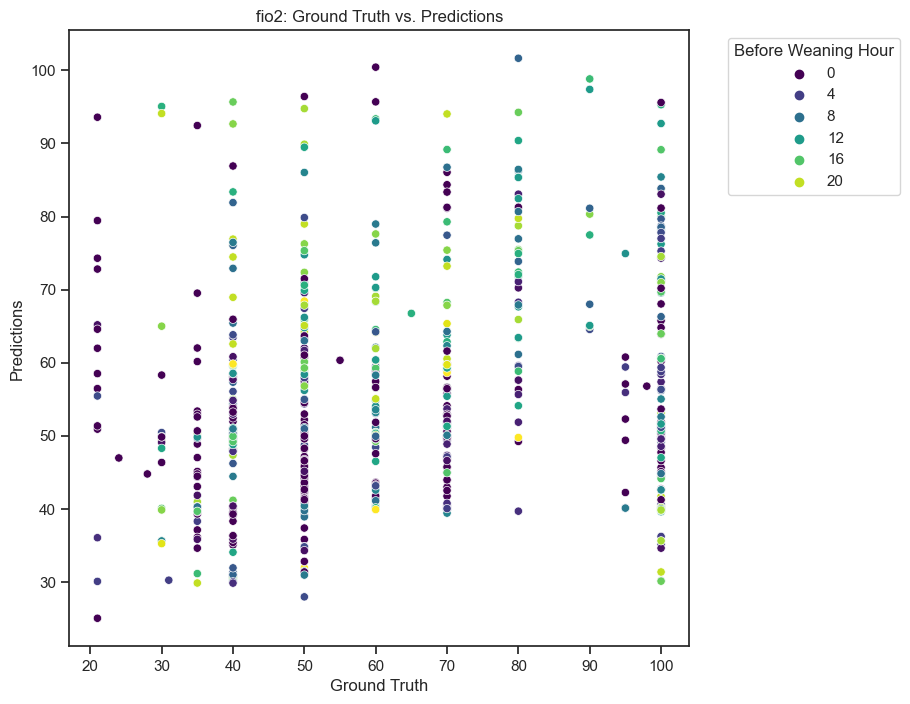

====== ventilator_settings: respiratory_rate_set =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.1081
Training Set Mean Absolute Error (MAE): 0.0871
Training Set R-squared (R2): 0.9970

Validation Set Mean Squared Error (MSE): 1.5334
Validation Set Mean Absolute Error (MAE): 0.2825
Validation Set R-squared (R2): 0.9618

----- train -----


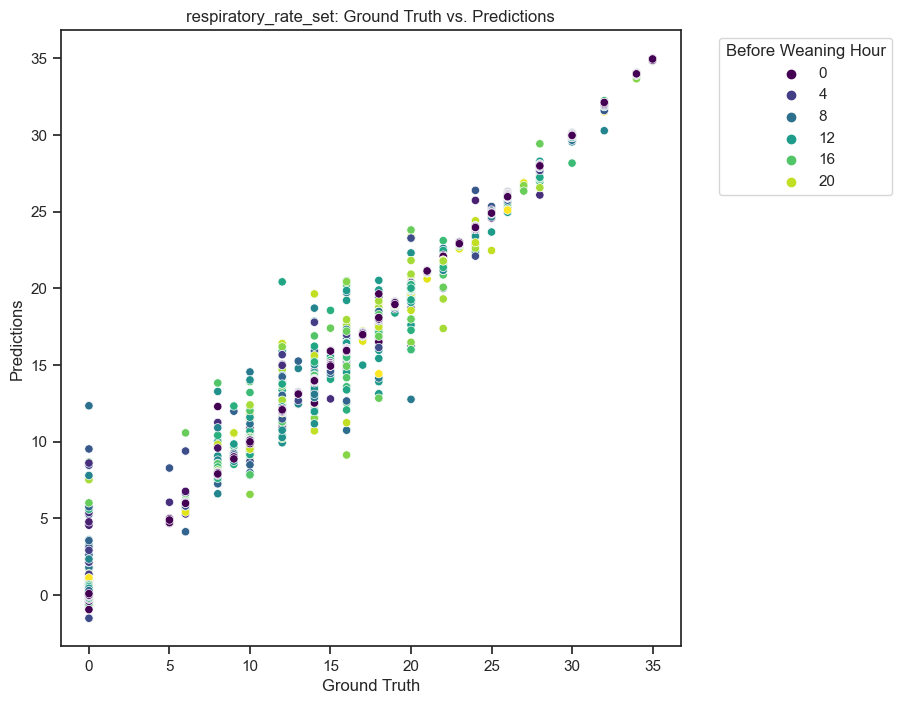

----- val -----


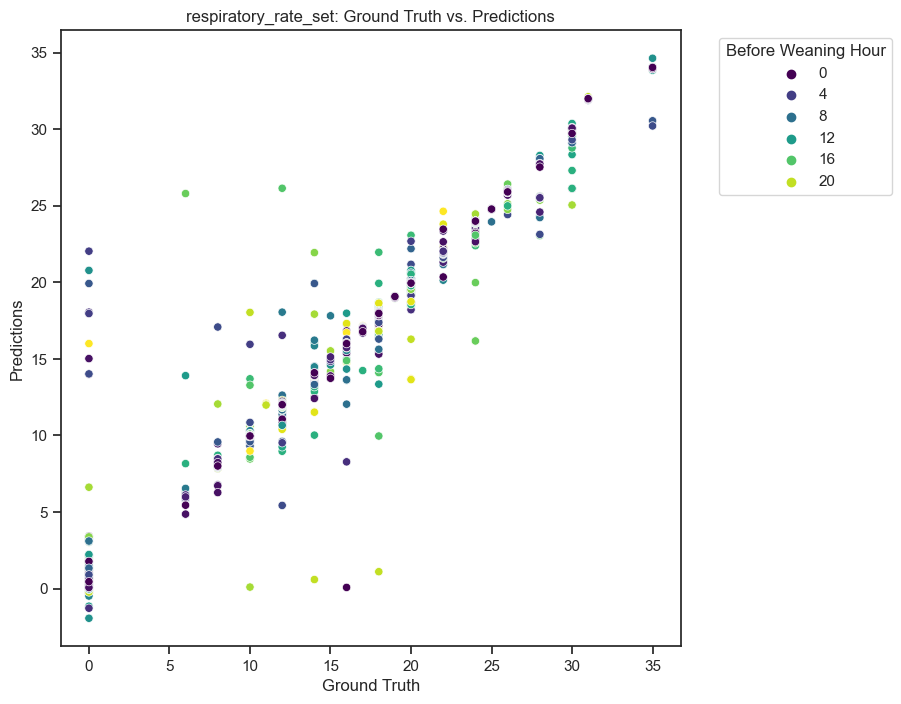

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 9.2056
positive change row train Mean Absolute Error (MAE): 2.4499
positive change row train R-squared (R2): 0.7869



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


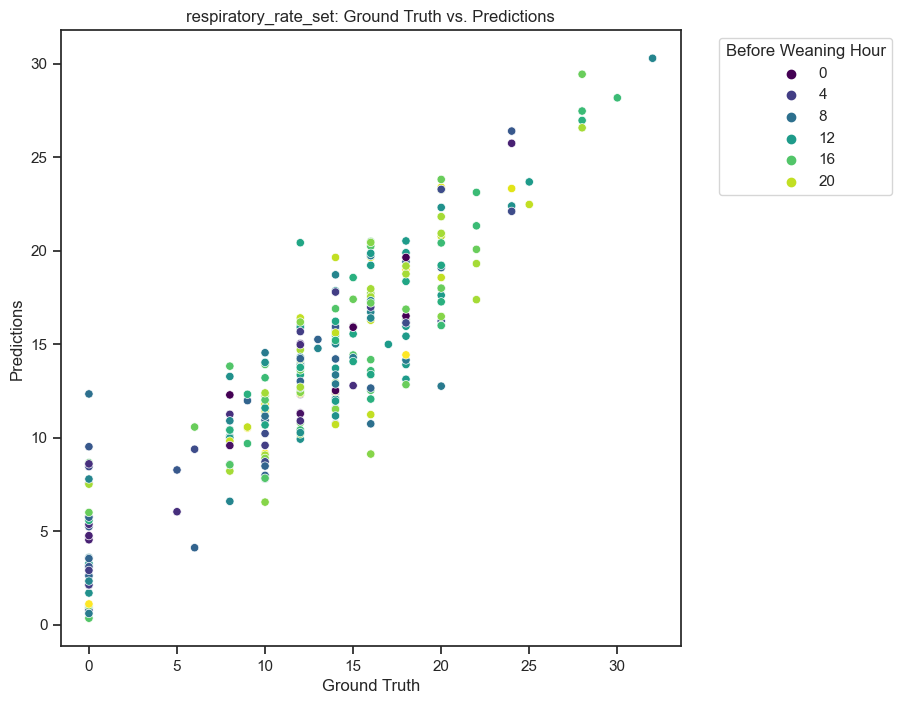

positive change row val Mean Squared Error (MSE): 114.1885
positive change row val Mean Absolute Error (MAE): 8.6673
positive change row val R-squared (R2): -1.2787



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


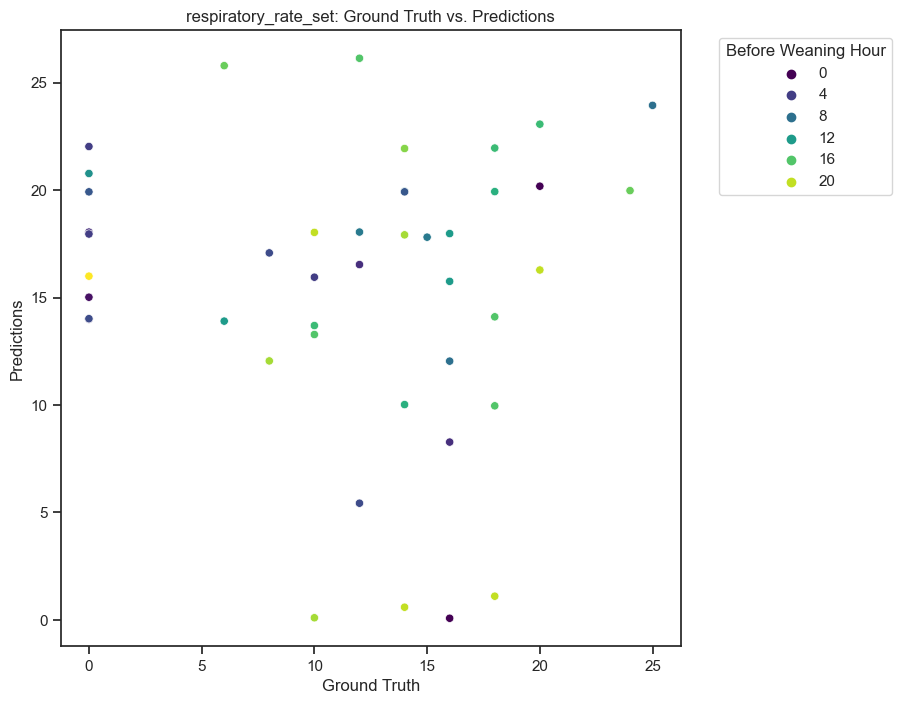

----- negative label -----
negative label Mean Squared Error (MSE): 1.6832
negative label Mean Absolute Error (MAE): 0.3664
negative label R-squared (R2): 0.9604



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


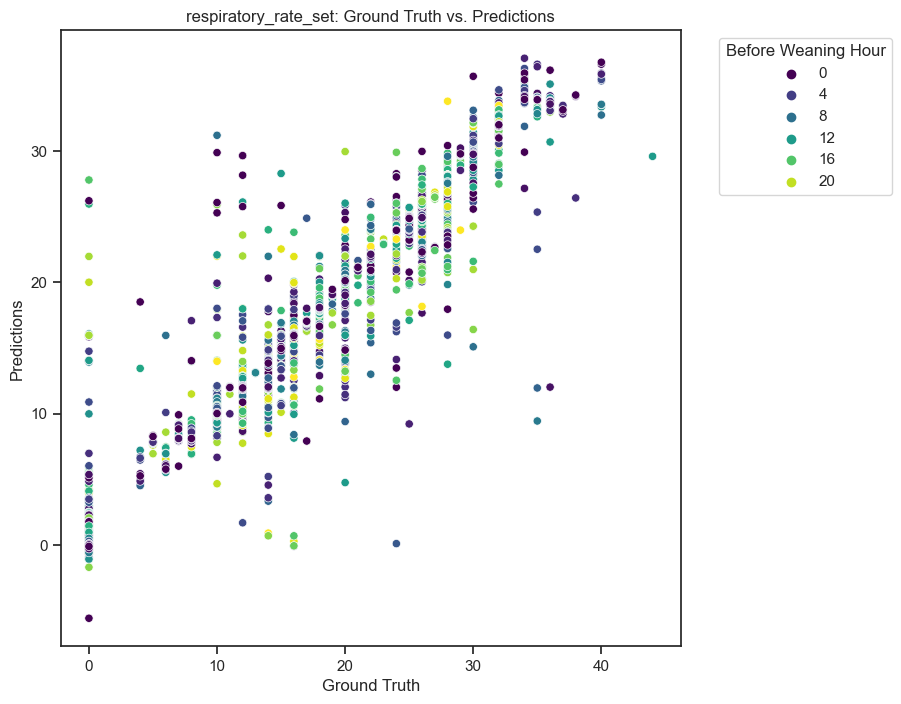

----- negative label change row -----
negative change row Mean Squared Error (MSE): 74.2134
negative change row Mean Absolute Error (MAE): 6.5194
negative change row R-squared (R2): -0.0549



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


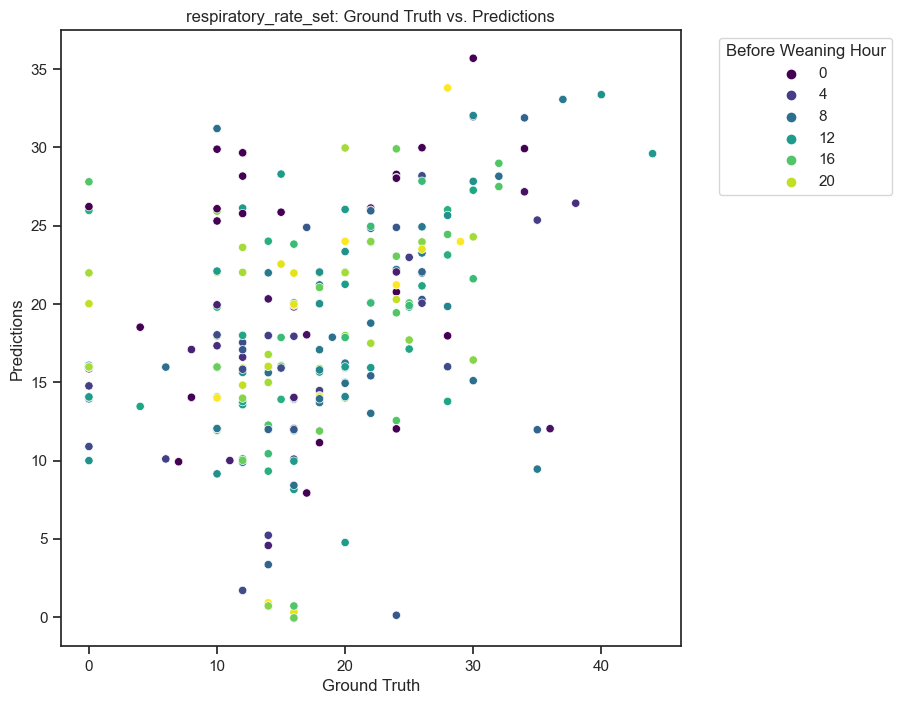

====== ventilator_settings: plateau_pressure =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.0758
Training Set Mean Absolute Error (MAE): 0.0814
Training Set R-squared (R2): 0.9962

Validation Set Mean Squared Error (MSE): 0.4310
Validation Set Mean Absolute Error (MAE): 0.1941
Validation Set R-squared (R2): 0.9745

----- train -----


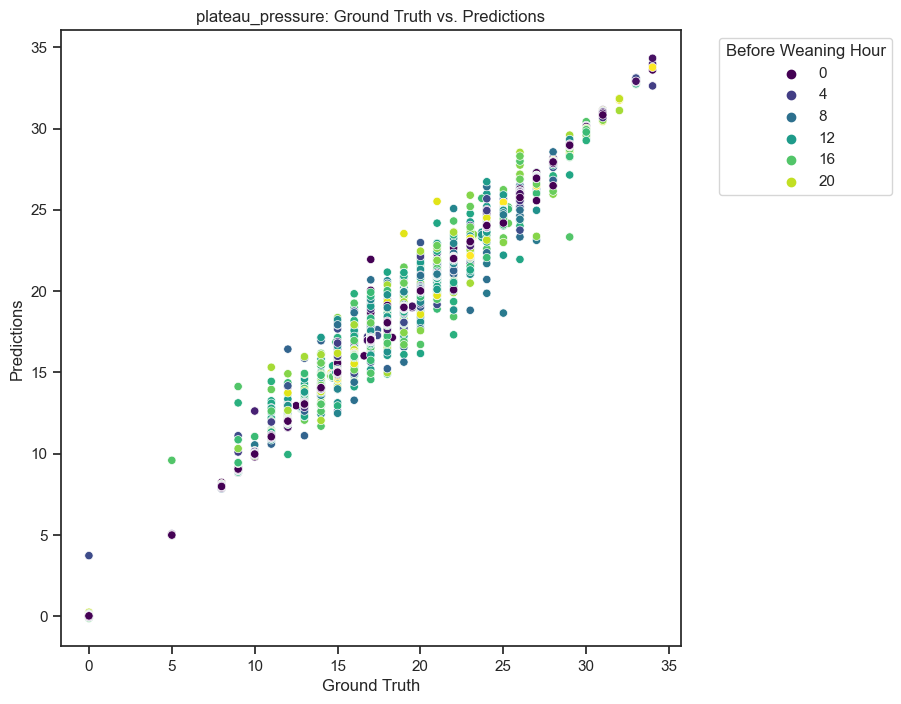

----- val -----


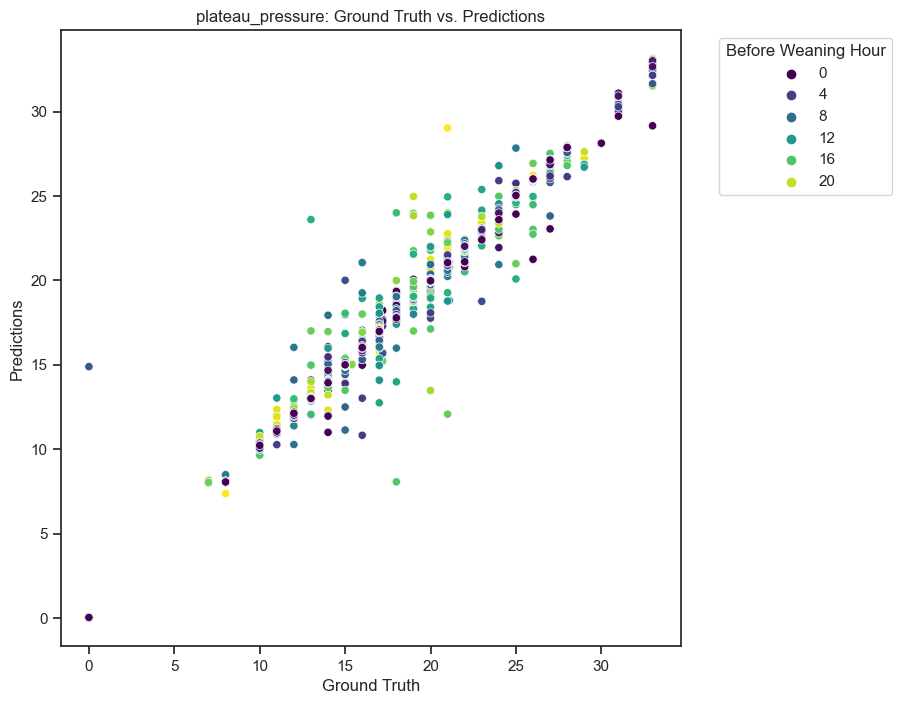

----- positive label change row -----
positive change row train Mean Squared Error (MSE): 2.6805
positive change row train Mean Absolute Error (MAE): 1.3842
positive change row train R-squared (R2): 0.8575



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


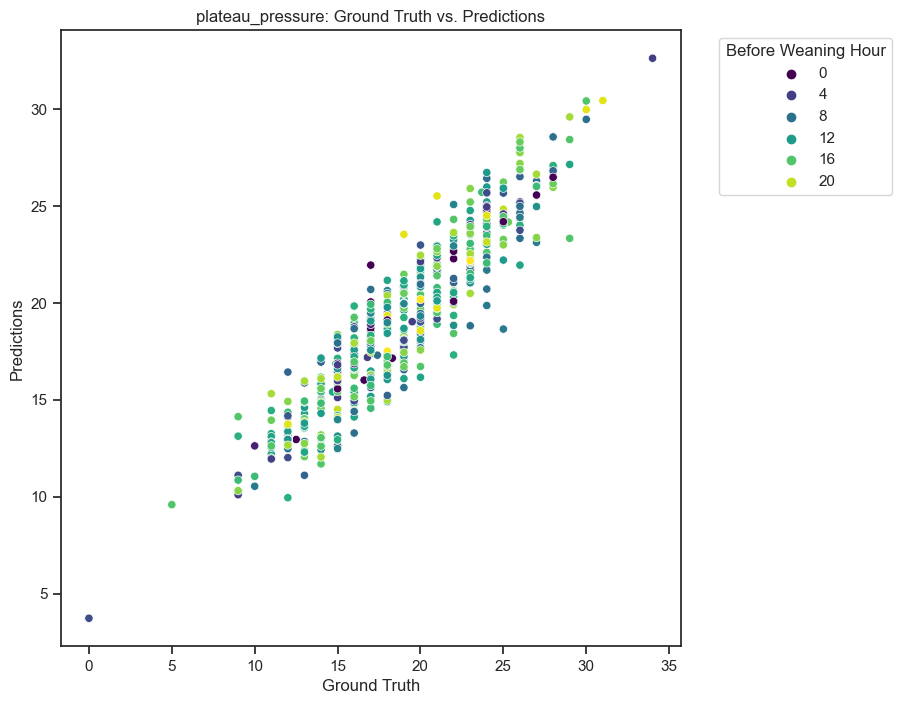

positive change row val Mean Squared Error (MSE): 11.3904
positive change row val Mean Absolute Error (MAE): 2.5965
positive change row val R-squared (R2): 0.4185



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


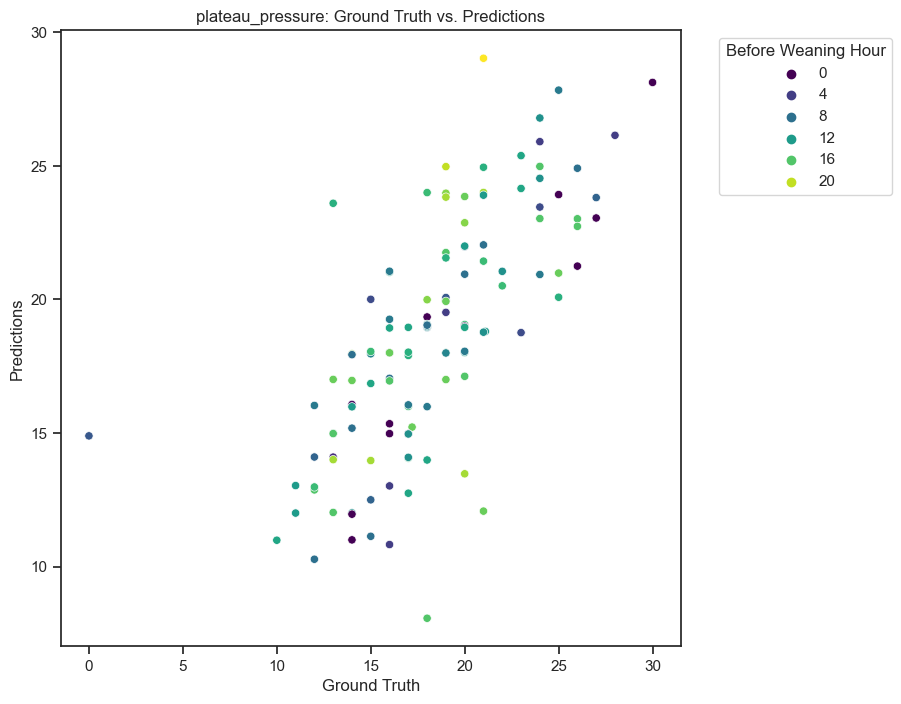

----- negative label -----
negative label Mean Squared Error (MSE): 0.9793
negative label Mean Absolute Error (MAE): 0.3506
negative label R-squared (R2): 0.9679



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


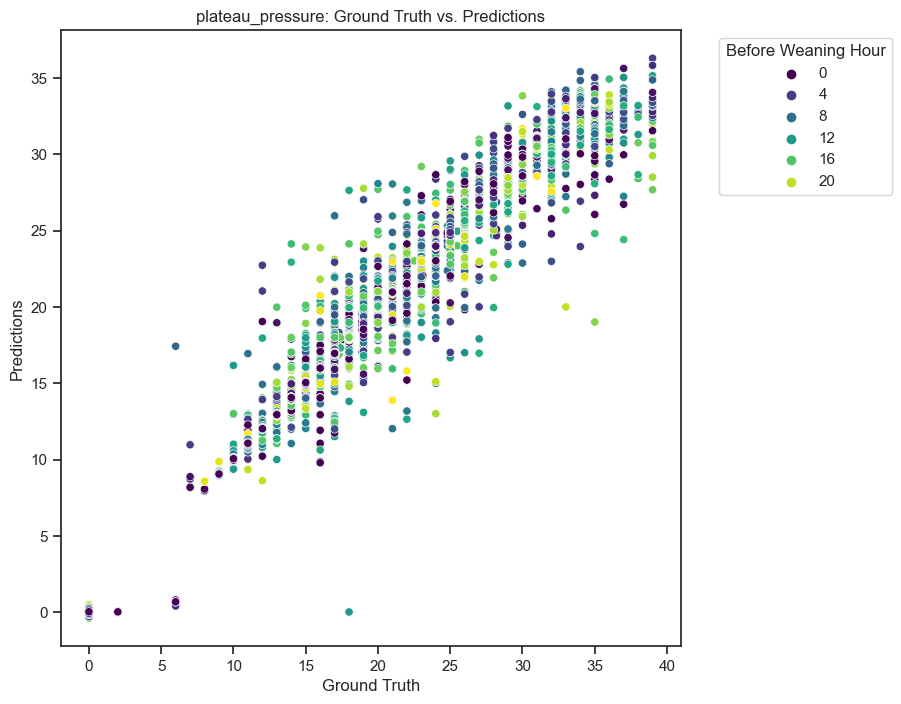

----- negative label change row -----
negative change row Mean Squared Error (MSE): 10.6575
negative change row Mean Absolute Error (MAE): 2.4550
negative change row R-squared (R2): 0.7010



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\2097338689.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


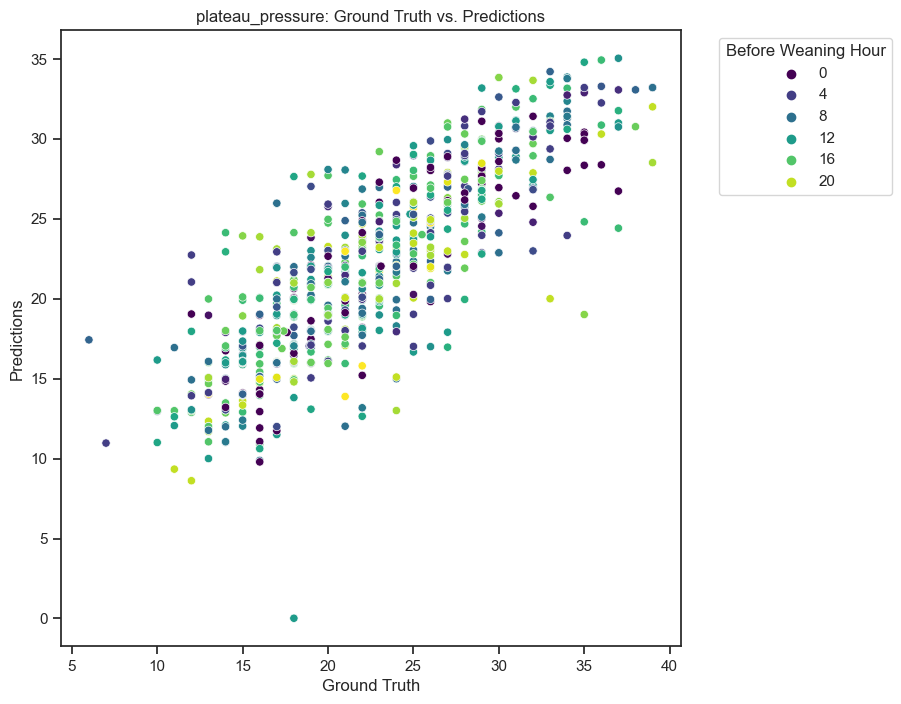

In [448]:
visual_mode = 3
for vese in ventilator_settings:
    print(f'====== ventilator_settings: {vese} =====')
    print('----- positive label -----')
    # X_train, y_train, X_val, y_val, X_test, y_test = split_data(group_pre_1hr_visi_vese_df, X_cols, vese)
    X_train, y_train, X_val, y_val = split_data(group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df,
                                                group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df, X_cols, vese)
    model = intuition_regression_model(X_train, y_train, X_val, y_val, vese, visual_mode)
    
    print('----- positive label change row -----')
    vese_change_row_train_df = group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df[group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df[f"{vese}_change_label"] == 1]
    vese_change_row_val_df = group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df[group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df[f"{vese}_change_label"] == 1]
    X_train_change, y_train_change, X_val_change, y_val_change = split_data(vese_change_row_train_df,
                                                                            vese_change_row_val_df, X_cols, vese)
    y_train_change_pred = model.predict(X_train_change)
    print_regression_metrics(y_train_change, y_train_change_pred, "positive change row train")
    visualize_predict_ground_truth(X_train_change, y_train_change, y_train_change_pred, vese, visual_mode)
    y_val_change_pred = model.predict(X_val_change)
    print_regression_metrics(y_val_change, y_val_change_pred, "positive change row val")
    visualize_predict_ground_truth(X_val_change, y_val_change, y_val_change_pred, vese, visual_mode)

    print('----- negative label -----')
    X_train_negative, y_train_negative, X_val_negative, y_val_negative = split_data(group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df,
                                                                                    group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df, X_cols, vese)
    X_val_df = pd.concat([X_train_negative, X_val_negative], axis=0)
    y_val_df = pd.concat([y_train_negative, y_val_negative], axis=0)
    y_val_pred = model.predict(X_val_df)
    print_regression_metrics(y_val_df, y_val_pred, "negative label")
    visualize_predict_ground_truth(X_val_df, y_val_df, y_val_pred, vese, visual_mode)

    print('----- negative label change row -----')
    vese_change_row_train_df = group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df[group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df[f"{vese}_change_label"] == 1]
    vese_change_row_val_df = group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df[group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df[f"{vese}_change_label"] == 1]
    X_train_change, y_train_change, X_val_change, y_val_change = split_data(vese_change_row_train_df,
                                                                            vese_change_row_val_df, X_cols, vese)
    X_val_df = pd.concat([X_train_change, X_val_change], axis=0)
    y_val_df = pd.concat([y_train_change, y_val_change], axis=0)
    y_train_change_pred = model.predict(X_val_df)
    print_regression_metrics(y_val_df, y_train_change_pred, "negative change row")
    visualize_predict_ground_truth(X_val_df, y_val_df, y_train_change_pred, vese, visual_mode)

====== ventilator_settings: peep =====
----- positive label -----


Training Set Mean Squared Error (MSE): 0.3595
Training Set Mean Absolute Error (MAE): 0.2338
Training Set R-squared (R2): 0.9393

Validation Set Mean Squared Error (MSE): 1.1219
Validation Set Mean Absolute Error (MAE): 0.4445
Validation Set R-squared (R2): 0.8063

----- train -----


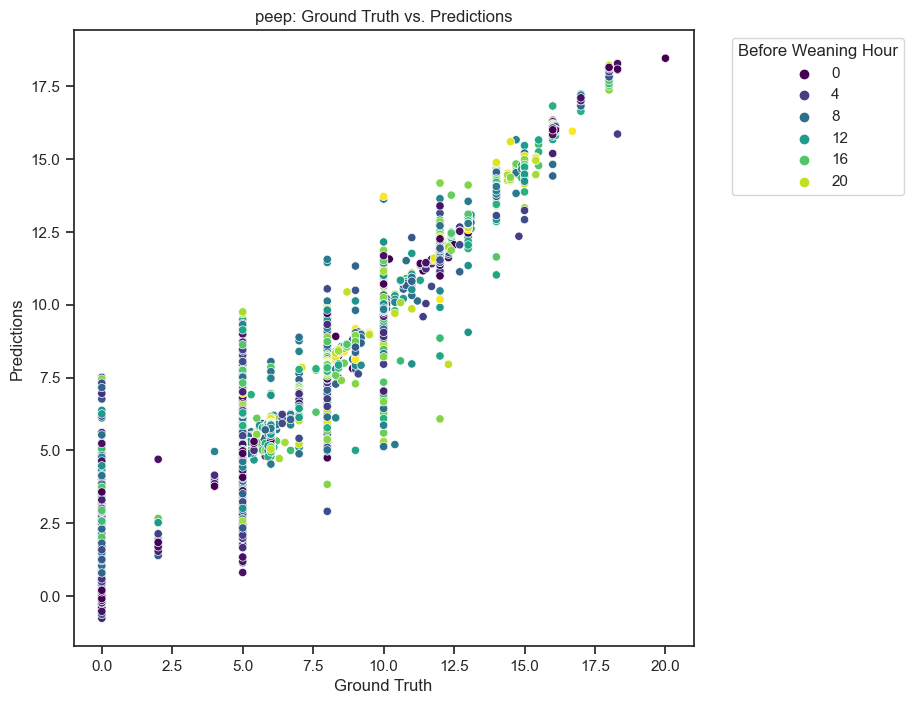

----- val -----


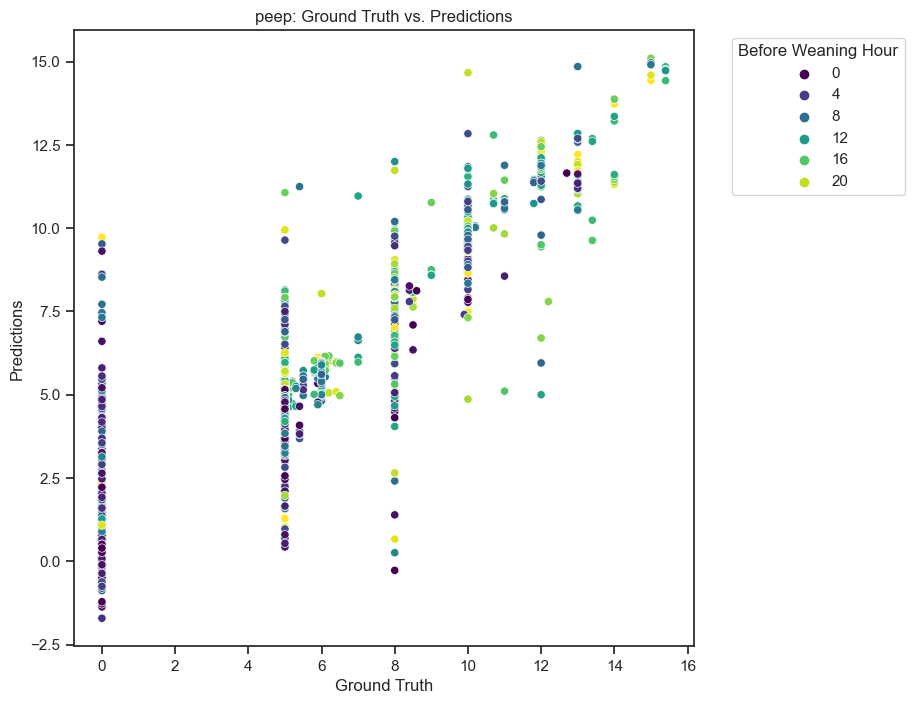

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\236036.py:89: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


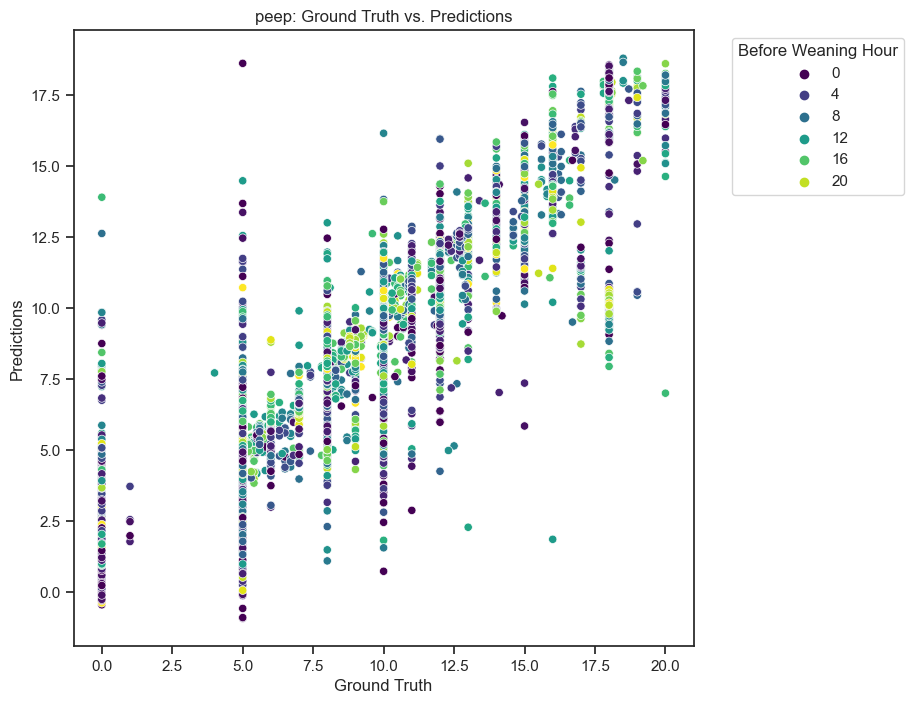

====== ventilator_settings: fio2 =====
----- positive label -----
Training Set Mean Squared Error (MSE): 4.5649
Training Set Mean Absolute Error (MAE): 0.6629
Training Set R-squared (R2): 0.9453

Validation Set Mean Squared Error (MSE): 25.6386
Validation Set Mean Absolute Error (MAE): 1.5680
Validation Set R-squared (R2): 0.6938

----- train -----


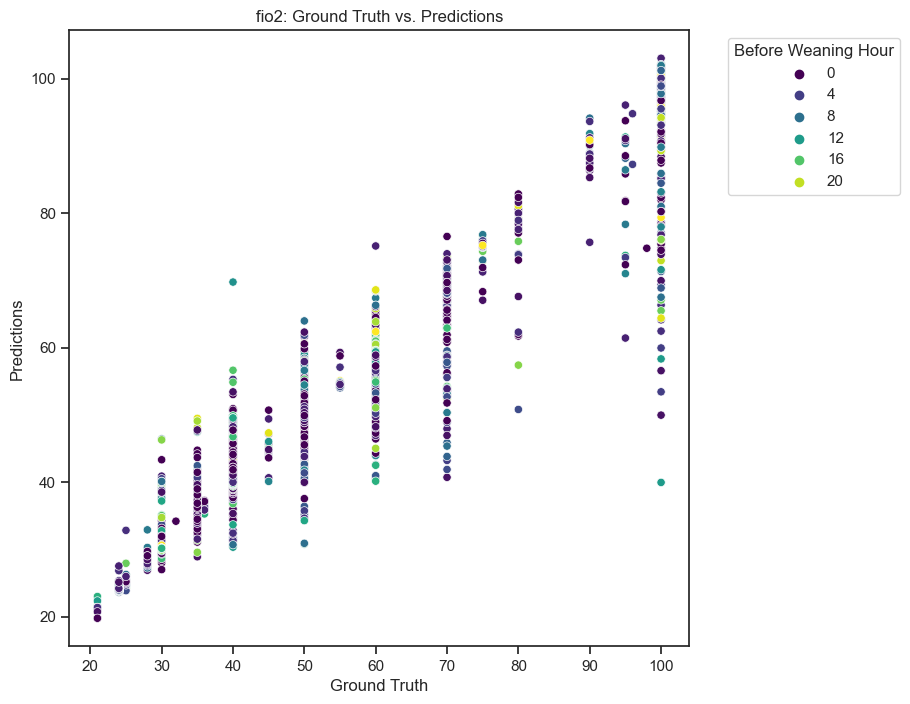

----- val -----


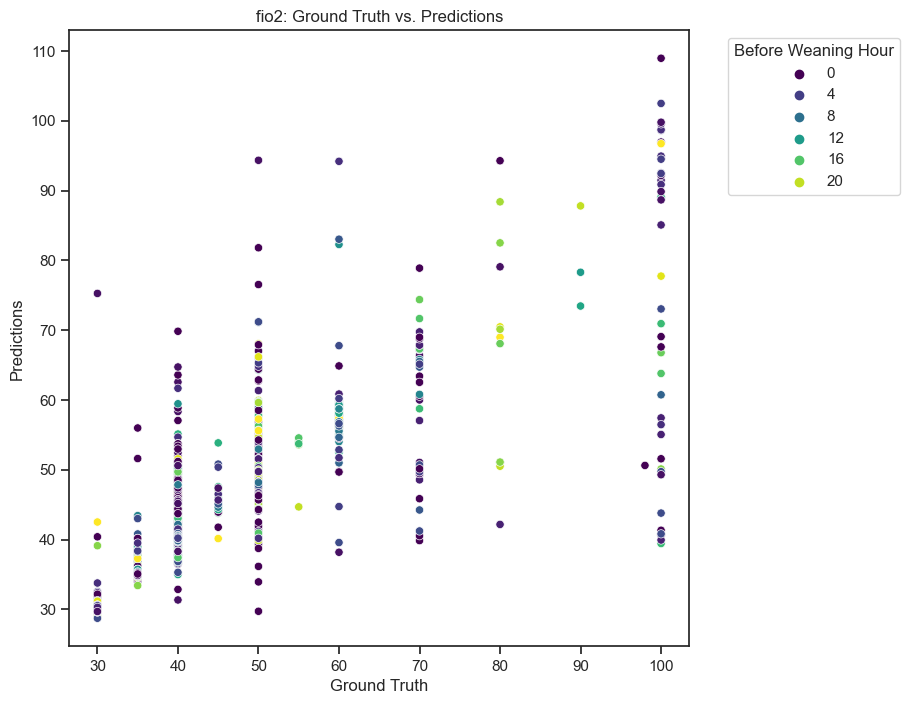

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\236036.py:89: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


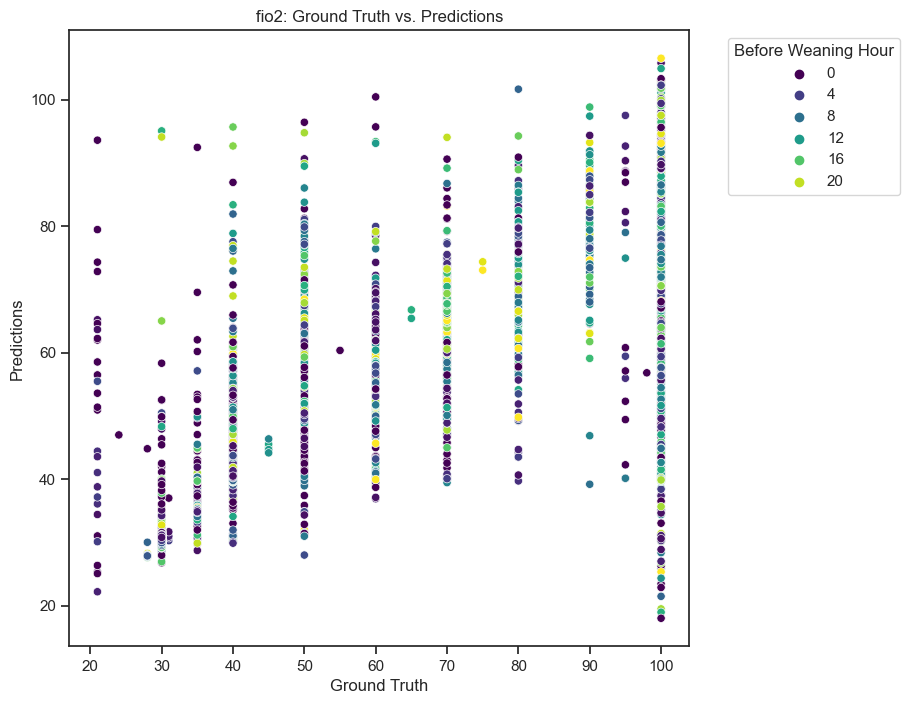

====== ventilator_settings: respiratory_rate_set =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.1081
Training Set Mean Absolute Error (MAE): 0.0871
Training Set R-squared (R2): 0.9970

Validation Set Mean Squared Error (MSE): 1.5334
Validation Set Mean Absolute Error (MAE): 0.2825
Validation Set R-squared (R2): 0.9618

----- train -----


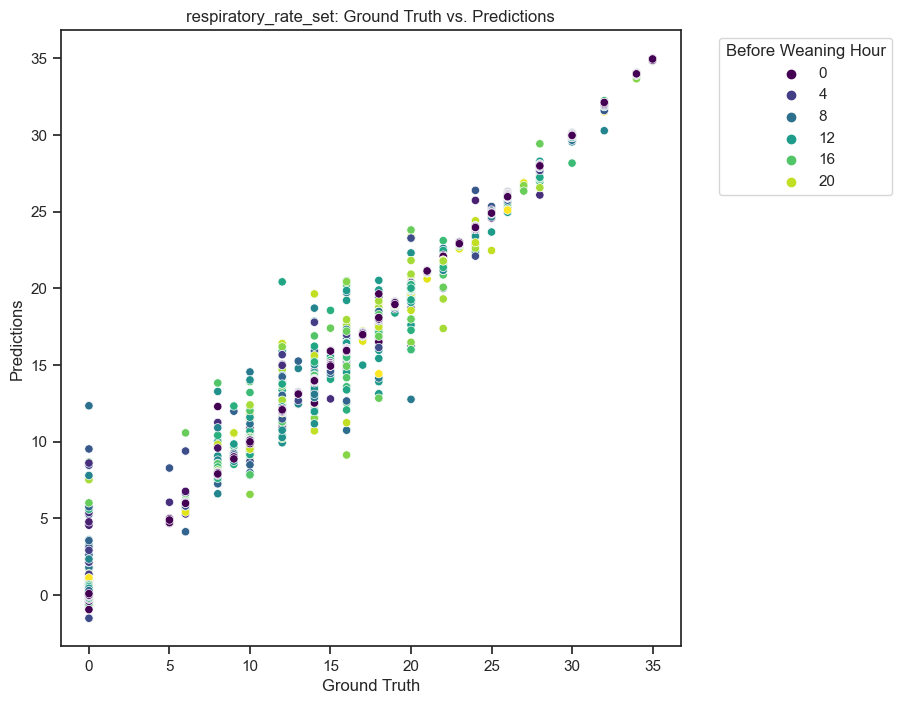

----- val -----


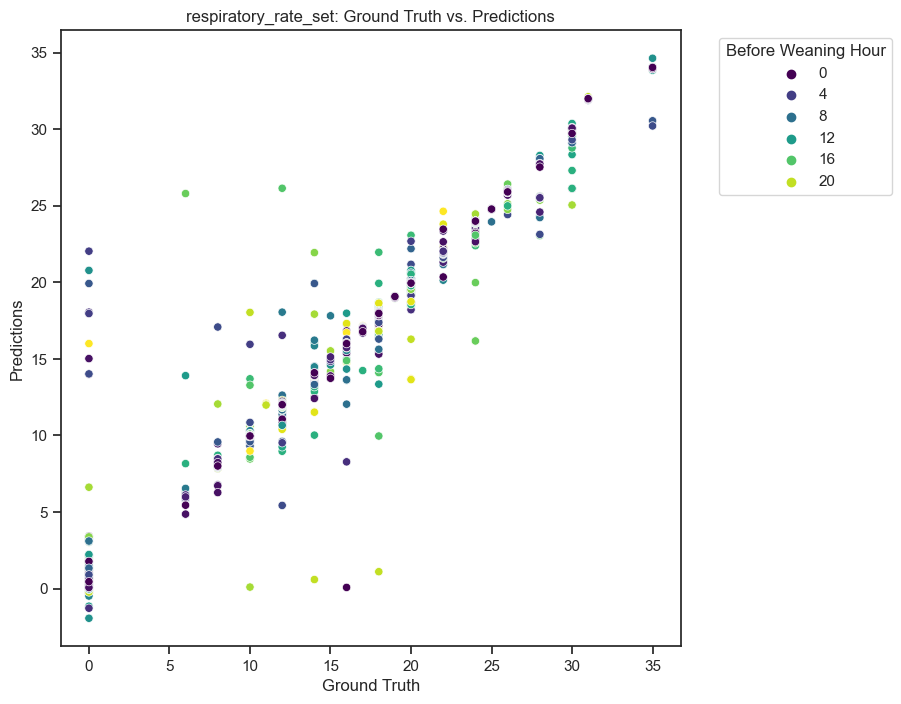

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\236036.py:89: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


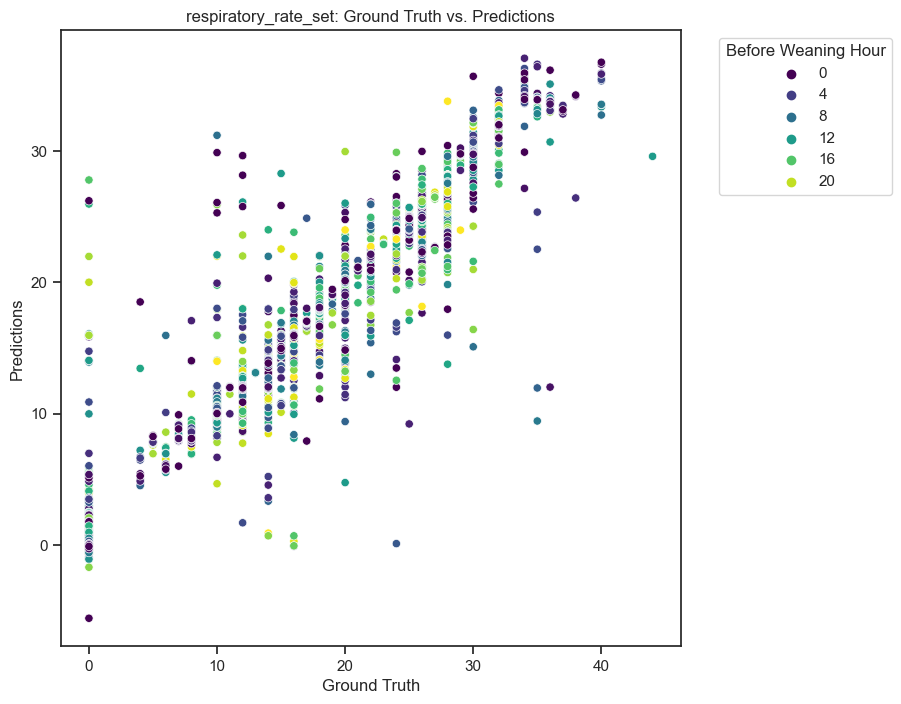

====== ventilator_settings: plateau_pressure =====
----- positive label -----
Training Set Mean Squared Error (MSE): 0.0758
Training Set Mean Absolute Error (MAE): 0.0814
Training Set R-squared (R2): 0.9962

Validation Set Mean Squared Error (MSE): 0.4310
Validation Set Mean Absolute Error (MAE): 0.1941
Validation Set R-squared (R2): 0.9745

----- train -----


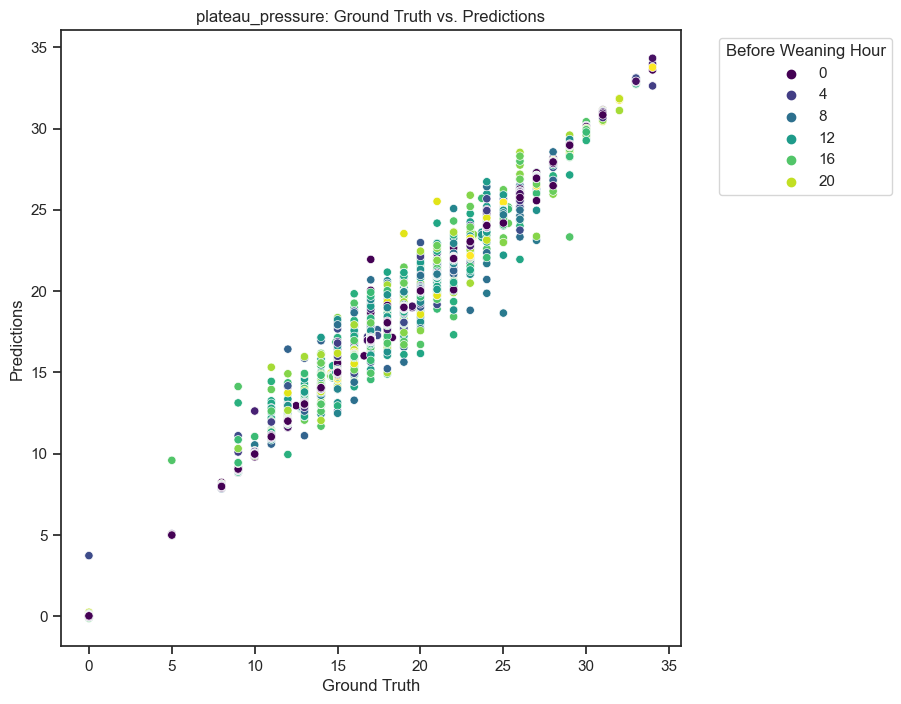

----- val -----


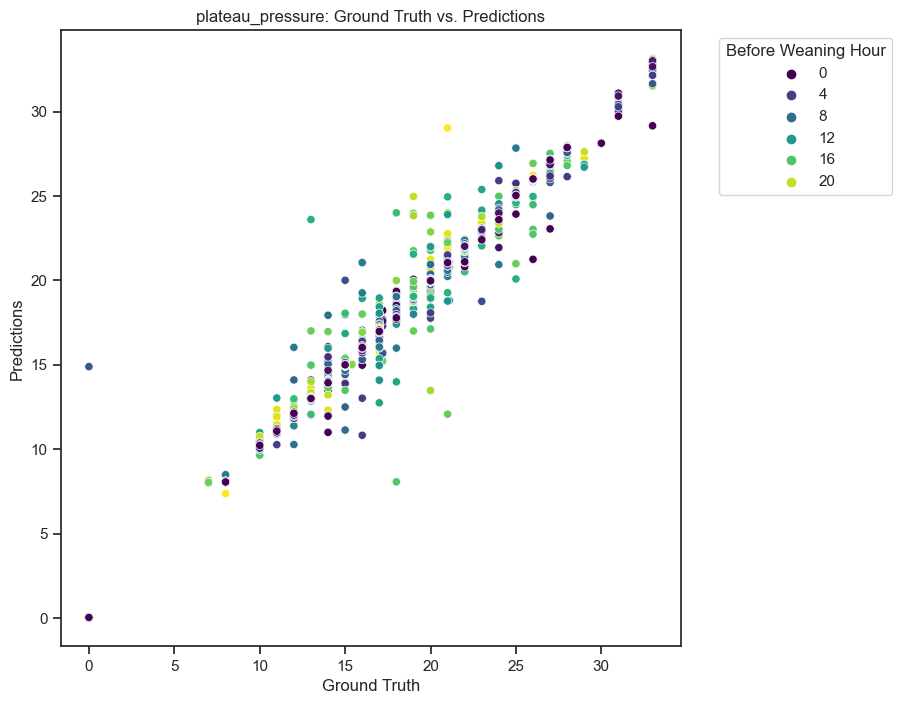

----- negative label -----


C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\236036.py:89: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


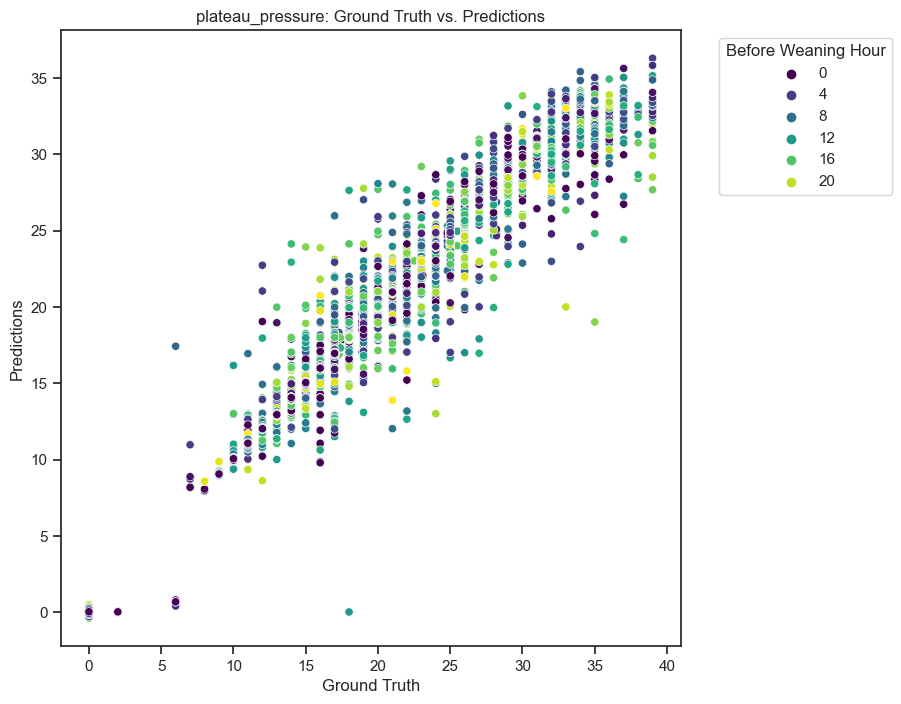

In [348]:
visual_mode = 3
for vese in ventilator_settings:
    print(f'====== ventilator_settings: {vese} =====')
    print('----- positive label -----')
    # X_train, y_train, X_val, y_val, X_test, y_test = split_data(group_pre_1hr_visi_vese_df, X_cols, vese)
    X_train, y_train, X_val, y_val = split_data(group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df,
                                                group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df, X_cols, vese)
    model = intuition_regression_model(X_train, y_train, X_val, y_val, vese, visual_mode)
    print('----- negative label -----')
    X_train_negative, y_train_negative, X_val_negative, y_val_negative = split_data(group_pre_1hr_visi_vese_change_label_value_aug_negative_train_df,
                                                                                    group_pre_1hr_visi_vese_change_label_value_aug_negative_val_df, X_cols, vese)
    X_val_df = pd.concat([X_train_negative, X_val_negative], axis=0)
    y_val_df = pd.concat([y_train_negative, y_val_negative], axis=0)
    y_val_pred = model.predict(X_val_df)
    visualize_predict_ground_truth(X_val_df, y_val_df, y_val_pred, vese, visual_mode)

## Modified model: Classification and Regression for Model A

### spilt data for classification c and regression r

TODO: need to design a way to make sure can align the stay_id

In [436]:
def split_classification_regression_data(train_df, val_df, X_cols, y_c_col, y_r_col, aug_mode):
    X_train = train_df[X_cols]
    if aug_mode == 1:
        y_c_train = train_df[y_c_col]
    else:
        y_c_train = train_df[f'{y_c_col}_aug']
        
    y_r_train = train_df[y_r_col]

    X_val = val_df[X_cols]
    if aug_mode == 3:
        y_c_val = val_df[f'{y_c_col}_aug']
    else:
        y_c_val = val_df[y_c_col]
    y_r_val = val_df[y_r_col]

    return X_train, y_c_train, y_r_train, X_val, y_c_val, y_r_val

get three dataframe for the model

In [437]:
# features with categorical data
""" feature_columns = [
    'before_weaning_hr', 'age_now', 'gender', 'insurance', 'race', 'first_careunit', 'admission_type', 'weight_kg',
    'height_cm', 'tobacco', 'heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 'tidal_volume_observed', 'RSBI',
    'minute_ventilation', 'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h', 'mbp_prev_1h', 'spo2_prev_1h',
    'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h', 'peep_prev_1h',
    'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h', 'ventilator_mode_prev_1h',
    'ventilator_mode_group_prev_1h', 'peep_change_percent', 'fio2_change_percent', 'respiratory_rate_set_change_percent',
    'plateau_pressure_change_percent'
]

classification_label_columns = [
    'peep_change_label', 'fio2_change_label', 'respiratory_rate_set_change_label', 'plateau_pressure_change_label'
]

regression_label_columns = [
    'peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure', 'ventilator_mode', 'ventilator_mode_group'
] """

# features without categorical data
# Random forest feature importance will use feature_columns and also classification_and_regression_model need 
feature_columns = [
    'before_weaning_hr', 'age_now', 'weight_kg',
    'height_cm', 'tobacco', 'heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 'tidal_volume_observed', 'RSBI',
    'minute_ventilation', 'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h', 'mbp_prev_1h', 'spo2_prev_1h',
    'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h', 
    'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h',
]

classification_label_columns = [
    'peep_change_label_aug', 'fio2_change_label_aug', 'respiratory_rate_set_change_label_aug', 'plateau_pressure_change_label_aug'
]

""" regression_label_columns = [
    'peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure'
] """

regression_label_columns = [
    'peep_change_value', 'fio2_change_value', 'respiratory_rate_set_change_value', 'plateau_pressure_change_value'
]





### Training helper functions

In [438]:
def generate_balance_classification_df(X_train, y_c_train, label_number_ratio):
    condition_positive = (y_c_train == 1)
    condition_negative = (y_c_train == 0)

    # Identify the number of positive and negative samples
    num_positive = sum(condition_positive)
    num_negative = sum(condition_negative)

    # Calculate the target number of negative samples based on the ratio
    target_num_negative = int(num_positive * label_number_ratio)

    try:
        # Randomly sample negative indices to achieve the target number
        seed_value = 42
        np.random.seed(seed_value)
        sampled_negative_indices = np.random.choice(np.where(condition_negative)[0], target_num_negative, replace=False)

        # Concatenate the sampled negative indices with positive indices
        selected_indices = np.concatenate([np.where(condition_positive)[0], sampled_negative_indices])

        # Ensure that the indices are aligned
        X_train_balance = X_train.iloc[selected_indices]
        y_c_train_balance = y_c_train.iloc[selected_indices]
    except Exception as e:
        print(e)
        print('***** Warning: set the dataset as original without balancing *****')
        X_train_balance, y_c_train_balance = X_train, y_c_train

    return X_train_balance, y_c_train_balance

def grid_search_helper(X_train_scaled, y_c_train):
    # Define the classifier
    classifier = XGBClassifier()
    param_grid = {
        'learning_rate': [0.01, 0.1, 0.2],
        'n_estimators': [100, 200, 300],
        'max_depth': [3, 5, 7],
        'subsample': [0.8, 0.9, 1.0],
        'colsample_bytree': [0.8, 0.9, 1.0],
    }

    # Create a scorer based on f1_score for the positive class
    scorer = make_scorer(f1_score, pos_label=1)

    # Create GridSearchCV object
    grid_search = GridSearchCV(classifier, param_grid, scoring=scorer, cv=5)
    # grid_search = GridSearchCV(classifier, param_grid, scoring='f1', cv=5)

    try:
        # Fit the model to the data
        grid_search.fit(X_train_scaled, y_c_train)
    except UnicodeEncodeError:
        # Handle UnicodeEncodeError by encoding non-ASCII characters
        X_train_scaled = X_train_scaled.applymap(lambda x: x.encode('utf-8').decode('ascii', 'ignore') if isinstance(x, str) else x)
        grid_search.fit(X_train_scaled, y_c_train)

    # Print the best hyperparameters
    print("Best Hyperparameters:", grid_search.best_params_)

    return grid_search

### model

In [441]:
def classification_model(X_train, y_c_train, X_val, y_c_val, model_mode, label_number_balance_ratio):
    if label_number_balance_ratio != -1:
        X_train_balance, y_c_train_balance = generate_balance_classification_df(X_train, y_c_train, label_number_balance_ratio)
        print(f'y_c_train_balance:\n {y_c_train_balance.value_counts()}')
    else:
        X_train_balance, y_c_train_balance = X_train, y_c_train
    
    scaler_classifier = StandardScaler()
    X_train_scaled = scaler_classifier.fit_transform(X_train)
    X_train_balance_scaled = scaler_classifier.transform(X_train_balance) # TODO: NOT SURE fit_transform or transform
    X_val_scaled = scaler_classifier.transform(X_val)
    # grid_search_helper(X_train_balance_scaled, y_c_train) # TODO: if do grid search, then turn on this line
    
    if model_mode == 1:
        # Step 1: Classification (Change or Not)
        # TODO: currently overfitting
        classifier = MLPClassifier(hidden_layer_sizes=(100, 50), max_iter=500, random_state=42, alpha=0.1)
        # TODO: this make training worse, but val not get better
        # classifier = MLPClassifier(hidden_layer_sizes=(100, 50), max_iter=500, random_state=42, alpha=0.01, early_stopping = True)
        classifier.fit(X_train_balance_scaled, y_c_train_balance)
    elif model_mode == 2:
        # result of gridsearchcv: (peep, run 22 mins): Best Hyperparameters: {'colsample_bytree': 0.9, 'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 300, 'subsample': 0.8}
        classifier = XGBClassifier(colsample_bytree=0.9, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.8)
        classifier.fit(X_train_balance_scaled, y_c_train_balance)
    elif model_mode == 3:
        classifier = RandomForestClassifier(
            n_estimators=100,  # Adjust the number of trees as needed
            random_state=42,
            max_depth=10,
            class_weight='balanced',  # Use 'balanced' to handle class imbalance
        )
        classifier.fit(X_train_balance_scaled, y_c_train_balance)
        feature_importances = classifier.feature_importances_
        feature_names = feature_columns  # Replace this with your actual feature names
        sorted_indices = np.argsort(feature_importances)[::-1]

        print("\nFeature Importances:")
        for idx in sorted_indices:
            print(f"{feature_names[idx]}: {feature_importances[idx]}")

    # Make predictions for the classification task for whole train
    y_pred_train = classifier.predict(X_train_scaled)
    print_classification_metrics(y_c_train, y_pred_train, 'whole train')

    # Make predictions for the classification task for balance train
    y_pred_train = classifier.predict(X_train_balance_scaled)
    print_classification_metrics(y_c_train_balance, y_pred_train, 'balance train')

    # Make predictions for the classification task for whole val
    y_pred_val = classifier.predict(X_val_scaled)
    print_classification_metrics(y_c_val, y_pred_val, 'whole val')

    return classifier, scaler_classifier

def regression_model(X_train, y_r_train, X_val, y_r_val, feature):
    # Step 2: Regression (Predict the actual values for changes)
    # Filter rows where feature value have changed in X_train
    train_changed_rows = X_train[(X_train[f'{feature}_prev_1h'] - y_r_train) != 0]
    X_train_changed = X_train[X_train.index.isin(train_changed_rows.index)]
    y_train_regression_changed = y_r_train[y_r_train.index.isin(train_changed_rows.index)]
    
    # TODO: NOT SURE! should the val also only contains change rows? or should also have the same rows?
    val_changed_rows = X_val[(X_val[f'{feature}_prev_1h'] - y_r_val) != 0]
    X_val_changed = X_val[X_val.index.isin(val_changed_rows.index)]
    y_val_regression_changed = y_r_val[y_r_val.index.isin(val_changed_rows.index)]

    # Standardize the features for regression
    scaler_regressor = StandardScaler()
    X_train_scaled = scaler_regressor.fit_transform(X_train)
    X_train_changed_scaled = scaler_regressor.transform(X_train_changed)
    X_val_scaled = scaler_regressor.transform(X_val) # TODO: NOT SURE fit_transform or transform???
    # X_val_scaled = scaler_regressor.fit_transform(X_val) # TODO: NOT SURE fit_transform or transform???
    X_val_changed_scaled = scaler_regressor.transform(X_val_changed)

    # Regression model for predicting actual values
    # regressor = MLPRegressor(hidden_layer_sizes=(100, 50), max_iter=500, random_state=42)
    regressor = XGBRegressor()
    regressor.fit(X_train_changed_scaled, y_train_regression_changed)

    # Make predictions on whole training set
    y_train_pred_regression = regressor.predict(X_train_scaled)
    print_regression_metrics(y_r_train, y_train_pred_regression, 'whole train')

    # Make predictions on whole val set
    y_val_pred_regression = regressor.predict(X_val_scaled)
    print_regression_metrics(y_r_val, y_val_pred_regression, 'whole val')

    # Make predictions on training change set
    y_train_pred_regression_changed = regressor.predict(X_train_changed_scaled)
    print_regression_metrics(y_train_regression_changed, y_train_pred_regression_changed, 'change train')

    # Evaluate the regression model
    y_val_pred_regression_changed = regressor.predict(X_val_changed_scaled)
    print_regression_metrics(y_val_regression_changed, y_val_pred_regression_changed, 'change val')

    return regressor, scaler_regressor

def classification_and_regression_model(train_df, val_df, feature_columns, classification_label, regression_label, model_mode=2, label_number_balance_ratio=3, aug_mode=1):
    # Assuming you have a preprocessed dataframe with features and labels
    X_train, y_c_train, y_r_train, X_val, y_c_val, y_r_val = split_classification_regression_data(train_df, val_df, feature_columns, classification_label, regression_label, aug_mode)
    # classification model
    print("----- Classification -----")
    classifier, scaler_classifier = classification_model(X_train, y_c_train, X_val, y_c_val, model_mode, label_number_balance_ratio)
    # regression model
    print("----- Regression -----")
    regressor, scaler_regressor = regression_model(X_train, y_r_train, X_val, y_r_val, regression_label)

    return classifier, scaler_classifier, regressor, scaler_regressor

original change label

In [446]:
ventilator_settings = ['peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure']
print("===== positive label =====")
model_A_dict = {}
for feature in ventilator_settings:
    print(f'feature: {feature}\n')
    # TODO: model_mode: 1. MLPClassifier, 2. XGBoost, 3. Random Forest
    model_mode = 2
    # label_number_balance_ratio: len(same) = label_number_ratio * len(diff)
    label_number_balance_ratio = 3 # TODO: this is important hyperparameter for the training set 0 / 1 ratio, -1 as original without subsampling
    # TODO: aug_mode: 1. no augment, 2. only train augment, 3. val also augment
    aug_mode = 1
    classifier, scaler_classifier, regressor, scaler_regressor = classification_and_regression_model(group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df, 
                                                                                                     group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df,
                                                                                                     feature_columns, f'{feature}_change_label', feature, model_mode, label_number_balance_ratio, aug_mode)
    model_A_dict[feature] = {}
    model_A_dict[feature]['classifier'] = classifier
    model_A_dict[feature]['regressor'] = regressor
    model_A_dict[feature]['scaler_classifier'] = scaler_classifier
    model_A_dict[feature]['scaler_regressor'] = scaler_regressor

===== positive label =====
feature: peep

----- Classification -----
y_c_train_balance:
 0    4584
1    1528
Name: peep_change_label, dtype: int64


whole train Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96     25658
           1       0.42      0.70      0.52      1528

    accuracy                           0.93     27186
   macro avg       0.70      0.82      0.74     27186
weighted avg       0.95      0.93      0.94     27186


balance train Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.99      0.95      4584
           1       0.96      0.70      0.81      1528

    accuracy                           0.92      6112
   macro avg       0.93      0.84      0.88      6112
weighted avg       0.92      0.92      0.91      6112


whole val Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.92      0.94      3769
           1       0.22      0.38      0.28       233

    accuracy                           0.89      4002
   macro avg       0.

augmentation of change label: combine with label_number_balance_ratio

In [367]:
ventilator_settings = ['peep'] # , 'fio2', 'respiratory_rate_set', 'plateau_pressure']
print("===== positive label =====")
model_A_dict = {}
for feature in ventilator_settings:
    print(f'feature: {feature}\n')
    # TODO: model_mode: 1. MLPClassifier, 2. XGBoost, 3. Random Forest
    model_mode = 1
    # label_number_balance_ratio: len(same) = label_number_ratio * len(diff)
    label_number_balance_ratio = 3 # TODO: this is important hyperparameter for the training set 0 / 1 ratio, -1 as original without subsampling
    # TODO: aug_mode: 1. no augment, 2. only train augment, 3. val also augment
    aug_mode = 1
    classifier, scaler_classifier, regressor, scaler_regressor = classification_and_regression_model(group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df, 
                                                                                                     group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df,
                                                                                                     feature_columns, f'{feature}_change_label', feature, model_mode, label_number_balance_ratio, aug_mode)
    model_A_dict[feature] = {}
    model_A_dict[feature]['classifier'] = classifier
    model_A_dict[feature]['regressor'] = regressor
    model_A_dict[feature]['scaler_classifier'] = scaler_classifier
    model_A_dict[feature]['scaler_regressor'] = scaler_regressor

===== positive label =====
feature: peep

----- Classification -----
y_c_train_balance:
 0    4584
1    1528
Name: peep_change_label, dtype: int64
whole train Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.86      0.92     25658
           1       0.30      0.98      0.46      1528

    accuracy                           0.87     27186
   macro avg       0.65      0.92      0.69     27186
weighted avg       0.96      0.87      0.90     27186


balance train Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      1.00      4584
           1       0.99      0.98      0.99      1528

    accuracy                           0.99      6112
   macro avg       0.99      0.99      0.99      6112
weighted avg       0.99      0.99      0.99      6112


whole val Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.80    

In [368]:
ventilator_settings = ['peep'] # , 'fio2', 'respiratory_rate_set', 'plateau_pressure']
print("===== positive label =====")
model_A_dict = {}
for feature in ventilator_settings:
    print(f'feature: {feature}\n')
    # TODO: model_mode: 1. MLPClassifier, 2. XGBoost, 3. Random Forest
    model_mode = 2
    # label_number_balance_ratio: len(same) = label_number_ratio * len(diff)
    label_number_balance_ratio = 3 # TODO: this is important hyperparameter for the training set 0 / 1 ratio, -1 as original without subsampling
    # TODO: aug_mode: 1. no augment, 2. only train augment, 3. val also augment
    aug_mode = 1
    classifier, scaler_classifier, regressor, scaler_regressor = classification_and_regression_model(group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df, 
                                                                                                     group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df,
                                                                                                     feature_columns, f'{feature}_change_label', feature, model_mode, label_number_balance_ratio, aug_mode)
    model_A_dict[feature] = {}
    model_A_dict[feature]['classifier'] = classifier
    model_A_dict[feature]['regressor'] = regressor
    model_A_dict[feature]['scaler_classifier'] = scaler_classifier
    model_A_dict[feature]['scaler_regressor'] = scaler_regressor

===== positive label =====
feature: peep

----- Classification -----
y_c_train_balance:
 0    4584
1    1528
Name: peep_change_label, dtype: int64
whole train Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96     25658
           1       0.42      0.70      0.52      1528

    accuracy                           0.93     27186
   macro avg       0.70      0.82      0.74     27186
weighted avg       0.95      0.93      0.94     27186


balance train Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.99      0.95      4584
           1       0.96      0.70      0.81      1528

    accuracy                           0.92      6112
   macro avg       0.93      0.84      0.88      6112
weighted avg       0.92      0.92      0.91      6112


whole val Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.92    

In [371]:
ventilator_settings = ['peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure']
print("===== positive label =====")
model_A_dict = {}
for feature in ventilator_settings:
    print(f'feature: {feature}\n')
    # TODO: model_mode: 1. MLPClassifier, 2. XGBoost, 3. Random Forest
    model_mode = 2
    # label_number_balance_ratio: len(same) = label_number_ratio * len(diff)
    label_number_balance_ratio = 3 # TODO: this is important hyperparameter for the training set 0 / 1 ratio, -1 as original without subsampling
    # TODO: aug_mode: 1. no augment, 2. only train augment, 3. val also augment
    aug_mode = 3
    classifier, scaler_classifier, regressor, scaler_regressor = classification_and_regression_model(group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df, 
                                                                                                     group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df,
                                                                                                     feature_columns, f'{feature}_change_label', feature, model_mode, label_number_balance_ratio, aug_mode)
    model_A_dict[feature] = {}
    model_A_dict[feature]['classifier'] = classifier
    model_A_dict[feature]['regressor'] = regressor
    model_A_dict[feature]['scaler_classifier'] = scaler_classifier
    model_A_dict[feature]['scaler_regressor'] = scaler_regressor

===== positive label =====
feature: peep

----- Classification -----
y_c_train_balance:
 0    14724
1     4908
Name: peep_change_label_aug, dtype: int64


whole train Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.97      0.93     22278
           1       0.78      0.52      0.63      4908

    accuracy                           0.89     27186
   macro avg       0.84      0.75      0.78     27186
weighted avg       0.88      0.89      0.88     27186


balance train Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.97      0.91     14724
           1       0.87      0.52      0.66      4908

    accuracy                           0.86     19632
   macro avg       0.87      0.75      0.78     19632
weighted avg       0.86      0.86      0.85     19632


whole val Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.93      0.90      3263
           1       0.54      0.38      0.44       739

    accuracy                           0.83      4002
   macro avg       0.

C:\Users\張亞錫\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


whole train Mean Squared Error (MSE): 450.6490
whole train Mean Absolute Error (MAE): 15.8885
whole train R-squared (R2): -4.4045

whole val Mean Squared Error (MSE): 427.3843
whole val Mean Absolute Error (MAE): 15.7083
whole val R-squared (R2): -4.1043

change train Mean Squared Error (MSE): 46.7430
change train Mean Absolute Error (MAE): 4.8673
change train R-squared (R2): 0.8662

change val Mean Squared Error (MSE): 960.0279
change val Mean Absolute Error (MAE): 18.9448
change val R-squared (R2): -1.5992

feature: respiratory_rate_set

----- Classification -----
y_c_train_balance:
 0    3072
1    1024
Name: respiratory_rate_set_change_label_aug, dtype: int64
whole train Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.96      0.98     26162
           1       0.47      0.91      0.62      1024

    accuracy                           0.96     27186
   macro avg       0.73      0.93      0.80     27186
weighted avg       0.9

C:\Users\張亞錫\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


whole train Mean Squared Error (MSE): 92.1669
whole train Mean Absolute Error (MAE): 6.9987
whole train R-squared (R2): -1.5687

whole val Mean Squared Error (MSE): 86.9488
whole val Mean Absolute Error (MAE): 7.2250
whole val R-squared (R2): -1.1667

change train Mean Squared Error (MSE): 0.1925
change train Mean Absolute Error (MAE): 0.2656
change train R-squared (R2): 0.9955

change val Mean Squared Error (MSE): 70.1410
change val Mean Absolute Error (MAE): 6.2731
change val R-squared (R2): -0.3997

feature: plateau_pressure

----- Classification -----
y_c_train_balance:
 0    8019
1    2673
Name: plateau_pressure_change_label_aug, dtype: int64
whole train Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.96      0.97     24513
           1       0.66      0.76      0.71      2673

    accuracy                           0.94     27186
   macro avg       0.82      0.86      0.84     27186
weighted avg       0.94      0.94    

C:\Users\張亞錫\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


In [362]:
ventilator_settings = ['peep'] # , 'fio2', 'respiratory_rate_set', 'plateau_pressure']
print("===== positive label =====")
model_A_dict = {}
for feature in ventilator_settings:
    print(f'feature: {feature}\n')
    # TODO: model_mode: 1. MLPClassifier, 2. XGBoost, 3. Random Forest
    model_mode = 2
    # label_number_balance_ratio: len(same) = label_number_ratio * len(diff)
    label_number_balance_ratio = 3 # TODO: this is important hyperparameter for the training set 0 / 1 ratio, -1 as original without subsampling
    classifier, scaler_classifier, regressor, scaler_regressor = classification_and_regression_model(group_pre_1hr_visi_vese_change_label_value_aug_positive_train_df, 
                                                                                                     group_pre_1hr_visi_vese_change_label_value_aug_positive_val_df,
                                                                                                     feature_columns, f'{feature}_change_label_aug', feature, model_mode, label_number_balance_ratio)
    model_A_dict[feature] = {}
    model_A_dict[feature]['classifier'] = classifier
    model_A_dict[feature]['regressor'] = regressor
    model_A_dict[feature]['scaler_classifier'] = scaler_classifier
    model_A_dict[feature]['scaler_regressor'] = scaler_regressor

===== positive label =====
feature: peep

----- Classification -----
y_c_train_balance:
 0    14724
1     4908
Name: peep_change_label_aug, dtype: int64
whole train Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.97      0.93     22278
           1       0.78      0.52      0.63      4908

    accuracy                           0.89     27186
   macro avg       0.84      0.75      0.78     27186
weighted avg       0.88      0.89      0.88     27186


balance train Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.97      0.91     14724
           1       0.87      0.52      0.66      4908

    accuracy                           0.86     19632
   macro avg       0.87      0.75      0.78     19632
weighted avg       0.86      0.86      0.85     19632


whole val Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.

In [129]:
ventilator_settings = ['peep']#, 'fio2', 'respiratory_rate_set', 'plateau_pressure']
# print("===== positive label =====")
model_A_dict = {}
for feature in ventilator_settings:
    print(f'===== feature: {feature} =====')
    # TODO: model_mode: 1. MLPClassifier, 2. XGBoost, 3. Random Forest
    model_mode = 1
    label_number_balance_ratio = -1 # TODO: this is important hyperparameter for the training set 0 / 1 ratio, -1 as original without subsampling
    classifier, scaler_classifier, regressor, scaler_regressor = classification_and_regression_model(group_pre_1hr_visi_vese_change_label_value_aug_df, feature_columns, f'{feature}_change_label_aug', feature, model_mode, label_number_balance_ratio)
    model_A_dict[feature] = {}
    model_A_dict[feature]['classifier'] = classifier
    model_A_dict[feature]['regressor'] = regressor
    model_A_dict[feature]['scaler_classifier'] = scaler_classifier
    model_A_dict[feature]['scaler_regressor'] = scaler_regressor

===== feature: peep =====
----- Classification -----
whole train Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.98      0.98     19113
           1       0.92      0.88      0.90      4209

    accuracy                           0.97     23322
   macro avg       0.95      0.93      0.94     23322
weighted avg       0.97      0.97      0.97     23322


balance train Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.98      0.98     19113
           1       0.92      0.88      0.90      4209

    accuracy                           0.97     23322
   macro avg       0.95      0.93      0.94     23322
weighted avg       0.97      0.97      0.97     23322


whole val Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.85      0.85      6346
           1       0.33      0.32      0.32      1451

    accuracy          

In [74]:
ventilator_settings = ['peep']#, 'fio2', 'respiratory_rate_set', 'plateau_pressure']
# print("===== positive label =====")
model_A_dict = {}
for feature in ventilator_settings:
    print(f'===== feature: {feature} =====')
    # TODO: model_mode: 1. MLPClassifier, 2. XGBoost, 3. Random Forest
    model_mode = 1
    label_number_balance_ratio = 3 # TODO: this is important hyperparameter for the training set 0 / 1 ratio, -1 as original without subsampling
    classifier, scaler_classifier, regressor, scaler_regressor = classification_and_regression_model(group_pre_1hr_visi_vese_change_label_value_aug_df, feature_columns, f'{feature}_change_label_aug', feature, model_mode, label_number_balance_ratio)
    model_A_dict[feature] = {}
    model_A_dict[feature]['classifier'] = classifier
    model_A_dict[feature]['regressor'] = regressor
    model_A_dict[feature]['scaler_classifier'] = scaler_classifier
    model_A_dict[feature]['scaler_regressor'] = scaler_regressor

===== feature: peep =====
----- Classification -----
y_c_train_balance:
 0    12627
1     4209
Name: peep_change_label_aug, dtype: int64
whole train Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.94      0.96     19113
           1       0.79      0.94      0.85      4209

    accuracy                           0.94     23322
   macro avg       0.89      0.94      0.91     23322
weighted avg       0.95      0.94      0.94     23322


balance train Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     12627
           1       0.93      0.93      0.93      4209

    accuracy                           0.96     16836
   macro avg       0.95      0.95      0.95     16836
weighted avg       0.96      0.96      0.96     16836


whole val Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.82      0.84    

In [105]:
ventilator_settings = ['peep']#, 'fio2', 'respiratory_rate_set', 'plateau_pressure']
# print("===== positive label =====")
model_A_dict = {}
for feature in ventilator_settings:
    print(f'===== feature: {feature} =====')
    # TODO: model_mode: 1. MLPClassifier, 2. XGBoost, 3. Random Forest
    model_mode = 2
    label_number_balance_ratio = 3 # TODO: this is important hyperparameter for the training set 0 / 1 ratio, -1 as original without subsampling
    classifier, scaler_classifier, regressor, scaler_regressor = classification_and_regression_model(group_pre_1hr_visi_vese_change_label_value_aug_df, feature_columns, f'{feature}_change_label_aug', feature, model_mode, label_number_balance_ratio)
    model_A_dict[feature] = {}
    model_A_dict[feature]['classifier'] = classifier
    model_A_dict[feature]['regressor'] = regressor
    model_A_dict[feature]['scaler_classifier'] = scaler_classifier
    model_A_dict[feature]['scaler_regressor'] = scaler_regressor

===== feature: peep =====
----- Classification -----
y_c_train_balance:
 0    12627
1     4209
Name: peep_change_label_aug, dtype: int64


whole train Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.94      0.93     19113
           1       0.69      0.58      0.63      4209

    accuracy                           0.88     23322
   macro avg       0.80      0.76      0.78     23322
weighted avg       0.87      0.88      0.87     23322


balance train Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.97      0.92     12627
           1       0.88      0.57      0.69      4209

    accuracy                           0.87     16836
   macro avg       0.88      0.77      0.81     16836
weighted avg       0.87      0.87      0.86     16836


whole val Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.93      0.90      6346
           1       0.54      0.34      0.42      1451

    accuracy                           0.82      7797
   macro avg       0.

In [249]:
ventilator_settings = ['peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure']
# print("===== positive label =====")
model_A_dict = {}
for feature in ventilator_settings:
    print(f'===== feature: {feature} =====')
    # TODO: model_mode: 1. MLPClassifier, 2. XGBoost, 3. Random Forest
    model_mode = 2
    label_number_balance_ratio = 3 # TODO: this is important hyperparameter for the training set 0 / 1 ratio, -1 as original without subsampling
    classifier, scaler_classifier, regressor, scaler_regressor = classification_and_regression_model(group_pre_1hr_visi_vese_change_label_value_aug_df, feature_columns, f'{feature}_change_label_aug', feature, model_mode, label_number_balance_ratio)
    model_A_dict[feature] = {}
    model_A_dict[feature]['classifier'] = classifier
    model_A_dict[feature]['regressor'] = regressor
    model_A_dict[feature]['scaler_classifier'] = scaler_classifier
    model_A_dict[feature]['scaler_regressor'] = scaler_regressor

===== feature: peep =====
----- Classification -----
y_c_train_balance:
 0    12627
1     4209
Name: peep_change_label_aug, dtype: int64


whole train Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.97      0.94     19113
           1       0.79      0.57      0.66      4209

    accuracy                           0.89     23322
   macro avg       0.85      0.77      0.80     23322
weighted avg       0.89      0.89      0.89     23322


balance train Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.97      0.92     12627
           1       0.88      0.57      0.69      4209

    accuracy                           0.87     16836
   macro avg       0.88      0.77      0.80     16836
weighted avg       0.87      0.87      0.86     16836


whole val Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.93      0.90      6346
           1       0.54      0.34      0.42      1451

    accuracy                           0.82      7797
   macro avg       0.

C:\Users\張亞錫\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


whole train Mean Squared Error (MSE): 453.9986
whole train Mean Absolute Error (MAE): 16.3026
whole train R-squared (R2): -4.1177

whole val Mean Squared Error (MSE): 493.7966
whole val Mean Absolute Error (MAE): 17.4393
whole val R-squared (R2): -4.9474

change train Mean Squared Error (MSE): 24.2358
change train Mean Absolute Error (MAE): 3.5557
change train R-squared (R2): 0.9321

change val Mean Squared Error (MSE): 606.1938
change val Mean Absolute Error (MAE): 18.7786
change val R-squared (R2): -0.6553

===== feature: respiratory_rate_set =====
----- Classification -----
y_c_train_balance:
 0    2622
1     874
Name: respiratory_rate_set_change_label_aug, dtype: int64
whole train Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.96      0.98     22448
           1       0.47      0.95      0.63       874

    accuracy                           0.96     23322
   macro avg       0.73      0.96      0.80     23322
weighted av

C:\Users\張亞錫\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\sklearn\neural_network\_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


whole train Mean Squared Error (MSE): 79.8869
whole train Mean Absolute Error (MAE): 6.7678
whole train R-squared (R2): -1.1830

whole val Mean Squared Error (MSE): 86.2628
whole val Mean Absolute Error (MAE): 7.1091
whole val R-squared (R2): -1.3575

change train Mean Squared Error (MSE): 0.2484
change train Mean Absolute Error (MAE): 0.2937
change train R-squared (R2): 0.9940

change val Mean Squared Error (MSE): 70.1323
change val Mean Absolute Error (MAE): 6.3118
change val R-squared (R2): -0.2518

===== feature: plateau_pressure =====
----- Classification -----
y_c_train_balance:
 0    6783
1    2261
Name: plateau_pressure_change_label_aug, dtype: int64
whole train Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.96      0.97     21061
           1       0.67      0.84      0.75      2261

    accuracy                           0.94     23322
   macro avg       0.83      0.90      0.86     23322
weighted avg       0.95   

## Model A Inference (on negative label)

In [380]:
aug_prev_n_hr = 3 # TODO: need to be the same as the training model settings
positive_train_df = group_pre_1hr_visi_vese_positive_train_df
positive_val_df = group_pre_1hr_visi_vese_positive_val_df
positive_test_df = group_pre_1hr_visi_vese_positive_test_df
negative_train_df = group_pre_1hr_visi_vese_negative_train_df
negative_val_df = group_pre_1hr_visi_vese_negative_val_df
negative_test_df = group_pre_1hr_visi_vese_negative_test_df
negative_df = pd.concat([negative_train_df, negative_val_df, negative_test_df], ignore_index=True)

ventilator_settings = ['peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure']
train_change_label_value_aug_df = generate_change_col(positive_train_df, ventilator_settings, aug_prev_n_hr) 
val_change_label_value_aug_df = generate_change_col(positive_val_df, ventilator_settings, aug_prev_n_hr) 
test_change_label_value_aug_df = generate_change_col(positive_test_df, ventilator_settings, aug_prev_n_hr)
negative_change_label_value_aug_df = generate_change_col(negative_df, ventilator_settings, aug_prev_n_hr)
whole_change_label_value_aug_df = pd.concat([train_change_label_value_aug_df, val_change_label_value_aug_df, test_change_label_value_aug_df], ignore_index=True)

# test_change_label_value_aug_df

In [550]:
def model_A_inference(test_change_label_value_aug_df, model_A_dict, feature, feature_columns, prefix):
    # Initialize an empty DataFrame to store the results
    regression_results = pd.DataFrame(index=test_change_label_value_aug_df.index)

    classifier = model_A_dict[feature]['classifier']
    regressor = model_A_dict[feature]['regressor']
    scaler_classifier = model_A_dict[feature]['scaler_classifier']
    scaler_regressor = model_A_dict[feature]['scaler_regressor']

    test_scaled_df = scaler_classifier.transform(test_change_label_value_aug_df[feature_columns])

    # Make classification predictions
    classification_predict = classifier.predict(test_scaled_df)
    print_classification_metrics(test_change_label_value_aug_df[f'{feature}_change_label'], classification_predict, prefix)

    # Filter rows based on classification prediction
    classification_0_rows = test_change_label_value_aug_df[classification_predict == 0]

    # Set regression_predict for rows with classification 0
    regression_results.loc[classification_0_rows.index, f'{feature}_regression_predict'] = \
        test_change_label_value_aug_df.loc[classification_0_rows.index, f'{feature}_prev_1h']

    # Set regression_predict for rows with classification 1 using regressor predictions
    classification_1_rows = test_change_label_value_aug_df[classification_predict == 1]
    test_regression_scaled_df = scaler_regressor.transform(test_change_label_value_aug_df.loc[classification_1_rows.index, feature_columns])
    regression_predictions = regressor.predict(test_regression_scaled_df)
    regression_results.loc[classification_1_rows.index, f'{feature}_regression_predict'] = regression_predictions
    
    print_regression_metrics(test_change_label_value_aug_df[feature], regression_results, prefix)
    visualize_predict_ground_truth(test_change_label_value_aug_df, test_change_label_value_aug_df[feature], regression_results[f'{feature}_regression_predict'], feature, visual_mode=3)

def model_A_inference_pro(test_change_label_value_aug_df, model_A_dict, feature, feature_columns, prefix):
    # Initialize an empty DataFrame to store the results
    regression_results = pd.DataFrame(index=test_change_label_value_aug_df.index)

    classifier = model_A_dict[feature]['classifier']
    regressor = model_A_dict[feature]['regressor']
    scaler_classifier = model_A_dict[feature]['scaler_classifier']
    scaler_regressor = model_A_dict[feature]['scaler_regressor']

    test_scaled_df = scaler_classifier.transform(test_change_label_value_aug_df[feature_columns])

    # Make classification predictions
    classification_predict = classifier.predict(test_scaled_df)
    print_classification_metrics(test_change_label_value_aug_df[f'{feature}_change_label'], classification_predict, prefix)

    # Filter rows based on classification prediction
    classification_0_rows = test_change_label_value_aug_df[classification_predict == 0]

    # Set regression_predict for rows with classification 0
    # regression_results.loc[classification_0_rows.index, f'{feature}_regression_predict'] = \
    #     test_change_label_value_aug_df.loc[classification_0_rows.index, f'{feature}_prev_1h']
    
    # use intuition regressor for those predict not move
    intuition_regressor = intuition_model_A_dict[feature]
    regression_results.loc[classification_0_rows.index, f'{feature}_regression_predict'] = \
        intuition_regressor.predict(test_change_label_value_aug_df.loc[classification_0_rows.index, feature_columns])
    

    # Set regression_predict for rows with classification 1 using regressor predictions
    classification_1_rows = test_change_label_value_aug_df[classification_predict == 1]
    test_regression_scaled_df = scaler_regressor.transform(test_change_label_value_aug_df.loc[classification_1_rows.index, feature_columns])
    regression_predictions = regressor.predict(test_regression_scaled_df)
    regression_results.loc[classification_1_rows.index, f'{feature}_regression_predict'] = regression_predictions
    
    print_regression_metrics(test_change_label_value_aug_df[feature], regression_results, prefix)
    visualize_predict_ground_truth(test_change_label_value_aug_df, test_change_label_value_aug_df[feature], regression_results[f'{feature}_regression_predict'], feature, visual_mode=4, title=prefix)


pro version
- use classification:
    - change -> regression
    - not -> intuition_regression

pro 0hr

===== feature: peep =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.89      0.93      1573
           1       0.32      0.66      0.43       119

    accuracy                           0.88      1692
   macro avg       0.64      0.77      0.68      1692
weighted avg       0.93      0.88      0.89      1692


whole positive set Mean Squared Error (MSE): 2.5892
whole positive set Mean Absolute Error (MAE): 0.7188
whole positive set R-squared (R2): 0.6052



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


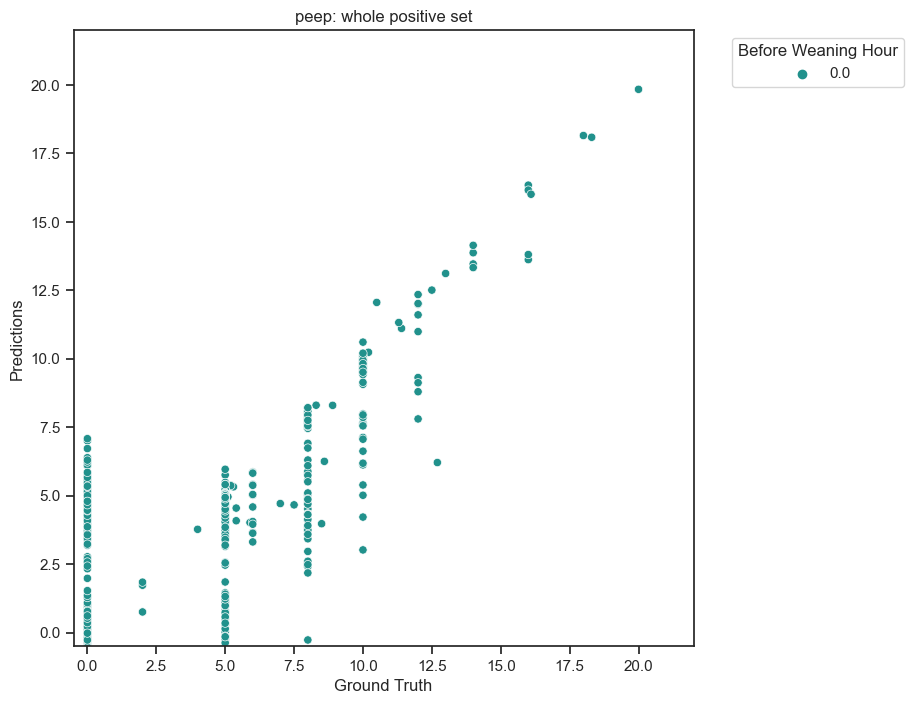

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.75      0.83       839
           1       0.28      0.62      0.39       132

    accuracy                           0.74       971
   macro avg       0.61      0.69      0.61       971
weighted avg       0.84      0.74      0.77       971


whole negative set Mean Squared Error (MSE): 6.1261
whole negative set Mean Absolute Error (MAE): 1.4950
whole negative set R-squared (R2): 0.5287



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


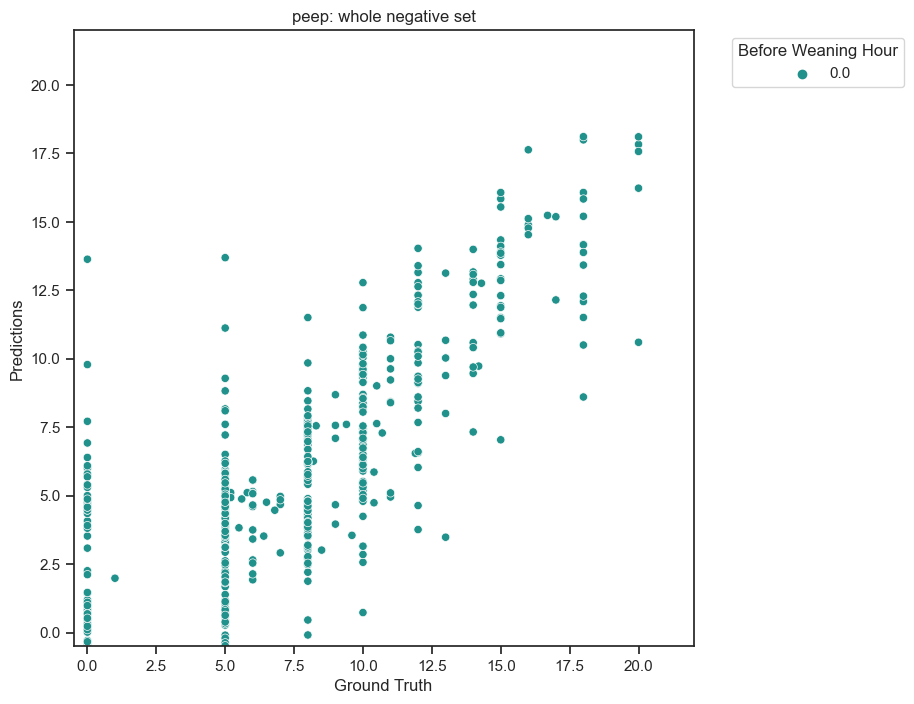

train positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.91      0.94      1096
           1       0.39      0.77      0.52        86

    accuracy                           0.90      1182
   macro avg       0.69      0.84      0.73      1182
weighted avg       0.94      0.90      0.91      1182


train positive set Mean Squared Error (MSE): 1.8812
train positive set Mean Absolute Error (MAE): 0.5517
train positive set R-squared (R2): 0.7184



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


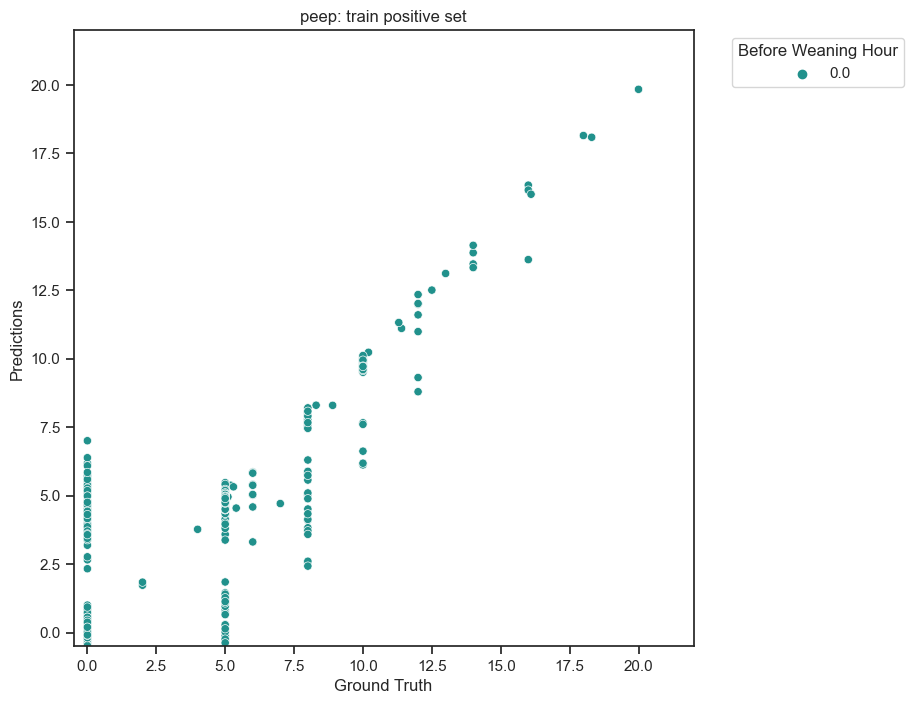

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.86      0.90       161
           1       0.19      0.38      0.25        13

    accuracy                           0.83       174
   macro avg       0.57      0.62      0.58       174
weighted avg       0.89      0.83      0.85       174


val positive set Mean Squared Error (MSE): 4.5866
val positive set Mean Absolute Error (MAE): 1.1889
val positive set R-squared (R2): 0.3391



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


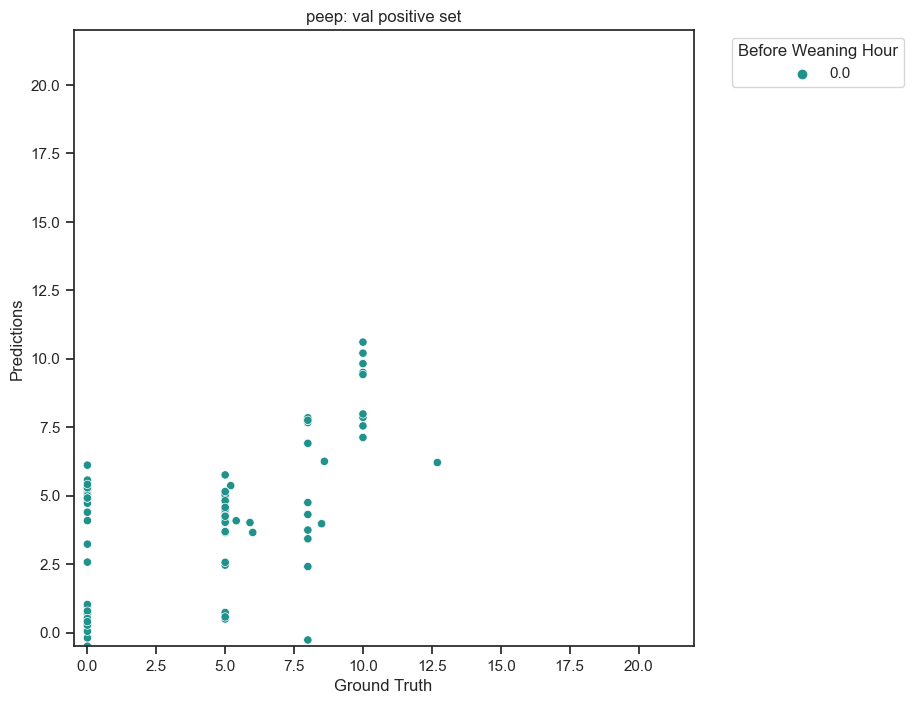

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.86      0.91       316
           1       0.14      0.35      0.20        20

    accuracy                           0.83       336
   macro avg       0.55      0.61      0.55       336
weighted avg       0.91      0.83      0.86       336


test positive set Mean Squared Error (MSE): 4.0454
test positive set Mean Absolute Error (MAE): 1.0632
test positive set R-squared (R2): 0.3167



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


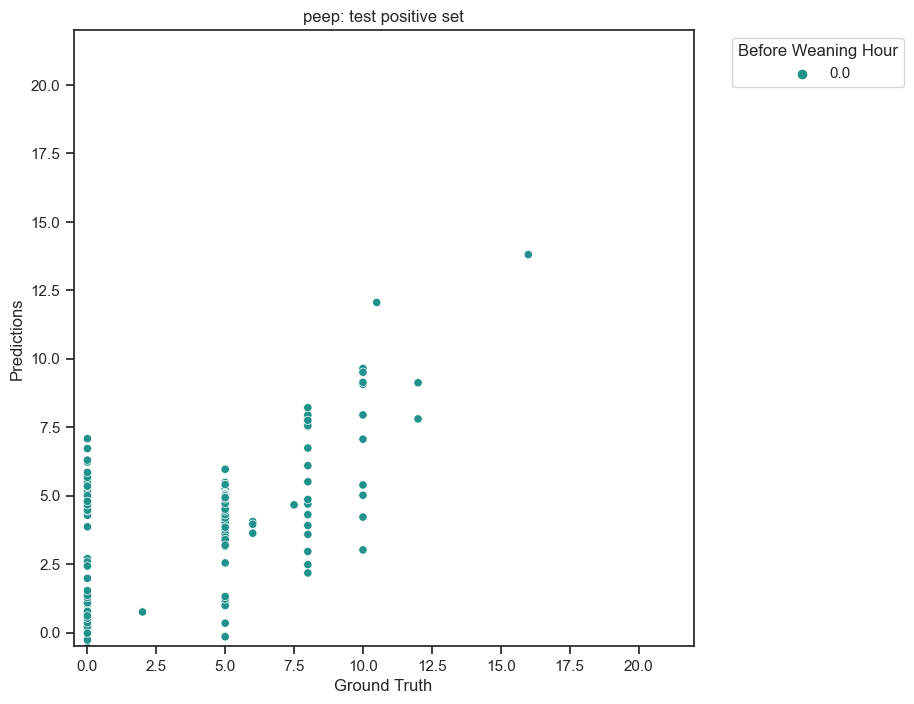

===== feature: fio2 =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.11      0.20      1181
           1       0.33      0.99      0.49       511

    accuracy                           0.38      1692
   macro avg       0.64      0.55      0.35      1692
weighted avg       0.77      0.38      0.29      1692


whole positive set Mean Squared Error (MSE): 190.2141
whole positive set Mean Absolute Error (MAE): 9.6539
whole positive set R-squared (R2): 0.1049



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


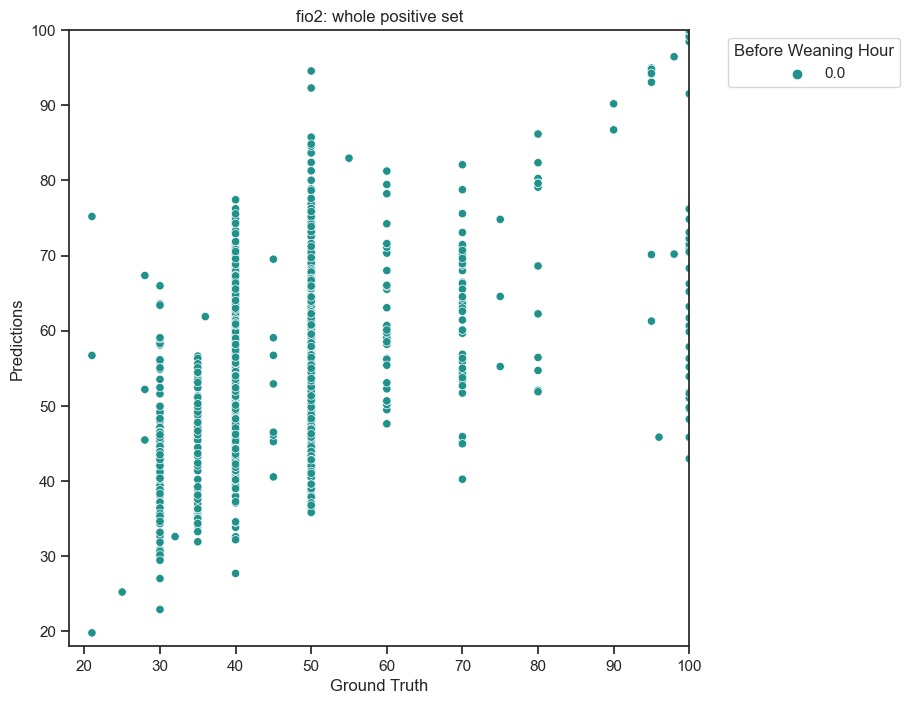

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.06      0.11       698
           1       0.29      0.98      0.45       273

    accuracy                           0.32       971
   macro avg       0.58      0.52      0.28       971
weighted avg       0.71      0.32      0.20       971


whole negative set Mean Squared Error (MSE): 399.4344
whole negative set Mean Absolute Error (MAE): 15.2556
whole negative set R-squared (R2): -0.1135



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


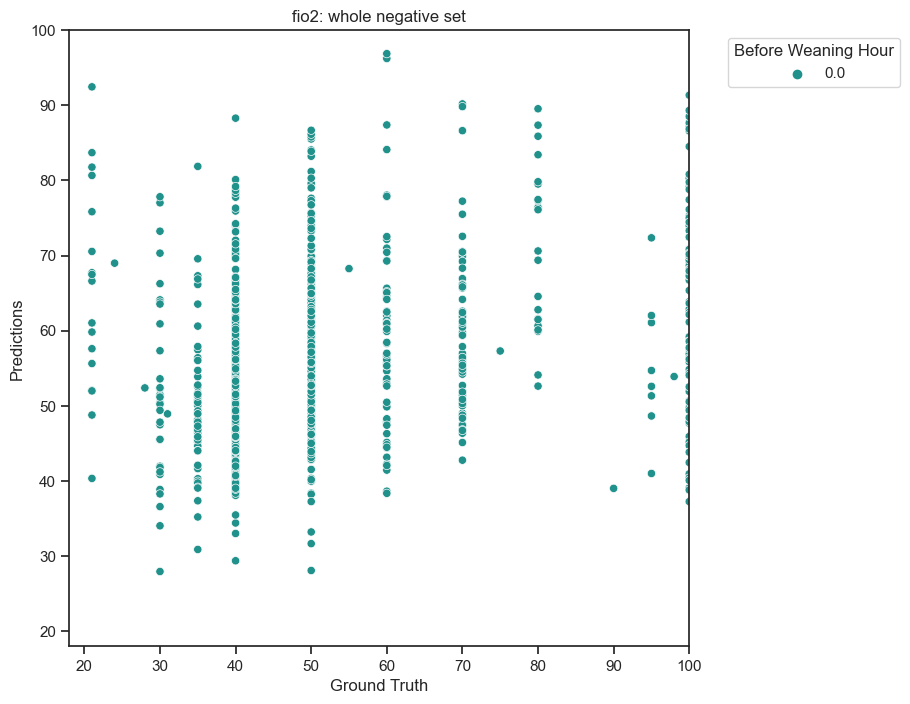

train positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.14      0.25       805
           1       0.35      1.00      0.52       377

    accuracy                           0.42      1182
   macro avg       0.68      0.57      0.39      1182
weighted avg       0.79      0.42      0.34      1182


train positive set Mean Squared Error (MSE): 149.6851
train positive set Mean Absolute Error (MAE): 8.0331
train positive set R-squared (R2): 0.2958



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


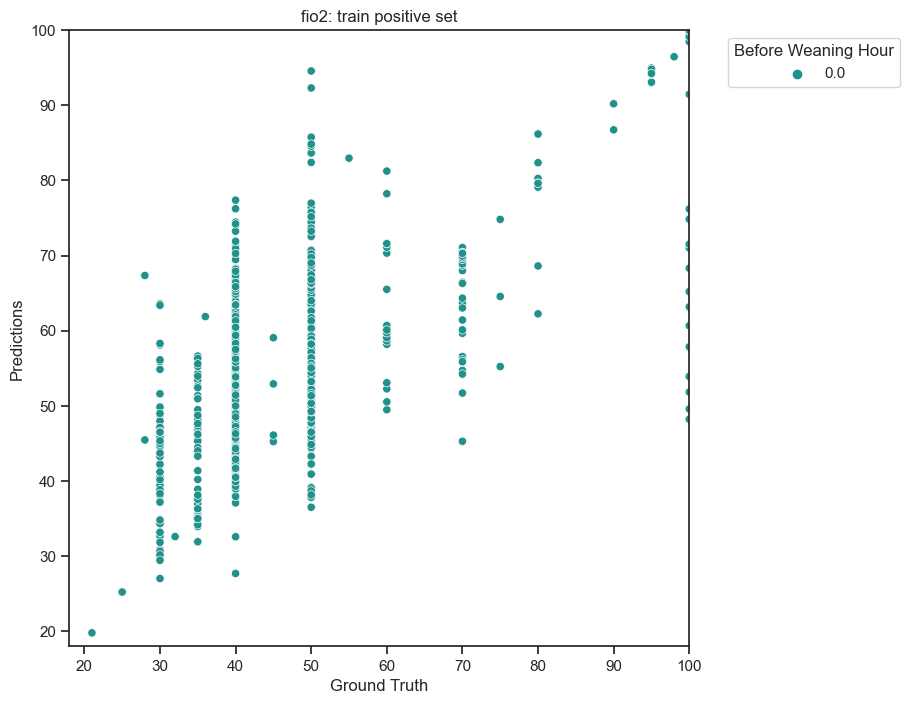

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.80      0.03      0.06       133
           1       0.24      0.98      0.38        41

    accuracy                           0.25       174
   macro avg       0.52      0.50      0.22       174
weighted avg       0.67      0.25      0.13       174


val positive set Mean Squared Error (MSE): 276.7801
val positive set Mean Absolute Error (MAE): 13.1749
val positive set R-squared (R2): -0.3041



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


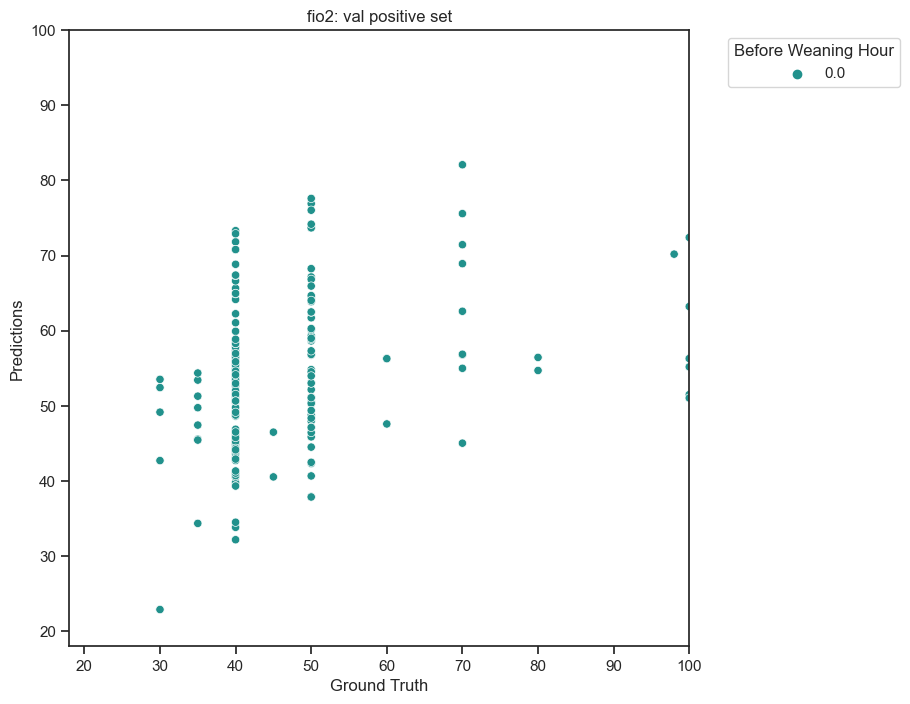

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.06      0.11       243
           1       0.28      0.96      0.43        93

    accuracy                           0.31       336
   macro avg       0.53      0.51      0.27       336
weighted avg       0.64      0.31      0.20       336


test positive set Mean Squared Error (MSE): 287.9604
test positive set Mean Absolute Error (MAE): 13.5324
test positive set R-squared (R2): -0.3569



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


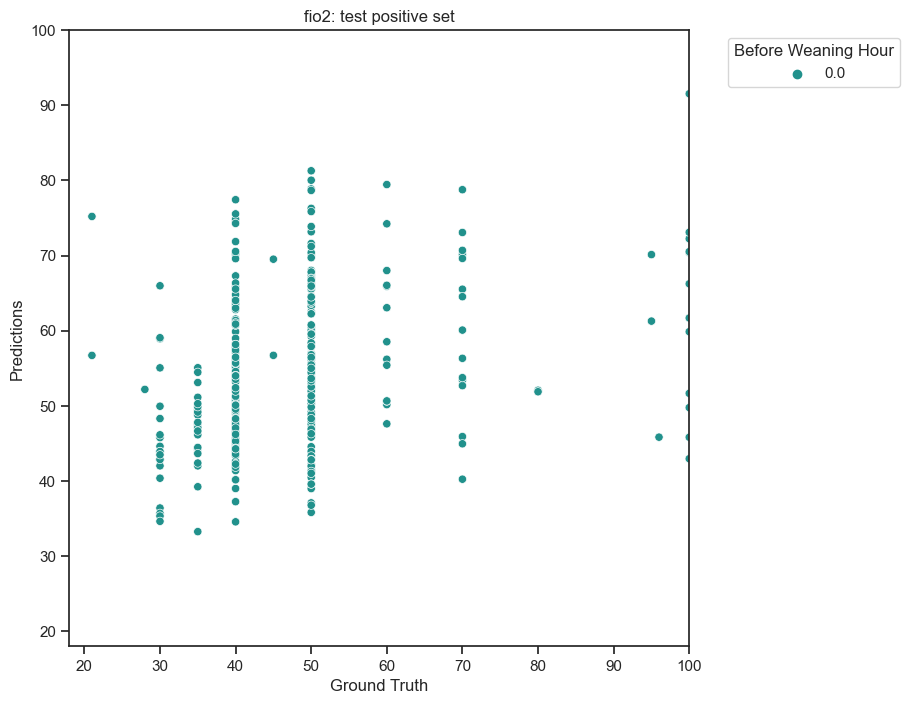

===== feature: respiratory_rate_set =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.97      0.98      1680
           1       0.12      0.67      0.21        12

    accuracy                           0.96      1692
   macro avg       0.56      0.82      0.59      1692
weighted avg       0.99      0.96      0.98      1692


whole positive set Mean Squared Error (MSE): 2.5975
whole positive set Mean Absolute Error (MAE): 0.3512
whole positive set R-squared (R2): 0.9354



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


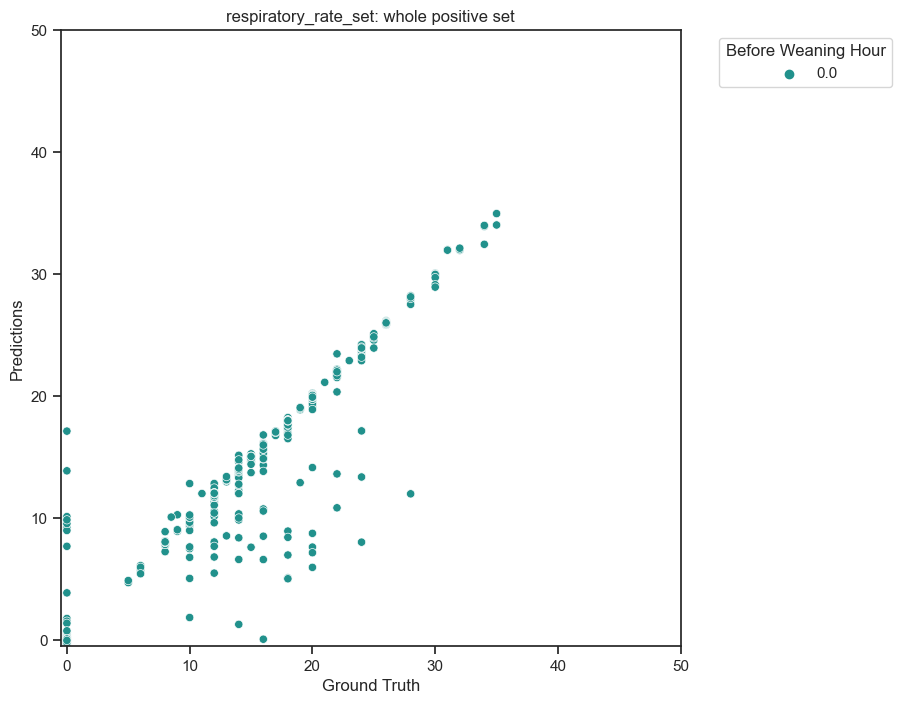

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.96      0.96       938
           1       0.03      0.03      0.03        33

    accuracy                           0.93       971
   macro avg       0.50      0.50      0.50       971
weighted avg       0.93      0.93      0.93       971


whole negative set Mean Squared Error (MSE): 9.1024
whole negative set Mean Absolute Error (MAE): 0.9667
whole negative set R-squared (R2): 0.7986



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


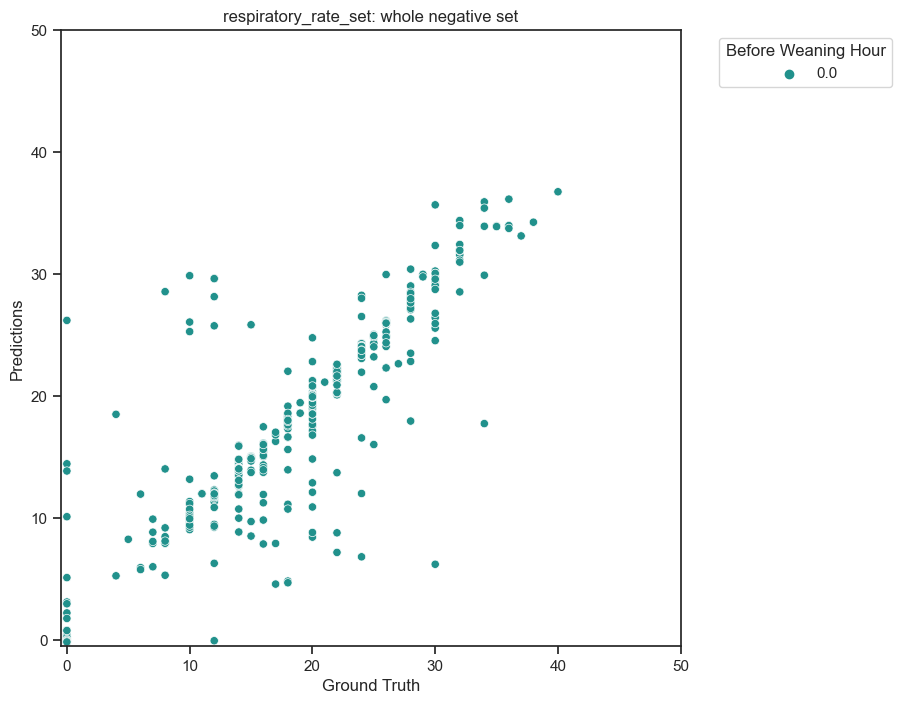

train positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.96      0.98      1174
           1       0.16      1.00      0.27         8

    accuracy                           0.96      1182
   macro avg       0.58      0.98      0.63      1182
weighted avg       0.99      0.96      0.98      1182


train positive set Mean Squared Error (MSE): 2.3179
train positive set Mean Absolute Error (MAE): 0.2986
train positive set R-squared (R2): 0.9391



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


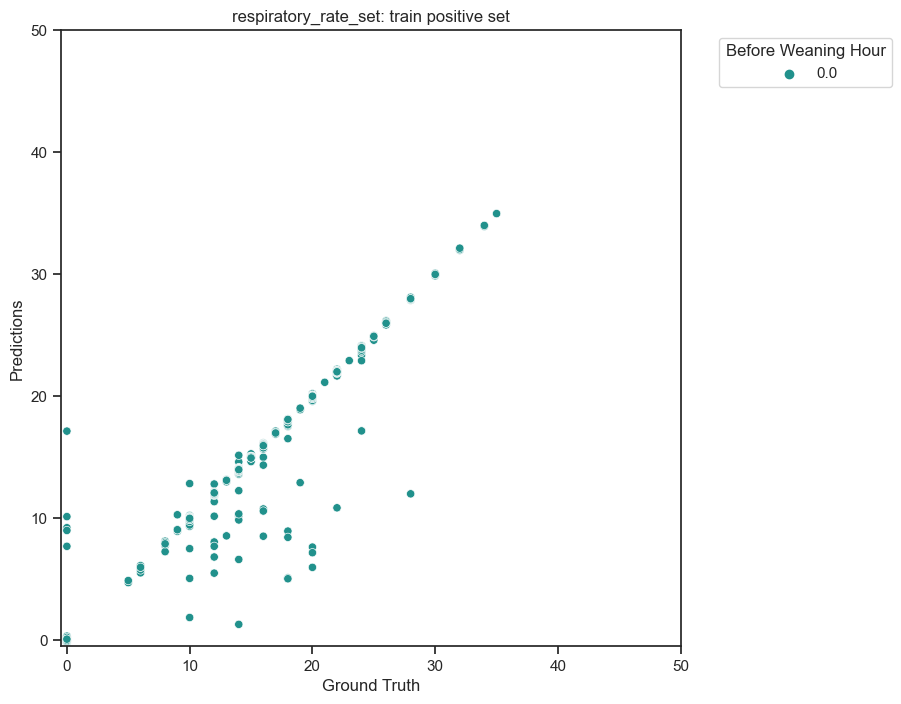

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.98      0.98       172
           1       0.00      0.00      0.00         2

    accuracy                           0.97       174
   macro avg       0.49      0.49      0.49       174
weighted avg       0.98      0.97      0.97       174


val positive set Mean Squared Error (MSE): 1.8846
val positive set Mean Absolute Error (MAE): 0.3299
val positive set R-squared (R2): 0.9588



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


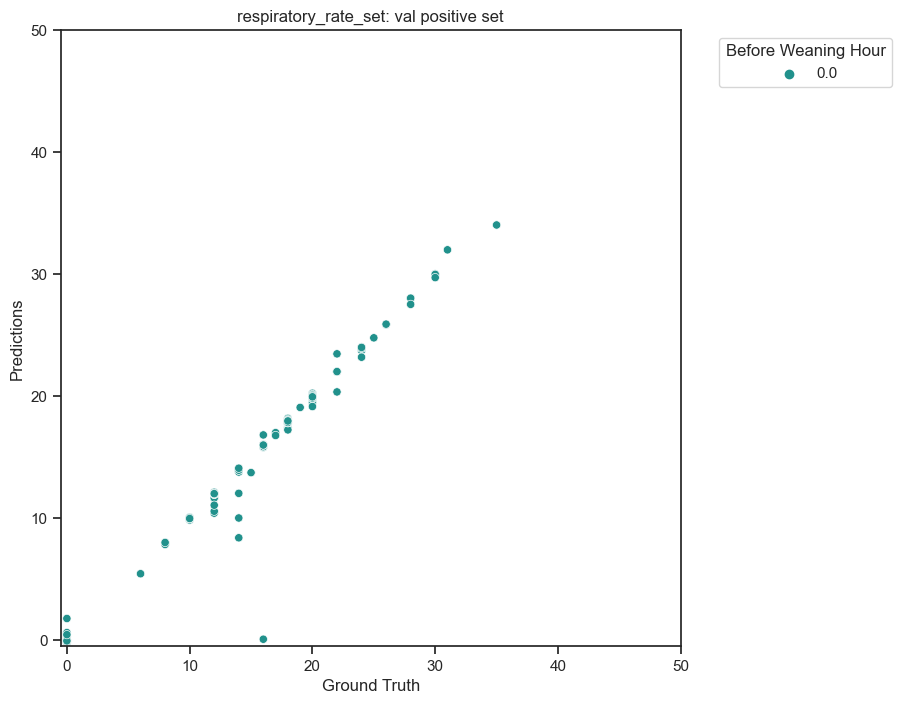

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.97      0.98       334
           1       0.00      0.00      0.00         2

    accuracy                           0.96       336
   macro avg       0.50      0.48      0.49       336
weighted avg       0.99      0.96      0.97       336


test positive set Mean Squared Error (MSE): 3.9499
test positive set Mean Absolute Error (MAE): 0.5473
test positive set R-squared (R2): 0.9117



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


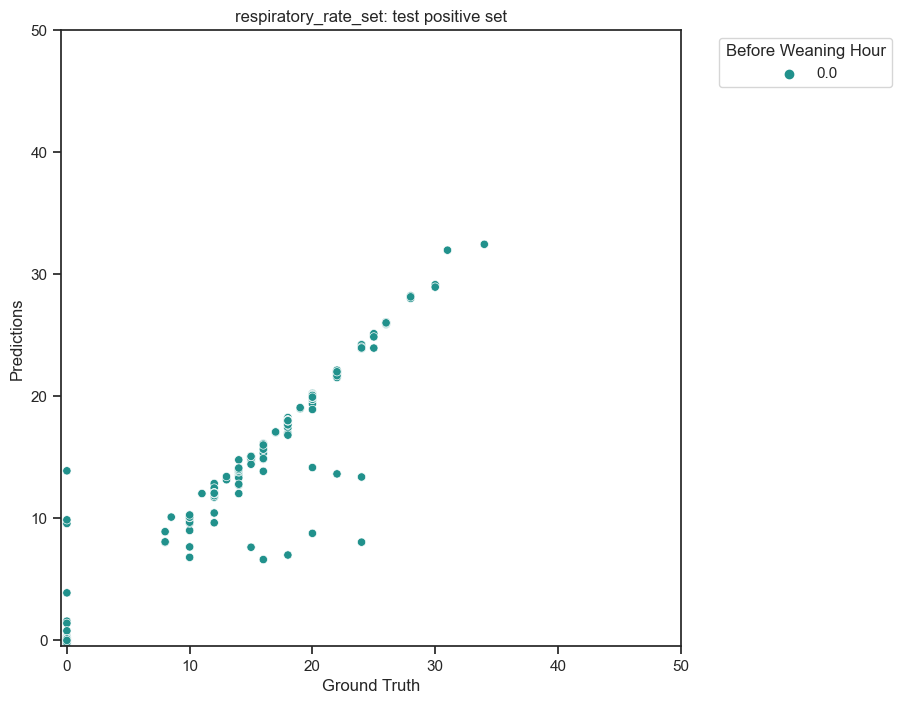

===== feature: plateau_pressure =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.98      0.99      1641
           1       0.53      0.76      0.62        51

    accuracy                           0.97      1692
   macro avg       0.76      0.87      0.80      1692
weighted avg       0.98      0.97      0.97      1692


whole positive set Mean Squared Error (MSE): 0.4024
whole positive set Mean Absolute Error (MAE): 0.1430
whole positive set R-squared (R2): 0.9801



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


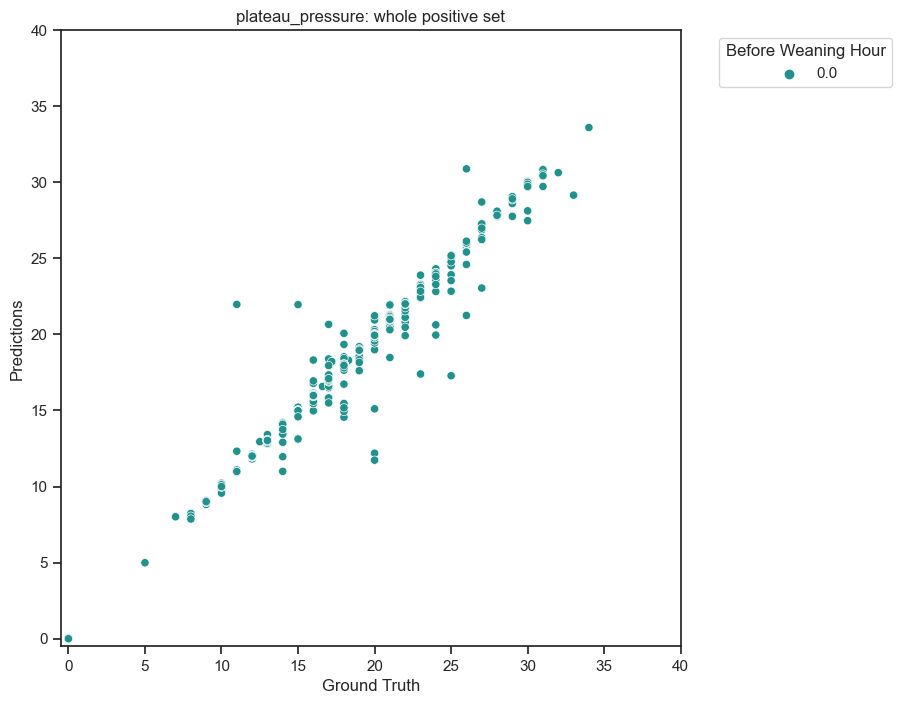

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.92      0.92       857
           1       0.37      0.37      0.37       114

    accuracy                           0.85       971
   macro avg       0.64      0.64      0.64       971
weighted avg       0.85      0.85      0.85       971


whole negative set Mean Squared Error (MSE): 6.1462
whole negative set Mean Absolute Error (MAE): 0.9122
whole negative set R-squared (R2): 0.8100



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


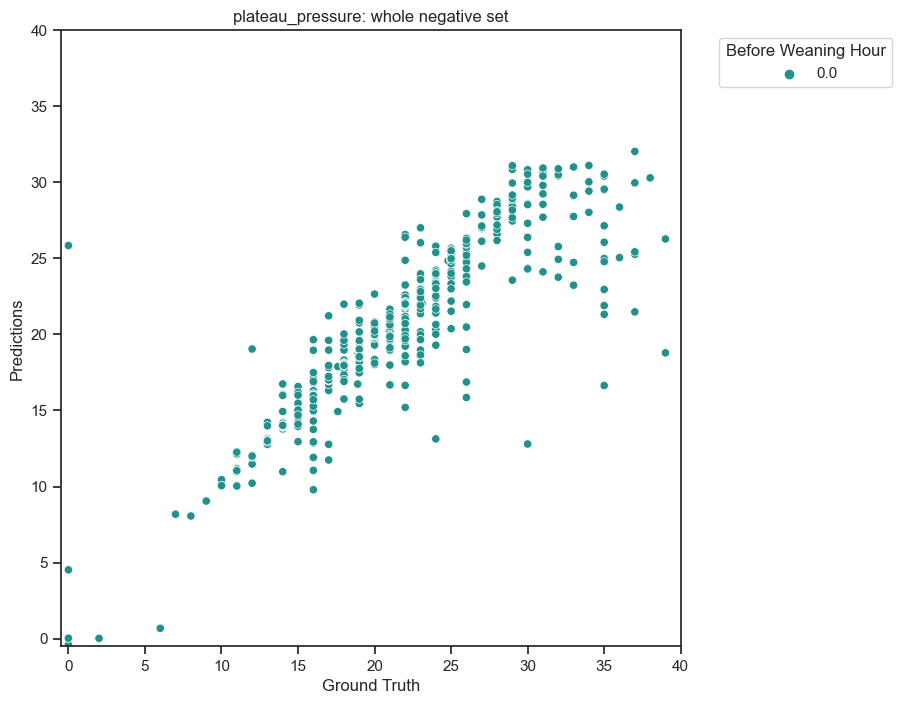

train positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.98      0.99      1147
           1       0.56      0.97      0.71        35

    accuracy                           0.98      1182
   macro avg       0.78      0.97      0.85      1182
weighted avg       0.99      0.98      0.98      1182


train positive set Mean Squared Error (MSE): 0.2870
train positive set Mean Absolute Error (MAE): 0.0992
train positive set R-squared (R2): 0.9859



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


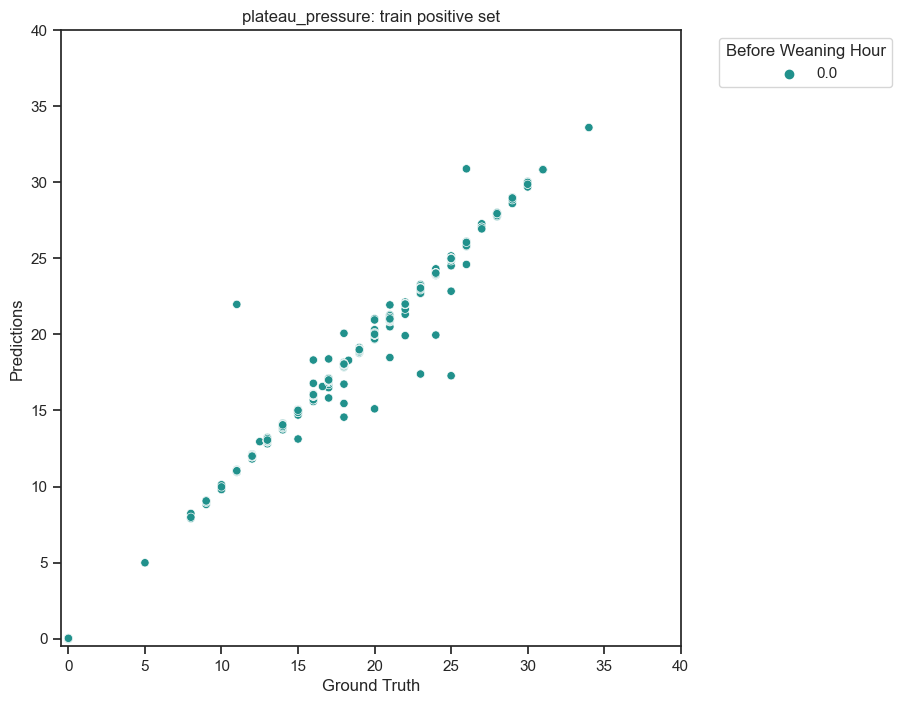

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.99      0.97       164
           1       0.50      0.10      0.17        10

    accuracy                           0.94       174
   macro avg       0.72      0.55      0.57       174
weighted avg       0.92      0.94      0.92       174


val positive set Mean Squared Error (MSE): 0.4753
val positive set Mean Absolute Error (MAE): 0.2297
val positive set R-squared (R2): 0.9736



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


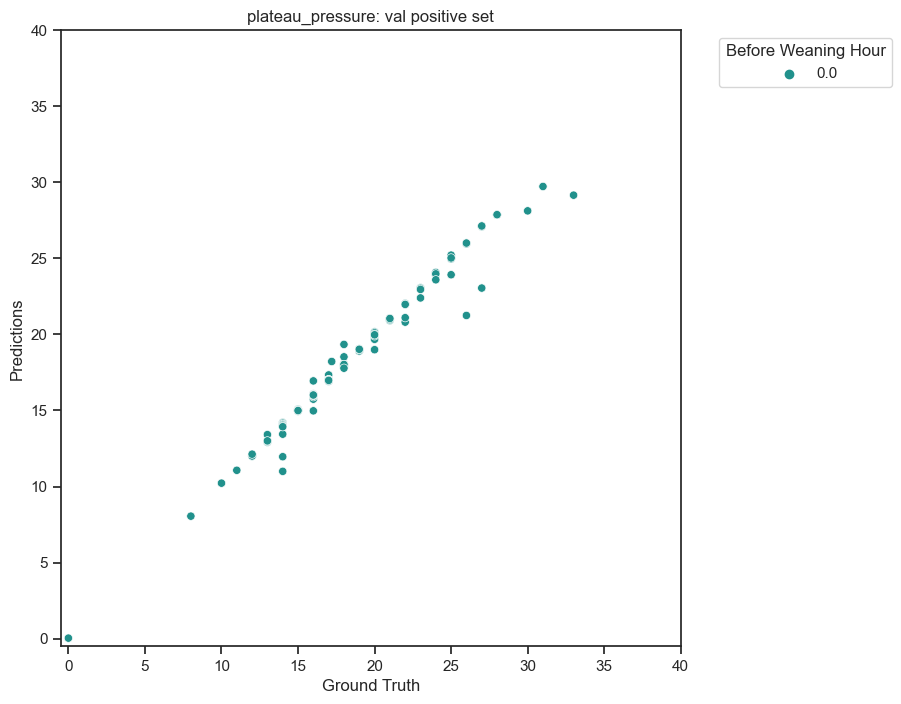

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.98      0.99       330
           1       0.36      0.67      0.47         6

    accuracy                           0.97       336
   macro avg       0.68      0.82      0.73       336
weighted avg       0.98      0.97      0.98       336


test positive set Mean Squared Error (MSE): 0.7706
test positive set Mean Absolute Error (MAE): 0.2520
test positive set R-squared (R2): 0.9635



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\3069833610.py:80: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


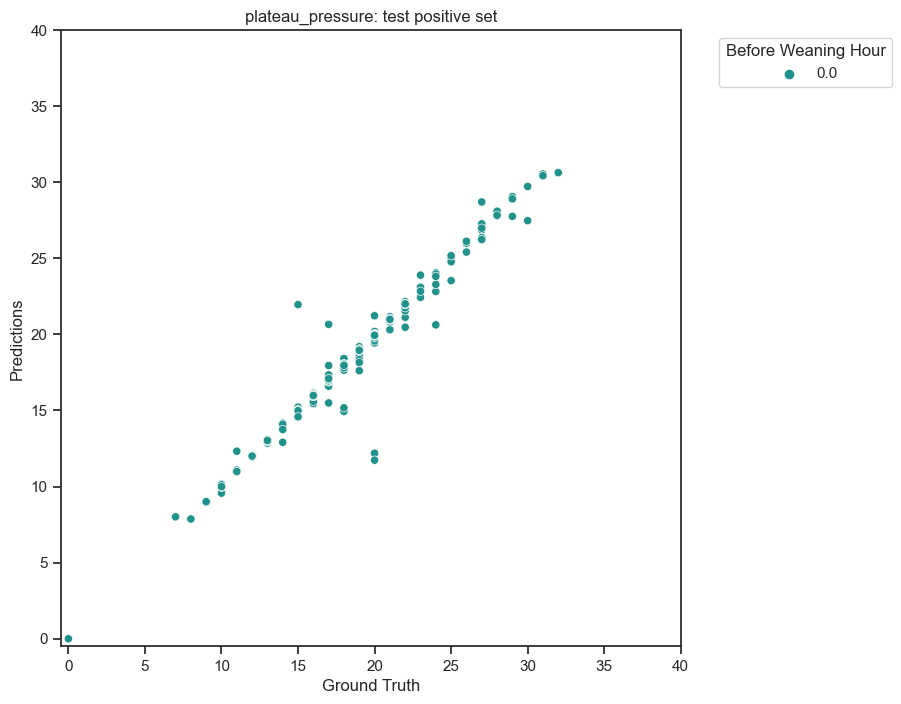

In [561]:
feature_columns = [
    'before_weaning_hr', 'age_now', 'weight_kg',
    'height_cm', 'tobacco', 'heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 'tidal_volume_observed', 'RSBI',
    'minute_ventilation', 'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h', 'mbp_prev_1h', 'spo2_prev_1h',
    'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h', 
    'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h',
]
threshold_hr = 1
for feature in ventilator_settings:
    print(f'===== feature: {feature} =====')
    model_A_inference_pro(whole_change_label_value_aug_df[whole_change_label_value_aug_df["before_weaning_hr"]<threshold_hr], model_A_dict, feature, feature_columns, 'whole positive set')
    model_A_inference_pro(negative_change_label_value_aug_df[negative_change_label_value_aug_df["before_weaning_hr"]<threshold_hr], model_A_dict, feature, feature_columns, 'whole negative set')
    model_A_inference_pro(train_change_label_value_aug_df[train_change_label_value_aug_df["before_weaning_hr"]<threshold_hr], model_A_dict, feature, feature_columns, 'train positive set')
    model_A_inference_pro(val_change_label_value_aug_df[val_change_label_value_aug_df["before_weaning_hr"]<threshold_hr], model_A_dict, feature, feature_columns, 'val positive set')
    model_A_inference_pro(test_change_label_value_aug_df[test_change_label_value_aug_df["before_weaning_hr"]<threshold_hr], model_A_dict, feature, feature_columns, 'test positive set')

pro 12hr

===== feature: peep =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.91      0.94     18877
           1       0.36      0.64      0.46      1427

    accuracy                           0.89     20304
   macro avg       0.67      0.78      0.70     20304
weighted avg       0.93      0.89      0.91     20304


whole positive set Mean Squared Error (MSE): 1.8746
whole positive set Mean Absolute Error (MAE): 0.5594
whole positive set R-squared (R2): 0.6856



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


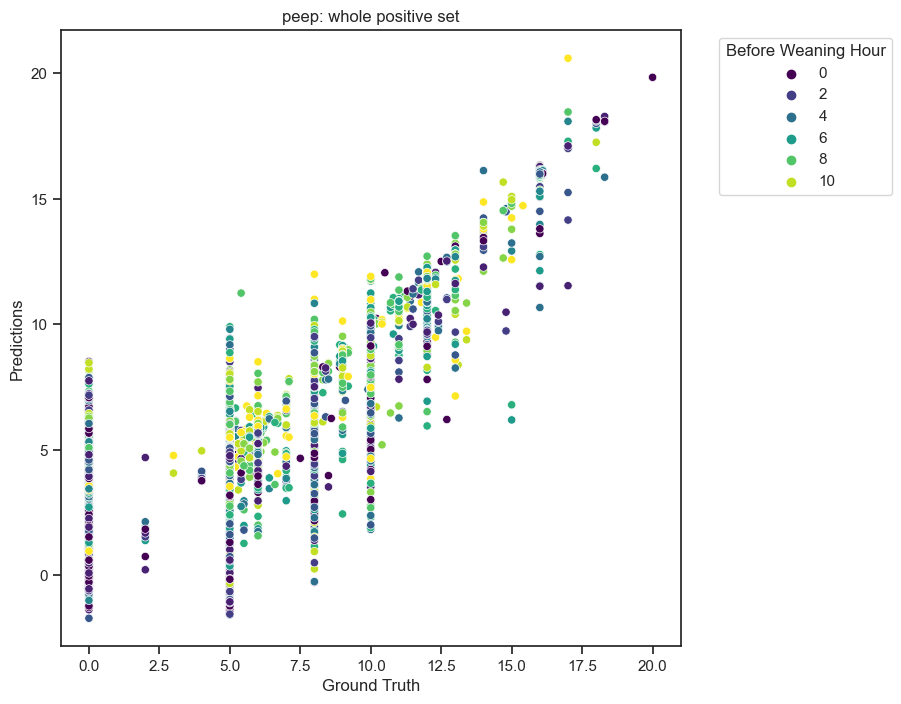

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.83      0.89     10776
           1       0.20      0.51      0.29       876

    accuracy                           0.81     11652
   macro avg       0.58      0.67      0.59     11652
weighted avg       0.90      0.81      0.84     11652


whole negative set Mean Squared Error (MSE): 3.8132
whole negative set Mean Absolute Error (MAE): 1.0297
whole negative set R-squared (R2): 0.6918



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


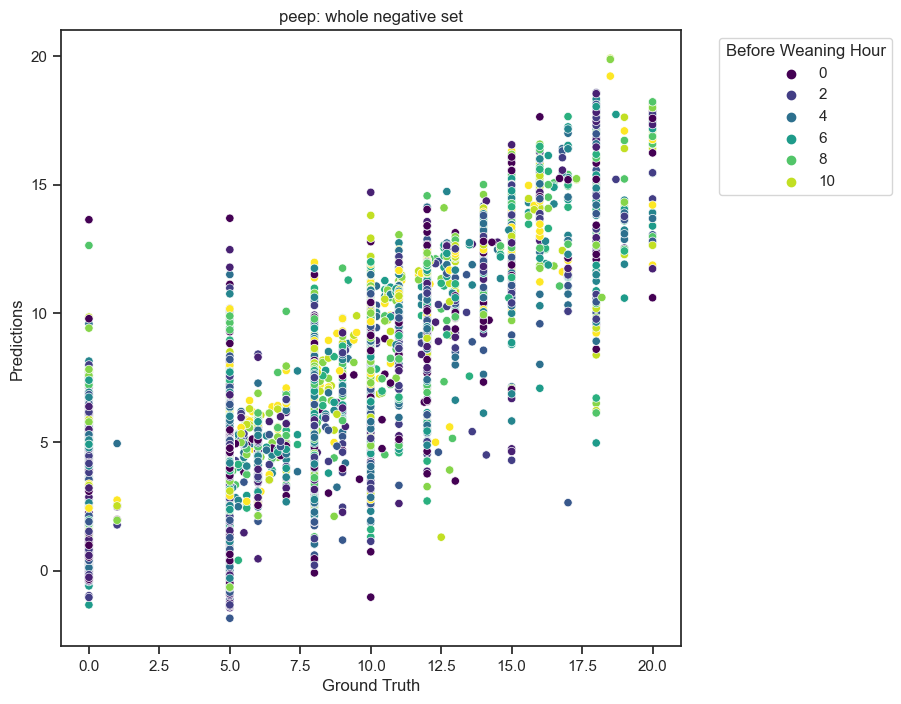

train positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.92      0.95     13185
           1       0.41      0.73      0.53       999

    accuracy                           0.91     14184
   macro avg       0.69      0.83      0.74     14184
weighted avg       0.94      0.91      0.92     14184


train positive set Mean Squared Error (MSE): 1.4745
train positive set Mean Absolute Error (MAE): 0.4593
train positive set R-squared (R2): 0.7588



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


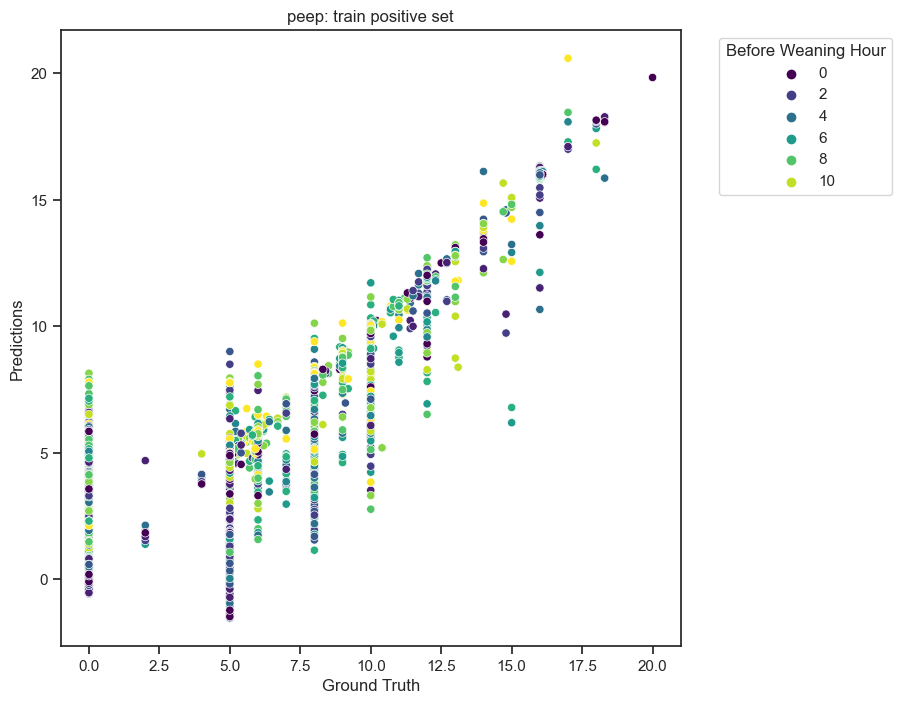

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.88      0.92      1947
           1       0.21      0.44      0.29       141

    accuracy                           0.85      2088
   macro avg       0.58      0.66      0.60      2088
weighted avg       0.91      0.85      0.87      2088


val positive set Mean Squared Error (MSE): 2.9666
val positive set Mean Absolute Error (MAE): 0.8345
val positive set R-squared (R2): 0.4897



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


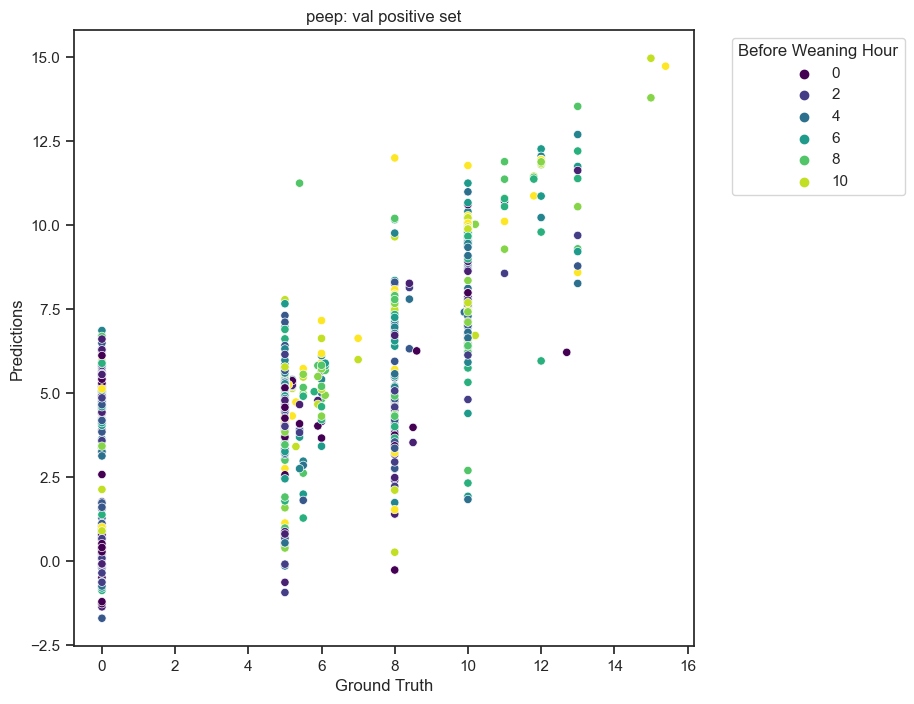

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.91      0.93      3745
           1       0.26      0.43      0.33       287

    accuracy                           0.87      4032
   macro avg       0.61      0.67      0.63      4032
weighted avg       0.90      0.87      0.89      4032


test positive set Mean Squared Error (MSE): 2.7164
test positive set Mean Absolute Error (MAE): 0.7692
test positive set R-squared (R2): 0.5063



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


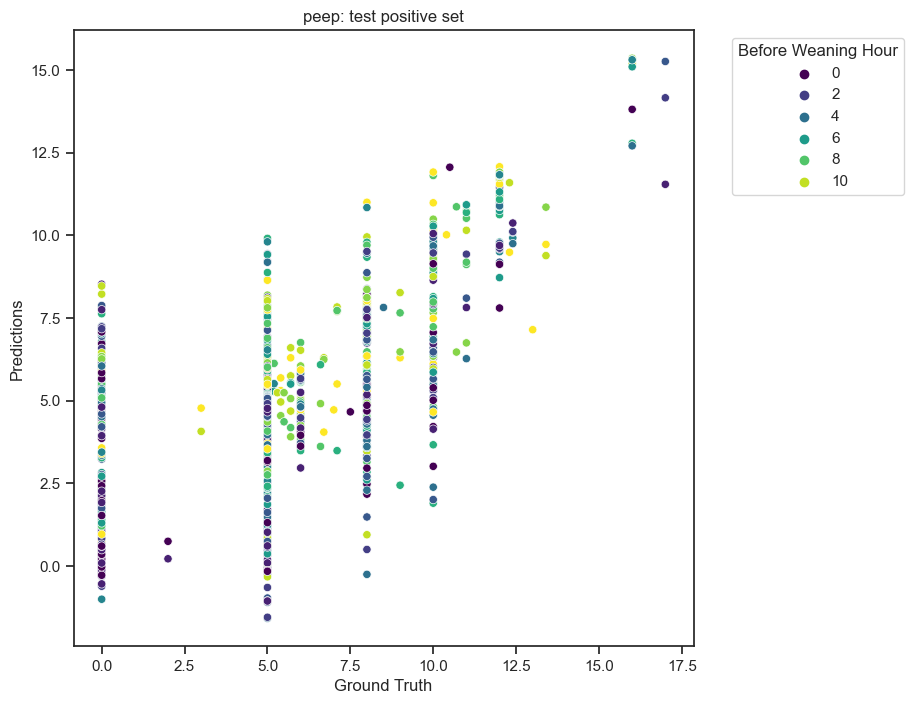

===== feature: fio2 =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.90      0.94     19127
           1       0.31      0.76      0.44      1177

    accuracy                           0.89     20304
   macro avg       0.65      0.83      0.69     20304
weighted avg       0.94      0.89      0.91     20304


whole positive set Mean Squared Error (MSE): 41.7037
whole positive set Mean Absolute Error (MAE): 2.1451
whole positive set R-squared (R2): 0.5896



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


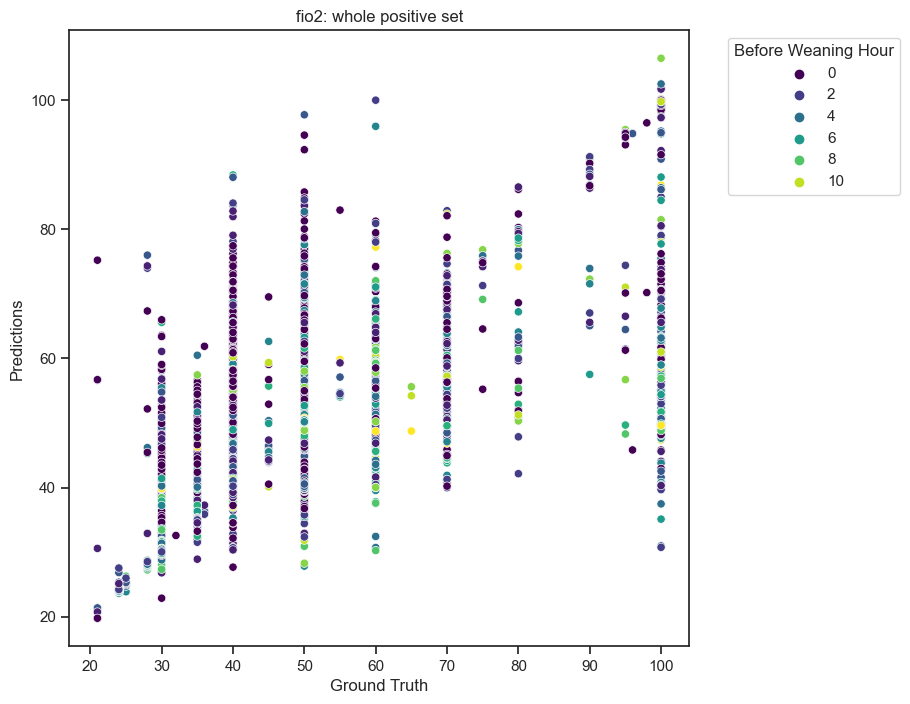

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.82      0.89     10973
           1       0.17      0.57      0.26       679

    accuracy                           0.81     11652
   macro avg       0.57      0.70      0.57     11652
weighted avg       0.92      0.81      0.85     11652


whole negative set Mean Squared Error (MSE): 139.9600
whole negative set Mean Absolute Error (MAE): 5.1189
whole negative set R-squared (R2): 0.4299



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


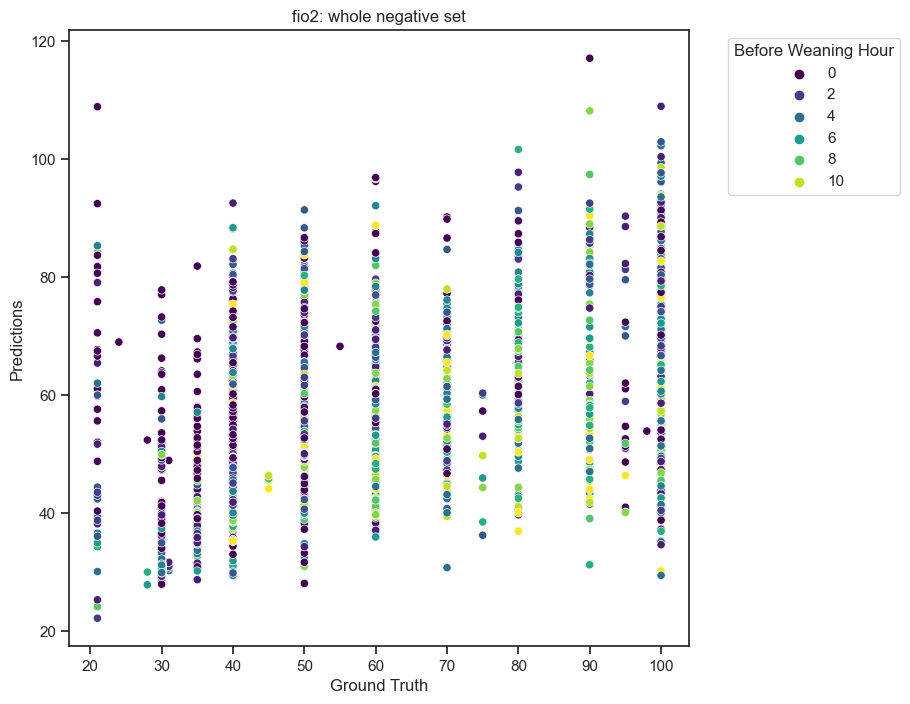

train positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.90      0.94     13354
           1       0.36      0.87      0.51       830

    accuracy                           0.90     14184
   macro avg       0.67      0.89      0.72     14184
weighted avg       0.95      0.90      0.92     14184


train positive set Mean Squared Error (MSE): 31.6639
train positive set Mean Absolute Error (MAE): 1.7467
train positive set R-squared (R2): 0.6781



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


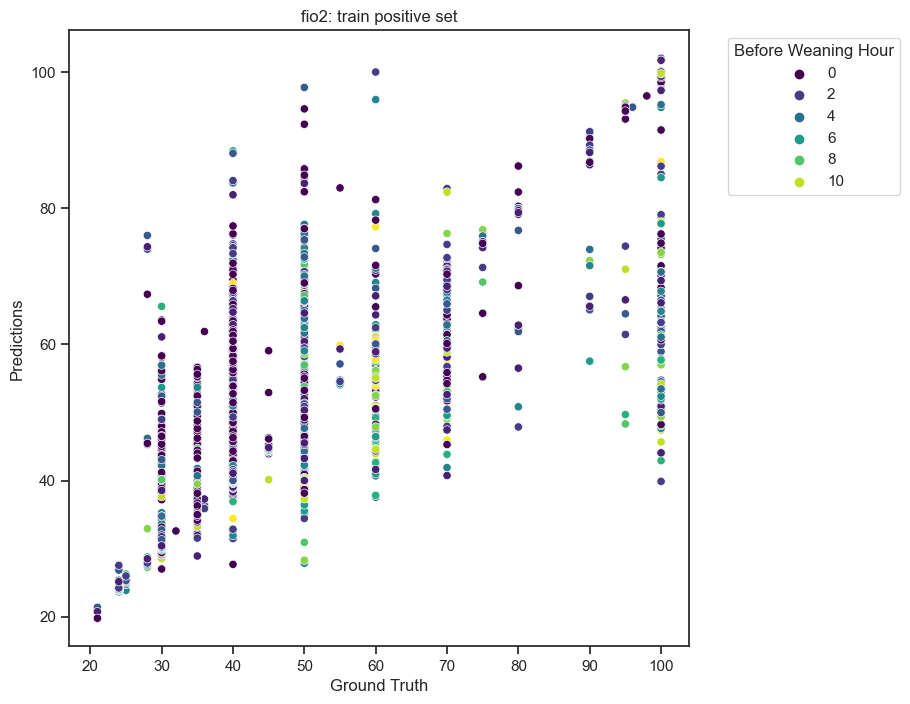

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.89      0.93      1972
           1       0.21      0.52      0.30       116

    accuracy                           0.86      2088
   macro avg       0.59      0.70      0.61      2088
weighted avg       0.93      0.86      0.89      2088


val positive set Mean Squared Error (MSE): 62.7552
val positive set Mean Absolute Error (MAE): 3.0152
val positive set R-squared (R2): 0.4038



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


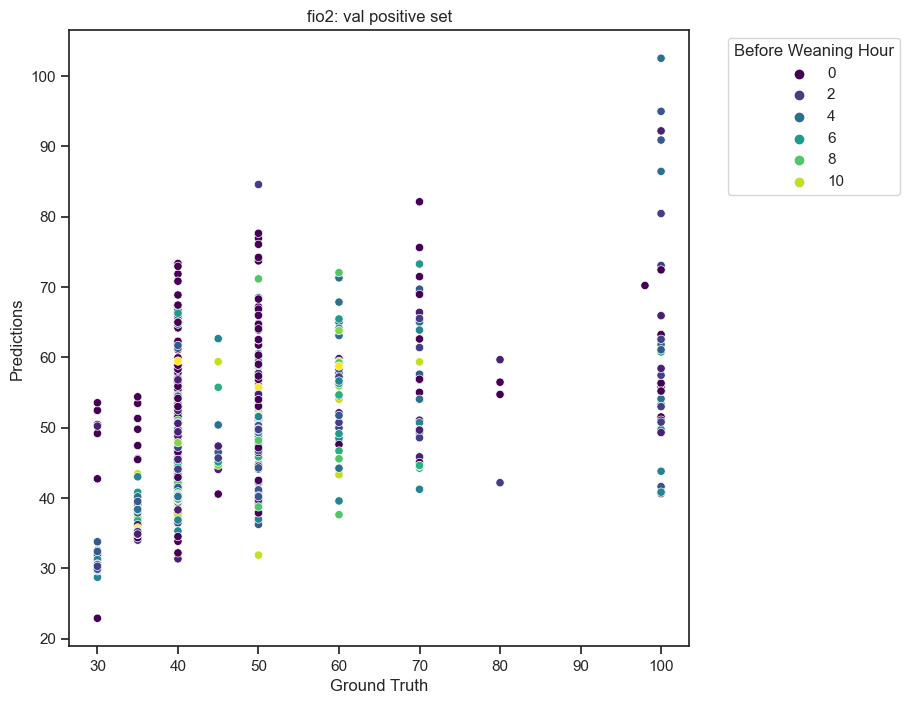

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.88      0.92      3801
           1       0.20      0.48      0.29       231

    accuracy                           0.86      4032
   macro avg       0.58      0.68      0.60      4032
weighted avg       0.92      0.86      0.89      4032


test positive set Mean Squared Error (MSE): 66.1207
test positive set Mean Absolute Error (MAE): 3.0962
test positive set R-squared (R2): 0.4044



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


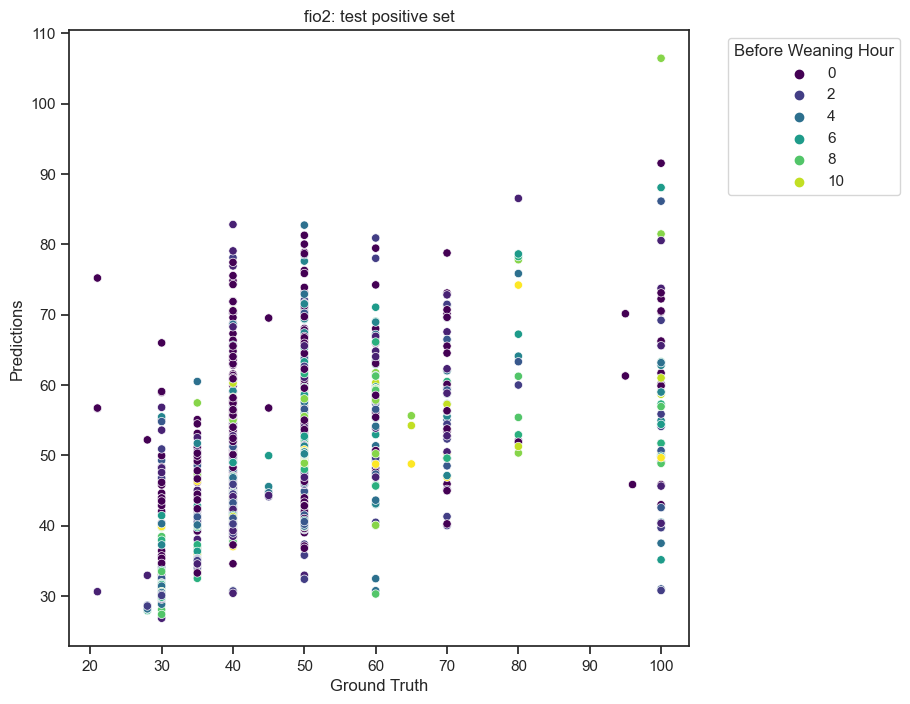

===== feature: respiratory_rate_set =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.94      0.97     20110
           1       0.11      0.75      0.19       194

    accuracy                           0.94     20304
   macro avg       0.55      0.85      0.58     20304
weighted avg       0.99      0.94      0.96     20304


whole positive set Mean Squared Error (MSE): 3.5840
whole positive set Mean Absolute Error (MAE): 0.4515
whole positive set R-squared (R2): 0.9055



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


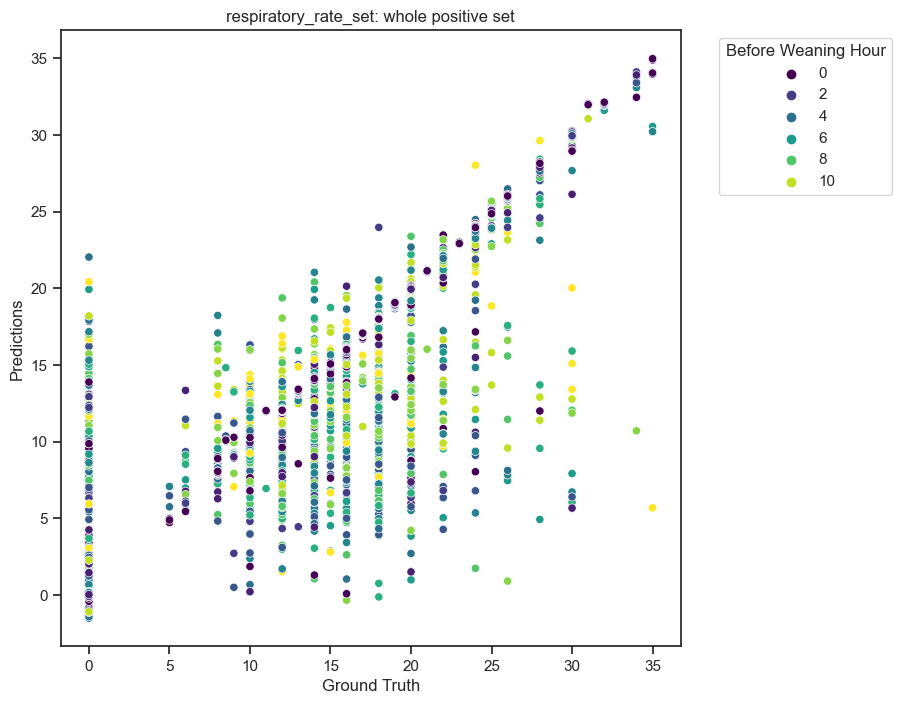

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.95      0.97     11483
           1       0.04      0.15      0.06       169

    accuracy                           0.94     11652
   macro avg       0.51      0.55      0.52     11652
weighted avg       0.97      0.94      0.95     11652


whole negative set Mean Squared Error (MSE): 5.4551
whole negative set Mean Absolute Error (MAE): 0.7102
whole negative set R-squared (R2): 0.8764



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


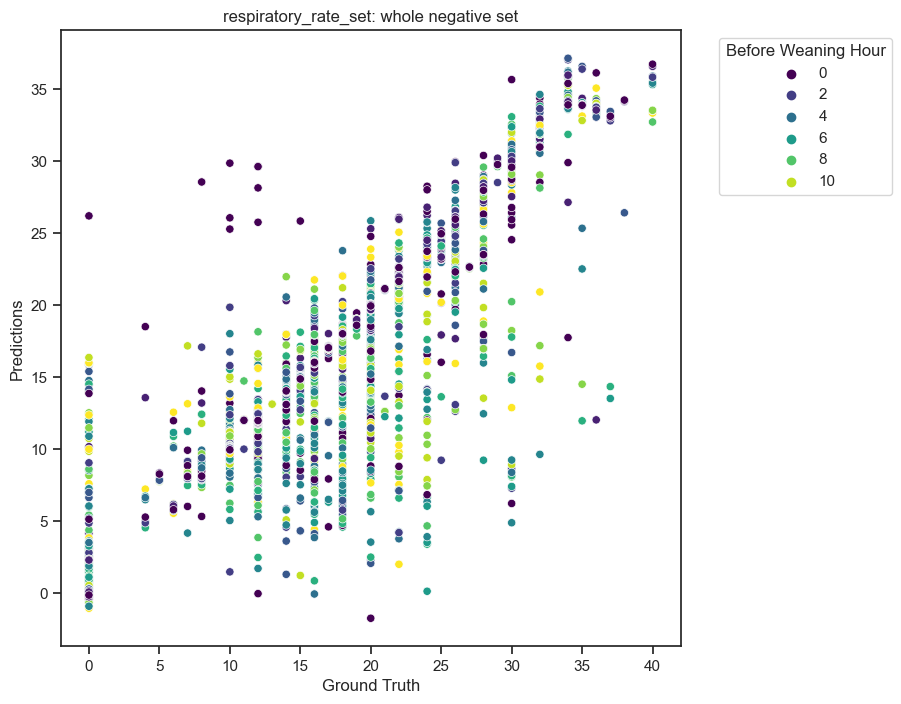

train positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.94      0.97     14050
           1       0.15      1.00      0.25       134

    accuracy                           0.94     14184
   macro avg       0.57      0.97      0.61     14184
weighted avg       0.99      0.94      0.96     14184


train positive set Mean Squared Error (MSE): 3.0650
train positive set Mean Absolute Error (MAE): 0.3809
train positive set R-squared (R2): 0.9157



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


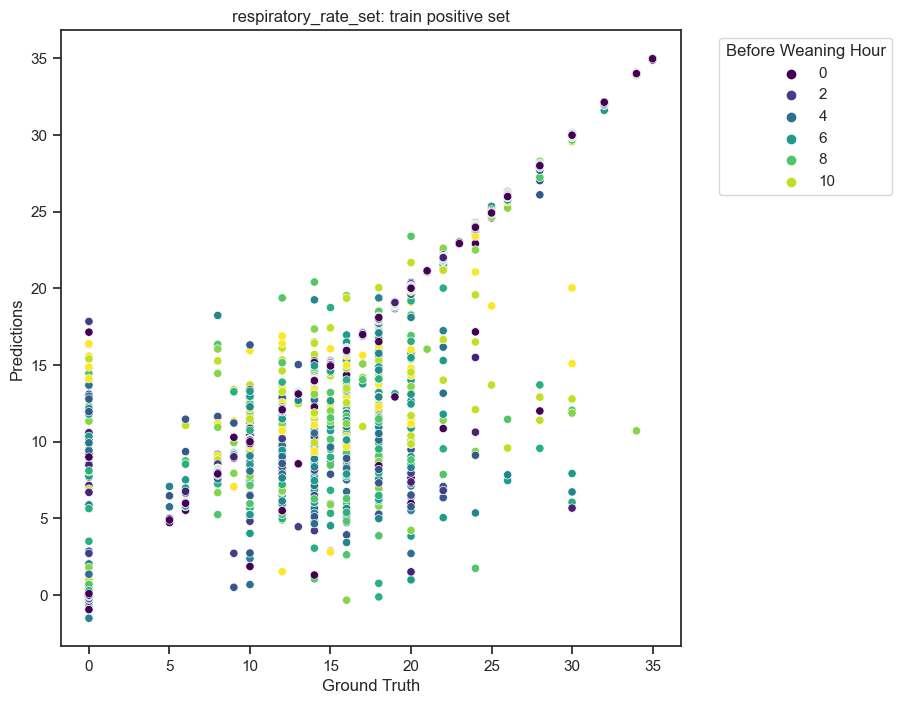

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.94      0.96      2067
           1       0.02      0.14      0.04        21

    accuracy                           0.93      2088
   macro avg       0.51      0.54      0.50      2088
weighted avg       0.98      0.93      0.96      2088


val positive set Mean Squared Error (MSE): 5.1242
val positive set Mean Absolute Error (MAE): 0.6227
val positive set R-squared (R2): 0.8776



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


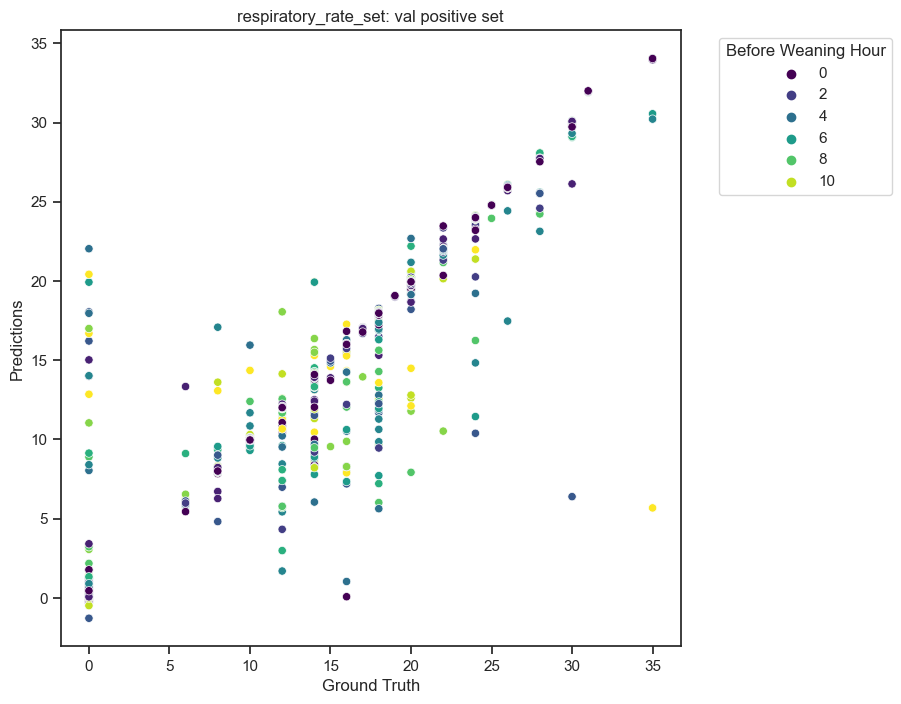

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.94      0.97      3993
           1       0.03      0.21      0.06        39

    accuracy                           0.93      4032
   macro avg       0.51      0.57      0.51      4032
weighted avg       0.98      0.93      0.96      4032


test positive set Mean Squared Error (MSE): 4.6123
test positive set Mean Absolute Error (MAE): 0.6110
test positive set R-squared (R2): 0.8887



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


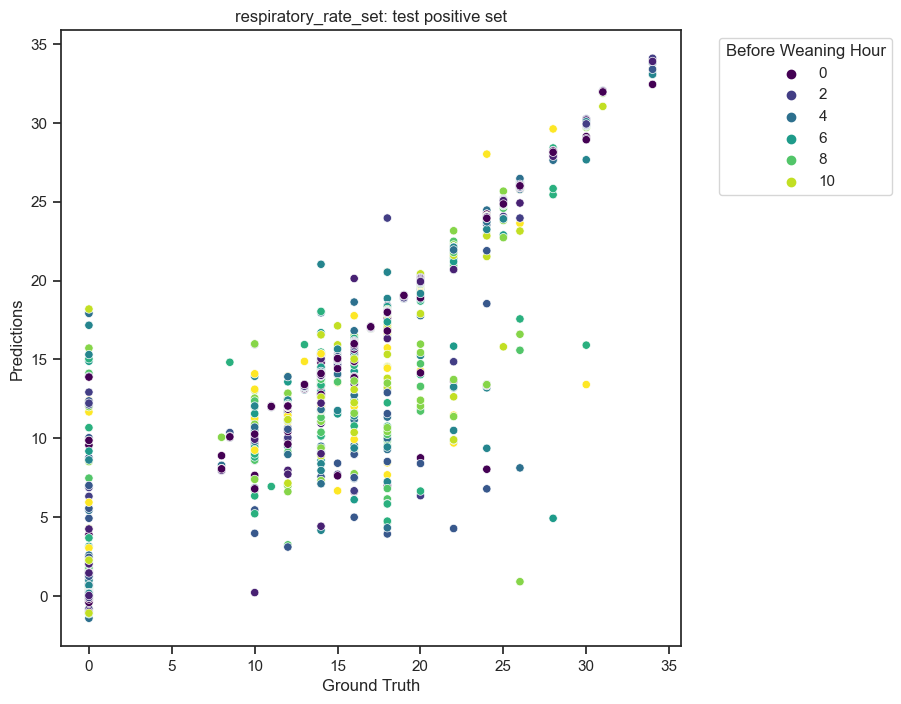

===== feature: plateau_pressure =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.96      0.97     19863
           1       0.25      0.69      0.37       441

    accuracy                           0.95     20304
   macro avg       0.62      0.82      0.67     20304
weighted avg       0.98      0.95      0.96     20304


whole positive set Mean Squared Error (MSE): 0.3192
whole positive set Mean Absolute Error (MAE): 0.1494
whole positive set R-squared (R2): 0.9840



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


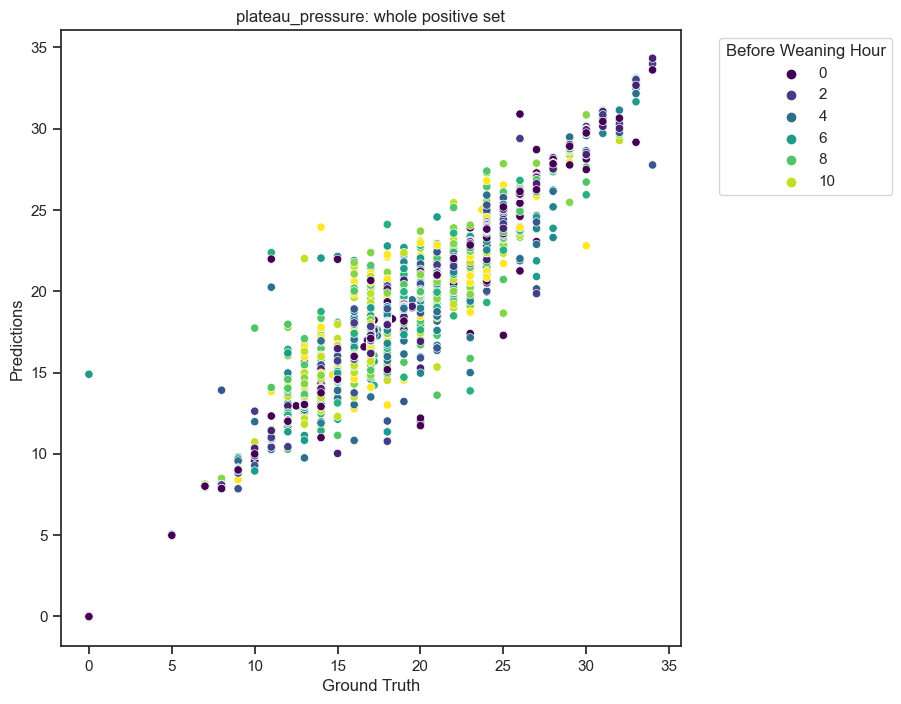

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.91      0.93     11055
           1       0.16      0.33      0.22       597

    accuracy                           0.88     11652
   macro avg       0.56      0.62      0.58     11652
weighted avg       0.92      0.88      0.90     11652


whole negative set Mean Squared Error (MSE): 3.5791
whole negative set Mean Absolute Error (MAE): 0.6435
whole negative set R-squared (R2): 0.8839



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


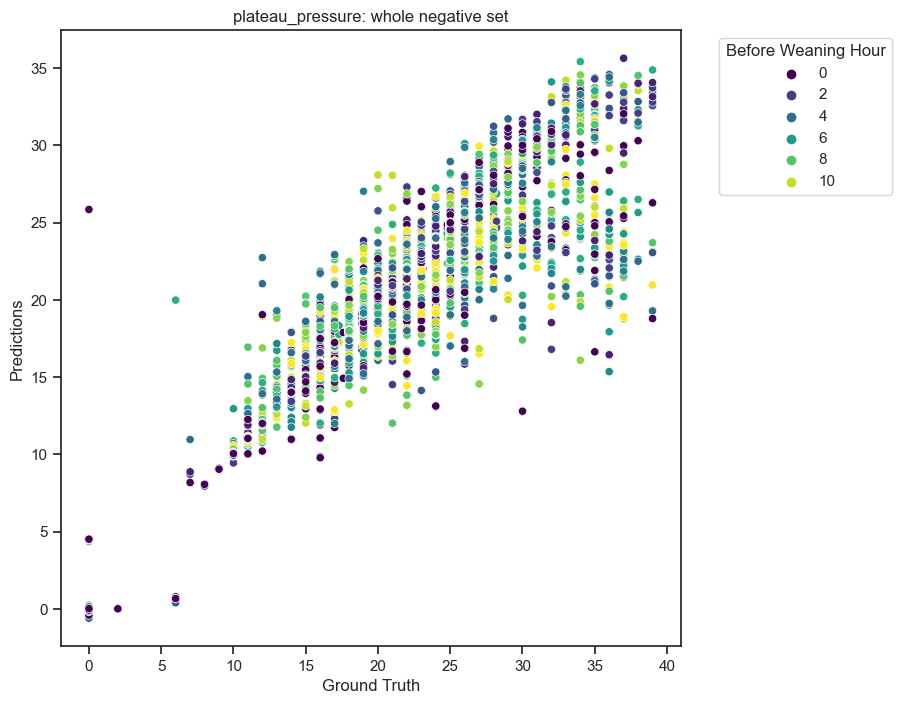

train positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.95      0.98     13896
           1       0.29      0.91      0.44       288

    accuracy                           0.95     14184
   macro avg       0.64      0.93      0.71     14184
weighted avg       0.98      0.95      0.96     14184


train positive set Mean Squared Error (MSE): 0.2117
train positive set Mean Absolute Error (MAE): 0.1107
train positive set R-squared (R2): 0.9894



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


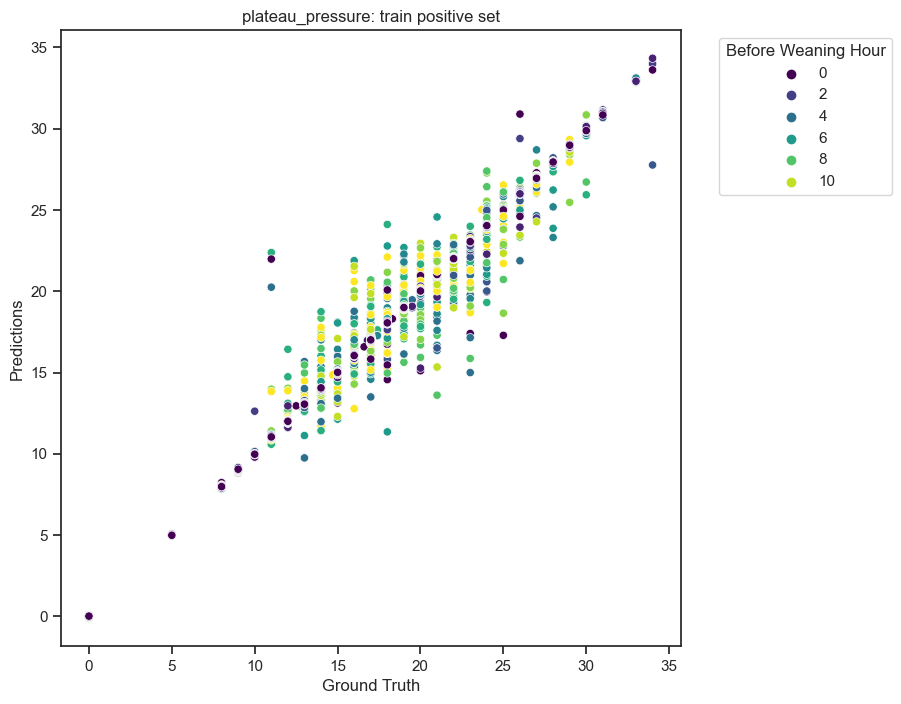

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.97      0.97      2026
           1       0.16      0.21      0.18        62

    accuracy                           0.94      2088
   macro avg       0.57      0.59      0.58      2088
weighted avg       0.95      0.94      0.95      2088


val positive set Mean Squared Error (MSE): 0.4720
val positive set Mean Absolute Error (MAE): 0.2122
val positive set R-squared (R2): 0.9721



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


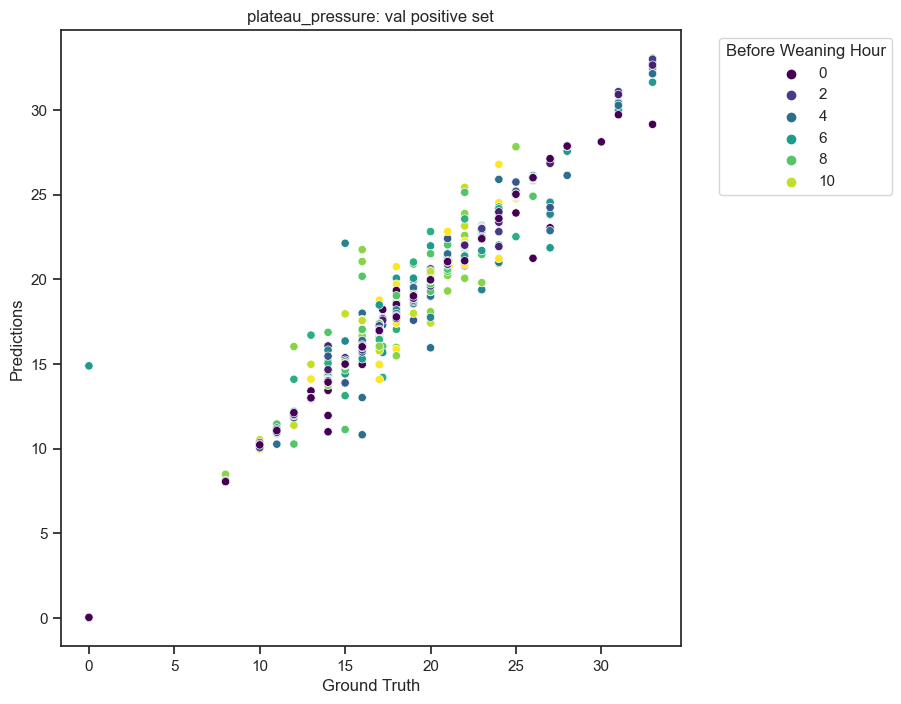

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.96      0.97      3941
           1       0.15      0.32      0.20        91

    accuracy                           0.94      4032
   macro avg       0.56      0.64      0.59      4032
weighted avg       0.96      0.94      0.95      4032


test positive set Mean Squared Error (MSE): 0.6184
test positive set Mean Absolute Error (MAE): 0.2531
test positive set R-squared (R2): 0.9707



C:\Users\張亞錫\AppData\Local\Temp\ipykernel_2408\4294134723.py:69: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  sns.scatterplot(x=y_ground_truth[:len(y_pred)], y=y_pred, hue=X['before_weaning_hr'][:len(y_pred)], palette='viridis')


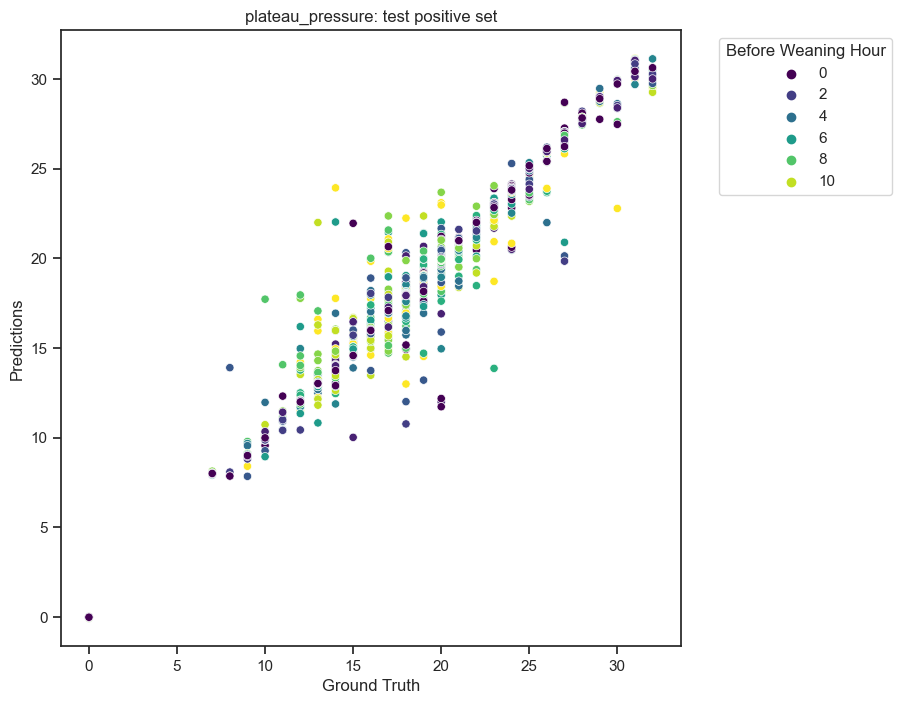

In [543]:
feature_columns = [
    'before_weaning_hr', 'age_now', 'weight_kg',
    'height_cm', 'tobacco', 'heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 'tidal_volume_observed', 'RSBI',
    'minute_ventilation', 'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h', 'mbp_prev_1h', 'spo2_prev_1h',
    'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h', 
    'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h',
]
threshold_hr = 12
for feature in ventilator_settings:
    print(f'===== feature: {feature} =====')
    model_A_inference_pro(whole_change_label_value_aug_df[whole_change_label_value_aug_df["before_weaning_hr"]<threshold_hr], model_A_dict, feature, feature_columns, 'whole positive set')
    model_A_inference_pro(negative_change_label_value_aug_df[negative_change_label_value_aug_df["before_weaning_hr"]<threshold_hr], model_A_dict, feature, feature_columns, 'whole negative set')
    model_A_inference_pro(train_change_label_value_aug_df[train_change_label_value_aug_df["before_weaning_hr"]<threshold_hr], model_A_dict, feature, feature_columns, 'train positive set')
    model_A_inference_pro(val_change_label_value_aug_df[val_change_label_value_aug_df["before_weaning_hr"]<threshold_hr], model_A_dict, feature, feature_columns, 'val positive set')
    model_A_inference_pro(test_change_label_value_aug_df[test_change_label_value_aug_df["before_weaning_hr"]<threshold_hr], model_A_dict, feature, feature_columns, 'test positive set')

pro 24hr

In [567]:
len(negative_change_label_value_aug_df)

22333

In [568]:
38961 / 22333

1.7445484260959119

===== feature: peep =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.94      0.96     36698
           1       0.36      0.60      0.45      2218

    accuracy                           0.92     38916
   macro avg       0.67      0.77      0.70     38916
weighted avg       0.94      0.92      0.93     38916


whole positive set Mean Squared Error (MSE): 1.3343
whole positive set Mean Absolute Error (MAE): 0.4250
whole positive set R-squared (R2): 0.7708



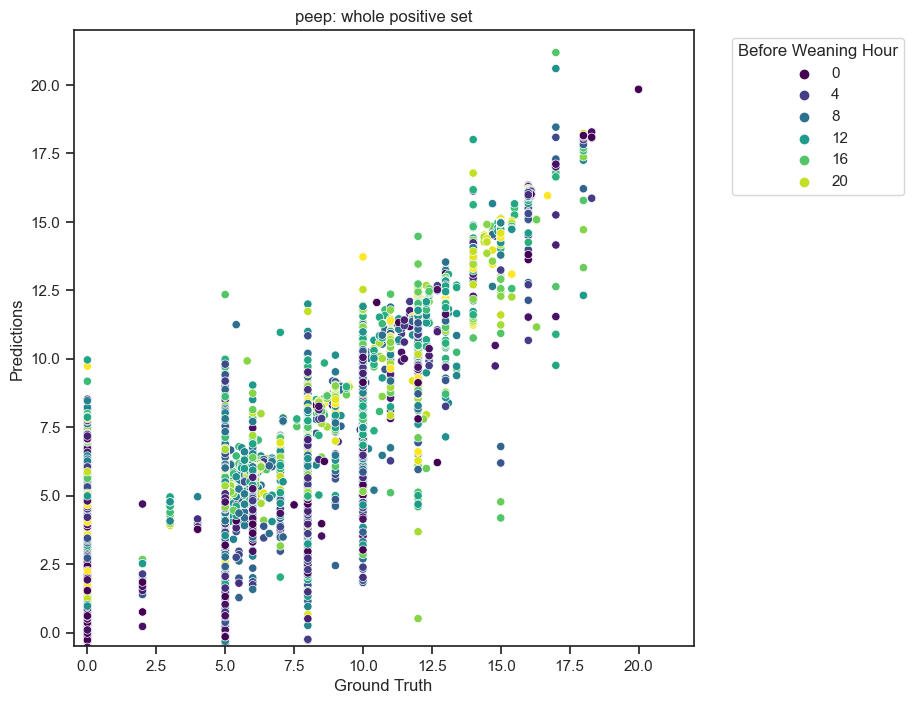

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.88      0.92     20895
           1       0.20      0.43      0.27      1438

    accuracy                           0.85     22333
   macro avg       0.58      0.65      0.59     22333
weighted avg       0.91      0.85      0.87     22333


whole negative set Mean Squared Error (MSE): 2.9216
whole negative set Mean Absolute Error (MAE): 0.8137
whole negative set R-squared (R2): 0.7540



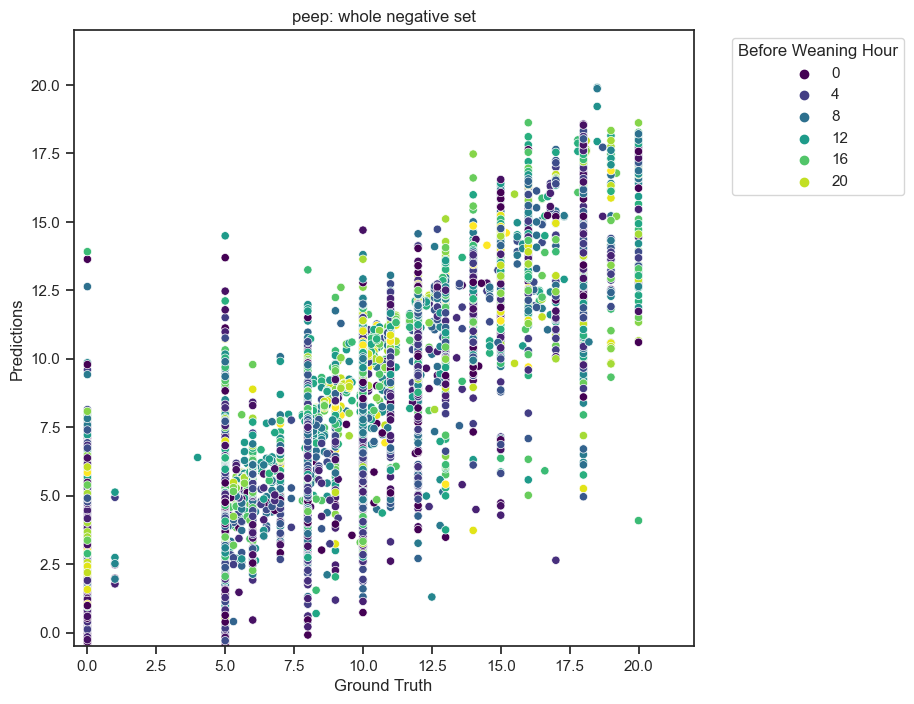

train positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96     25658
           1       0.42      0.70      0.52      1528

    accuracy                           0.93     27186
   macro avg       0.70      0.82      0.74     27186
weighted avg       0.95      0.93      0.94     27186


train positive set Mean Squared Error (MSE): 0.9975
train positive set Mean Absolute Error (MAE): 0.3399
train positive set R-squared (R2): 0.8315



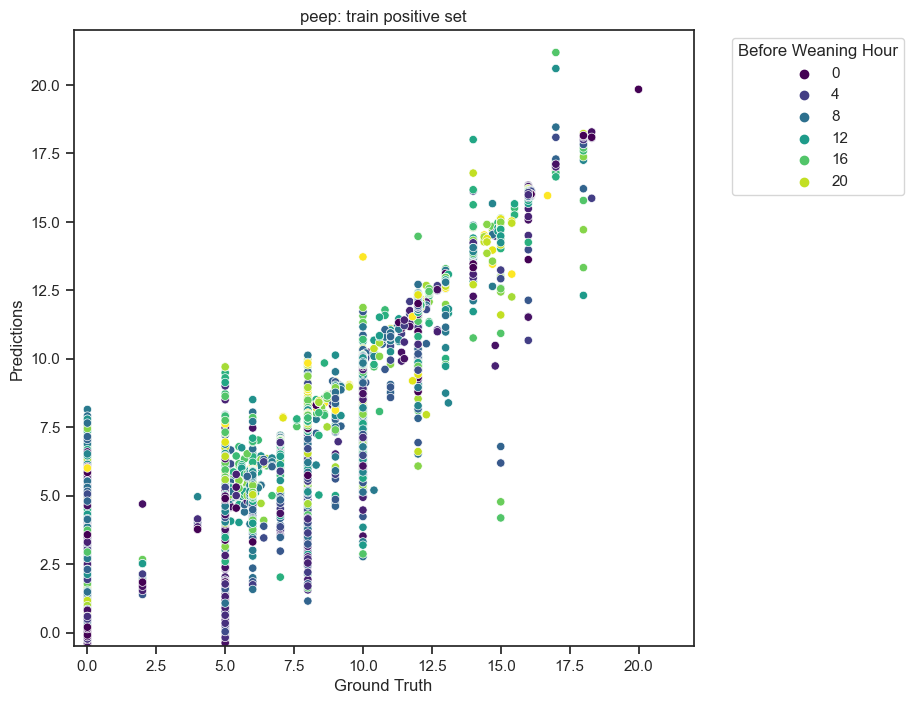

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.92      0.94      3769
           1       0.22      0.38      0.28       233

    accuracy                           0.89      4002
   macro avg       0.59      0.65      0.61      4002
weighted avg       0.92      0.89      0.90      4002


val positive set Mean Squared Error (MSE): 2.0913
val positive set Mean Absolute Error (MAE): 0.6287
val positive set R-squared (R2): 0.6390



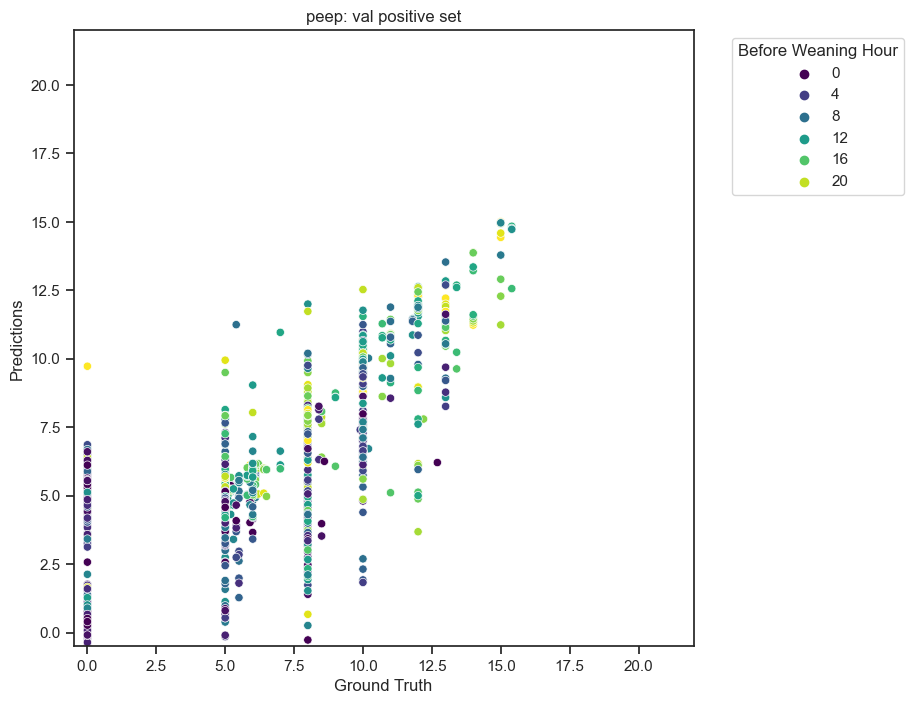

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.93      0.94      7271
           1       0.24      0.37      0.29       457

    accuracy                           0.89      7728
   macro avg       0.60      0.65      0.61      7728
weighted avg       0.92      0.89      0.90      7728


test positive set Mean Squared Error (MSE): 2.1271
test positive set Mean Absolute Error (MAE): 0.6191
test positive set R-squared (R2): 0.6121



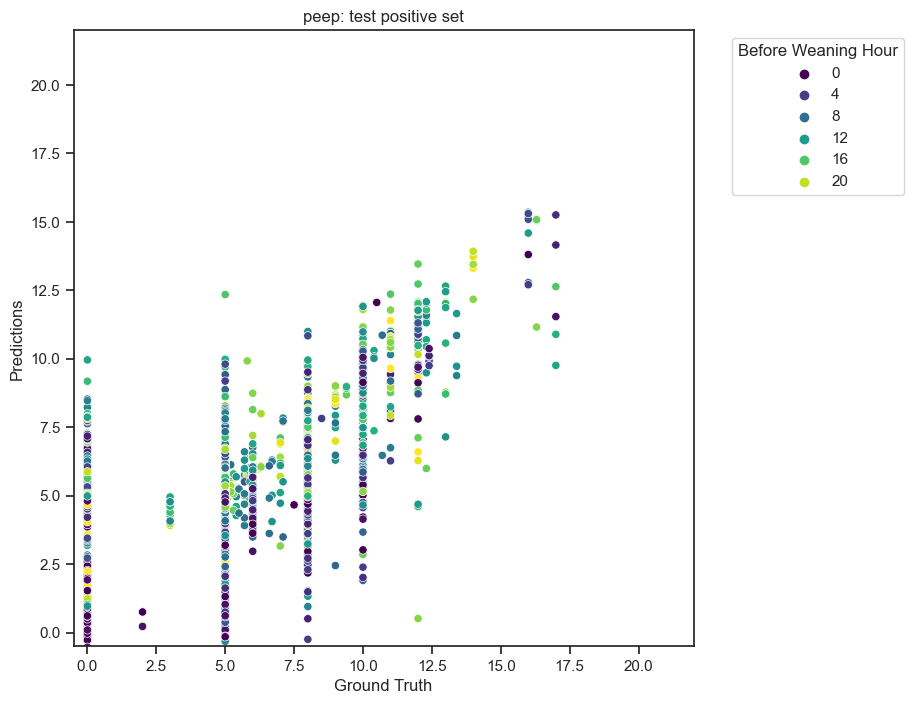

===== feature: fio2 =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.94      0.96     37432
           1       0.32      0.71      0.45      1484

    accuracy                           0.93     38916
   macro avg       0.66      0.83      0.70     38916
weighted avg       0.96      0.93      0.94     38916


whole positive set Mean Squared Error (MSE): 28.7224
whole positive set Mean Absolute Error (MAE): 1.4726
whole positive set R-squared (R2): 0.6644



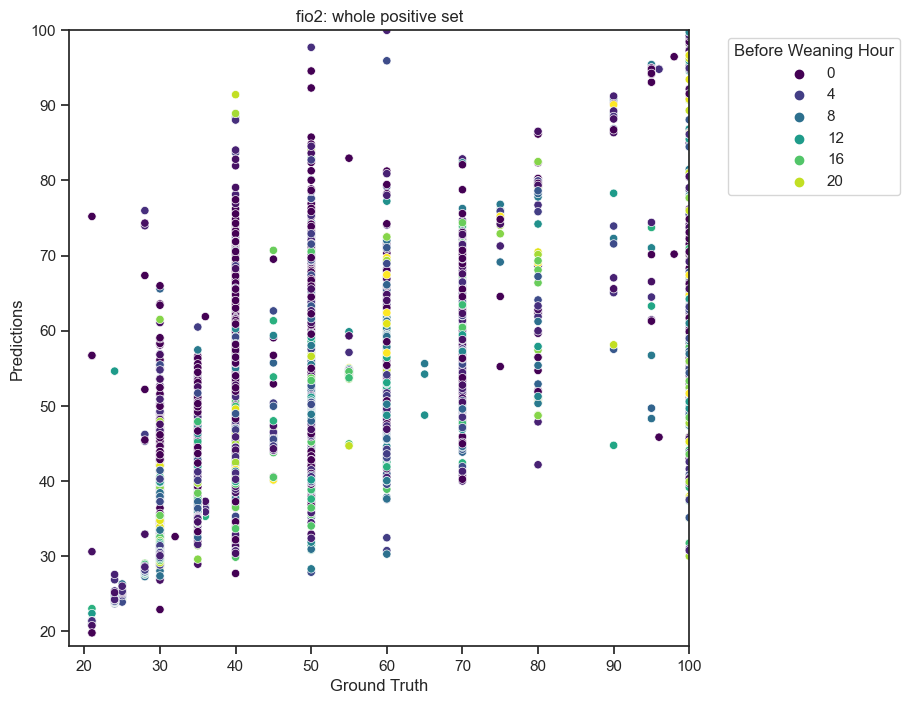

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.88      0.92     21335
           1       0.16      0.50      0.24       998

    accuracy                           0.86     22333
   macro avg       0.57      0.69      0.58     22333
weighted avg       0.94      0.86      0.89     22333


whole negative set Mean Squared Error (MSE): 118.6528
whole negative set Mean Absolute Error (MAE): 4.2212
whole negative set R-squared (R2): 0.4704



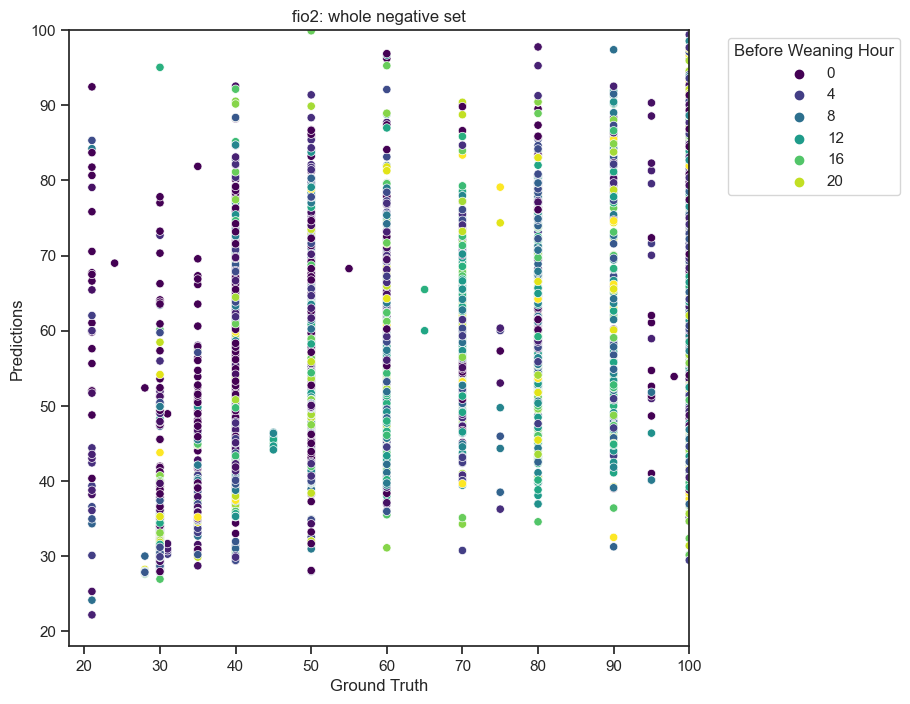

train positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.94      0.97     26146
           1       0.37      0.84      0.51      1040

    accuracy                           0.94     27186
   macro avg       0.68      0.89      0.74     27186
weighted avg       0.97      0.94      0.95     27186


train positive set Mean Squared Error (MSE): 21.8596
train positive set Mean Absolute Error (MAE): 1.1887
train positive set R-squared (R2): 0.7378



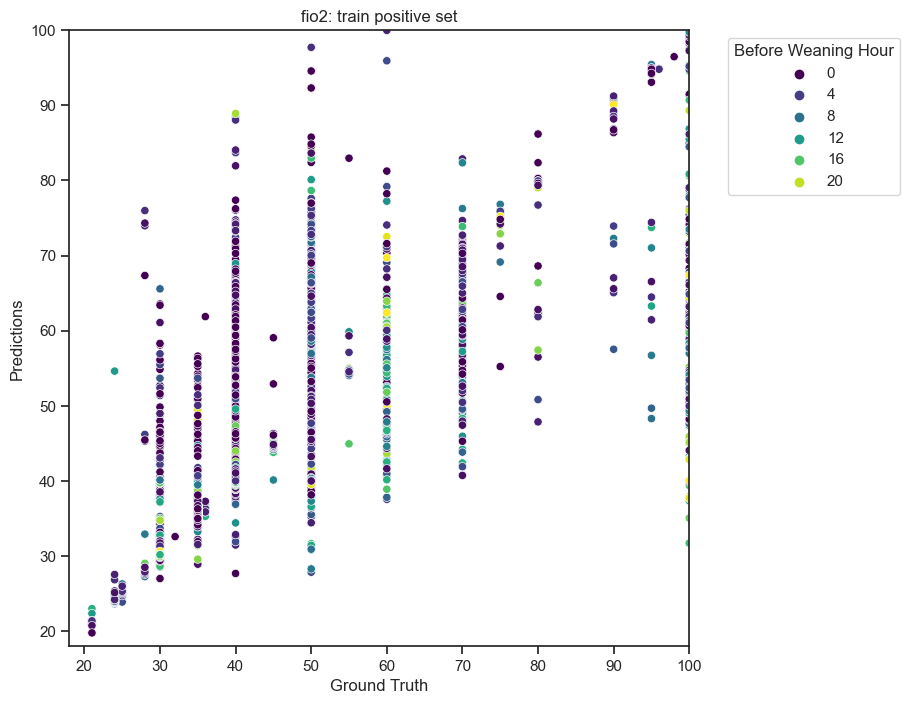

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96      3855
           1       0.21      0.44      0.28       147

    accuracy                           0.92      4002
   macro avg       0.59      0.69      0.62      4002
weighted avg       0.95      0.92      0.93      4002


val positive set Mean Squared Error (MSE): 41.2397
val positive set Mean Absolute Error (MAE): 2.1351
val positive set R-squared (R2): 0.5075



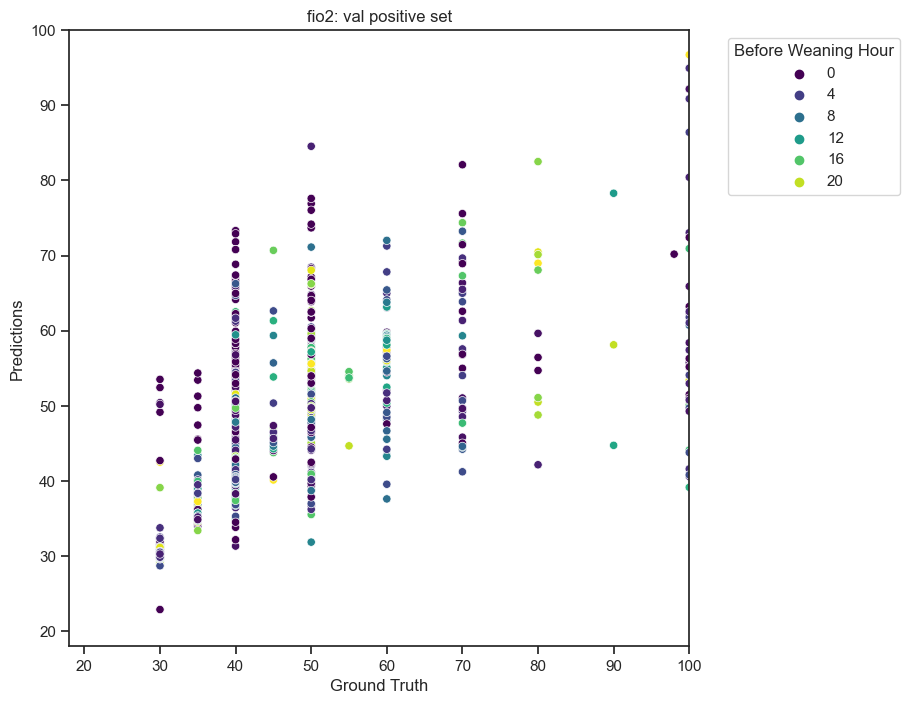

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96      7431
           1       0.20      0.41      0.27       297

    accuracy                           0.92      7728
   macro avg       0.59      0.67      0.61      7728
weighted avg       0.95      0.92      0.93      7728


test positive set Mean Squared Error (MSE): 46.3823
test positive set Mean Absolute Error (MAE): 2.1283
test positive set R-squared (R2): 0.5068



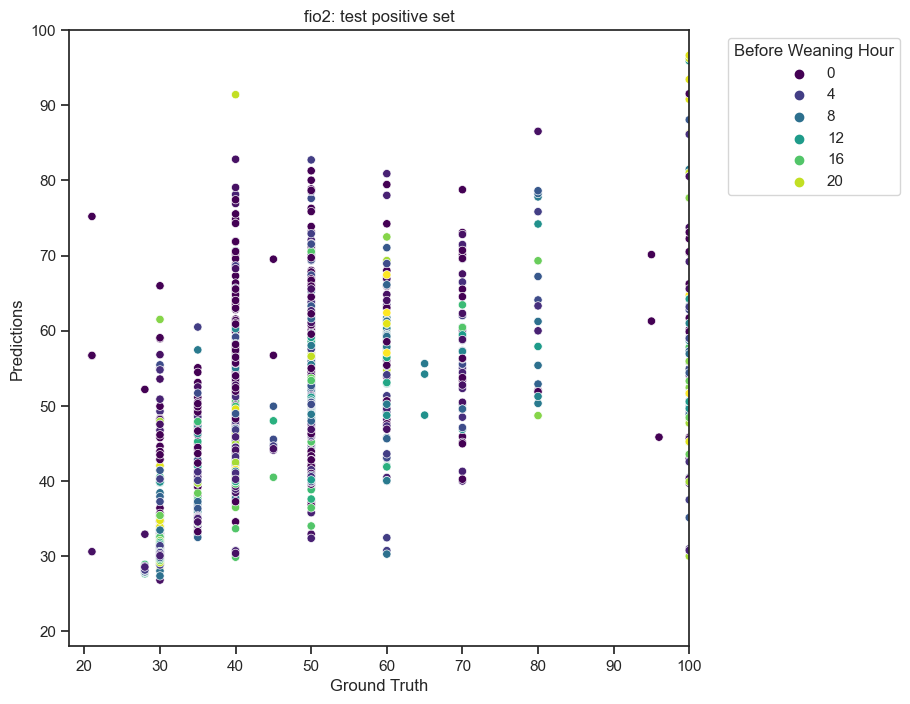

===== feature: respiratory_rate_set =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.93      0.96     38514
           1       0.10      0.77      0.18       402

    accuracy                           0.93     38916
   macro avg       0.55      0.85      0.57     38916
weighted avg       0.99      0.93      0.96     38916


whole positive set Mean Squared Error (MSE): 3.7276
whole positive set Mean Absolute Error (MAE): 0.4816
whole positive set R-squared (R2): 0.8991



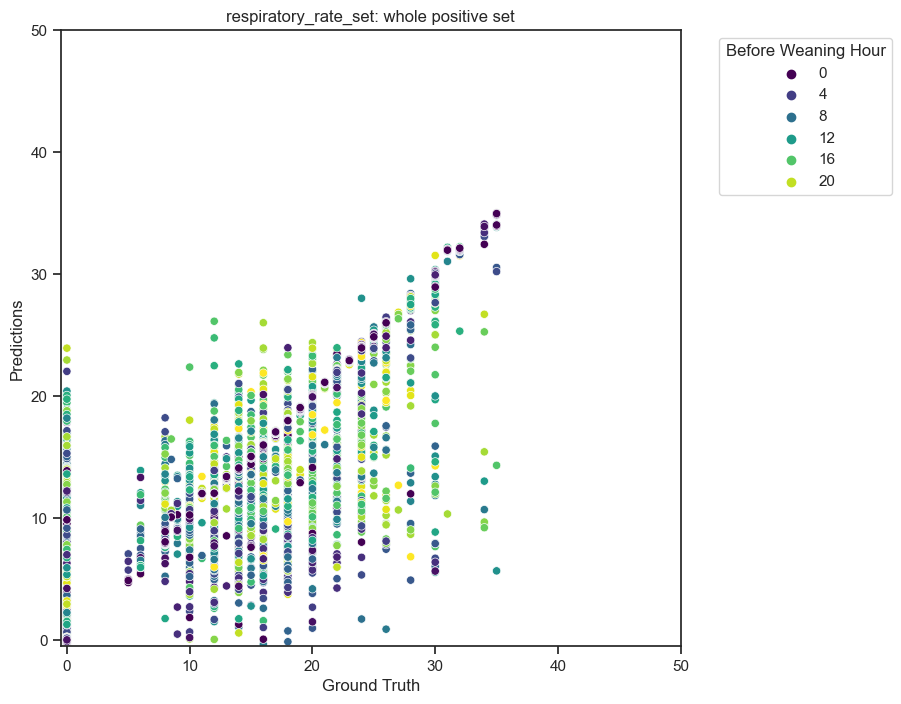

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.93      0.96     22005
           1       0.03      0.16      0.06       328

    accuracy                           0.92     22333
   macro avg       0.51      0.54      0.51     22333
weighted avg       0.97      0.92      0.95     22333


whole negative set Mean Squared Error (MSE): 5.2279
whole negative set Mean Absolute Error (MAE): 0.7138
whole negative set R-squared (R2): 0.8763



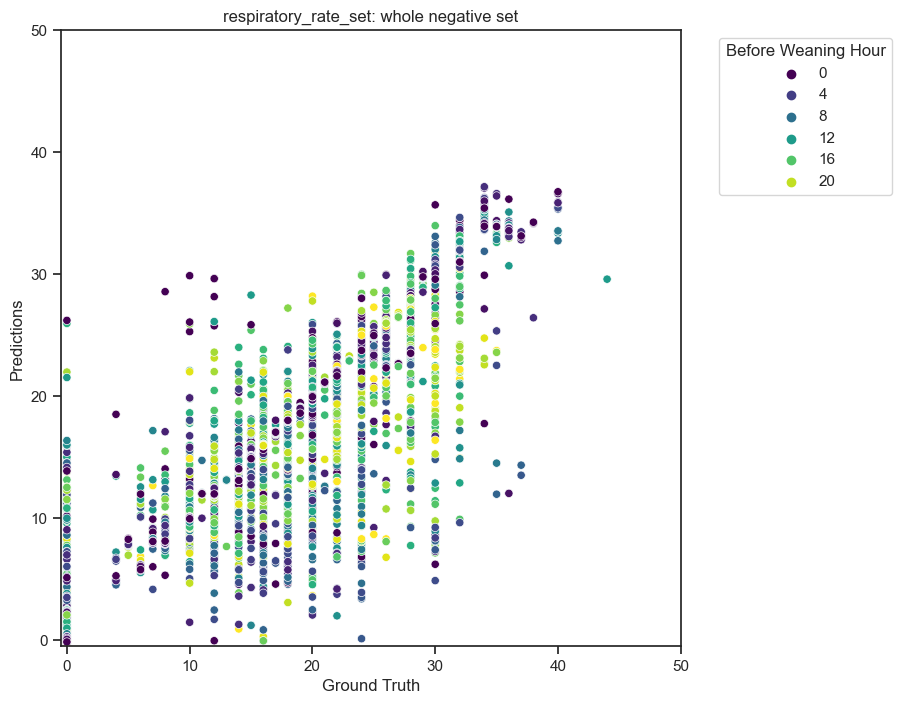

train positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.93      0.97     26903
           1       0.14      1.00      0.24       283

    accuracy                           0.93     27186
   macro avg       0.57      0.97      0.60     27186
weighted avg       0.99      0.93      0.96     27186


train positive set Mean Squared Error (MSE): 3.2345
train positive set Mean Absolute Error (MAE): 0.4068
train positive set R-squared (R2): 0.9099



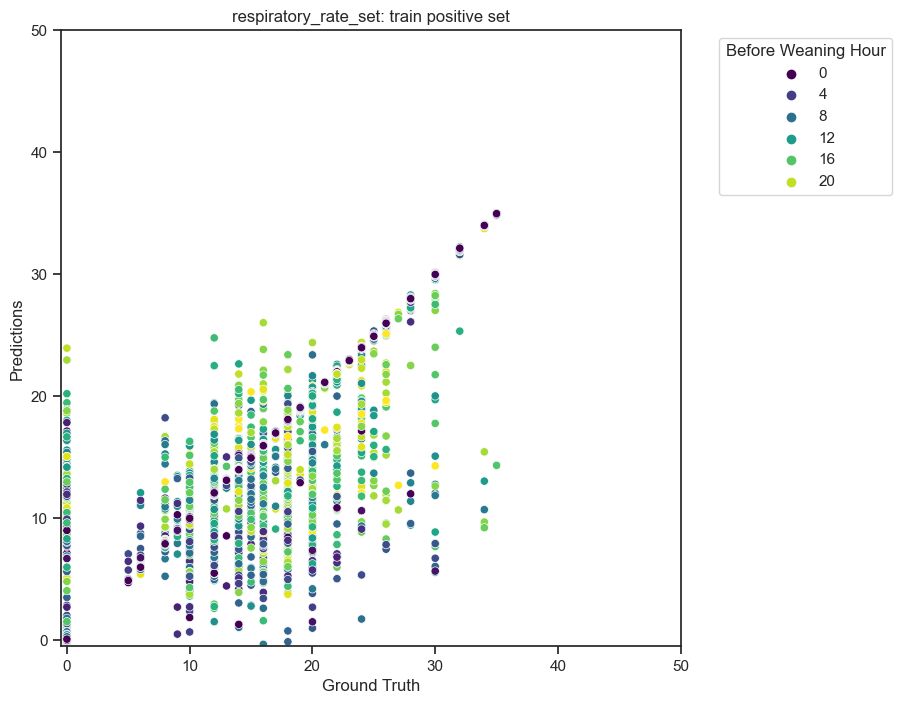

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.92      0.96      3958
           1       0.03      0.23      0.06        44

    accuracy                           0.92      4002
   macro avg       0.51      0.58      0.51      4002
weighted avg       0.98      0.92      0.95      4002


val positive set Mean Squared Error (MSE): 5.4857
val positive set Mean Absolute Error (MAE): 0.6846
val positive set R-squared (R2): 0.8633



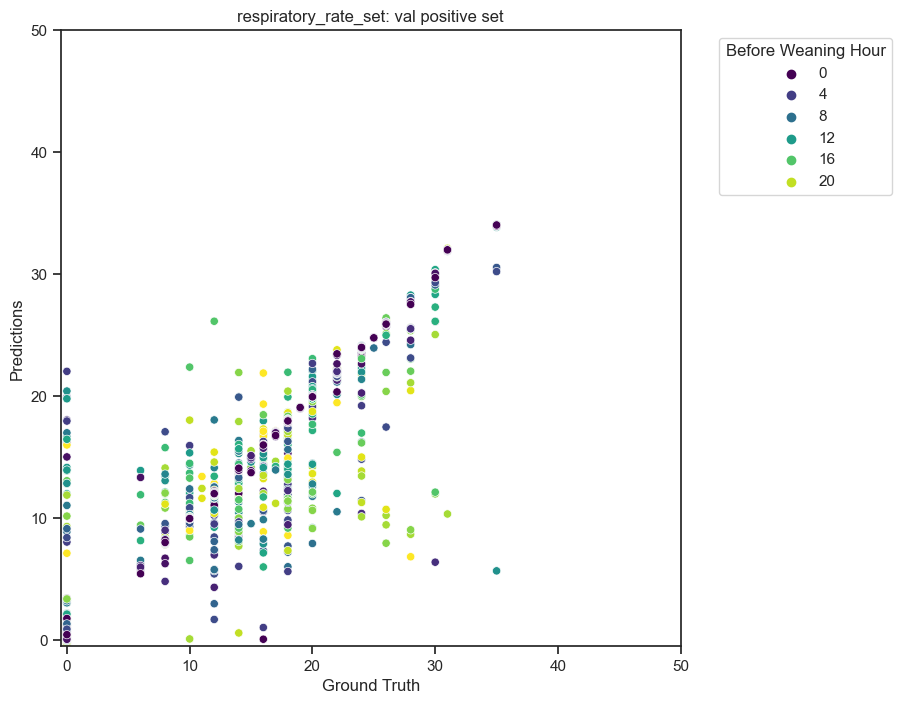

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.93      0.96      7653
           1       0.03      0.21      0.05        75

    accuracy                           0.92      7728
   macro avg       0.51      0.57      0.50      7728
weighted avg       0.98      0.92      0.95      7728


test positive set Mean Squared Error (MSE): 4.5517
test positive set Mean Absolute Error (MAE): 0.6396
test positive set R-squared (R2): 0.8834



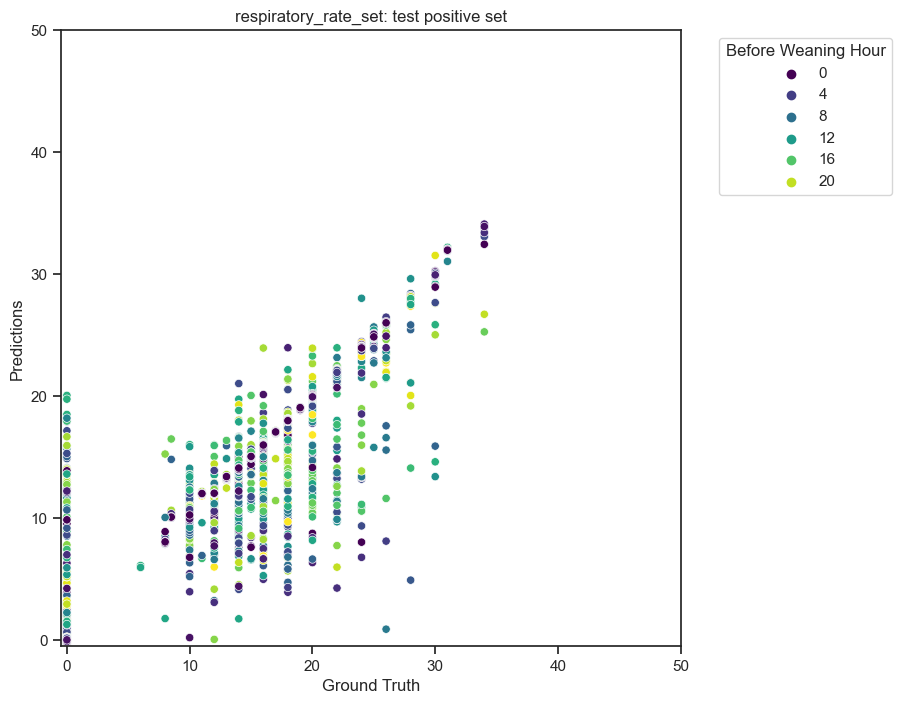

===== feature: plateau_pressure =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.93      0.96     37875
           1       0.23      0.75      0.36      1041

    accuracy                           0.93     38916
   macro avg       0.61      0.84      0.66     38916
weighted avg       0.97      0.93      0.95     38916


whole positive set Mean Squared Error (MSE): 0.4233
whole positive set Mean Absolute Error (MAE): 0.1858
whole positive set R-squared (R2): 0.9787



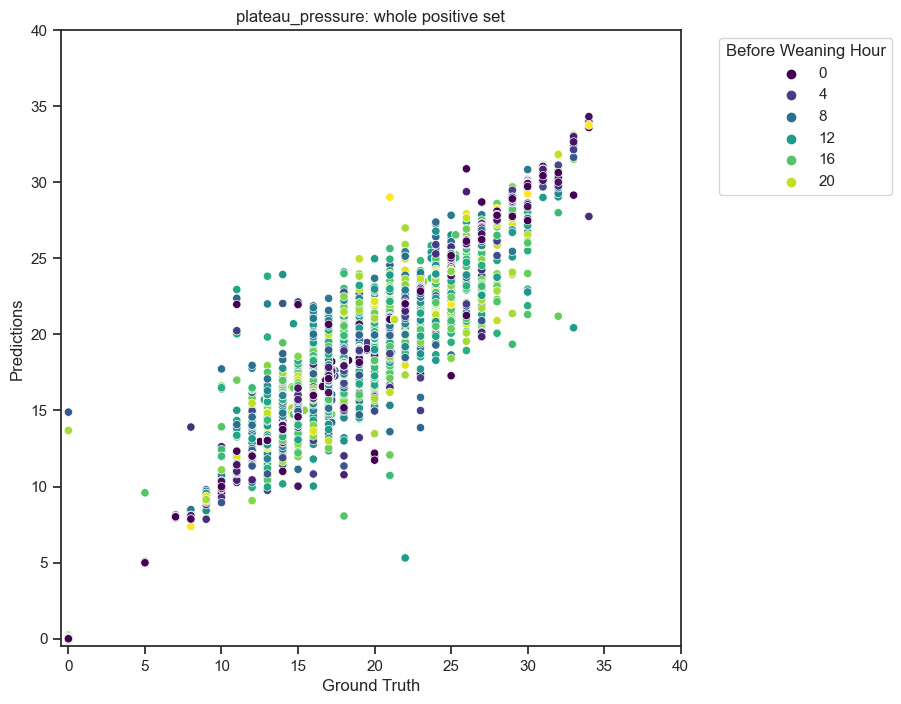

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.89      0.92     21178
           1       0.16      0.38      0.22      1155

    accuracy                           0.86     22333
   macro avg       0.56      0.64      0.57     22333
weighted avg       0.92      0.86      0.89     22333


whole negative set Mean Squared Error (MSE): 3.7245
whole negative set Mean Absolute Error (MAE): 0.6718
whole negative set R-squared (R2): 0.8787



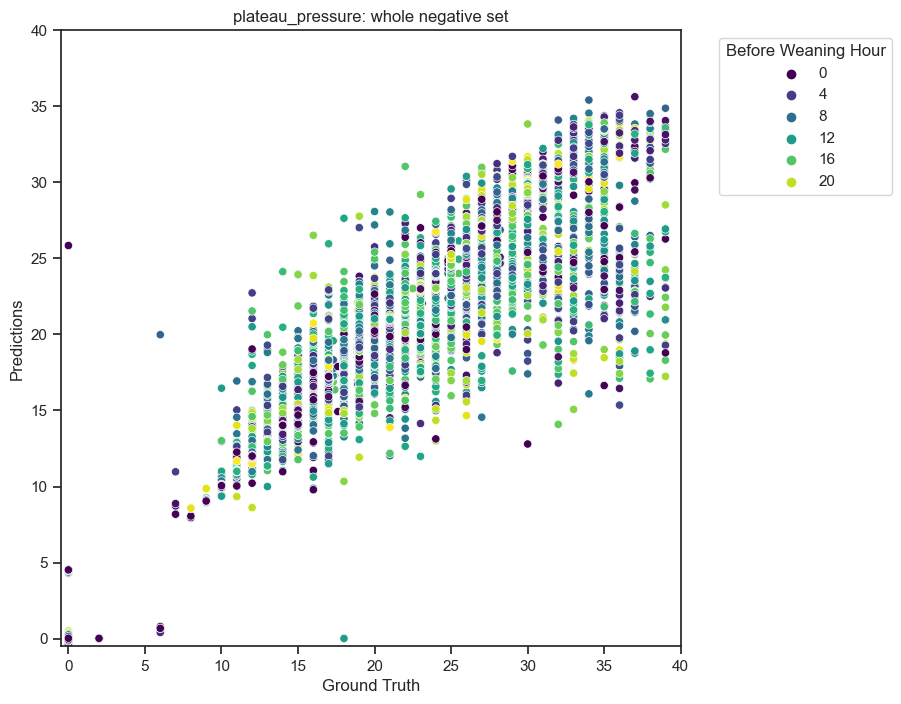

train positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.93      0.96     26471
           1       0.27      0.94      0.42       715

    accuracy                           0.93     27186
   macro avg       0.63      0.94      0.69     27186
weighted avg       0.98      0.93      0.95     27186


train positive set Mean Squared Error (MSE): 0.2849
train positive set Mean Absolute Error (MAE): 0.1421
train positive set R-squared (R2): 0.9857



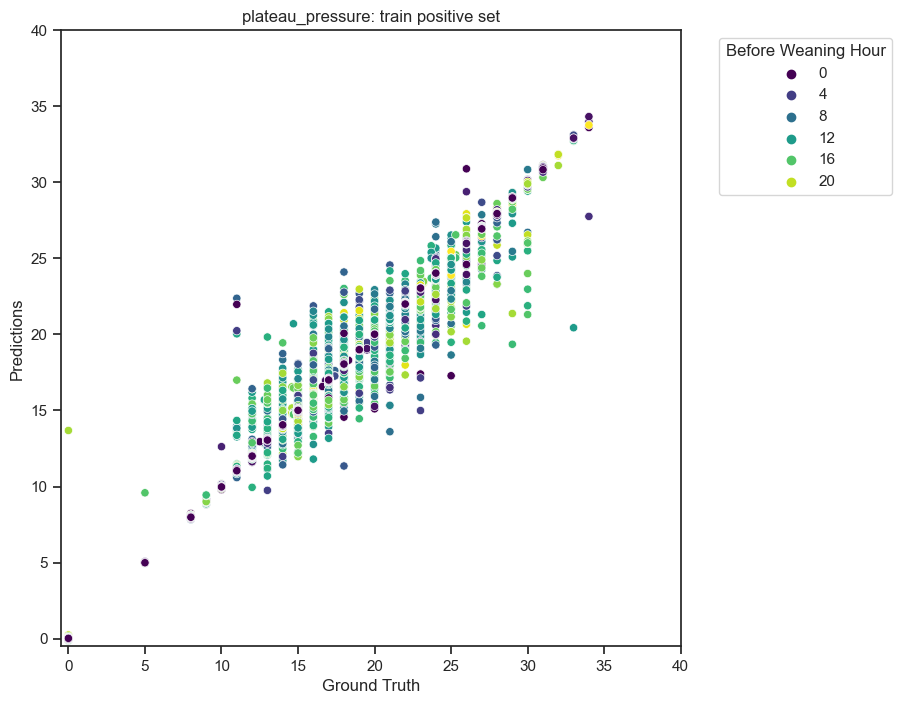

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96      3876
           1       0.15      0.33      0.21       126

    accuracy                           0.92      4002
   macro avg       0.56      0.63      0.58      4002
weighted avg       0.95      0.92      0.93      4002


val positive set Mean Squared Error (MSE): 0.7073
val positive set Mean Absolute Error (MAE): 0.2760
val positive set R-squared (R2): 0.9581



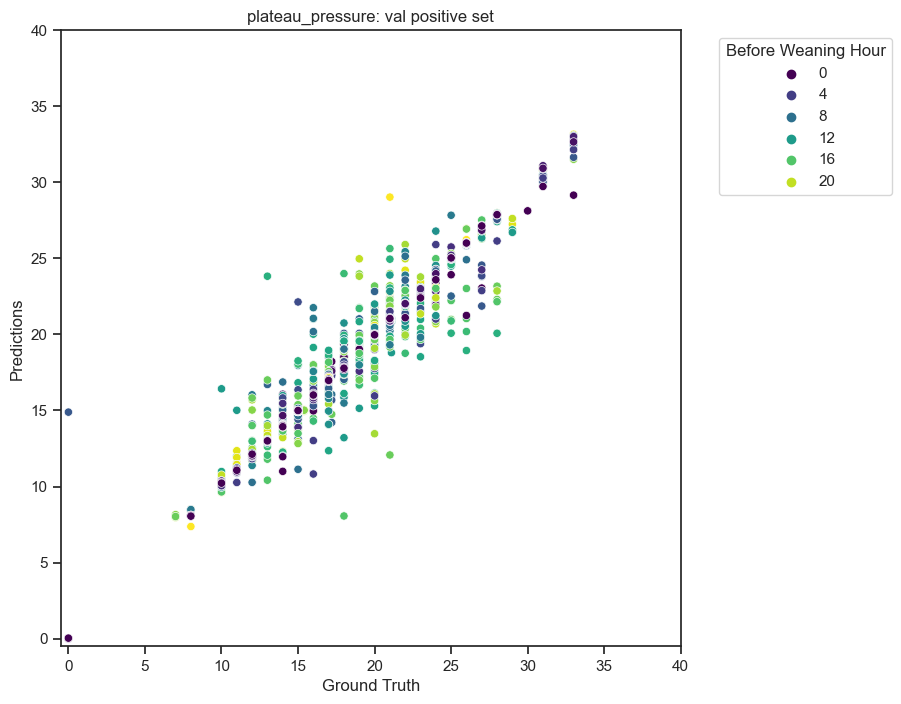

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.93      0.96      7528
           1       0.12      0.34      0.17       200

    accuracy                           0.92      7728
   macro avg       0.55      0.64      0.56      7728
weighted avg       0.96      0.92      0.94      7728


test positive set Mean Squared Error (MSE): 0.7633
test positive set Mean Absolute Error (MAE): 0.2928
test positive set R-squared (R2): 0.9638



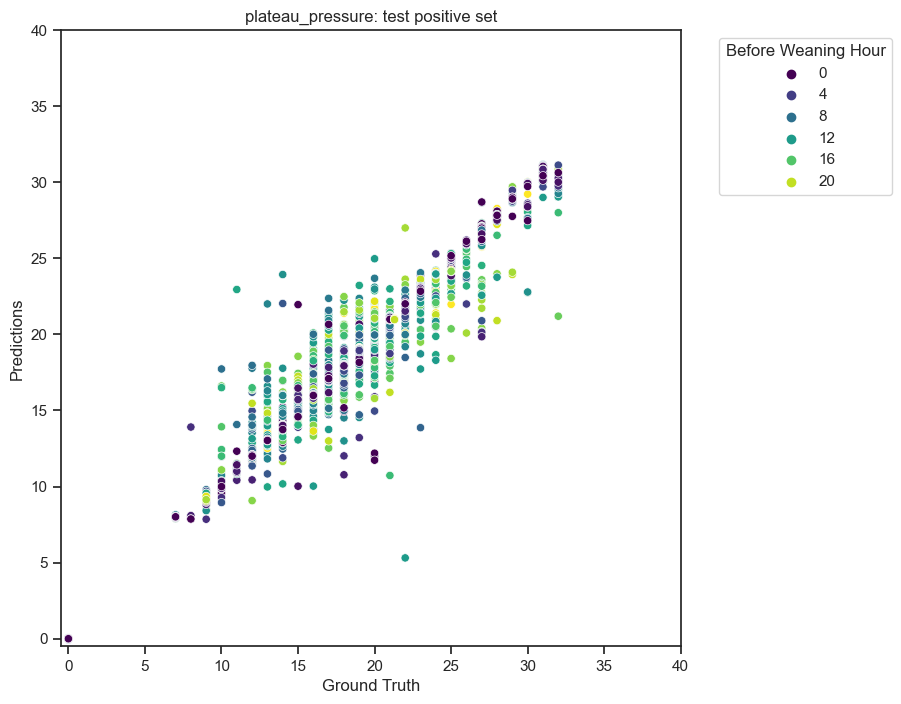

In [560]:
feature_columns = [
    'before_weaning_hr', 'age_now', 'weight_kg',
    'height_cm', 'tobacco', 'heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 'tidal_volume_observed', 'RSBI',
    'minute_ventilation', 'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h', 'mbp_prev_1h', 'spo2_prev_1h',
    'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h', 
    'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h',
]
for feature in ventilator_settings:
    print(f'===== feature: {feature} =====')
    model_A_inference_pro(whole_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'whole positive set')
    model_A_inference_pro(negative_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'whole negative set')
    model_A_inference_pro(train_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'train positive set')
    model_A_inference_pro(val_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'val positive set')
    model_A_inference_pro(test_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'test positive set')

directly use the same version

===== feature: peep =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.94      0.96     36698
           1       0.36      0.60      0.45      2218

    accuracy                           0.92     38916
   macro avg       0.67      0.77      0.70     38916
weighted avg       0.94      0.92      0.93     38916


whole positive set Mean Squared Error (MSE): 1.3819
whole positive set Mean Absolute Error (MAE): 0.3089
whole positive set R-squared (R2): 0.7626



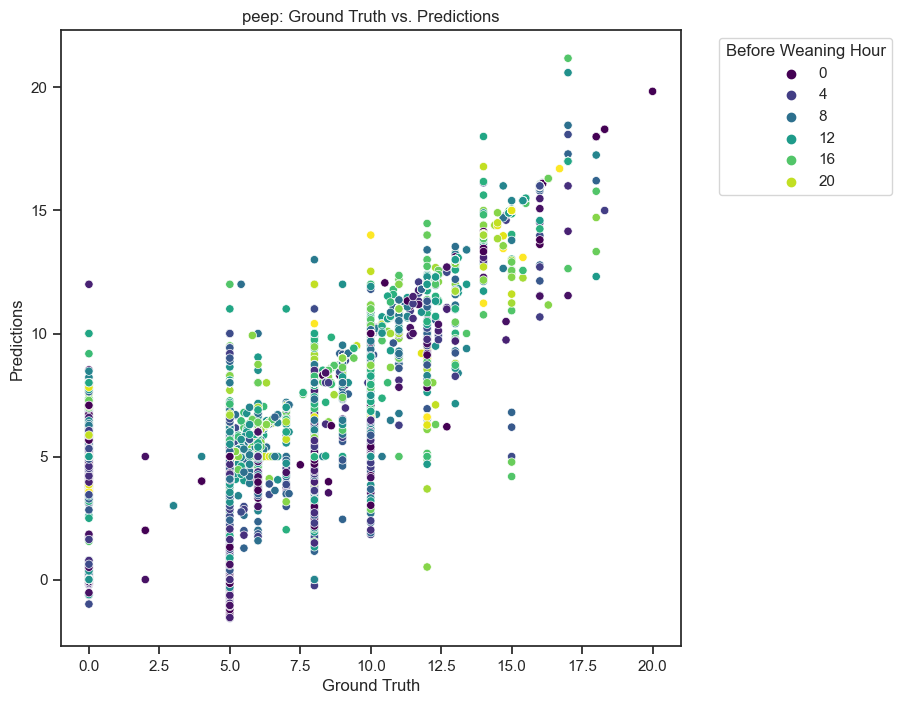

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.88      0.92     20895
           1       0.20      0.43      0.27      1438

    accuracy                           0.85     22333
   macro avg       0.58      0.65      0.59     22333
weighted avg       0.91      0.85      0.87     22333


whole negative set Mean Squared Error (MSE): 2.4173
whole negative set Mean Absolute Error (MAE): 0.5394
whole negative set R-squared (R2): 0.7965



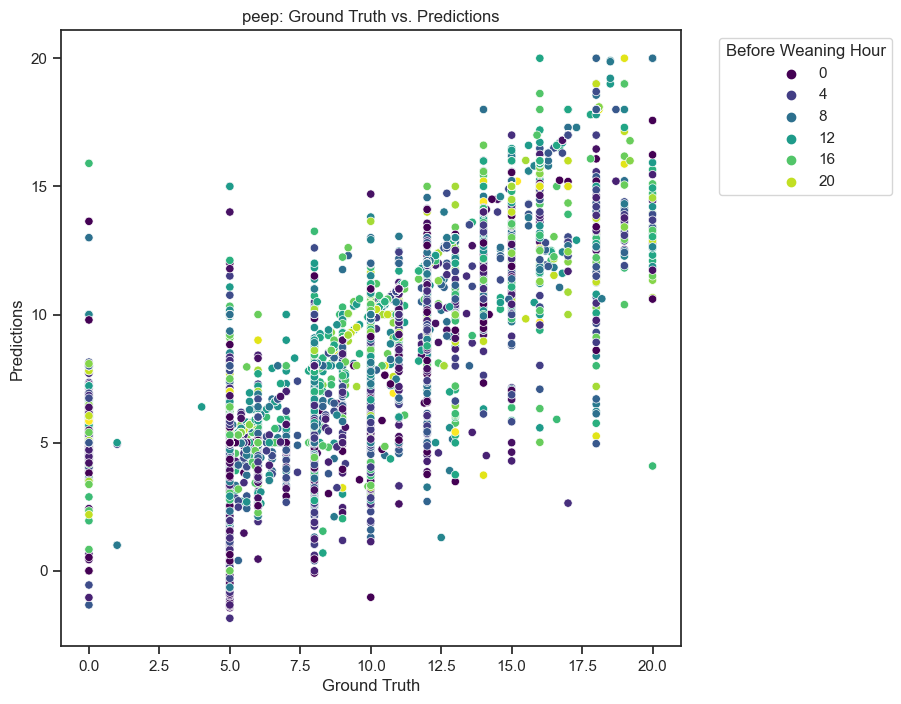

train positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96     25658
           1       0.42      0.70      0.52      1528

    accuracy                           0.93     27186
   macro avg       0.70      0.82      0.74     27186
weighted avg       0.95      0.93      0.94     27186


train positive set Mean Squared Error (MSE): 1.1088
train positive set Mean Absolute Error (MAE): 0.2522
train positive set R-squared (R2): 0.8127



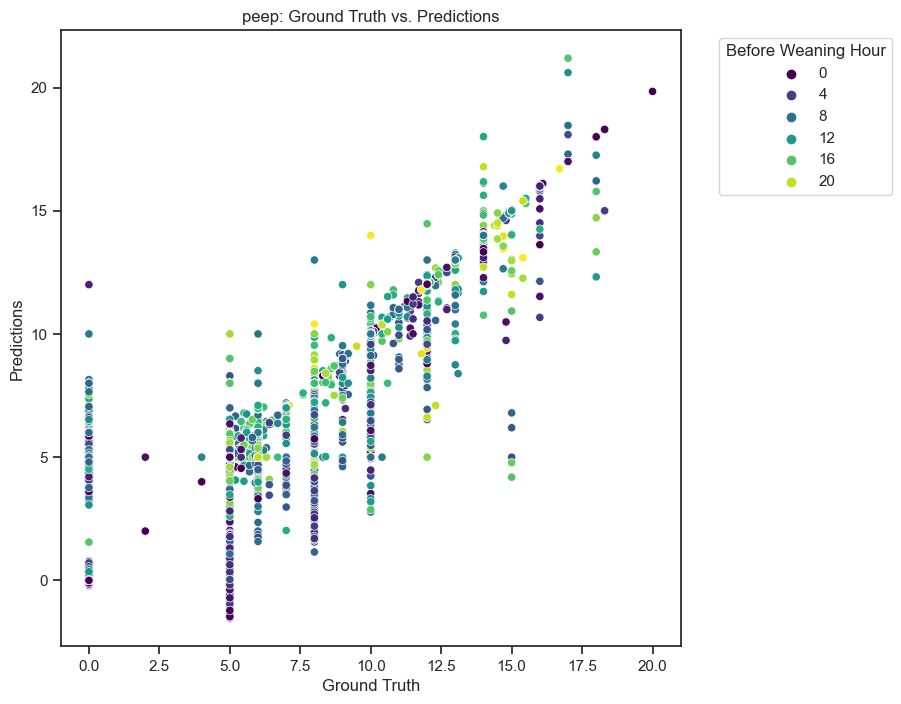

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.92      0.94      3769
           1       0.22      0.38      0.28       233

    accuracy                           0.89      4002
   macro avg       0.59      0.65      0.61      4002
weighted avg       0.92      0.89      0.90      4002


val positive set Mean Squared Error (MSE): 1.9956
val positive set Mean Absolute Error (MAE): 0.4448
val positive set R-squared (R2): 0.6555



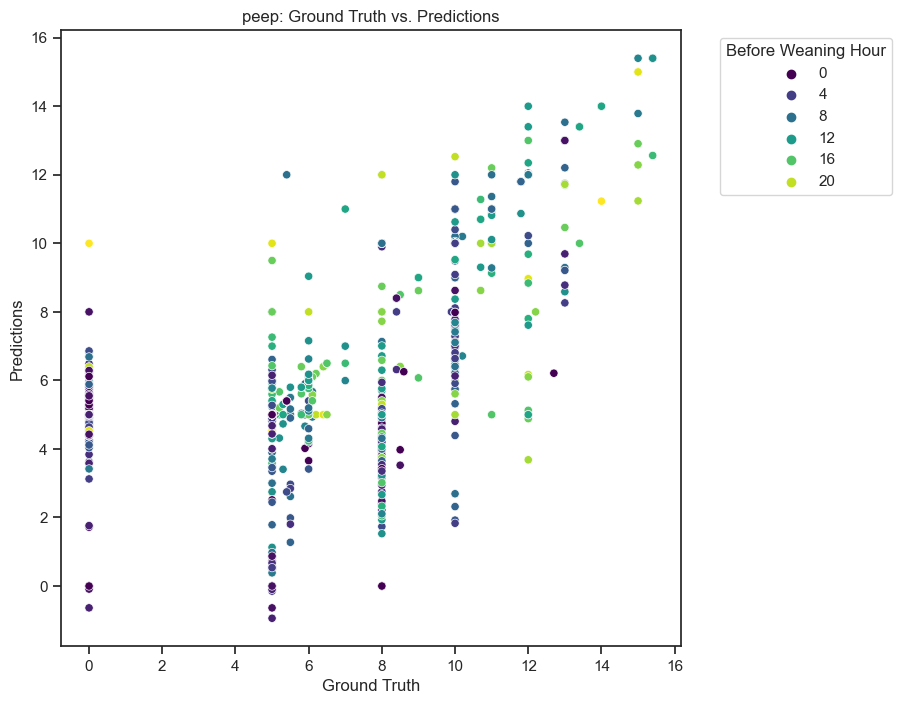

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.93      0.94      7271
           1       0.24      0.37      0.29       457

    accuracy                           0.89      7728
   macro avg       0.60      0.65      0.61      7728
weighted avg       0.92      0.89      0.90      7728


test positive set Mean Squared Error (MSE): 2.0249
test positive set Mean Absolute Error (MAE): 0.4376
test positive set R-squared (R2): 0.6307



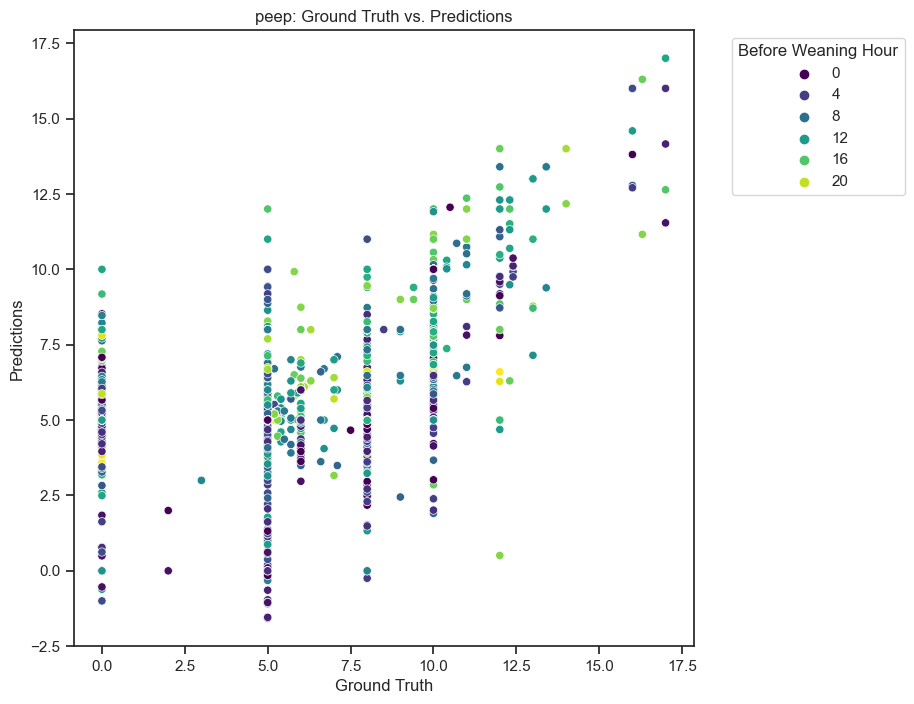

===== feature: fio2 =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.94      0.96     37432
           1       0.32      0.71      0.45      1484

    accuracy                           0.93     38916
   macro avg       0.66      0.83      0.70     38916
weighted avg       0.96      0.93      0.94     38916


whole positive set Mean Squared Error (MSE): 29.3129
whole positive set Mean Absolute Error (MAE): 1.1264
whole positive set R-squared (R2): 0.6575



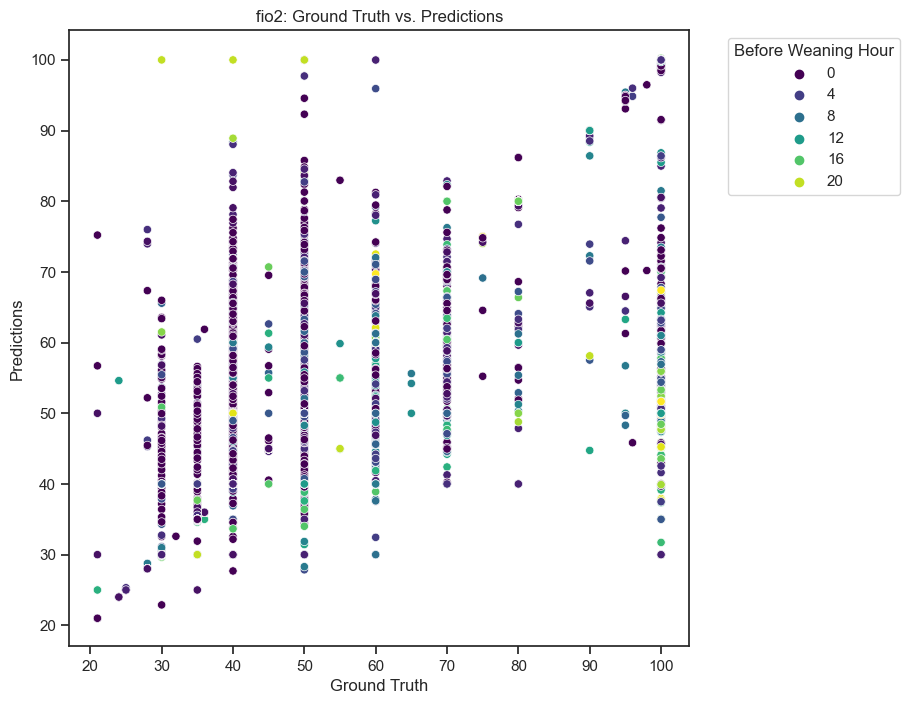

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.88      0.92     21335
           1       0.16      0.50      0.24       998

    accuracy                           0.86     22333
   macro avg       0.57      0.69      0.58     22333
weighted avg       0.94      0.86      0.89     22333


whole negative set Mean Squared Error (MSE): 110.4293
whole negative set Mean Absolute Error (MAE): 3.3447
whole negative set R-squared (R2): 0.5071



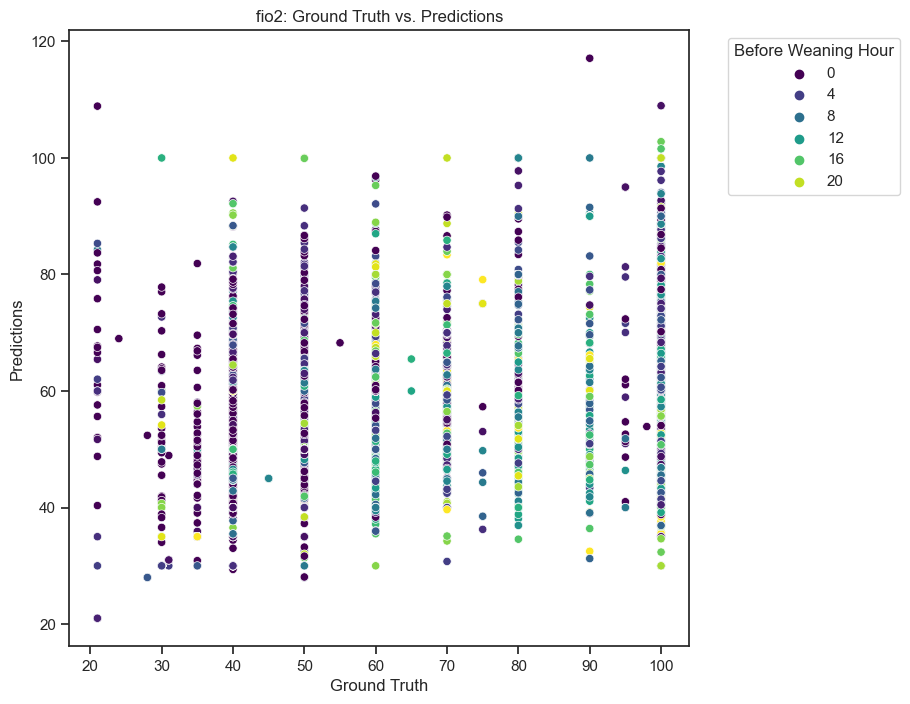

train positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.94      0.97     26146
           1       0.37      0.84      0.51      1040

    accuracy                           0.94     27186
   macro avg       0.68      0.89      0.74     27186
weighted avg       0.97      0.94      0.95     27186


train positive set Mean Squared Error (MSE): 23.4587
train positive set Mean Absolute Error (MAE): 0.9360
train positive set R-squared (R2): 0.7187



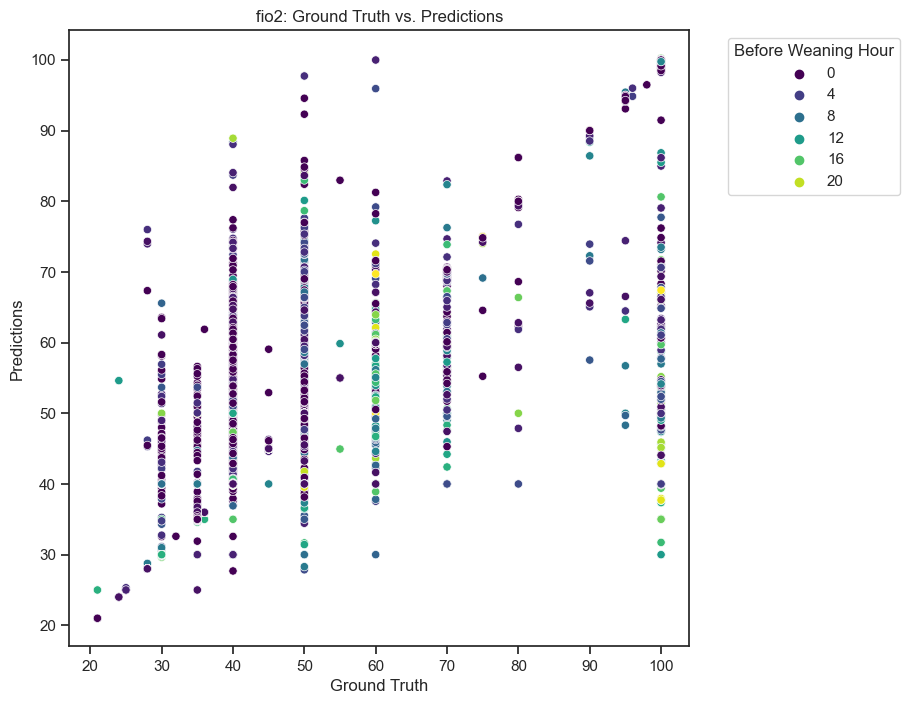

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96      3855
           1       0.21      0.44      0.28       147

    accuracy                           0.92      4002
   macro avg       0.59      0.69      0.62      4002
weighted avg       0.95      0.92      0.93      4002


val positive set Mean Squared Error (MSE): 39.5227
val positive set Mean Absolute Error (MAE): 1.5238
val positive set R-squared (R2): 0.5280



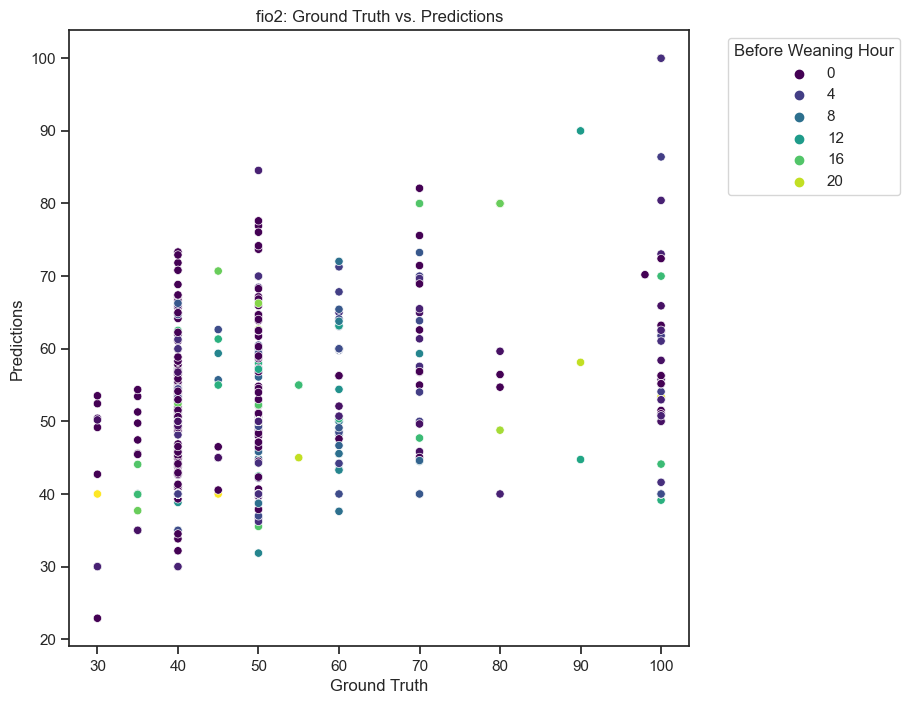

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96      7431
           1       0.20      0.41      0.27       297

    accuracy                           0.92      7728
   macro avg       0.59      0.67      0.61      7728
weighted avg       0.95      0.92      0.93      7728


test positive set Mean Squared Error (MSE): 44.6201
test positive set Mean Absolute Error (MAE): 1.5903
test positive set R-squared (R2): 0.5256



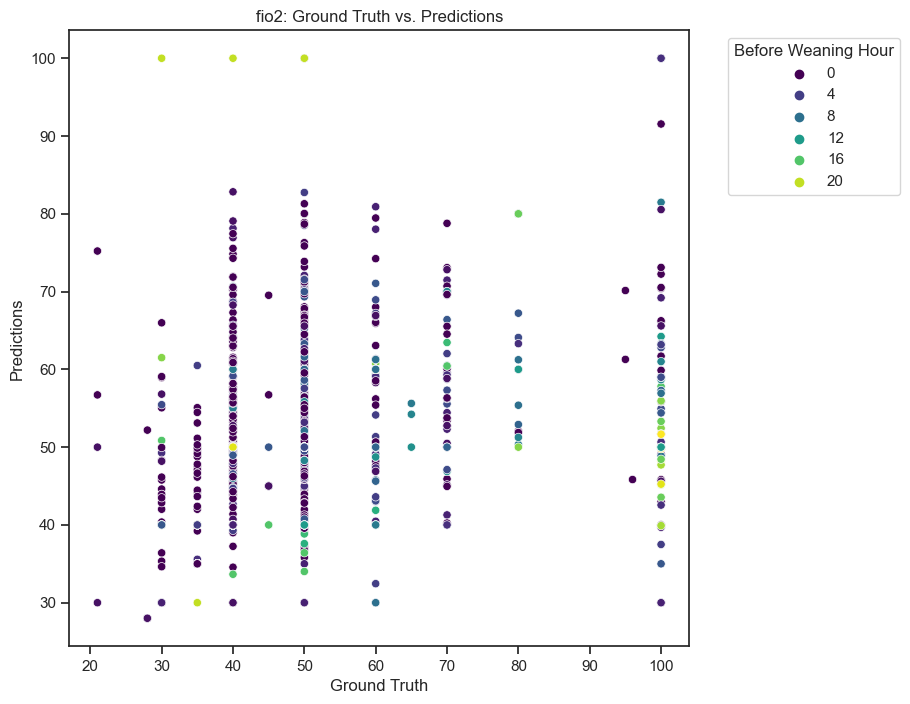

===== feature: respiratory_rate_set =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.93      0.96     38514
           1       0.10      0.77      0.18       402

    accuracy                           0.93     38916
   macro avg       0.55      0.85      0.57     38916
weighted avg       0.99      0.93      0.96     38916


whole positive set Mean Squared Error (MSE): 3.6163
whole positive set Mean Absolute Error (MAE): 0.3901
whole positive set R-squared (R2): 0.9021



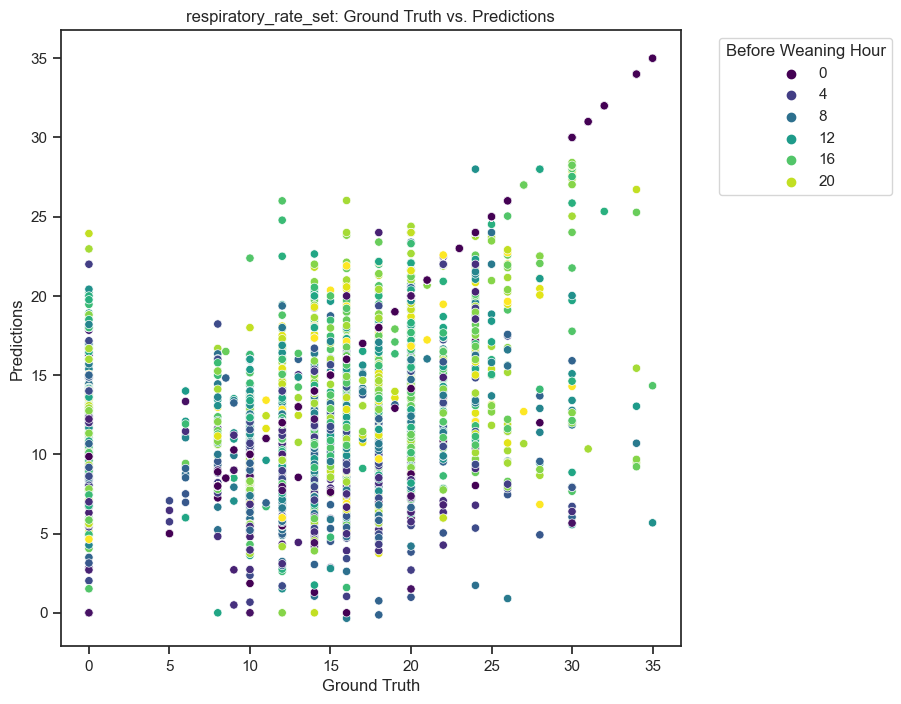

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.93      0.96     22005
           1       0.03      0.16      0.06       328

    accuracy                           0.92     22333
   macro avg       0.51      0.54      0.51     22333
weighted avg       0.97      0.92      0.95     22333


whole negative set Mean Squared Error (MSE): 4.7344
whole negative set Mean Absolute Error (MAE): 0.4752
whole negative set R-squared (R2): 0.8880



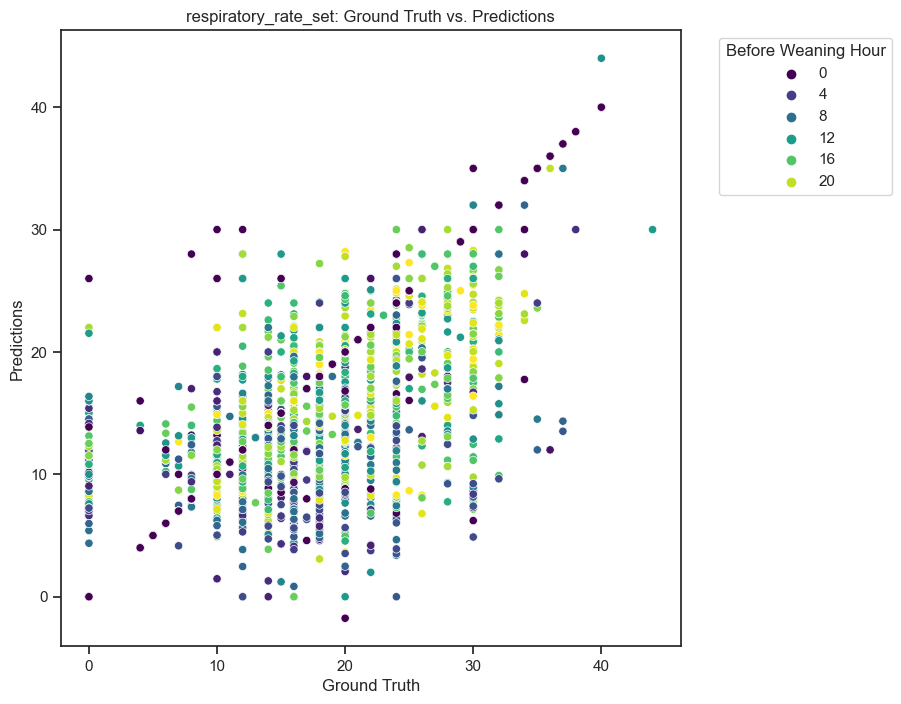

train positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.93      0.97     26903
           1       0.14      1.00      0.24       283

    accuracy                           0.93     27186
   macro avg       0.57      0.97      0.60     27186
weighted avg       0.99      0.93      0.96     27186


train positive set Mean Squared Error (MSE): 3.2240
train positive set Mean Absolute Error (MAE): 0.3517
train positive set R-squared (R2): 0.9101



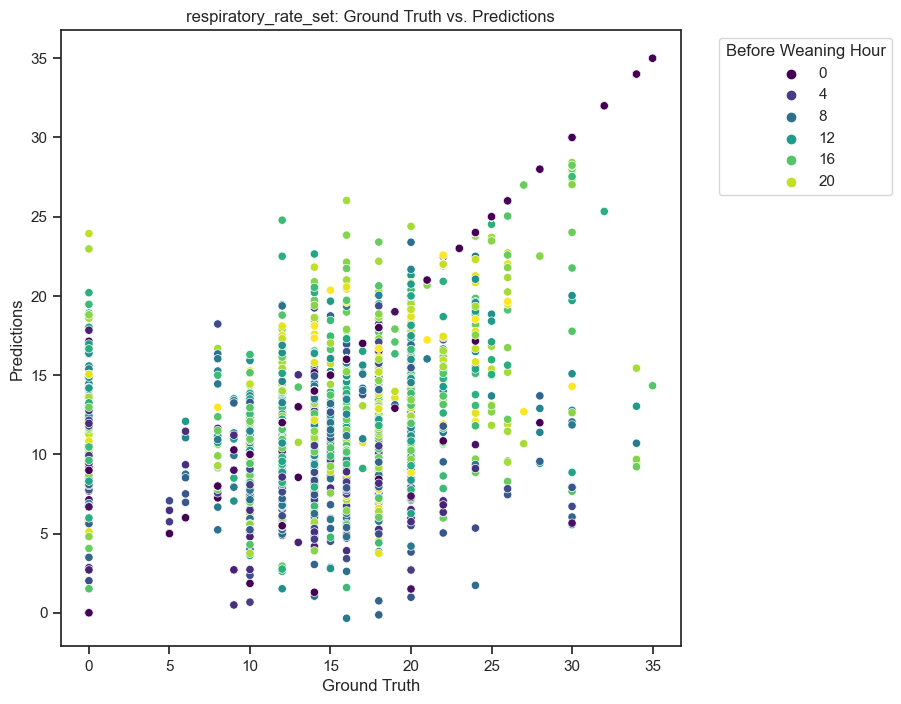

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.92      0.96      3958
           1       0.03      0.23      0.06        44

    accuracy                           0.92      4002
   macro avg       0.51      0.58      0.51      4002
weighted avg       0.98      0.92      0.95      4002


val positive set Mean Squared Error (MSE): 5.2530
val positive set Mean Absolute Error (MAE): 0.5219
val positive set R-squared (R2): 0.8691



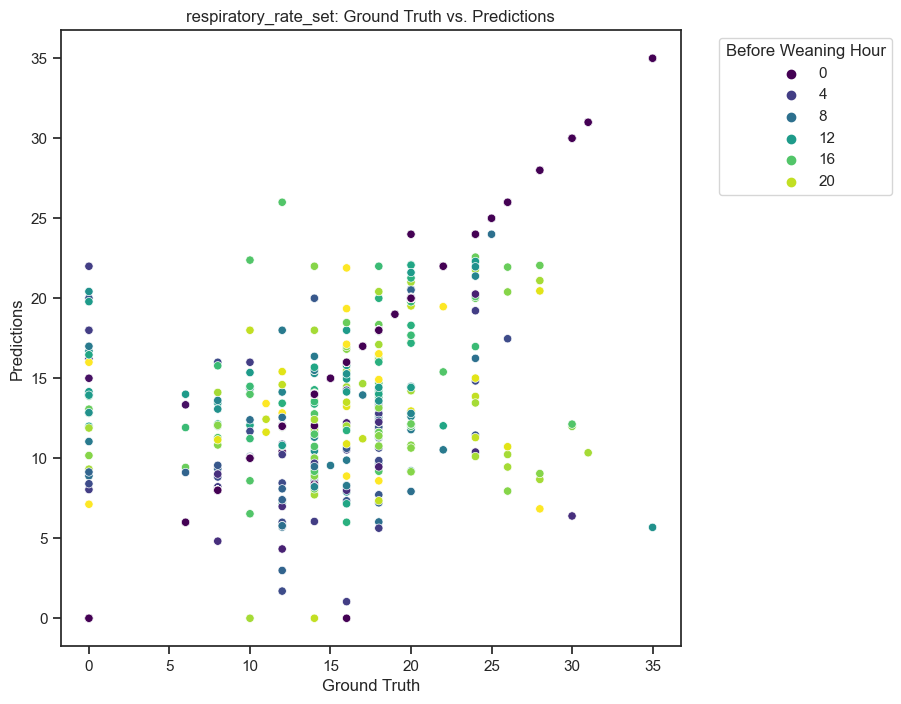

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.93      0.96      7653
           1       0.03      0.21      0.05        75

    accuracy                           0.92      7728
   macro avg       0.51      0.57      0.50      7728
weighted avg       0.98      0.92      0.95      7728


test positive set Mean Squared Error (MSE): 4.1488
test positive set Mean Absolute Error (MAE): 0.4566
test positive set R-squared (R2): 0.8937



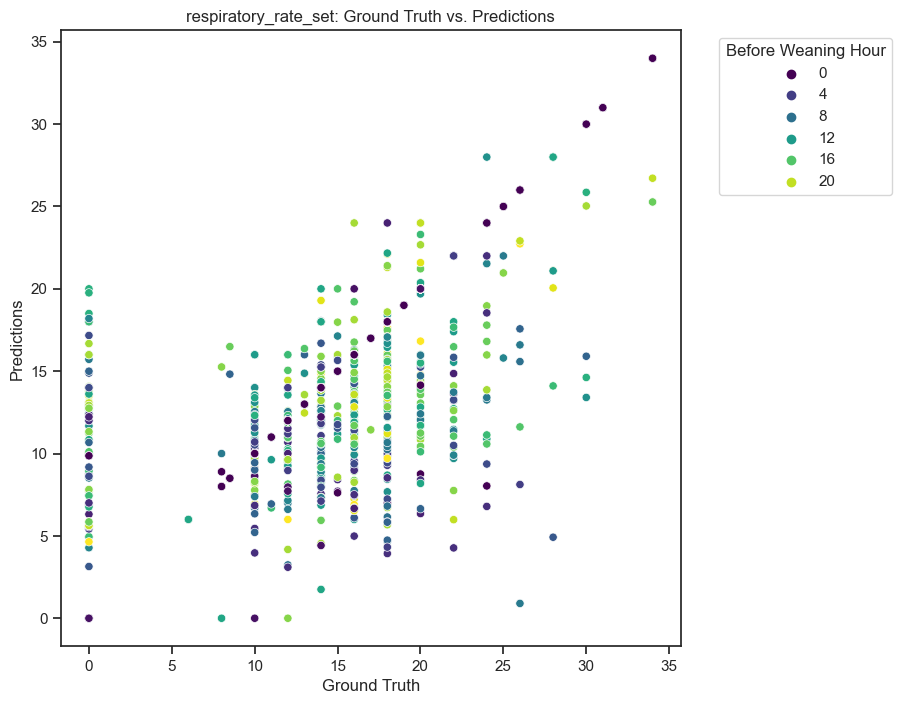

===== feature: plateau_pressure =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.93      0.96     37875
           1       0.23      0.75      0.36      1041

    accuracy                           0.93     38916
   macro avg       0.61      0.84      0.66     38916
weighted avg       0.97      0.93      0.95     38916


whole positive set Mean Squared Error (MSE): 0.4028
whole positive set Mean Absolute Error (MAE): 0.1268
whole positive set R-squared (R2): 0.9797



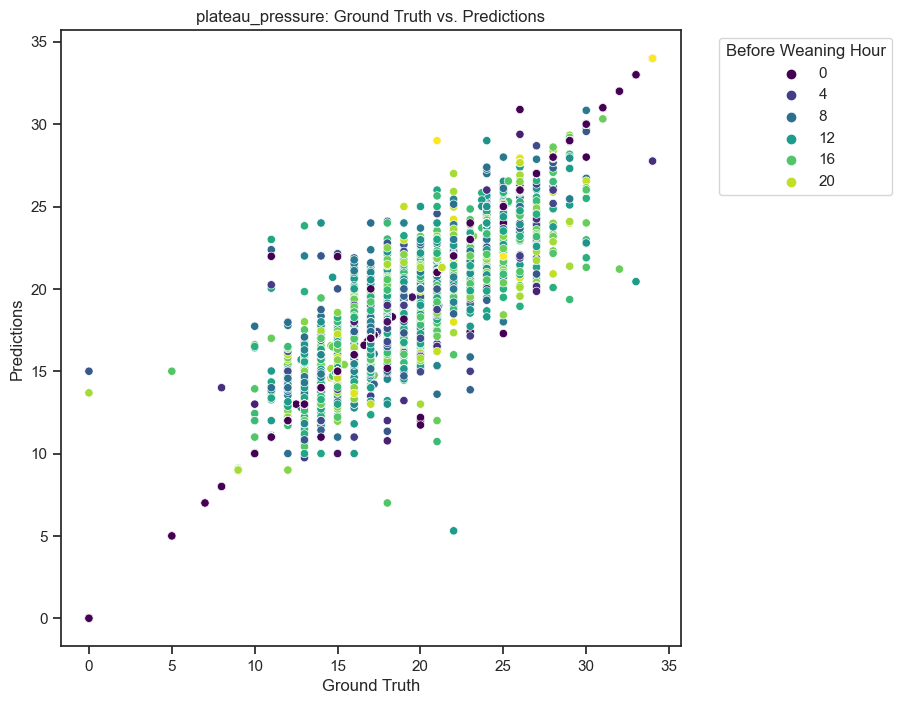

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.89      0.92     21178
           1       0.16      0.38      0.22      1155

    accuracy                           0.86     22333
   macro avg       0.56      0.64      0.57     22333
weighted avg       0.92      0.86      0.89     22333


whole negative set Mean Squared Error (MSE): 3.4205
whole negative set Mean Absolute Error (MAE): 0.4982
whole negative set R-squared (R2): 0.8886



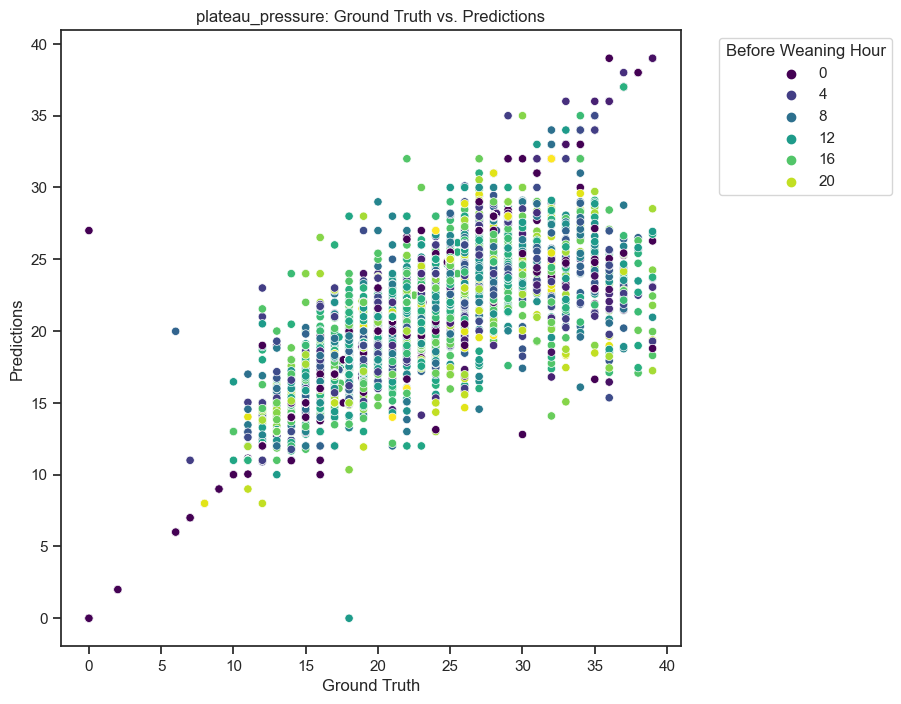

train positive set Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.93      0.96     26471
           1       0.27      0.94      0.42       715

    accuracy                           0.93     27186
   macro avg       0.63      0.94      0.69     27186
weighted avg       0.98      0.93      0.95     27186


train positive set Mean Squared Error (MSE): 0.2910
train positive set Mean Absolute Error (MAE): 0.1035
train positive set R-squared (R2): 0.9854



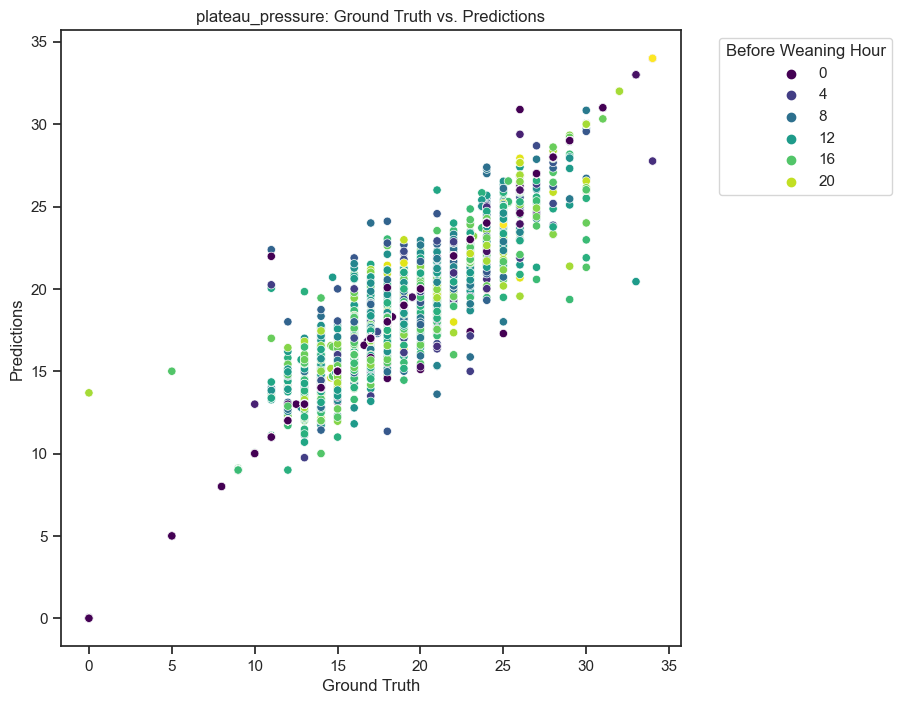

val positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96      3876
           1       0.15      0.33      0.21       126

    accuracy                           0.92      4002
   macro avg       0.56      0.63      0.58      4002
weighted avg       0.95      0.92      0.93      4002


val positive set Mean Squared Error (MSE): 0.6540
val positive set Mean Absolute Error (MAE): 0.1772
val positive set R-squared (R2): 0.9613



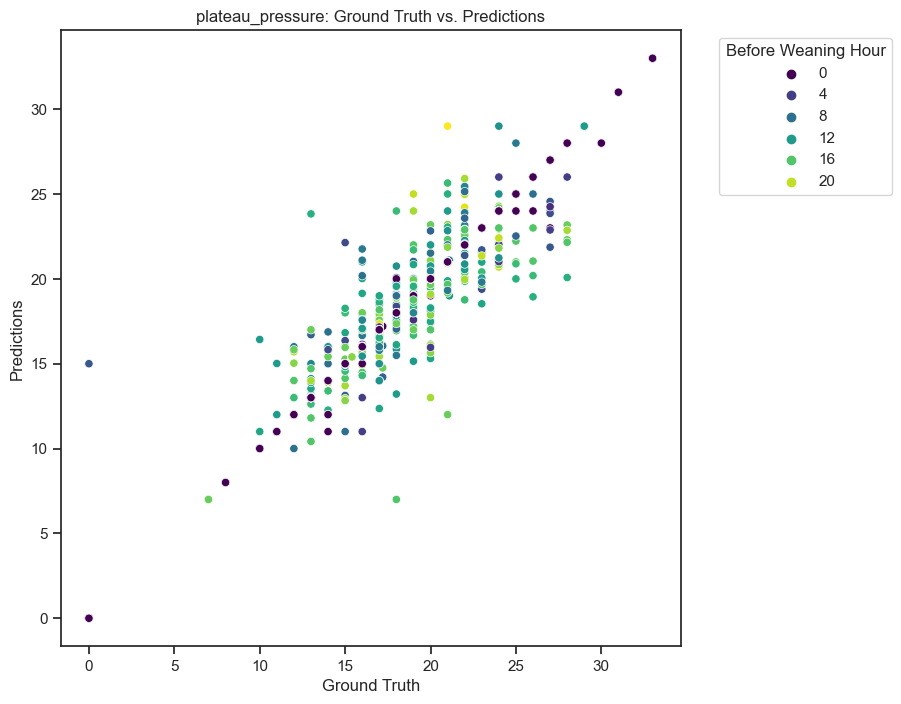

test positive set Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.93      0.96      7528
           1       0.12      0.34      0.17       200

    accuracy                           0.92      7728
   macro avg       0.55      0.64      0.56      7728
weighted avg       0.96      0.92      0.94      7728


test positive set Mean Squared Error (MSE): 0.6661
test positive set Mean Absolute Error (MAE): 0.1830
test positive set R-squared (R2): 0.9684



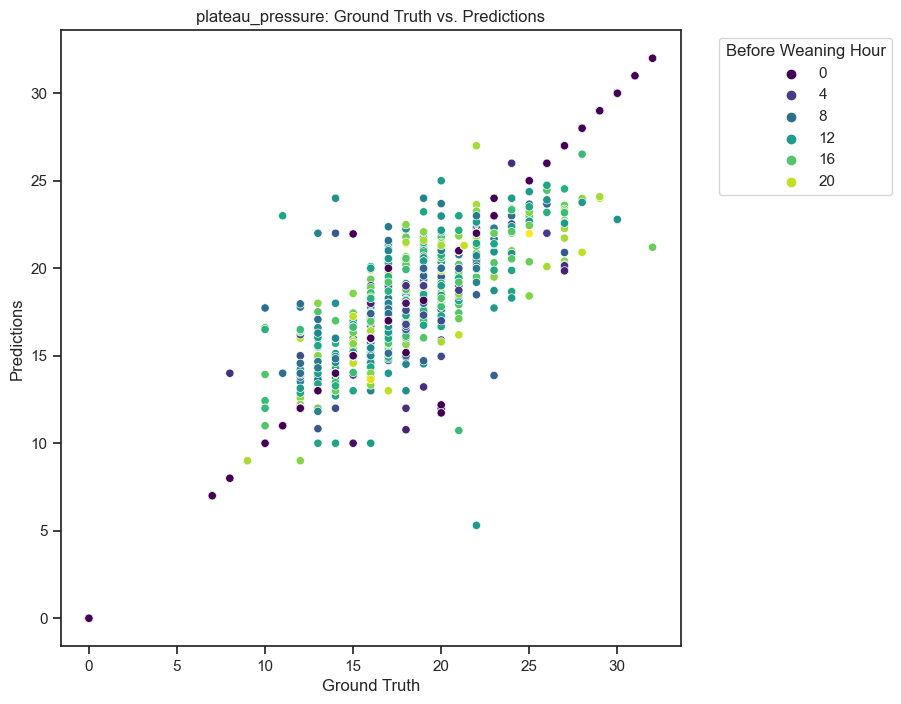

In [523]:
feature_columns = [
    'before_weaning_hr', 'age_now', 'weight_kg',
    'height_cm', 'tobacco', 'heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 'tidal_volume_observed', 'RSBI',
    'minute_ventilation', 'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h', 'mbp_prev_1h', 'spo2_prev_1h',
    'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h', 
    'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h',
]
for feature in ventilator_settings:
    print(f'===== feature: {feature} =====')
    model_A_inference(whole_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'whole positive set')
    model_A_inference(negative_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'whole negative set')
    model_A_inference(train_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'train positive set')
    model_A_inference(val_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'val positive set')
    model_A_inference(test_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'test positive set')

In [447]:
feature_columns = [
    'before_weaning_hr', 'age_now', 'weight_kg',
    'height_cm', 'tobacco', 'heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 'tidal_volume_observed', 'RSBI',
    'minute_ventilation', 'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h', 'mbp_prev_1h', 'spo2_prev_1h',
    'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h', 
    'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h',
]
for feature in ventilator_settings:
    print(f'===== feature: {feature} =====')
    model_A_inference(whole_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'whole positive set')
    model_A_inference(negative_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'whole negative set')
    model_A_inference(train_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'train positive set')
    model_A_inference(val_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'val positive set')
    model_A_inference(test_change_label_value_aug_df, model_A_dict, feature, feature_columns, 'test positive set')

===== feature: peep =====
whole positive set Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.94      0.96     36698
           1       0.36      0.60      0.45      2218

    accuracy                           0.92     38916
   macro avg       0.67      0.77      0.70     38916
weighted avg       0.94      0.92      0.93     38916


whole positive set Mean Squared Error (MSE): 1.3819
whole positive set Mean Absolute Error (MAE): 0.3089
whole positive set R-squared (R2): 0.7626

whole negative set Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.88      0.92     20895
           1       0.20      0.43      0.27      1438

    accuracy                           0.85     22333
   macro avg       0.58      0.65      0.59     22333
weighted avg       0.91      0.85      0.87     22333


whole negative set Mean Squared Error (MSE): 2.4173
whole negative set Mean Absolute E

## Model B: vs_affect_model
- input: baseline + current vitalsign + previous n hr vitalsign + current ventilator settings
- output: next 1 hr vitalsign
- cohort: all

- steps:
    - Statistics:
        - number of change in vitalsign features
    - Preprocessing
        - Split dataset
    - Model
        - directly regression
    - Training
    - Visualization
    - Evaluation
    - Inference

### Read in data

In [384]:
group_pre_2hr_visi_vese_train_df = pd.read_csv("data/model_data/group_pre_2hr_visi_vese_train.csv")
group_pre_2hr_visi_vese_val_df = pd.read_csv("data/model_data/group_pre_2hr_visi_vese_val.csv")
group_pre_2hr_visi_vese_test_df = pd.read_csv("data/model_data/group_pre_2hr_visi_vese_test.csv")

group_pre_2hr_visi_vese_train_df.columns

Index(['subject_id', 'stay_id', 'hadm_id', 'charttime', 'before_weaning_hr',
       'label', 'age_now', 'gender', 'insurance', 'race', 'first_careunit',
       'admission_type', 'weight_kg', 'height_cm', 'tobacco', 'heart_rate',
       'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 'tidal_volume_observed',
       'RSBI', 'minute_ventilation', 'peep', 'fio2', 'respiratory_rate_set',
       'plateau_pressure', 'ventilator_mode', 'ventilator_mode_group',
       'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h', 'mbp_prev_1h',
       'spo2_prev_1h', 'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h',
       'RSBI_prev_1h', 'minute_ventilation_prev_1h', 'peep_prev_1h',
       'fio2_prev_1h', 'respiratory_rate_set_prev_1h',
       'plateau_pressure_prev_1h', 'ventilator_mode_prev_1h',
       'ventilator_mode_group_prev_1h', 'heart_rate_prev_2h', 'sbp_prev_2h',
       'dbp_prev_2h', 'mbp_prev_2h', 'spo2_prev_2h', 'resp_rate_prev_2h',
       'tidal_volume_observed_prev_2h', 'RSBI_prev_2h',
     

### Statistics

Statistics on the change of the vitalsign: looks like don't have imbalance issue

In [385]:
vitalsign = ['heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 
             'tidal_volume_observed', 'RSBI', 'minute_ventilation']
for feature in vitalsign:
    print(f'feature: {feature}')
    prev_feature = feature + '_prev_1h'
    feature_change_counts = count_feature_change(group_pre_2hr_visi_vese_train_df, feature, prev_feature)

feature: heart_rate
increase: 0.42, decrease: 0.41, same: 0.17
increase: 17317, decrease: 16843, same: 6760
feature: sbp
increase: 0.45, decrease: 0.44, same: 0.11
increase: 18450, decrease: 17978, same: 4492
feature: dbp
increase: 0.44, decrease: 0.43, same: 0.14
increase: 17833, decrease: 17542, same: 5545
feature: mbp
increase: 0.44, decrease: 0.43, same: 0.13
increase: 18073, decrease: 17679, same: 5168
feature: spo2
increase: 0.28, decrease: 0.28, same: 0.45
increase: 11303, decrease: 11361, same: 18256
feature: resp_rate
increase: 0.4, decrease: 0.37, same: 0.24
increase: 16184, decrease: 15068, same: 9668
feature: tidal_volume_observed
increase: 0.11, decrease: 0.11, same: 0.78
increase: 4440, decrease: 4624, same: 31856
feature: RSBI
increase: 0.41, decrease: 0.39, same: 0.2
increase: 16824, decrease: 16084, same: 8012
feature: minute_ventilation
increase: 0.41, decrease: 0.4, same: 0.19
increase: 16732, decrease: 16244, same: 7944


we can see that the value change in 1 hr can be large, also show on the prev_1h vs. current_hr graph

In [386]:
feature = "heart_rate"
change_threshold = 40
feature_analyze_df = group_pre_2hr_visi_vese_train_df[group_pre_2hr_visi_vese_train_df[f"{feature}"] - group_pre_2hr_visi_vese_train_df[f"{feature}_prev_1h"] > change_threshold]
feature_analyze_df[["stay_id", "before_weaning_hr", f"{feature}", f"{feature}_prev_1h", f"{feature}_prev_2h"]]

,stay_id,before_weaning_hr,heart_rate,heart_rate_prev_1h,heart_rate_prev_2h
215,30072554,4.0,132.0,68.0,67.0
1004,30406698,7.0,103.0,55.0,58.0
1006,30406698,5.0,107.0,62.0,103.0
1834,30698001,13.0,119.0,68.0,78.0
1840,30698001,7.0,142.0,100.0,129.0
...,...,...,...,...,...
40183,39597974,10.0,135.0,71.0,71.0
40185,39597974,8.0,124.0,80.0,135.0
40190,39597974,3.0,130.0,74.0,61.0
40338,39661672,9.0,134.0,92.0,90.0


In [387]:
group_pre_2hr_visi_vese_change_label_value_aug_df = generate_change_col(group_pre_2hr_visi_vese_train_df, ventilator_settings, 0)

In [388]:
feature = "resp_rate"
change_threshold = 10
feature_analyze_df = group_pre_2hr_visi_vese_change_label_value_aug_df[group_pre_2hr_visi_vese_change_label_value_aug_df[f"{feature}"] - group_pre_2hr_visi_vese_change_label_value_aug_df[f"{feature}_prev_1h"] > change_threshold]
feature_analyze_df[["stay_id", "before_weaning_hr", f"{feature}", f"{feature}_prev_1h", f"{feature}_prev_2h", "peep_change_value", "fio2_change_value", "respiratory_rate_set_change_value", "plateau_pressure_change_value", "ventilator_mode_group", "ventilator_mode_group_prev_1h"]]

,stay_id,before_weaning_hr,resp_rate,resp_rate_prev_1h,resp_rate_prev_2h,peep_change_value,fio2_change_value,respiratory_rate_set_change_value,plateau_pressure_change_value,ventilator_mode_group,ventilator_mode_group_prev_1h
77,30015010,10.0,24.0,13.0,18.0,0.0,0.0,0.0,0.0,Complete Support,Minimal Support
80,30015010,7.0,32.0,14.0,20.0,0.0,0.0,0.0,0.0,Complete Support,Complete Support
288,30047981,19.0,35.0,16.0,14.0,0.0,0.0,0.0,0.0,Minimal Support,Minimal Support
422,30063714,17.0,49.0,27.0,27.0,0.0,0.0,0.0,0.0,Minimal Support,Complete Support
439,30063714,0.0,36.0,23.5,16.0,0.0,0.0,0.0,0.0,Complete Support,Complete Support
...,...,...,...,...,...,...,...,...,...,...,...
40550,39910454,17.0,38.0,22.0,19.0,0.0,0.0,0.0,0.0,Minimal Support,Minimal Support
40710,39945709,11.0,27.0,16.0,27.0,0.0,0.0,0.0,0.0,Minimal Support,Minimal Support
40870,39985110,5.0,35.0,24.0,30.0,0.0,10.0,0.0,0.0,Minimal Support,Minimal Support
40872,39985110,3.0,34.0,20.0,35.0,0.0,0.0,0.0,0.0,Minimal Support,Minimal Support


## Intuition model: directly do regression

In [389]:
vitalsign = ['heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 
             'tidal_volume_observed', 'RSBI', 'minute_ventilation']
# only use prev 1 hr
# X_cols = ['before_weaning_hr', 'age_now', 'weight_kg', 'height_cm', 'tobacco', # 'gender', 
#           'peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure',
#           'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h',
#           'mbp_prev_1h', 'spo2_prev_1h', 'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h',
#           'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h']
X_cols = ['before_weaning_hr', 'age_now', 'weight_kg', 'height_cm', 'tobacco', # 'gender', 
          'peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure',
          'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h',
          'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h',
          'mbp_prev_1h', 'spo2_prev_1h', 'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h',
          'heart_rate_prev_2h', 'sbp_prev_2h', 'dbp_prev_2h',
          'mbp_prev_2h', 'spo2_prev_2h', 'resp_rate_prev_2h', 'tidal_volume_observed_prev_2h', 'RSBI_prev_2h', 'minute_ventilation_prev_2h']

#### 1. Ground Truth vs. log(count_by_value)

====== vitalsign: heart_rate =====
Training Set Mean Squared Error (MSE): 42.1728
Training Set Mean Absolute Error (MAE): 4.5011
Training Set R-squared (R2): 0.8739

Validation Set Mean Squared Error (MSE): 76.9344
Validation Set Mean Absolute Error (MAE): 5.7369
Validation Set R-squared (R2): 0.7515

----- train -----


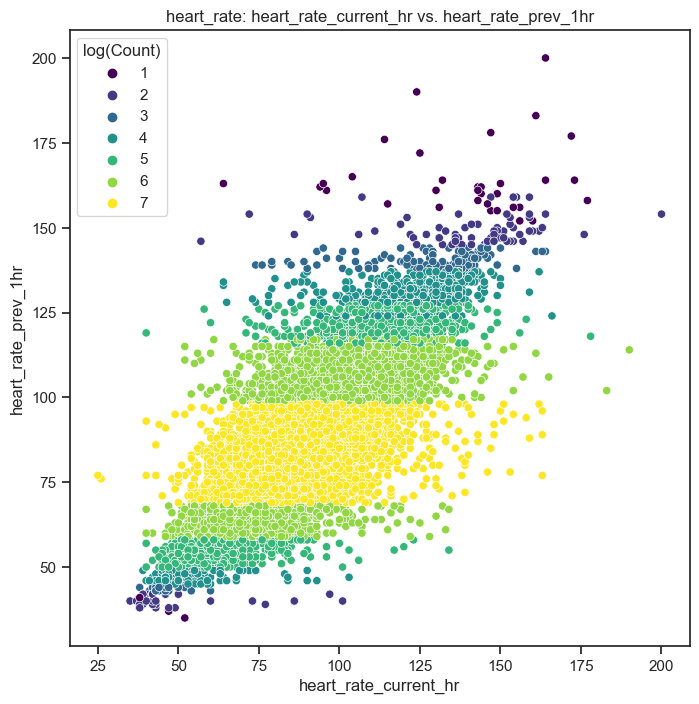

----- val -----


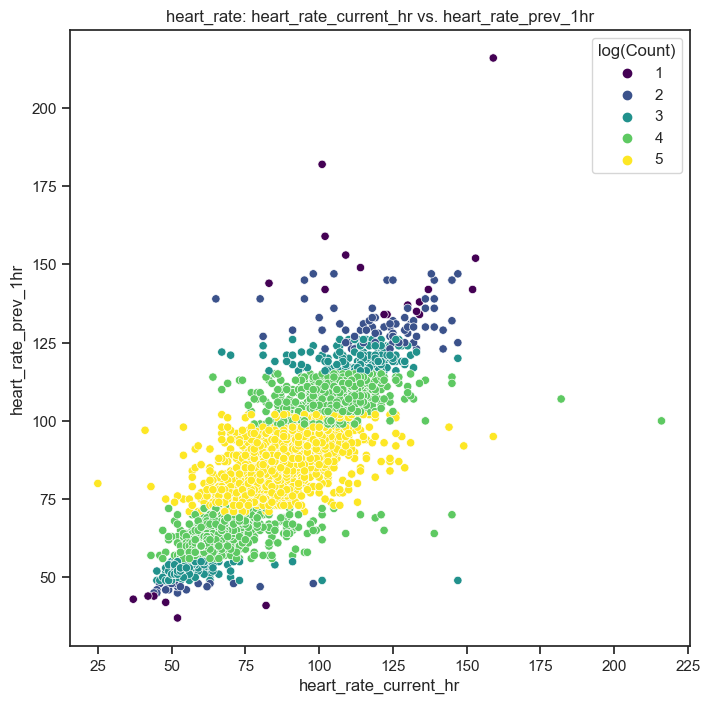

====== vitalsign: sbp =====
Training Set Mean Squared Error (MSE): 142.6734
Training Set Mean Absolute Error (MAE): 8.8094
Training Set R-squared (R2): 0.7239

Validation Set Mean Squared Error (MSE): 233.7963
Validation Set Mean Absolute Error (MAE): 11.0947
Validation Set R-squared (R2): 0.5430

----- train -----


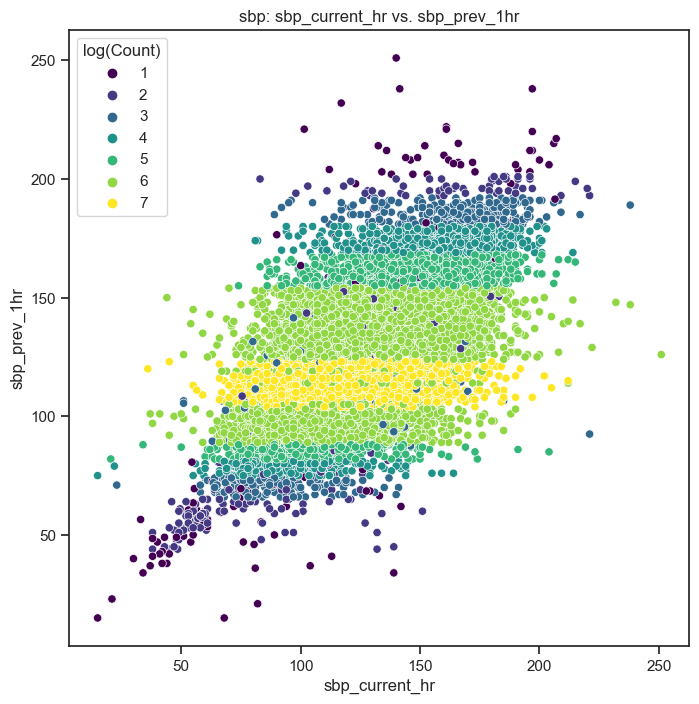

----- val -----


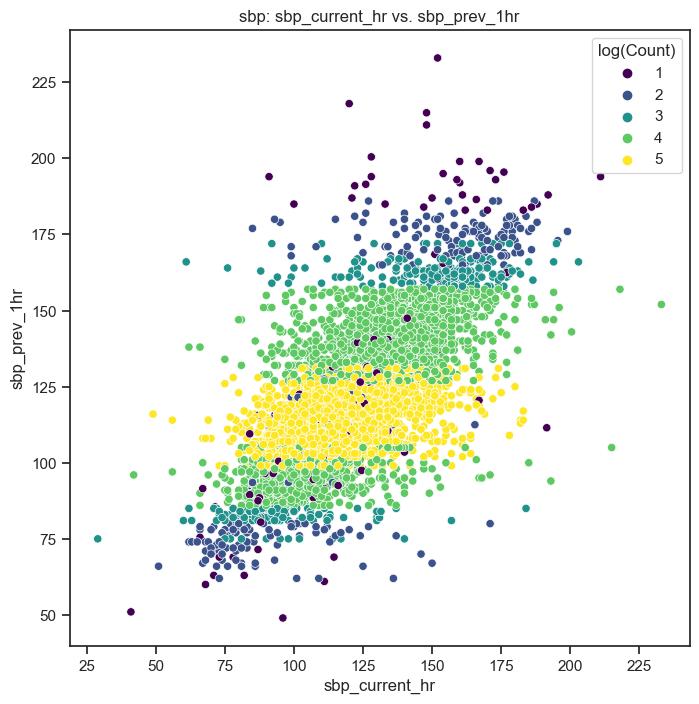

====== vitalsign: dbp =====
Training Set Mean Squared Error (MSE): 53.3186
Training Set Mean Absolute Error (MAE): 5.1834
Training Set R-squared (R2): 0.7307

Validation Set Mean Squared Error (MSE): 85.0813
Validation Set Mean Absolute Error (MAE): 6.4485
Validation Set R-squared (R2): 0.5655

----- train -----


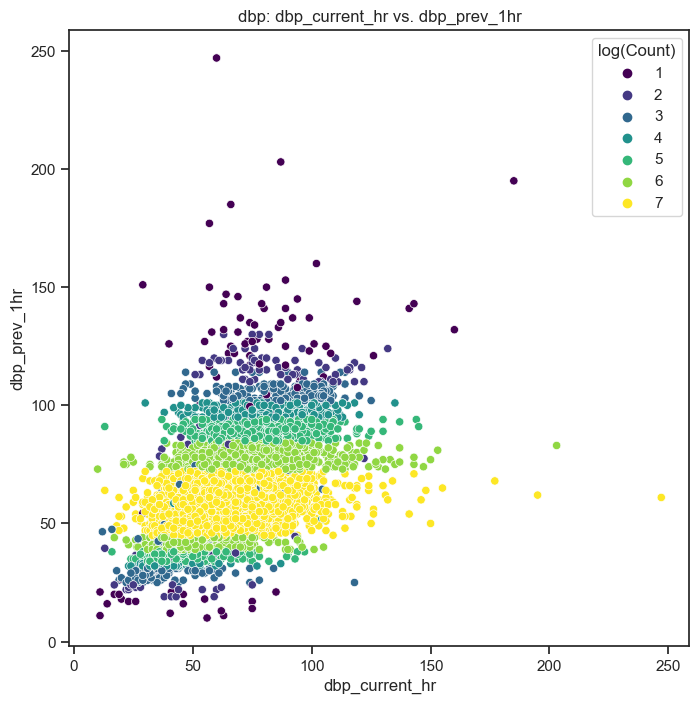

----- val -----


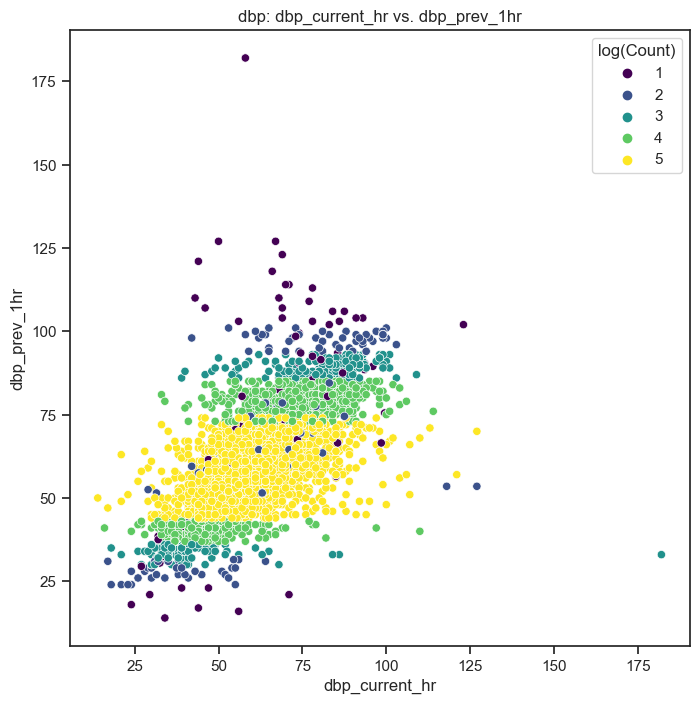

====== vitalsign: mbp =====
Training Set Mean Squared Error (MSE): 74.2376
Training Set Mean Absolute Error (MAE): 6.1464
Training Set R-squared (R2): 0.7052

Validation Set Mean Squared Error (MSE): 118.0081
Validation Set Mean Absolute Error (MAE): 7.6424
Validation Set R-squared (R2): 0.5134

----- train -----


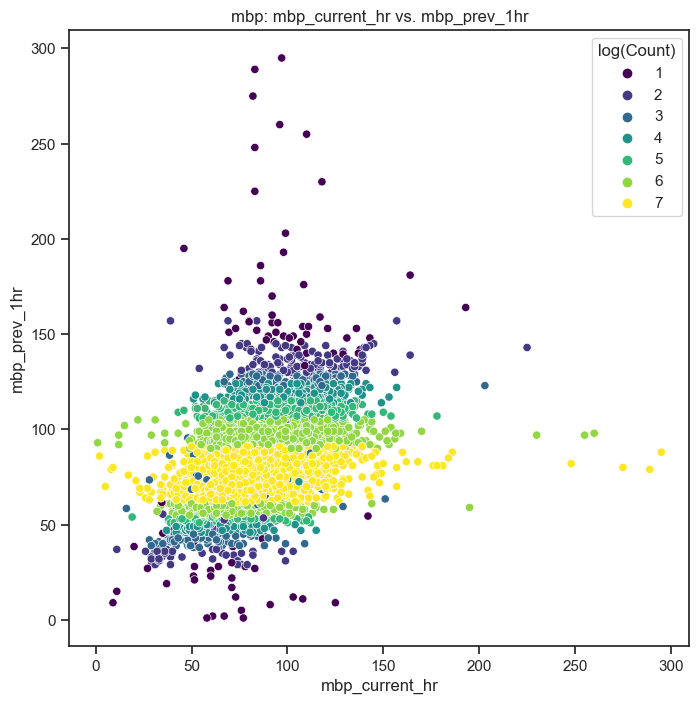

----- val -----


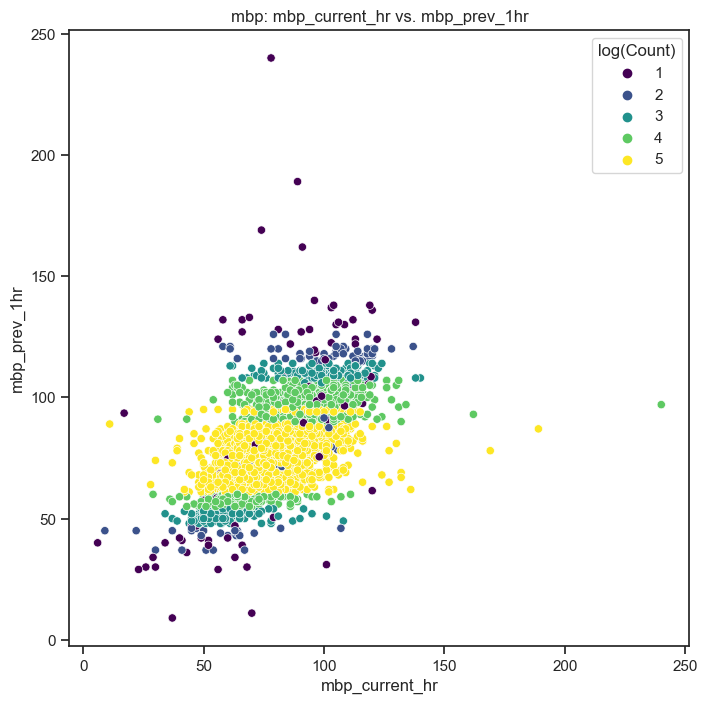

====== vitalsign: spo2 =====
Training Set Mean Squared Error (MSE): 2.1788
Training Set Mean Absolute Error (MAE): 0.9958
Training Set R-squared (R2): 0.8171

Validation Set Mean Squared Error (MSE): 5.6682
Validation Set Mean Absolute Error (MAE): 1.2926
Validation Set R-squared (R2): 0.3370

----- train -----


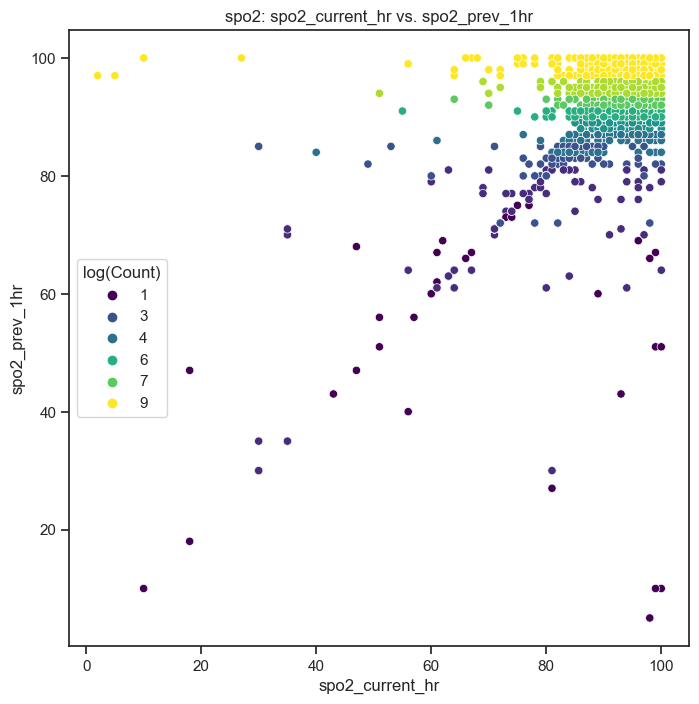

----- val -----


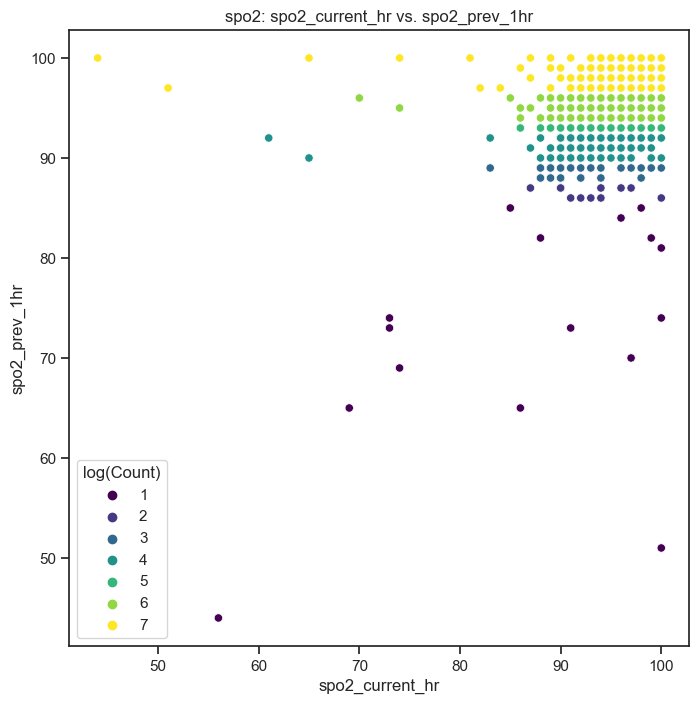

====== vitalsign: resp_rate =====
Training Set Mean Squared Error (MSE): 10.9982
Training Set Mean Absolute Error (MAE): 2.3741
Training Set R-squared (R2): 0.7129

Validation Set Mean Squared Error (MSE): 17.7770
Validation Set Mean Absolute Error (MAE): 3.0236
Validation Set R-squared (R2): 0.5312

----- train -----


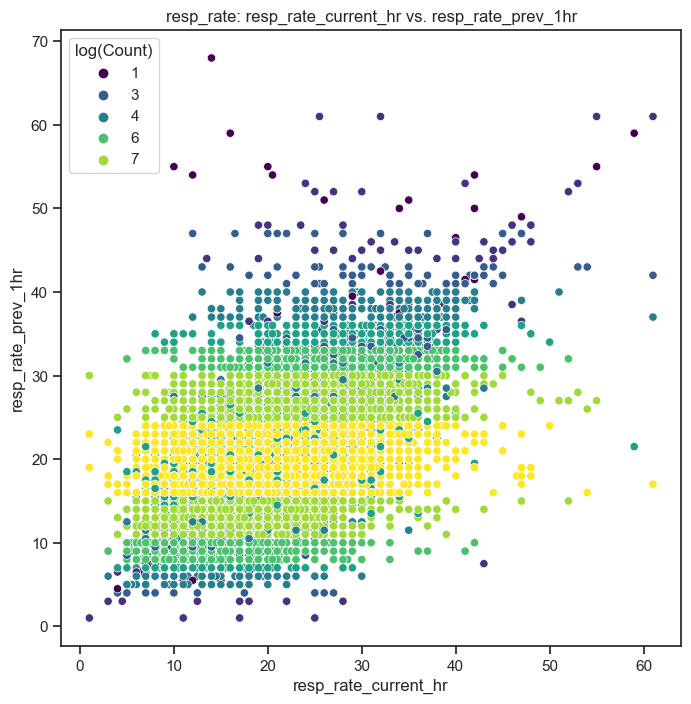

----- val -----


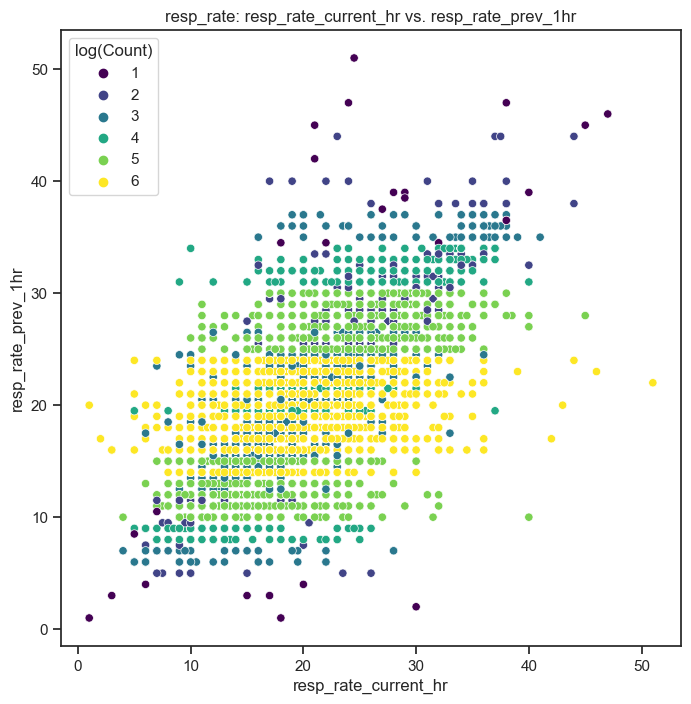

====== vitalsign: tidal_volume_observed =====
Training Set Mean Squared Error (MSE): 2220.6356
Training Set Mean Absolute Error (MAE): 22.3453
Training Set R-squared (R2): 0.8954

Validation Set Mean Squared Error (MSE): 4401.2470
Validation Set Mean Absolute Error (MAE): 30.8253
Validation Set R-squared (R2): 0.7996

----- train -----


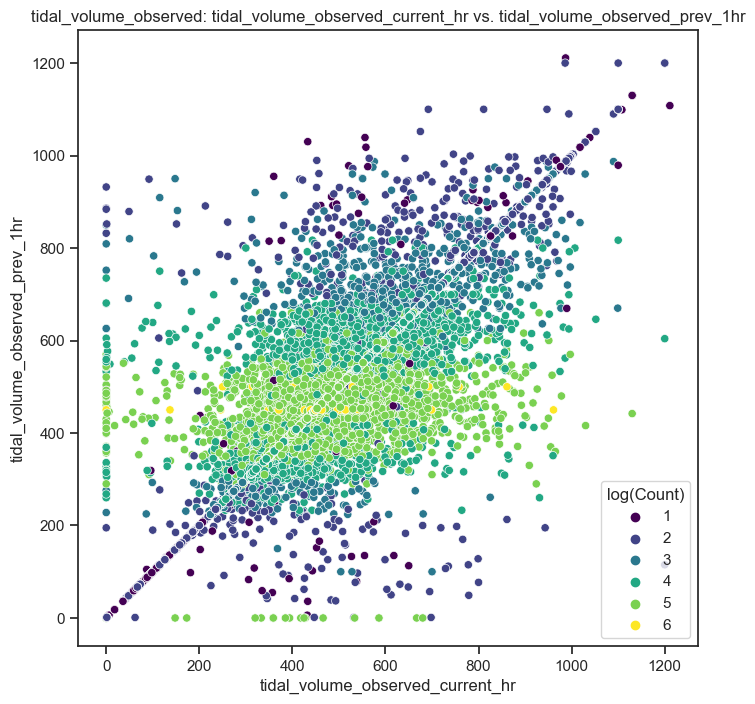

----- val -----


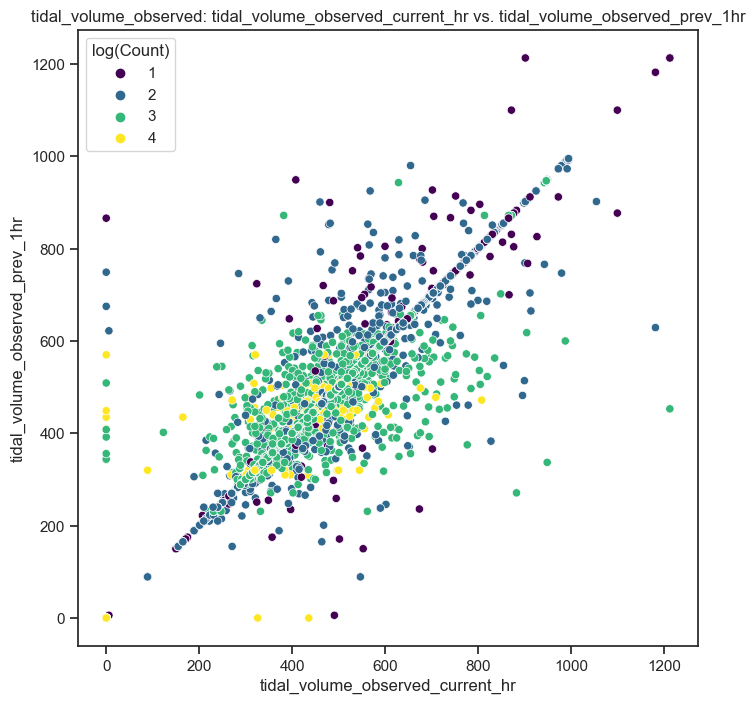

====== vitalsign: RSBI =====
Training Set Mean Squared Error (MSE): 421.7116
Training Set Mean Absolute Error (MAE): 9.0155
Training Set R-squared (R2): 0.9977

Validation Set Mean Squared Error (MSE): 12856.5155
Validation Set Mean Absolute Error (MAE): 16.7231
Validation Set R-squared (R2): -4.7863

----- train -----


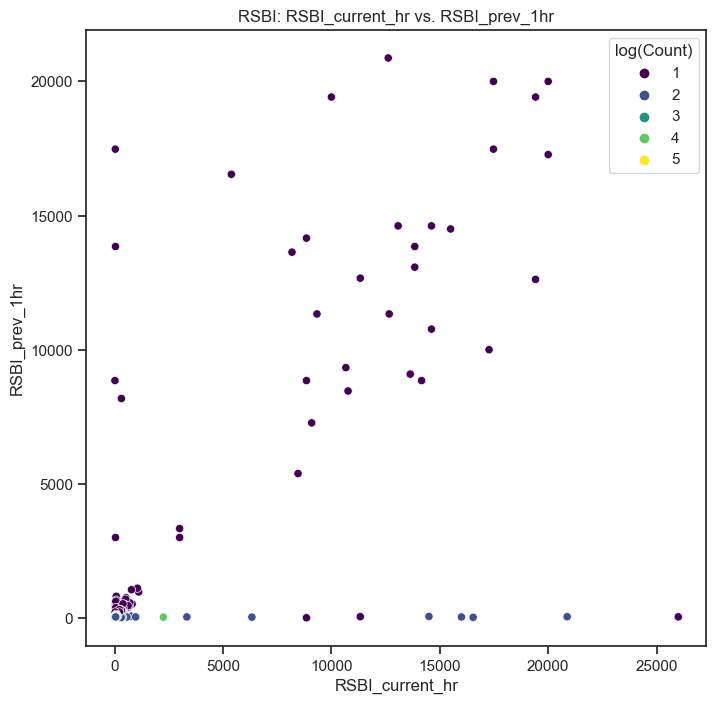

----- val -----


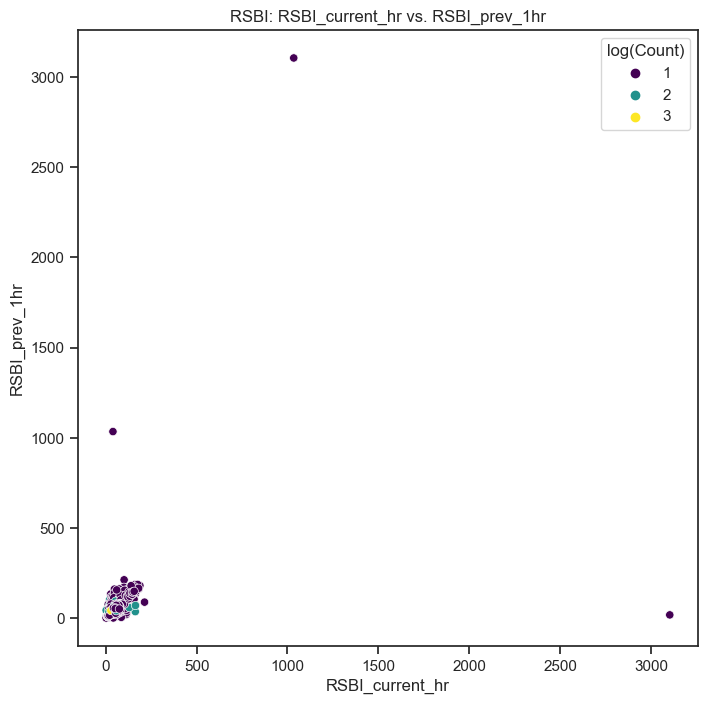

====== vitalsign: minute_ventilation =====
Training Set Mean Squared Error (MSE): 3.5295
Training Set Mean Absolute Error (MAE): 1.3134
Training Set R-squared (R2): 0.7264

Validation Set Mean Squared Error (MSE): 5.7898
Validation Set Mean Absolute Error (MAE): 1.6486
Validation Set R-squared (R2): 0.5144

----- train -----


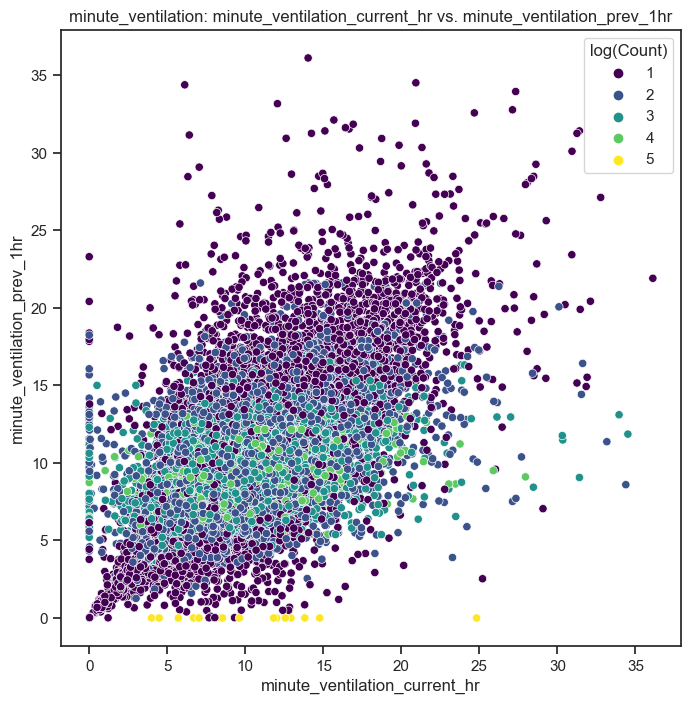

----- val -----


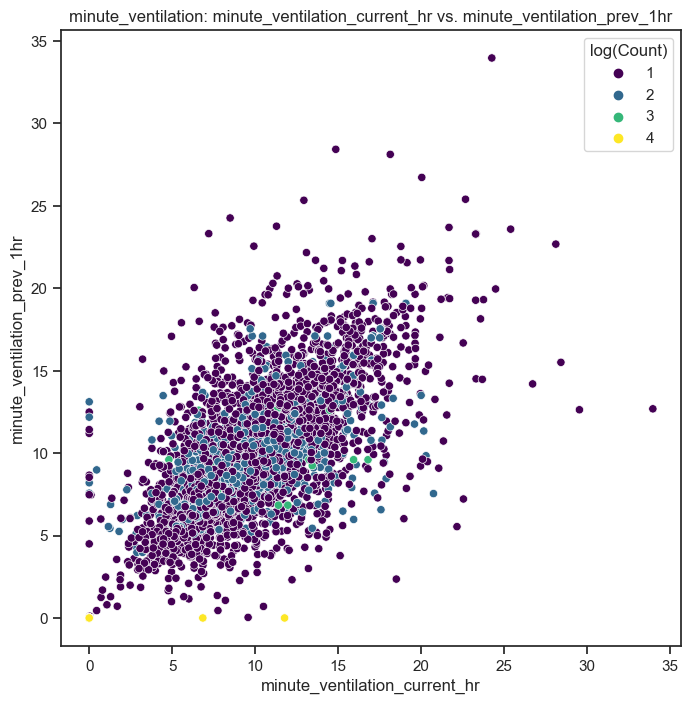

In [390]:
vitalsign = ['heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 
             'tidal_volume_observed', 'RSBI', 'minute_ventilation']
# vitalsign = ['resp_rate']
visual_mode = 1
model_B_dict = {}
for feature in vitalsign:
    print(f'====== vitalsign: {feature} =====')
    X_train, y_train, X_val, y_val = split_data(group_pre_2hr_visi_vese_train_df, group_pre_2hr_visi_vese_val_df, X_cols, feature)
    model = intuition_regression_model(X_train, y_train, X_val, y_val, feature, visual_mode)
    model_B_dict[feature] = model

#### prev(with noise) vs. ground truth

====== vitalsign: heart_rate =====


Training Set Mean Squared Error (MSE): 42.1728
Training Set Mean Absolute Error (MAE): 4.5011
Training Set R-squared (R2): 0.8739

Validation Set Mean Squared Error (MSE): 76.9344
Validation Set Mean Absolute Error (MAE): 5.7369
Validation Set R-squared (R2): 0.7515

----- train -----


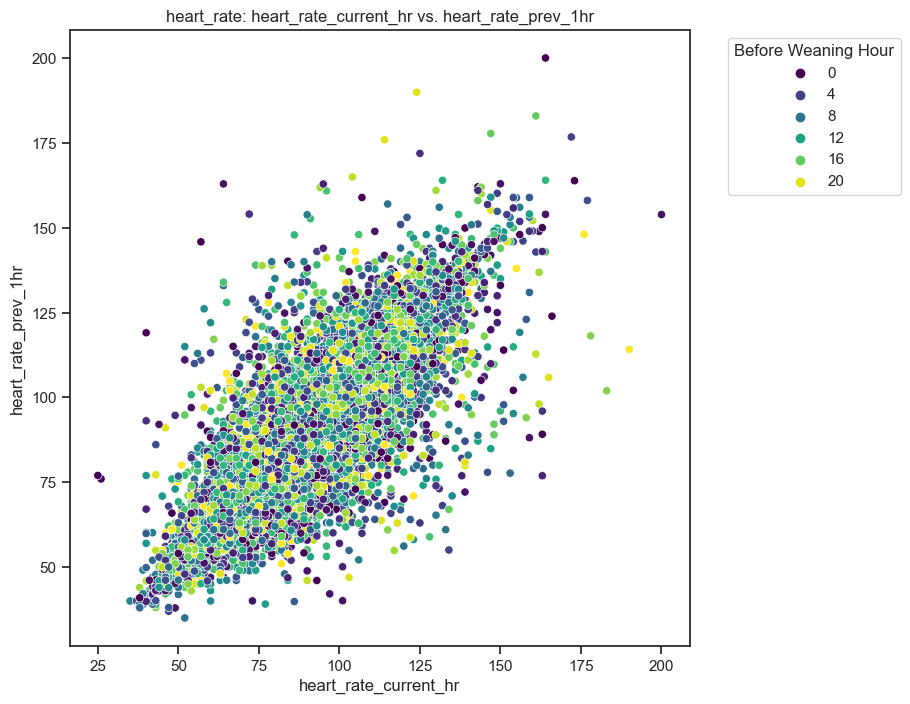

----- val -----


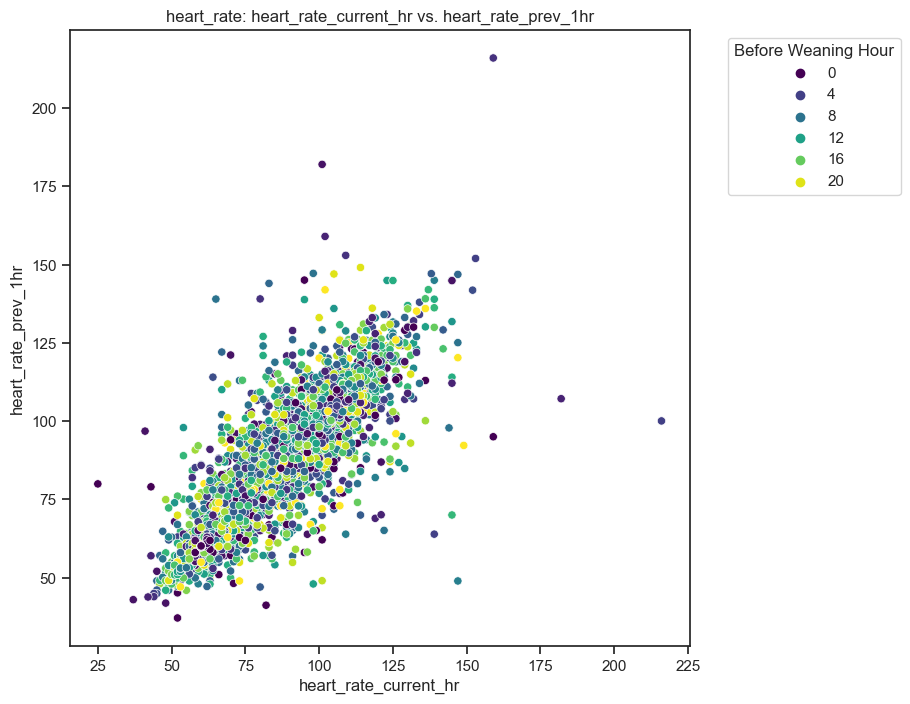

====== vitalsign: sbp =====
Training Set Mean Squared Error (MSE): 142.6734
Training Set Mean Absolute Error (MAE): 8.8094
Training Set R-squared (R2): 0.7239

Validation Set Mean Squared Error (MSE): 233.7963
Validation Set Mean Absolute Error (MAE): 11.0947
Validation Set R-squared (R2): 0.5430

----- train -----


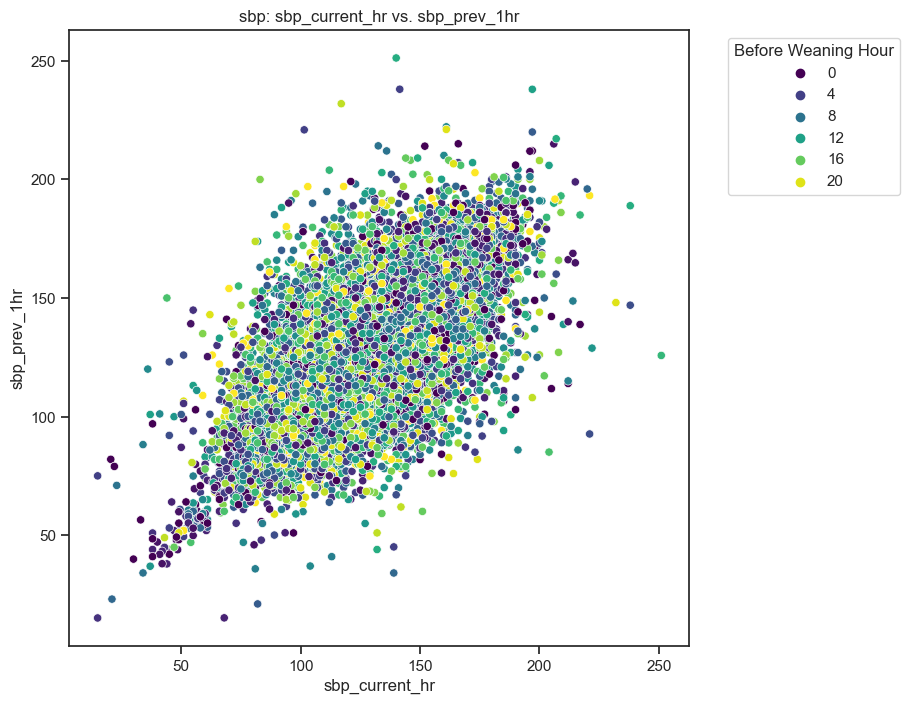

----- val -----


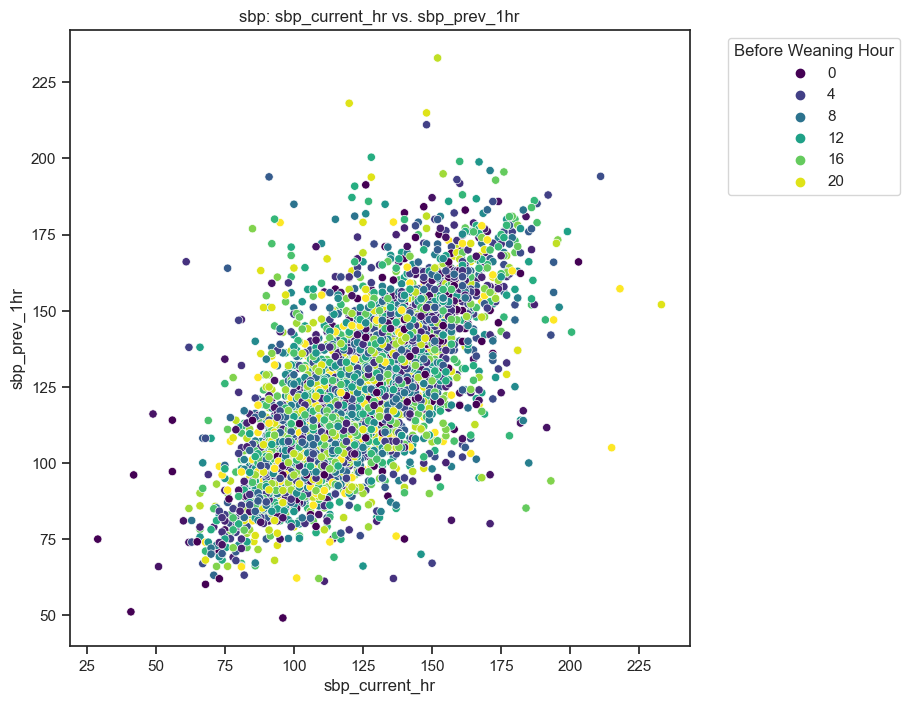

====== vitalsign: dbp =====
Training Set Mean Squared Error (MSE): 53.3186
Training Set Mean Absolute Error (MAE): 5.1834
Training Set R-squared (R2): 0.7307

Validation Set Mean Squared Error (MSE): 85.0813
Validation Set Mean Absolute Error (MAE): 6.4485
Validation Set R-squared (R2): 0.5655

----- train -----


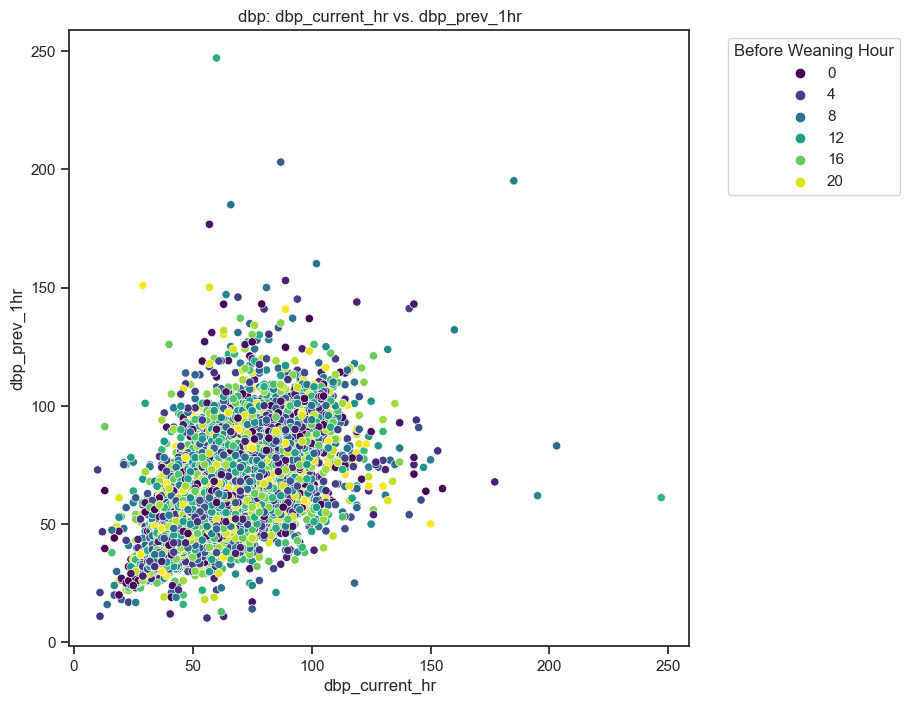

----- val -----


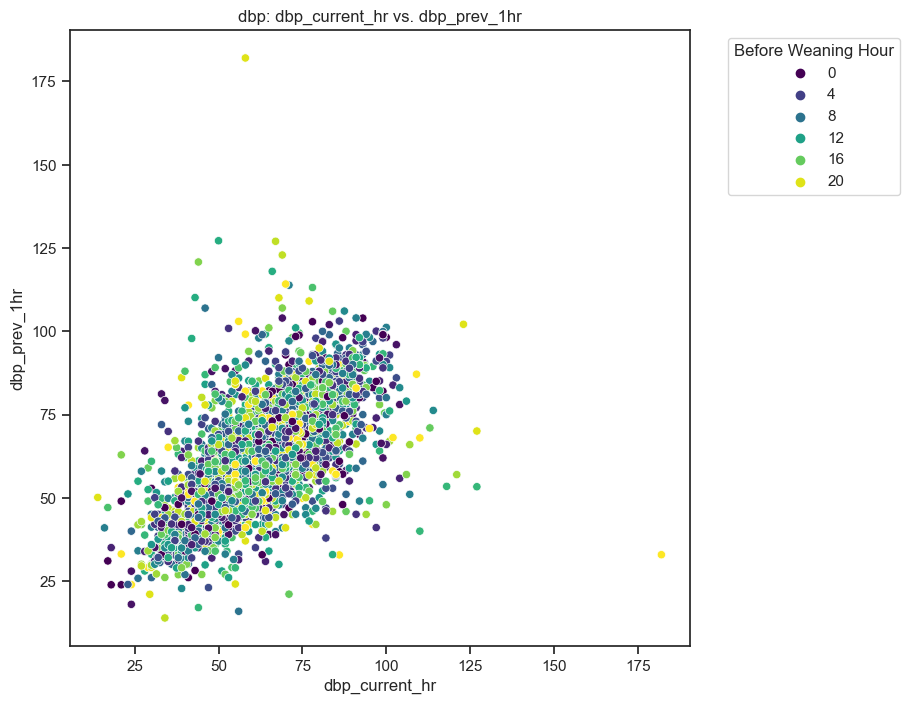

====== vitalsign: mbp =====
Training Set Mean Squared Error (MSE): 74.2376
Training Set Mean Absolute Error (MAE): 6.1464
Training Set R-squared (R2): 0.7052

Validation Set Mean Squared Error (MSE): 118.0081
Validation Set Mean Absolute Error (MAE): 7.6424
Validation Set R-squared (R2): 0.5134

----- train -----


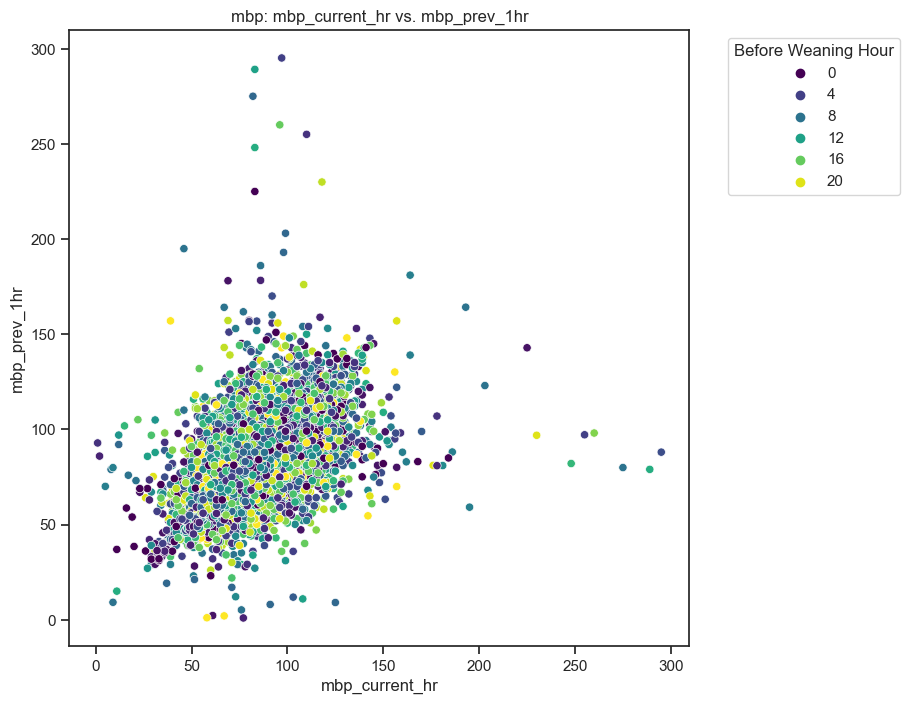

----- val -----


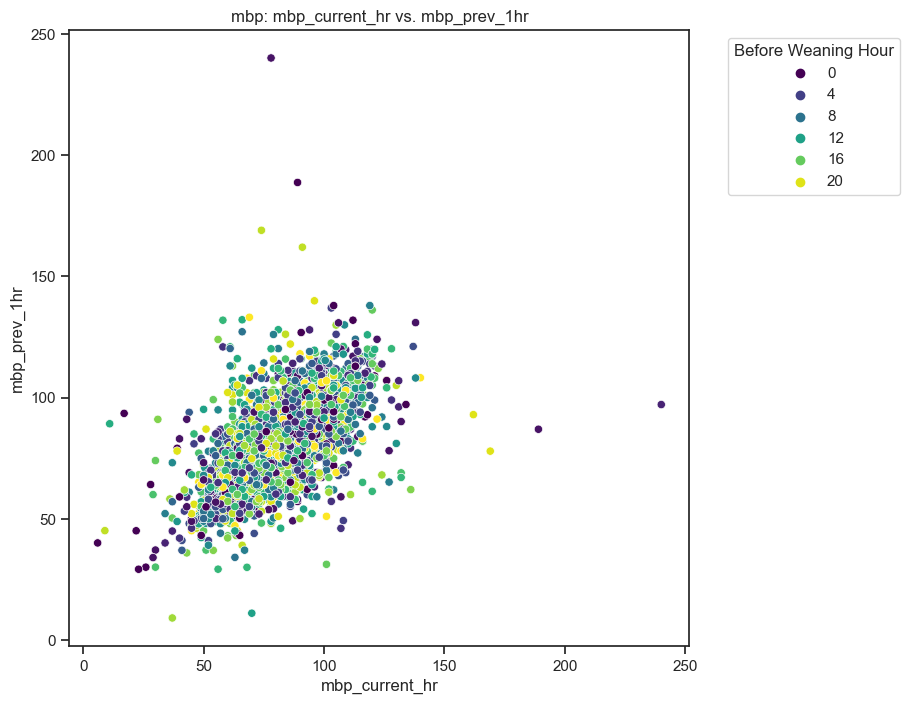

====== vitalsign: spo2 =====
Training Set Mean Squared Error (MSE): 2.1788
Training Set Mean Absolute Error (MAE): 0.9958
Training Set R-squared (R2): 0.8171

Validation Set Mean Squared Error (MSE): 5.6682
Validation Set Mean Absolute Error (MAE): 1.2926
Validation Set R-squared (R2): 0.3370

----- train -----


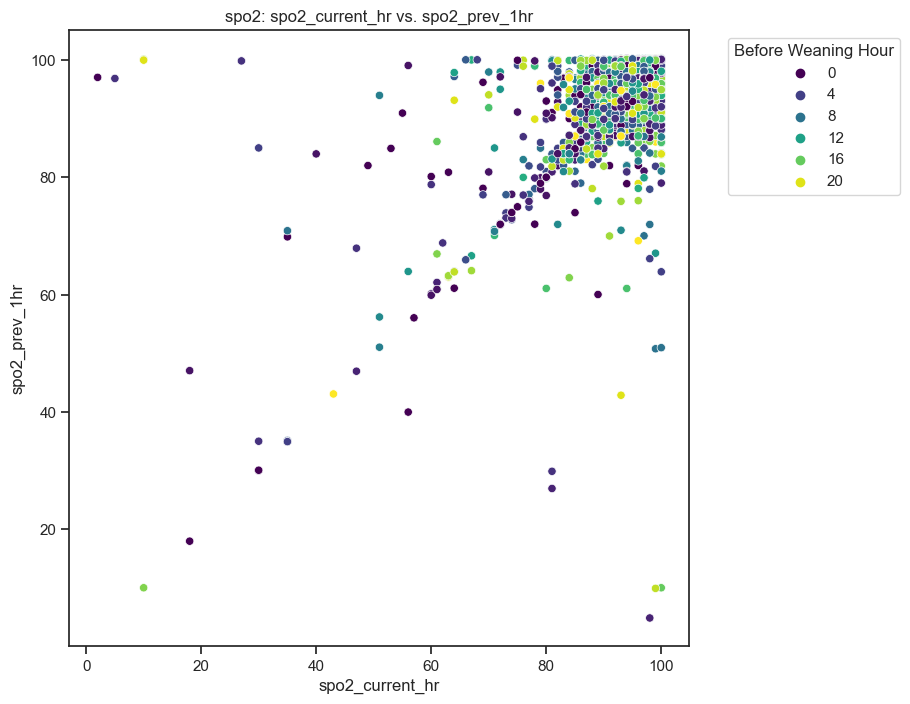

----- val -----


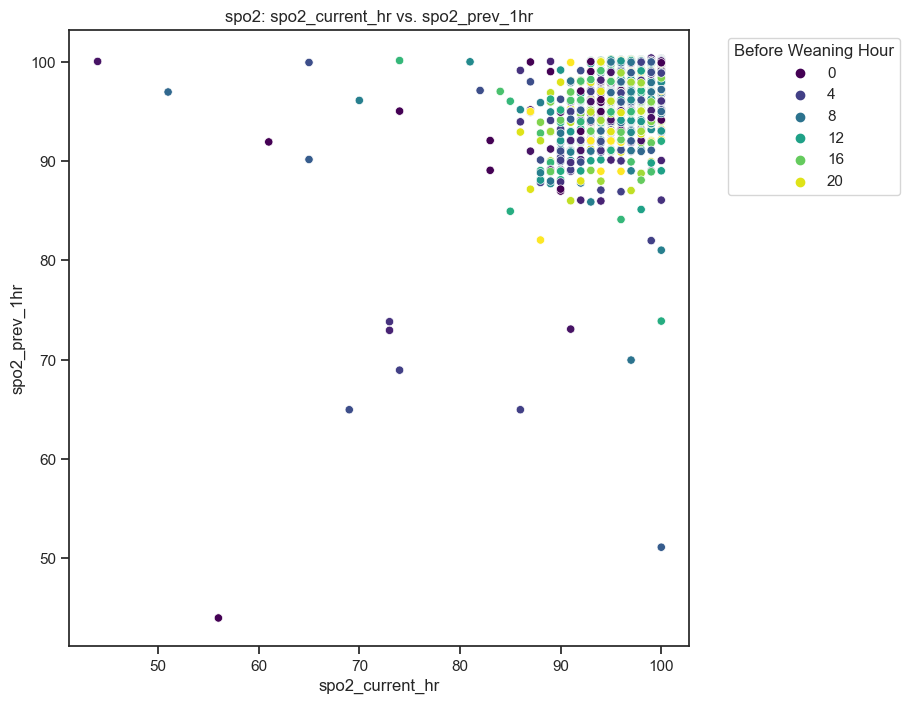

====== vitalsign: resp_rate =====
Training Set Mean Squared Error (MSE): 10.9982
Training Set Mean Absolute Error (MAE): 2.3741
Training Set R-squared (R2): 0.7129

Validation Set Mean Squared Error (MSE): 17.7770
Validation Set Mean Absolute Error (MAE): 3.0236
Validation Set R-squared (R2): 0.5312

----- train -----


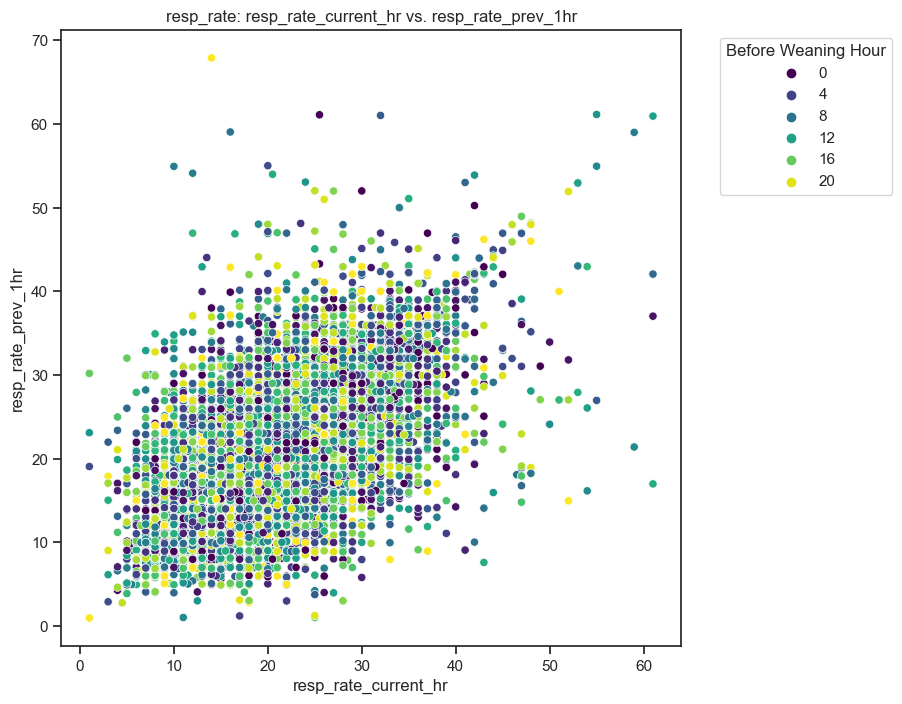

----- val -----


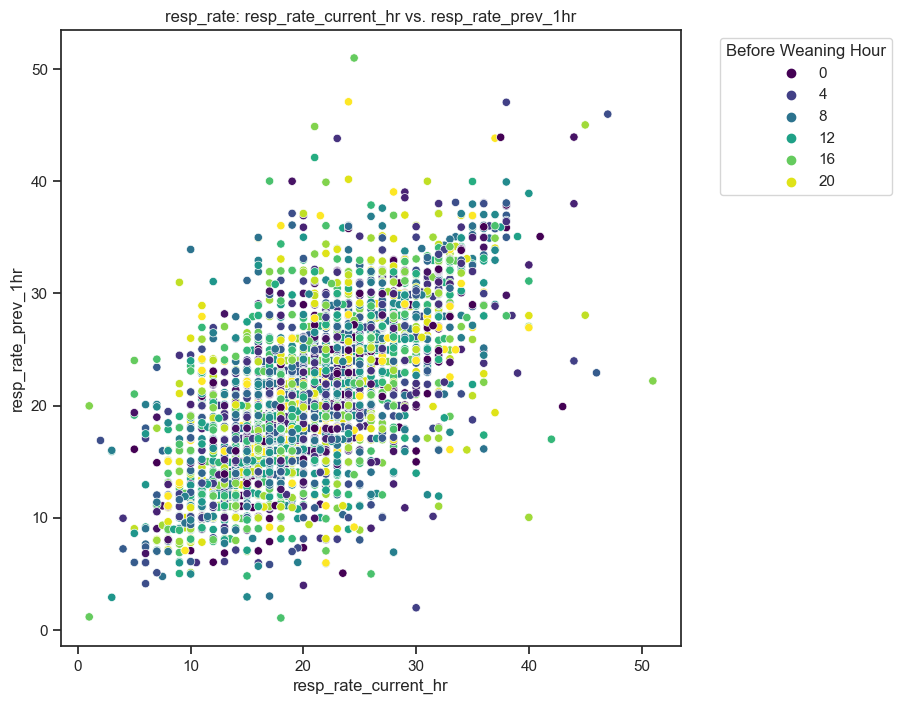

====== vitalsign: tidal_volume_observed =====
Training Set Mean Squared Error (MSE): 2220.6356
Training Set Mean Absolute Error (MAE): 22.3453
Training Set R-squared (R2): 0.8954

Validation Set Mean Squared Error (MSE): 4401.2470
Validation Set Mean Absolute Error (MAE): 30.8253
Validation Set R-squared (R2): 0.7996

----- train -----


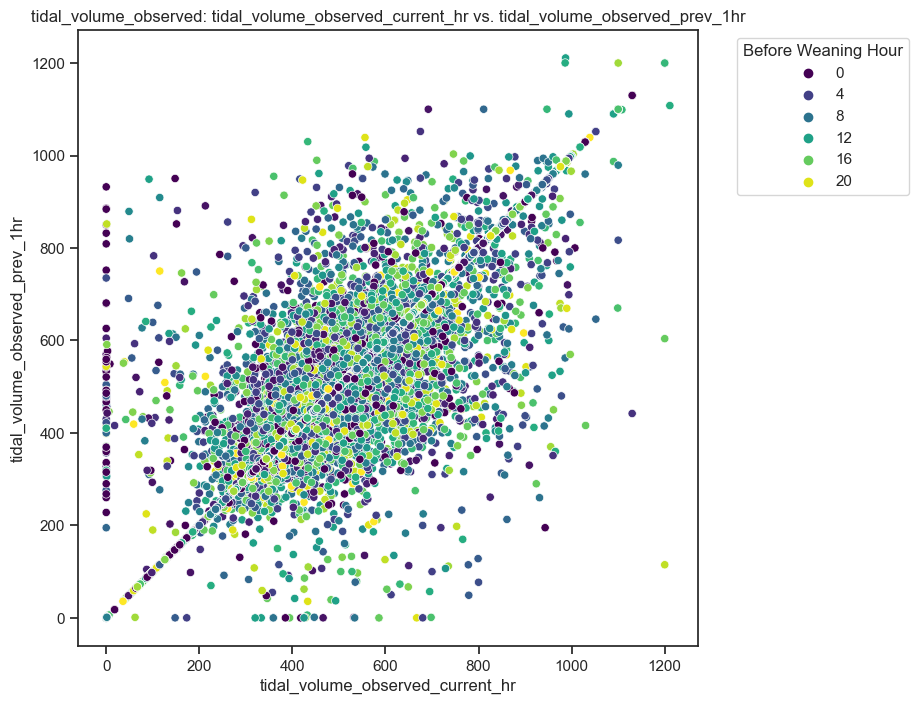

----- val -----


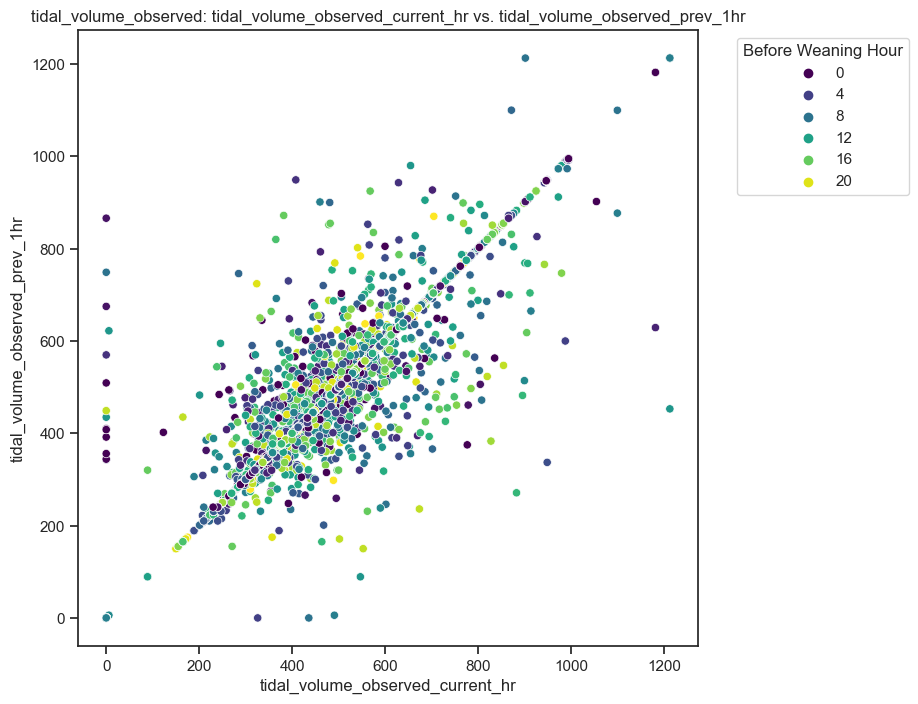

====== vitalsign: RSBI =====
Training Set Mean Squared Error (MSE): 421.7116
Training Set Mean Absolute Error (MAE): 9.0155
Training Set R-squared (R2): 0.9977

Validation Set Mean Squared Error (MSE): 12856.5155
Validation Set Mean Absolute Error (MAE): 16.7231
Validation Set R-squared (R2): -4.7863

----- train -----


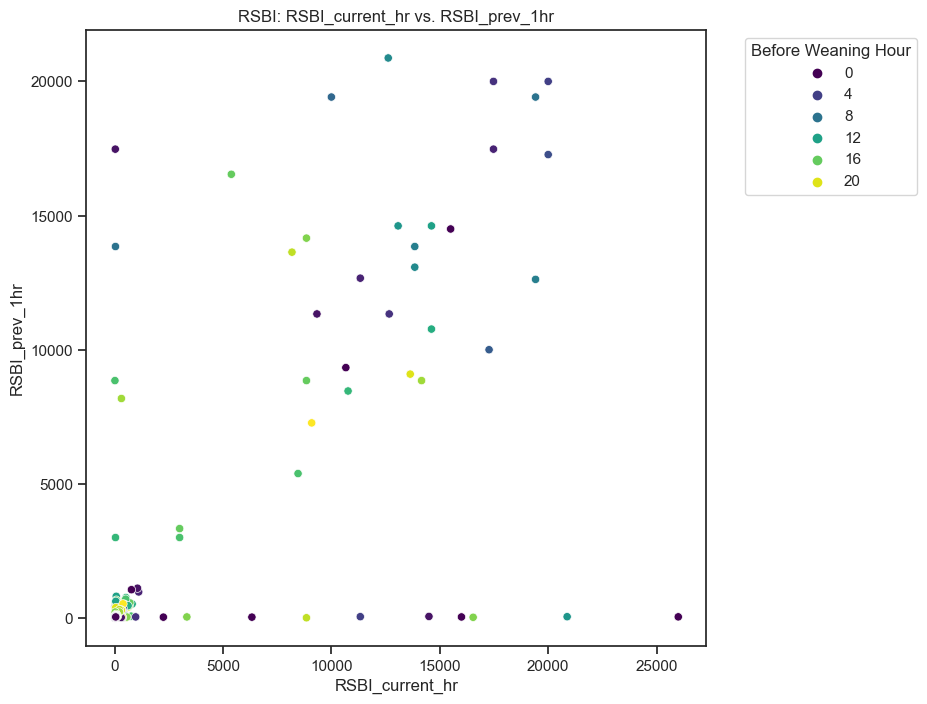

----- val -----


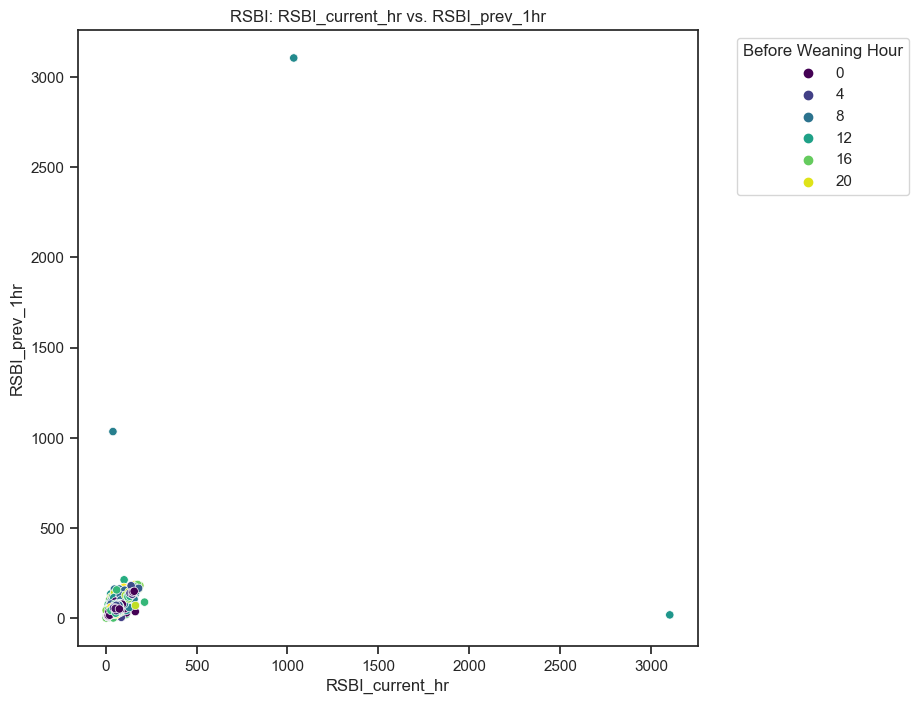

====== vitalsign: minute_ventilation =====
Training Set Mean Squared Error (MSE): 3.5295
Training Set Mean Absolute Error (MAE): 1.3134
Training Set R-squared (R2): 0.7264

Validation Set Mean Squared Error (MSE): 5.7898
Validation Set Mean Absolute Error (MAE): 1.6486
Validation Set R-squared (R2): 0.5144

----- train -----


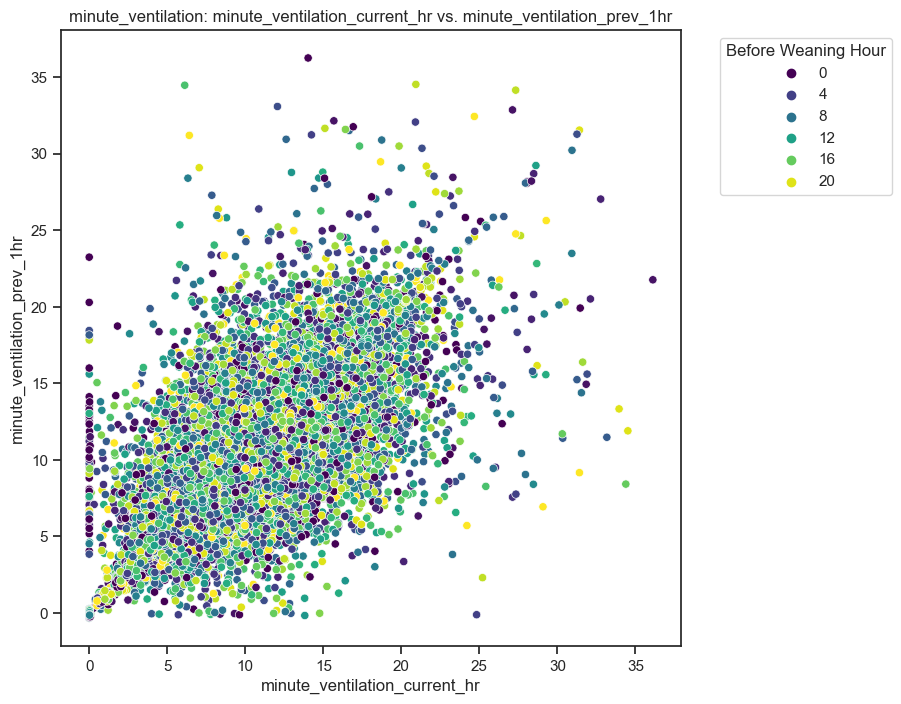

----- val -----


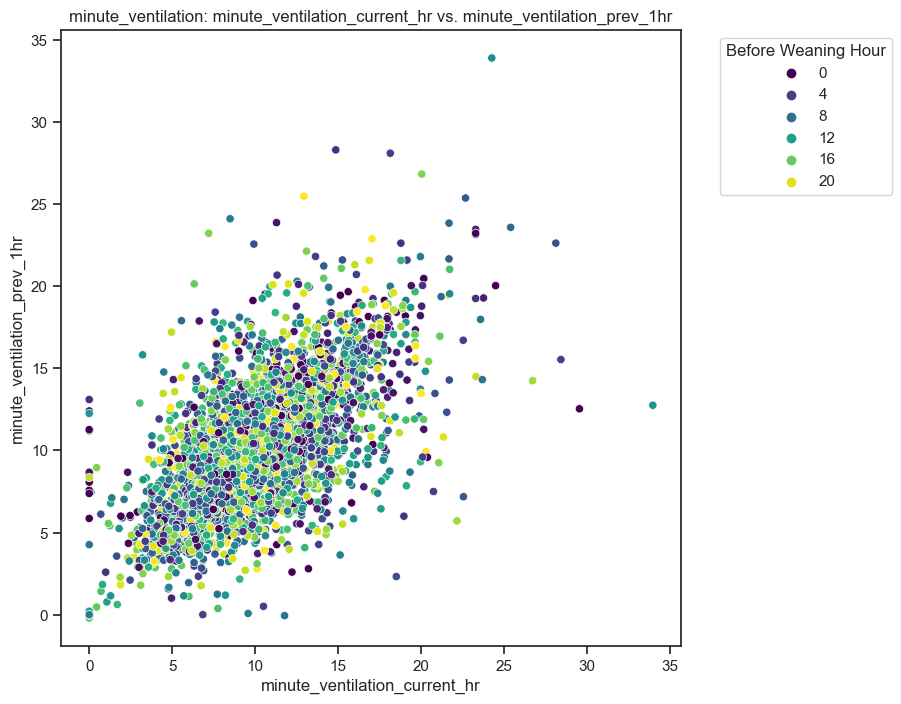

In [391]:
vitalsign = ['heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 
             'tidal_volume_observed', 'RSBI', 'minute_ventilation']
# vitalsign = ['resp_rate']
visual_mode = 2
model_B_dict = {}
for feature in vitalsign:
    print(f'====== vitalsign: {feature} =====')
    X_train, y_train, X_val, y_val = split_data(group_pre_2hr_visi_vese_train_df, group_pre_2hr_visi_vese_val_df, X_cols, feature)
    model = intuition_regression_model(X_train, y_train, X_val, y_val, feature, visual_mode)
    model_B_dict[feature] = model

#### prediction vs. ground truth

====== vitalsign: heart_rate =====


Training Set Mean Squared Error (MSE): 42.1728
Training Set Mean Absolute Error (MAE): 4.5011
Training Set R-squared (R2): 0.8739

Validation Set Mean Squared Error (MSE): 76.9344
Validation Set Mean Absolute Error (MAE): 5.7369
Validation Set R-squared (R2): 0.7515

----- train -----


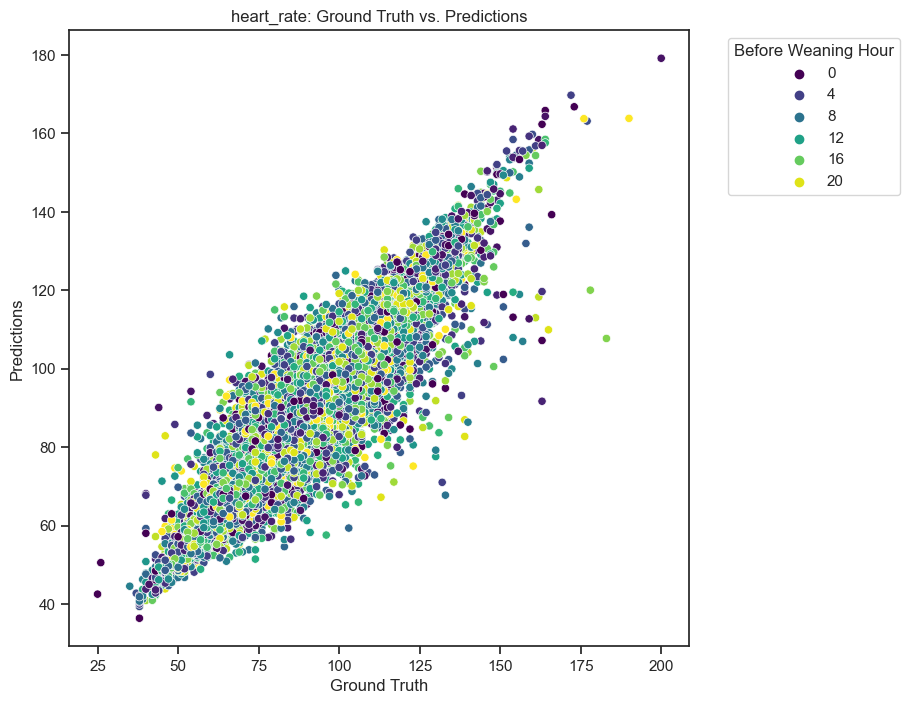

----- val -----


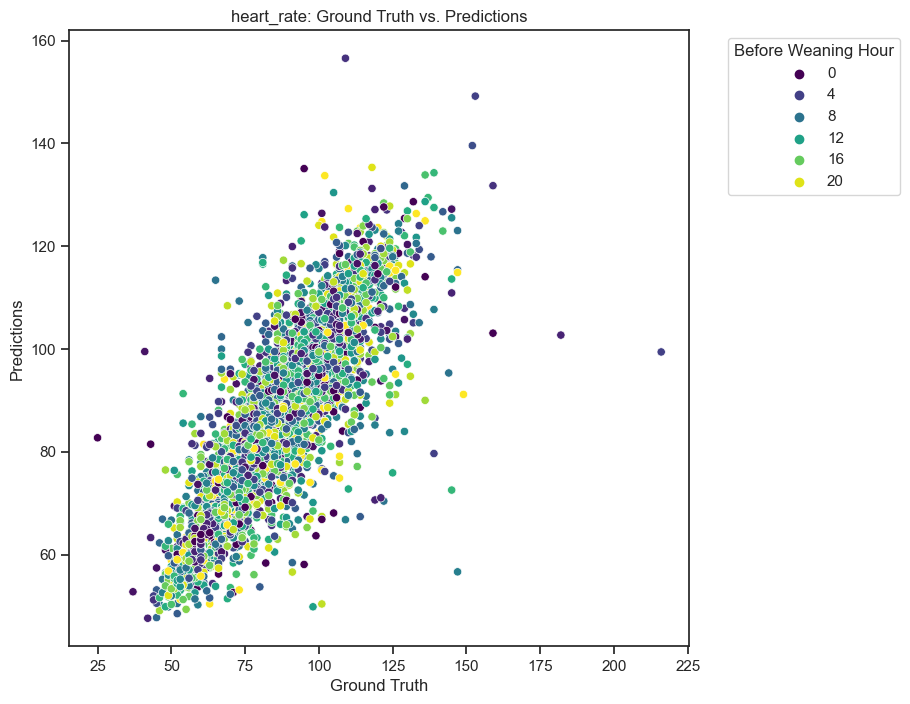

====== vitalsign: sbp =====
Training Set Mean Squared Error (MSE): 142.6734
Training Set Mean Absolute Error (MAE): 8.8094
Training Set R-squared (R2): 0.7239

Validation Set Mean Squared Error (MSE): 233.7963
Validation Set Mean Absolute Error (MAE): 11.0947
Validation Set R-squared (R2): 0.5430

----- train -----


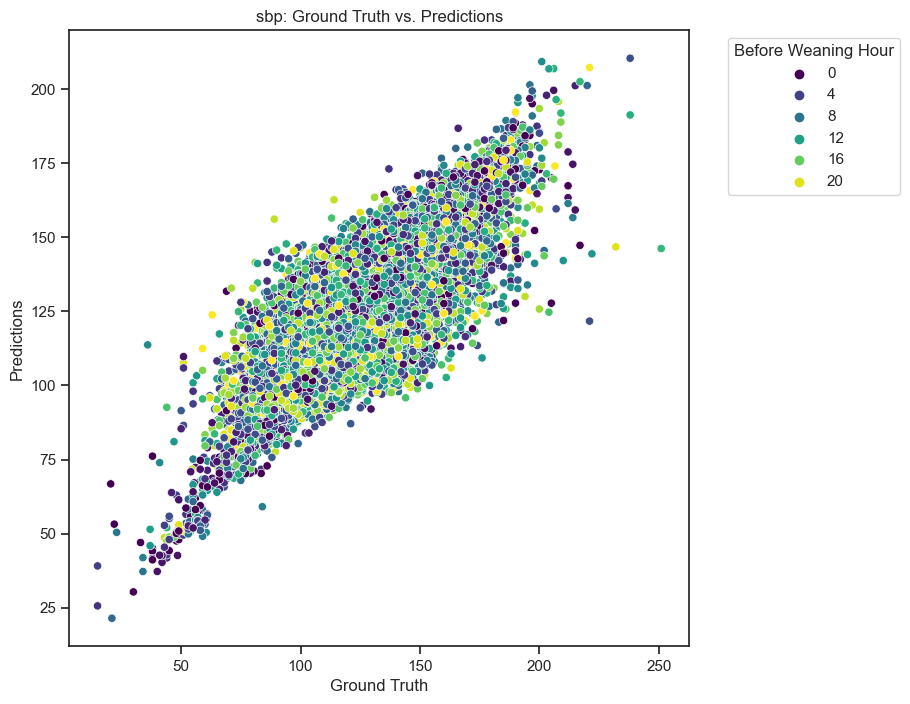

----- val -----


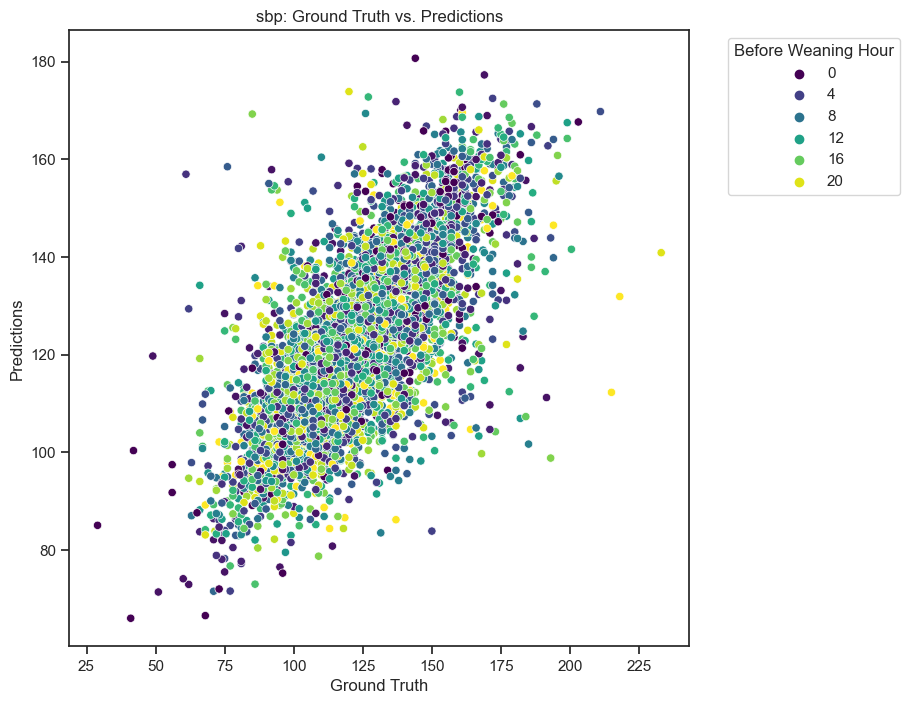

====== vitalsign: dbp =====
Training Set Mean Squared Error (MSE): 53.3186
Training Set Mean Absolute Error (MAE): 5.1834
Training Set R-squared (R2): 0.7307

Validation Set Mean Squared Error (MSE): 85.0813
Validation Set Mean Absolute Error (MAE): 6.4485
Validation Set R-squared (R2): 0.5655

----- train -----


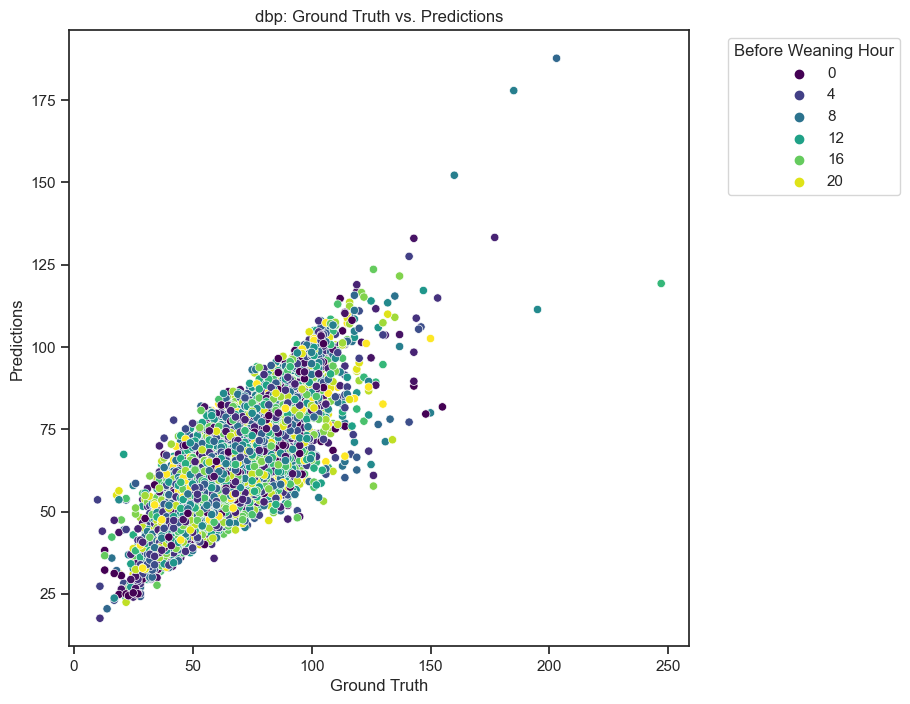

----- val -----


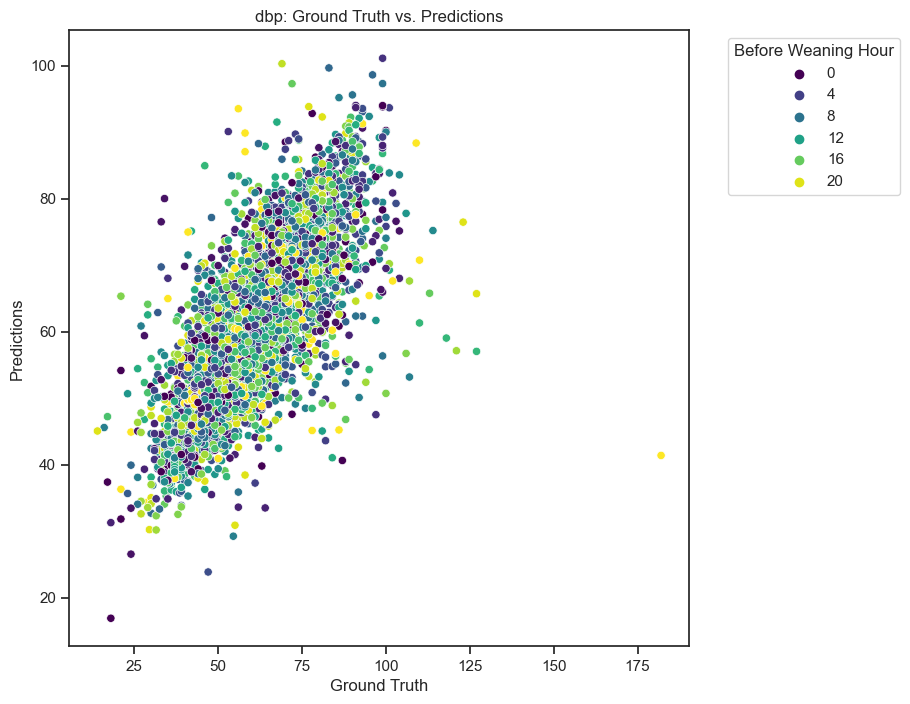

====== vitalsign: mbp =====
Training Set Mean Squared Error (MSE): 74.2376
Training Set Mean Absolute Error (MAE): 6.1464
Training Set R-squared (R2): 0.7052

Validation Set Mean Squared Error (MSE): 118.0081
Validation Set Mean Absolute Error (MAE): 7.6424
Validation Set R-squared (R2): 0.5134

----- train -----


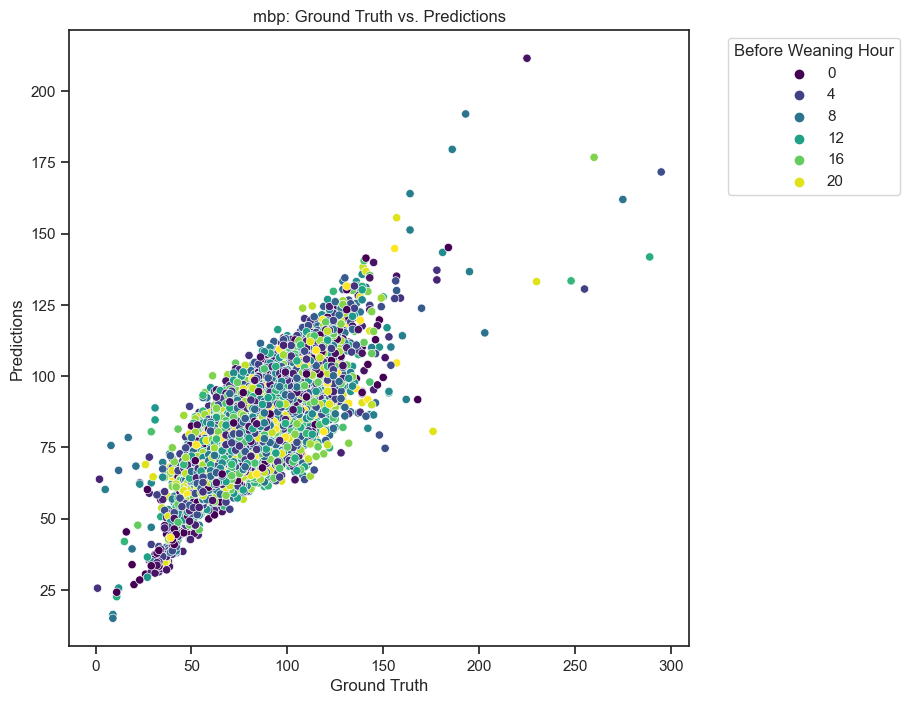

----- val -----


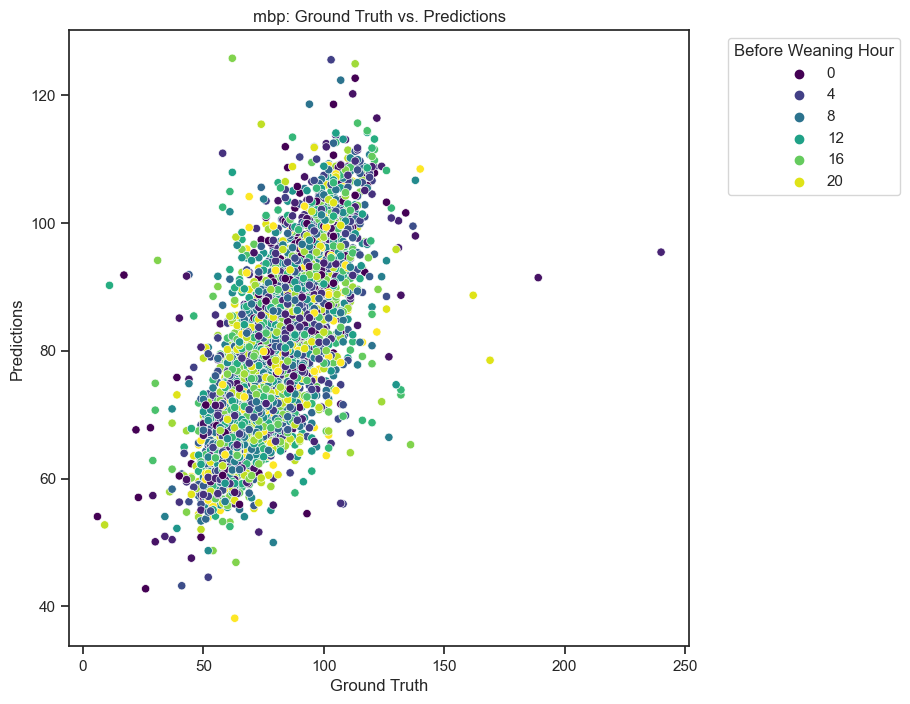

====== vitalsign: spo2 =====
Training Set Mean Squared Error (MSE): 2.1788
Training Set Mean Absolute Error (MAE): 0.9958
Training Set R-squared (R2): 0.8171

Validation Set Mean Squared Error (MSE): 5.6682
Validation Set Mean Absolute Error (MAE): 1.2926
Validation Set R-squared (R2): 0.3370

----- train -----


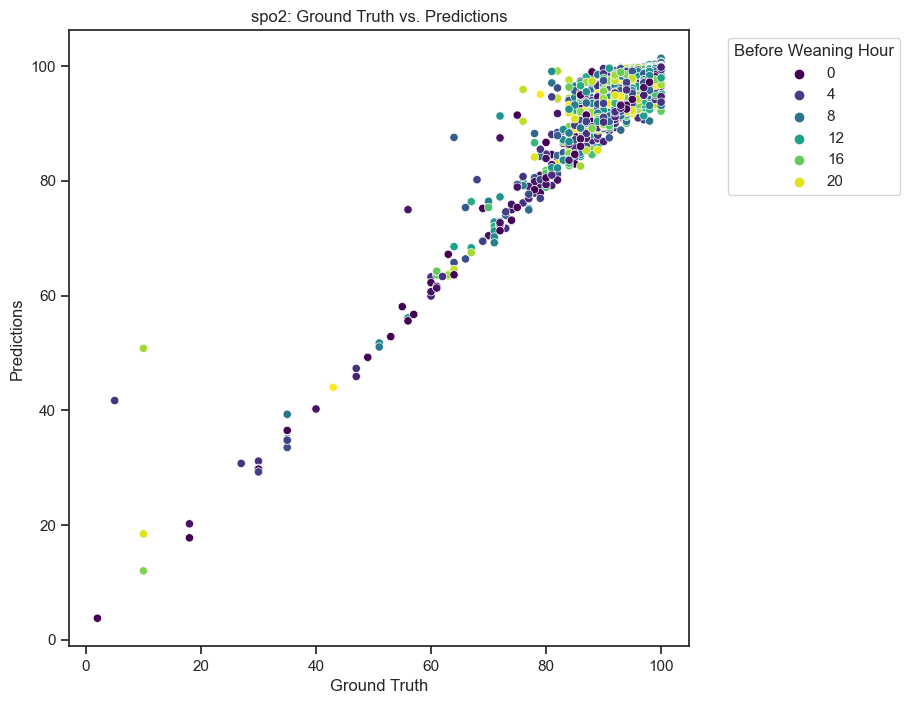

----- val -----


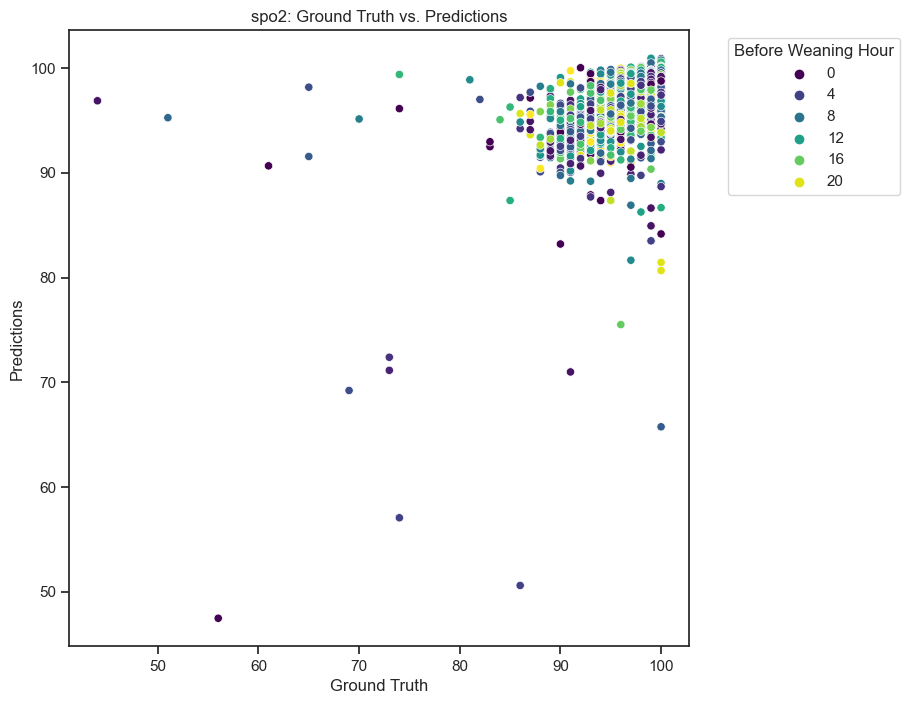

====== vitalsign: resp_rate =====
Training Set Mean Squared Error (MSE): 10.9982
Training Set Mean Absolute Error (MAE): 2.3741
Training Set R-squared (R2): 0.7129

Validation Set Mean Squared Error (MSE): 17.7770
Validation Set Mean Absolute Error (MAE): 3.0236
Validation Set R-squared (R2): 0.5312

----- train -----


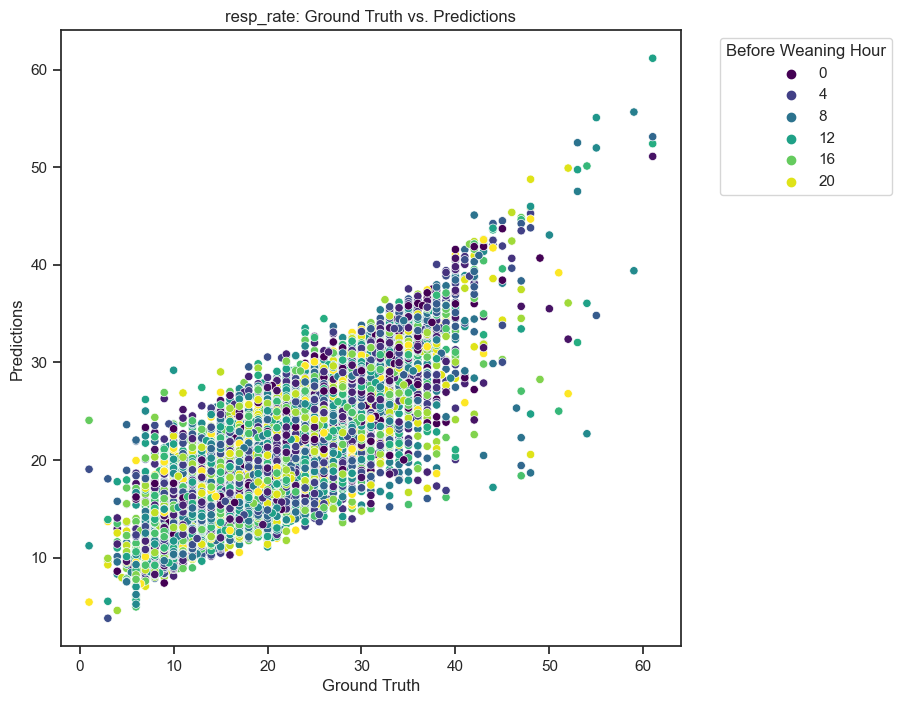

----- val -----


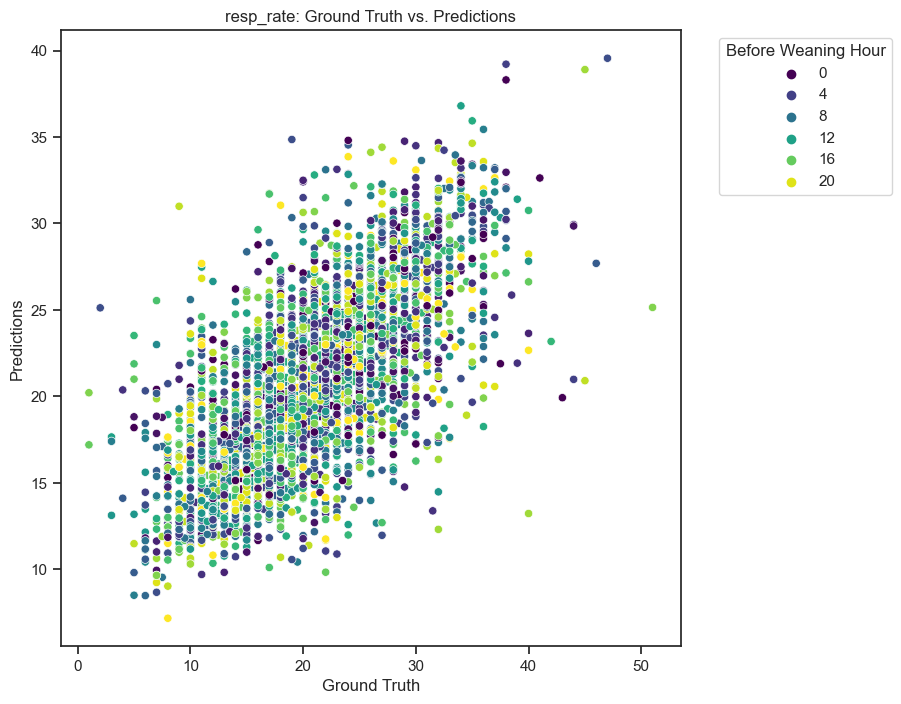

====== vitalsign: tidal_volume_observed =====
Training Set Mean Squared Error (MSE): 2220.6356
Training Set Mean Absolute Error (MAE): 22.3453
Training Set R-squared (R2): 0.8954

Validation Set Mean Squared Error (MSE): 4401.2470
Validation Set Mean Absolute Error (MAE): 30.8253
Validation Set R-squared (R2): 0.7996

----- train -----


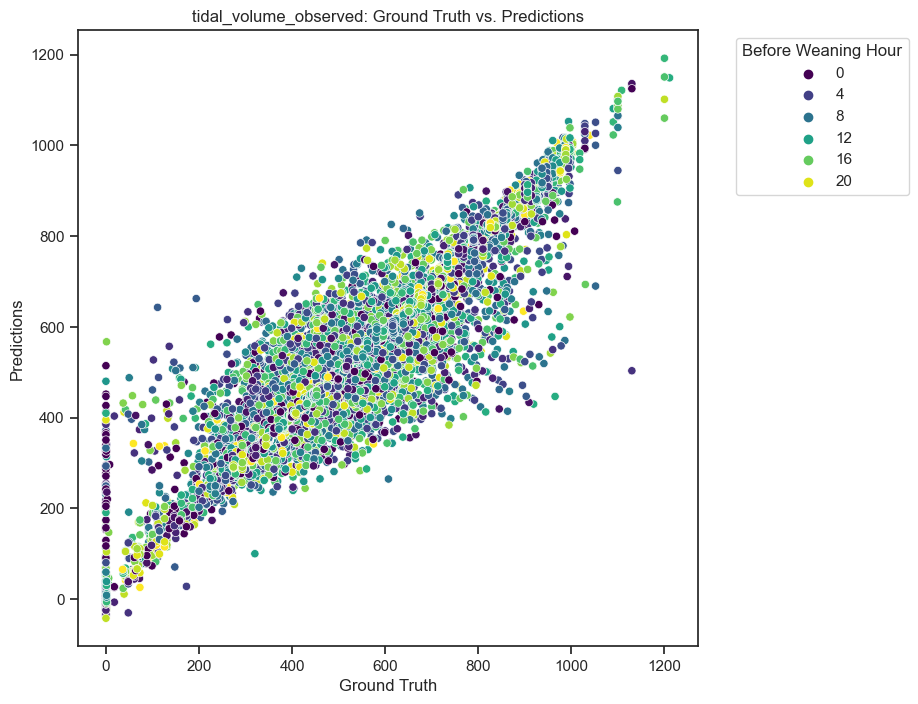

----- val -----


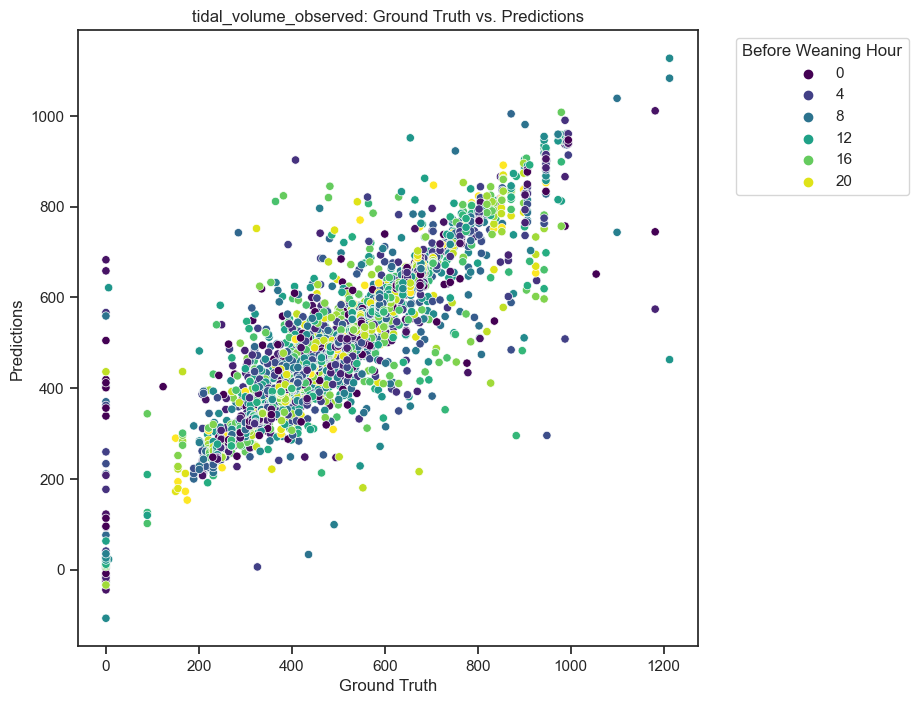

====== vitalsign: RSBI =====
Training Set Mean Squared Error (MSE): 421.7116
Training Set Mean Absolute Error (MAE): 9.0155
Training Set R-squared (R2): 0.9977

Validation Set Mean Squared Error (MSE): 12856.5155
Validation Set Mean Absolute Error (MAE): 16.7231
Validation Set R-squared (R2): -4.7863

----- train -----


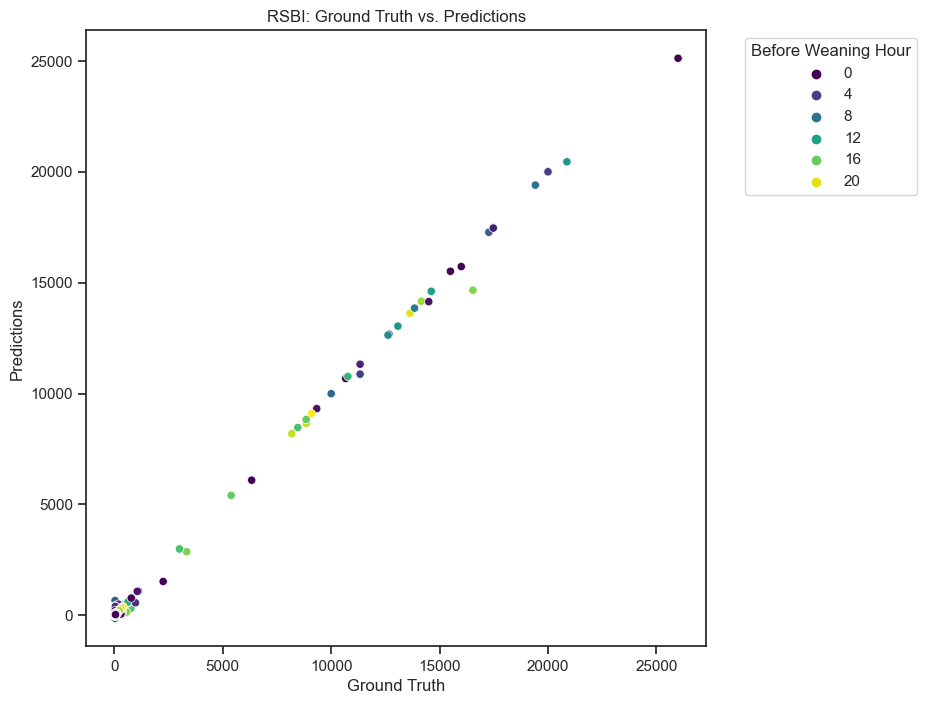

----- val -----


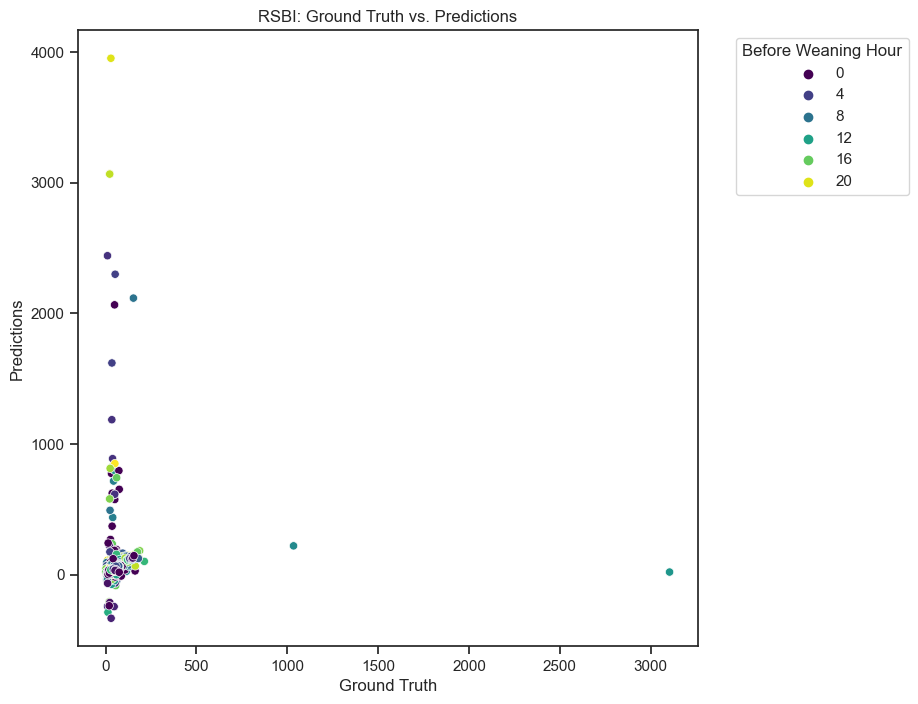

====== vitalsign: minute_ventilation =====
Training Set Mean Squared Error (MSE): 3.5295
Training Set Mean Absolute Error (MAE): 1.3134
Training Set R-squared (R2): 0.7264

Validation Set Mean Squared Error (MSE): 5.7898
Validation Set Mean Absolute Error (MAE): 1.6486
Validation Set R-squared (R2): 0.5144

----- train -----


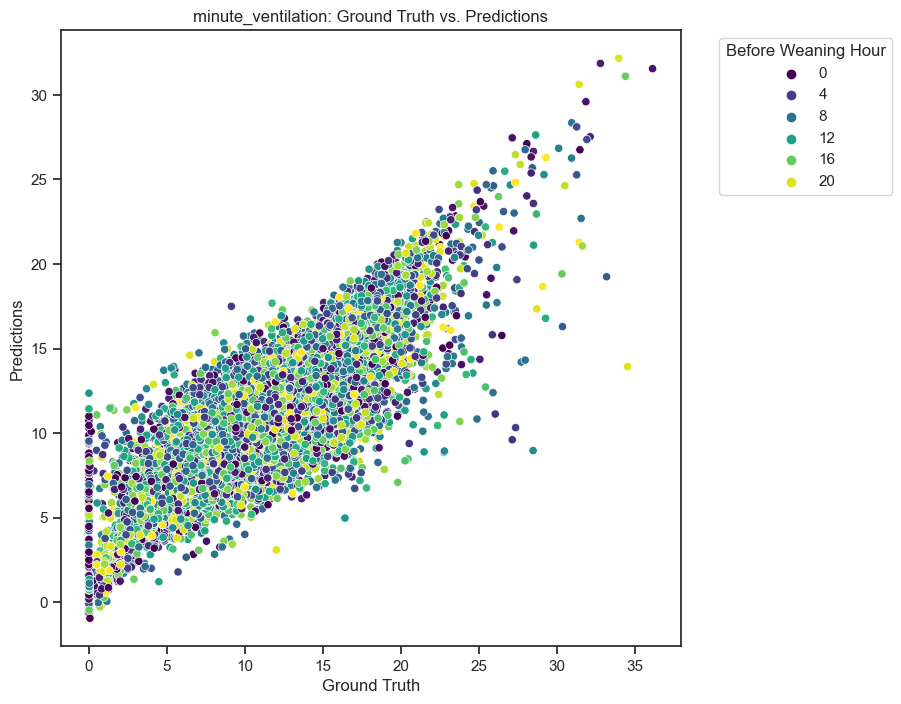

----- val -----


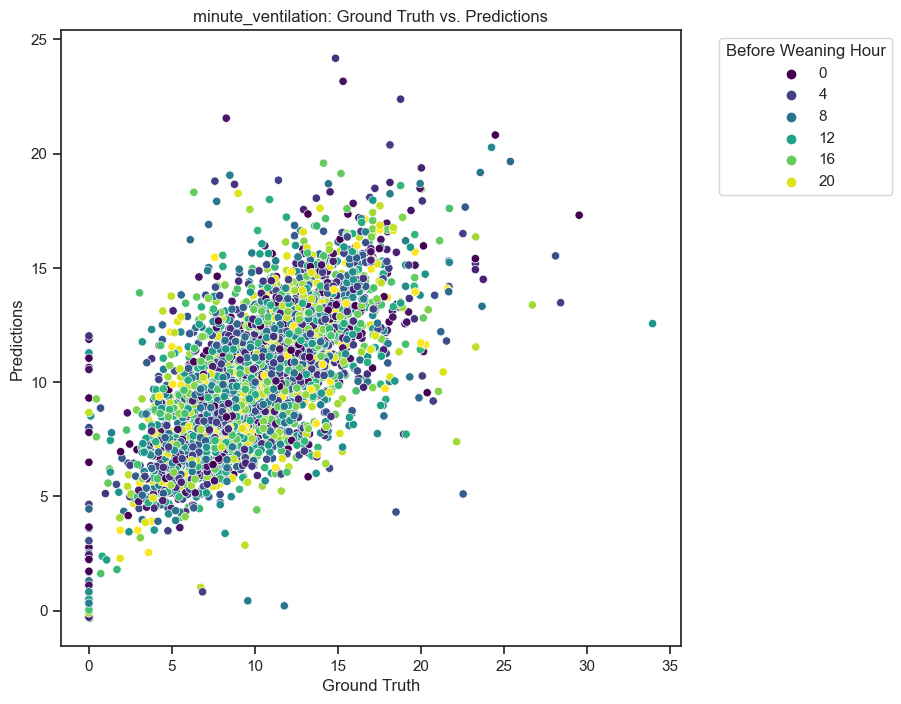

In [392]:
vitalsign = ['heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 
             'tidal_volume_observed', 'RSBI', 'minute_ventilation']
# vitalsign = ['resp_rate']
visual_mode = 3
model_B_dict = {}
for feature in vitalsign:
    print(f'====== vitalsign: {feature} =====')
    X_train, y_train, X_val, y_val = split_data(group_pre_2hr_visi_vese_train_df, group_pre_2hr_visi_vese_val_df, X_cols, feature)
    model = intuition_regression_model(X_train, y_train, X_val, y_val, feature, visual_mode)
    model_B_dict[feature] = model

## Model B Inference

In [565]:
def model_B_inference(test_change_label_value_aug_df, model_B_dict, feature, feature_columns, prefix):
    regressor = model_B_dict[feature]
    regression_predictions = regressor.predict(test_change_label_value_aug_df[feature_columns])
    
    print_regression_metrics(test_change_label_value_aug_df[feature], regression_predictions, prefix)
    visualize_predict_ground_truth(test_change_label_value_aug_df, test_change_label_value_aug_df[feature], regression_predictions, feature, visual_mode=4, title=prefix)

===== feature: heart_rate =====
train set Mean Squared Error (MSE): 42.1728
train set Mean Absolute Error (MAE): 4.5011
train set R-squared (R2): 0.8739



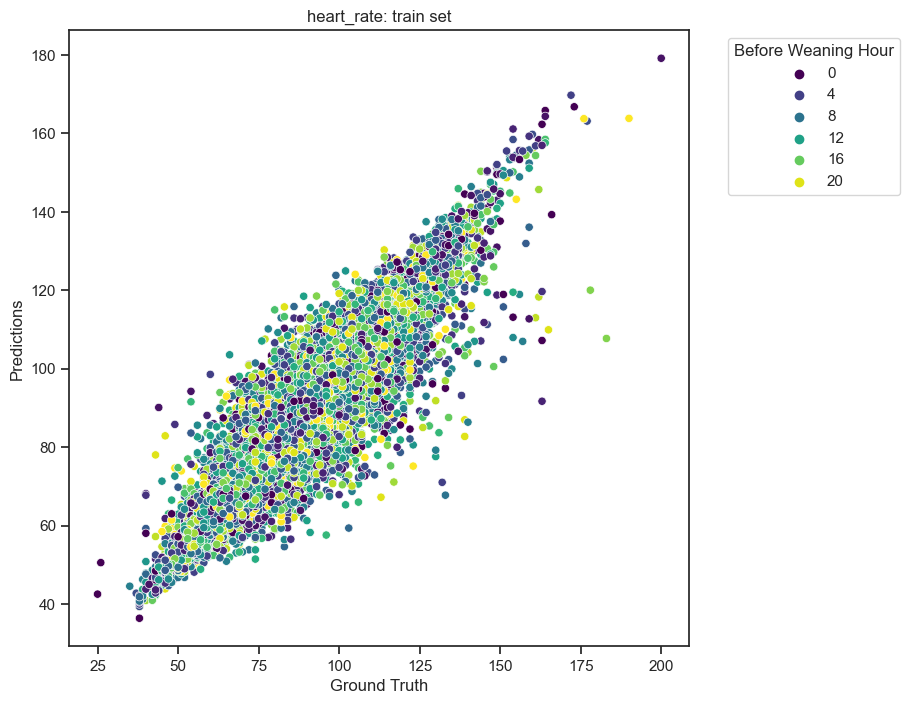

val set Mean Squared Error (MSE): 76.9344
val set Mean Absolute Error (MAE): 5.7369
val set R-squared (R2): 0.7515



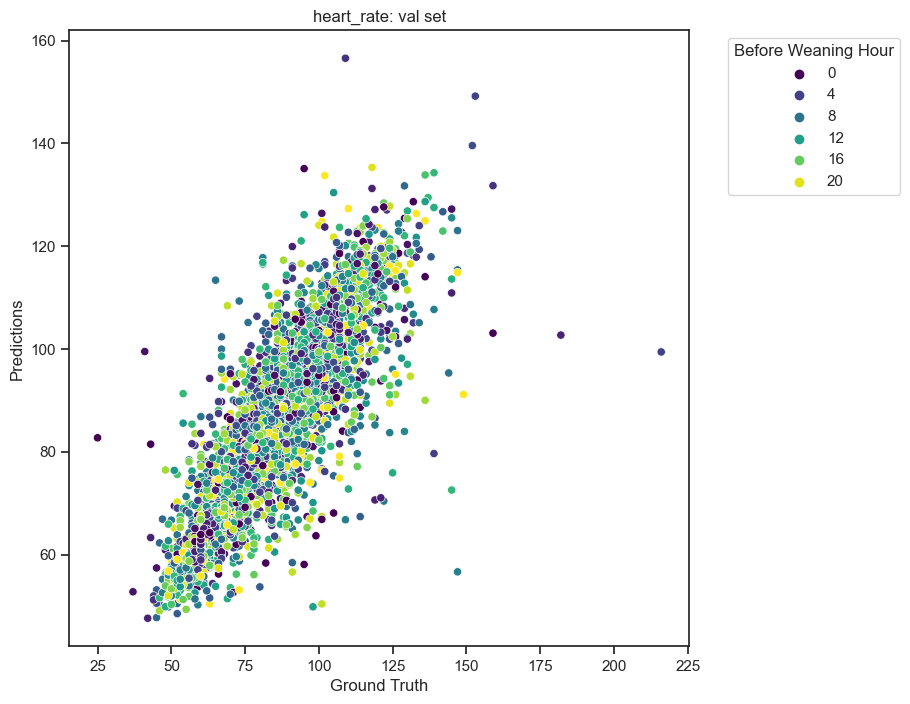

test set Mean Squared Error (MSE): 76.4790
test set Mean Absolute Error (MAE): 5.7885
test set R-squared (R2): 0.7753



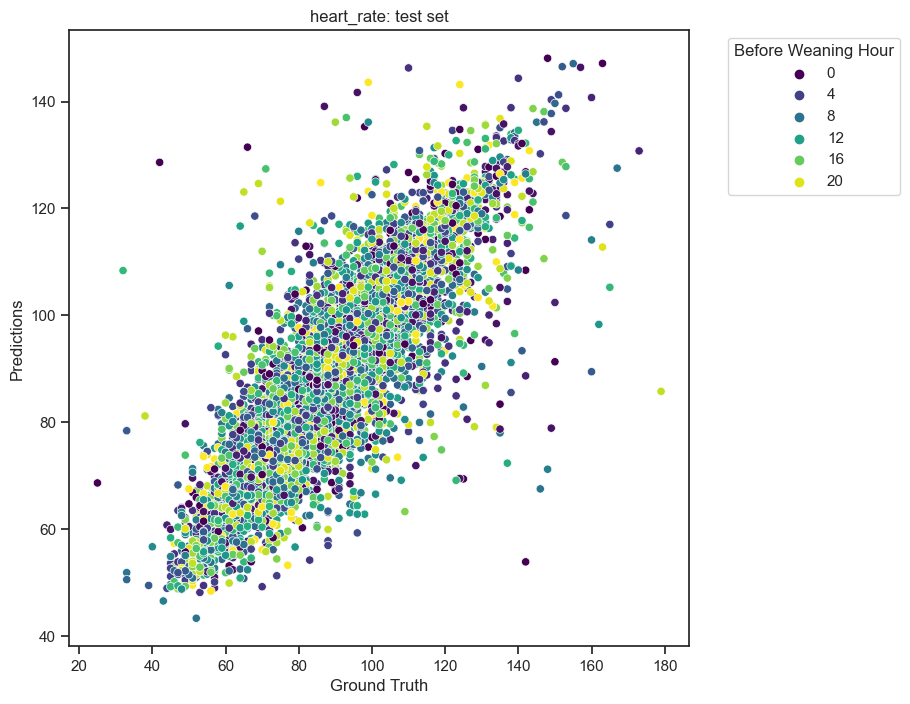

===== feature: sbp =====
train set Mean Squared Error (MSE): 142.6734
train set Mean Absolute Error (MAE): 8.8094
train set R-squared (R2): 0.7239



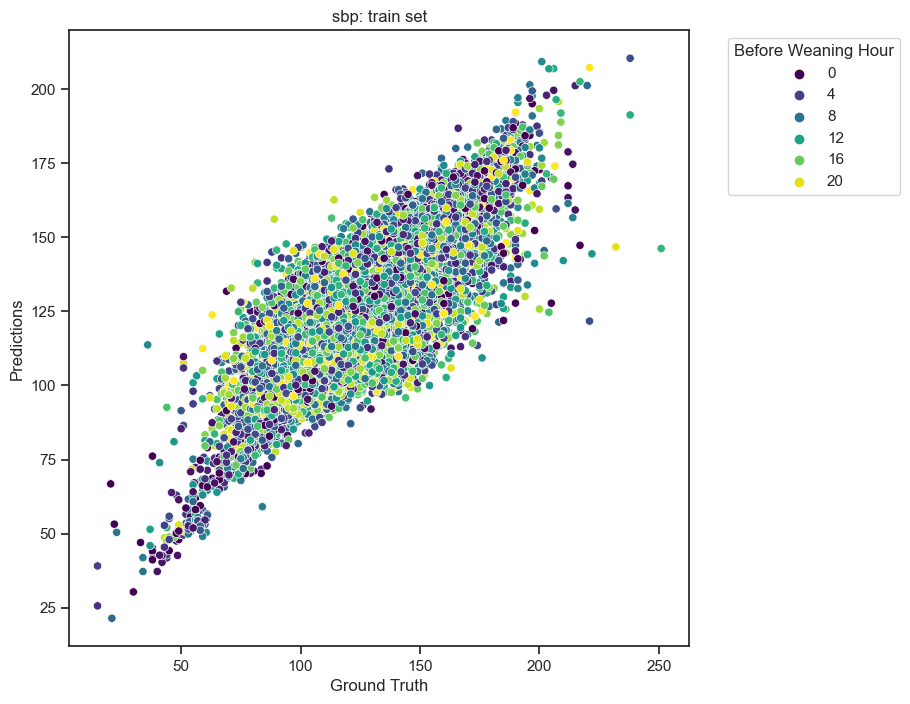

val set Mean Squared Error (MSE): 233.7963
val set Mean Absolute Error (MAE): 11.0947
val set R-squared (R2): 0.5430



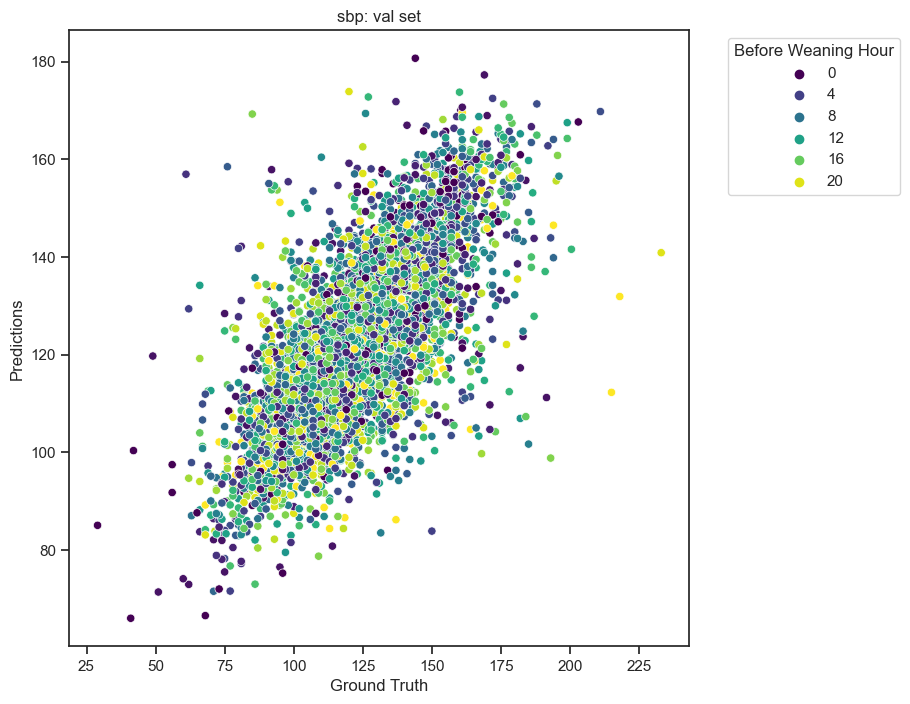

test set Mean Squared Error (MSE): 234.6639
test set Mean Absolute Error (MAE): 11.2435
test set R-squared (R2): 0.5277



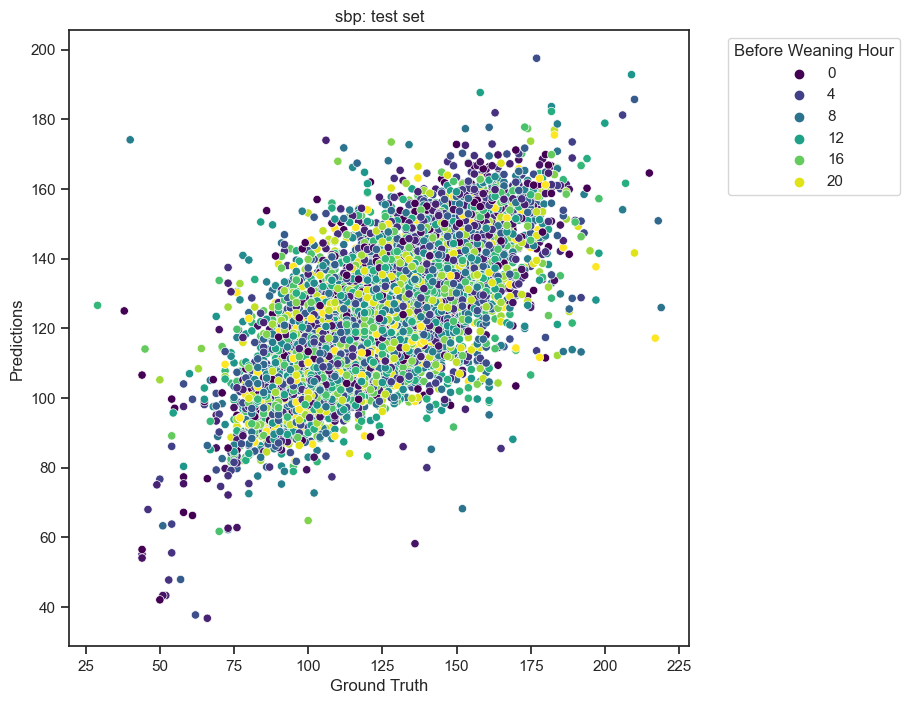

===== feature: dbp =====
train set Mean Squared Error (MSE): 53.3186
train set Mean Absolute Error (MAE): 5.1834
train set R-squared (R2): 0.7307



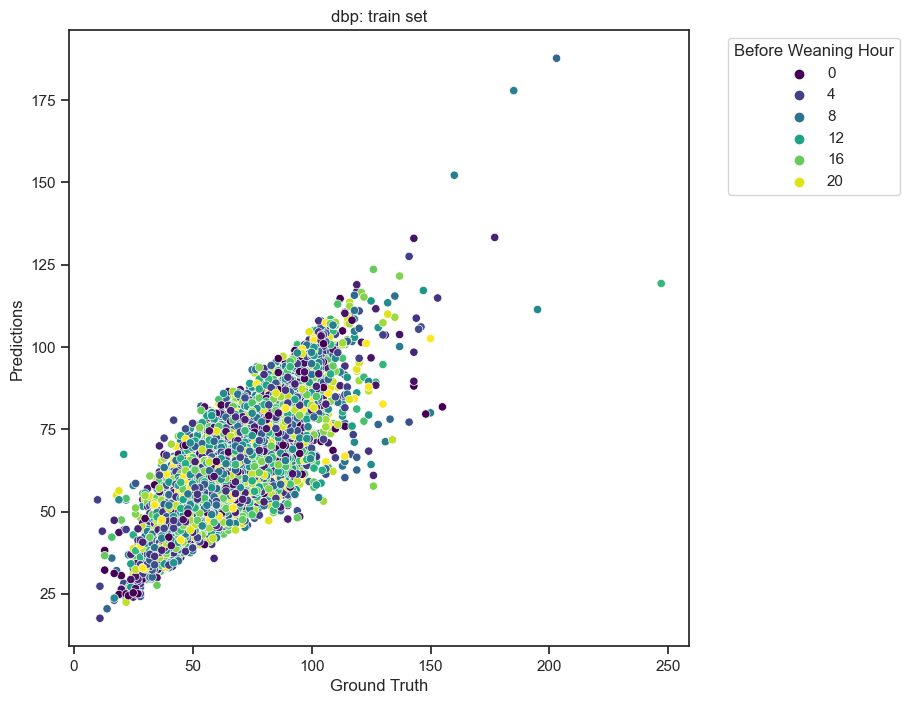

val set Mean Squared Error (MSE): 85.0813
val set Mean Absolute Error (MAE): 6.4485
val set R-squared (R2): 0.5655



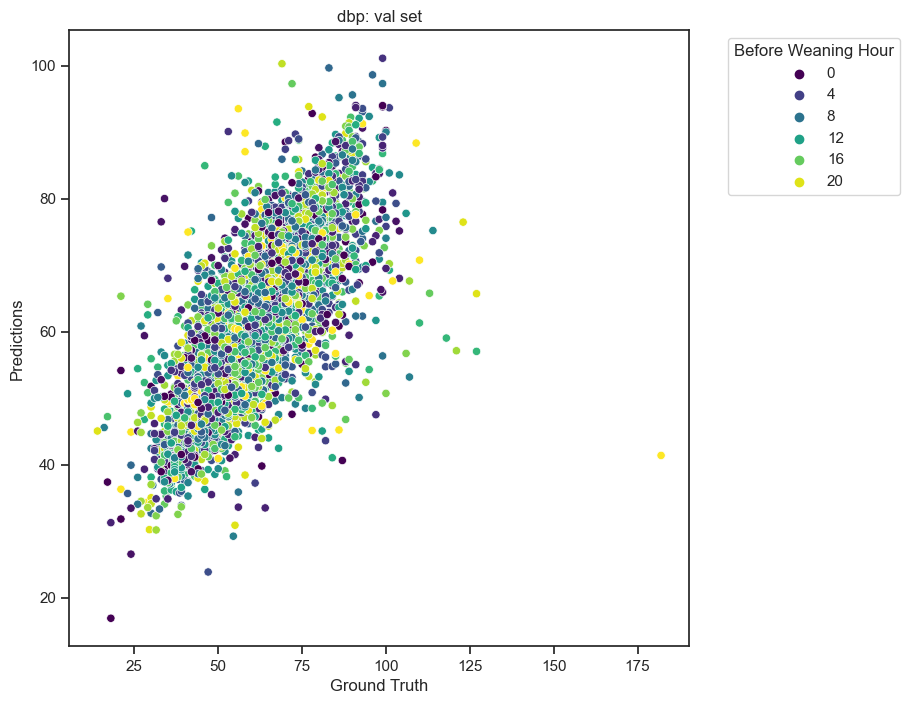

test set Mean Squared Error (MSE): 90.7715
test set Mean Absolute Error (MAE): 6.5847
test set R-squared (R2): 0.5305



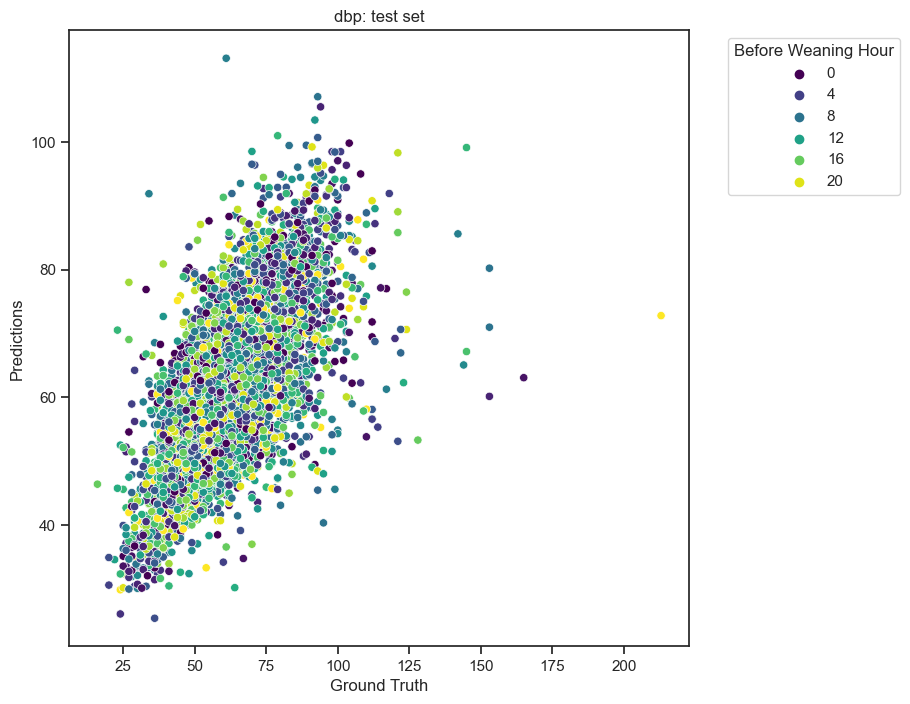

===== feature: mbp =====
train set Mean Squared Error (MSE): 74.2376
train set Mean Absolute Error (MAE): 6.1464
train set R-squared (R2): 0.7052



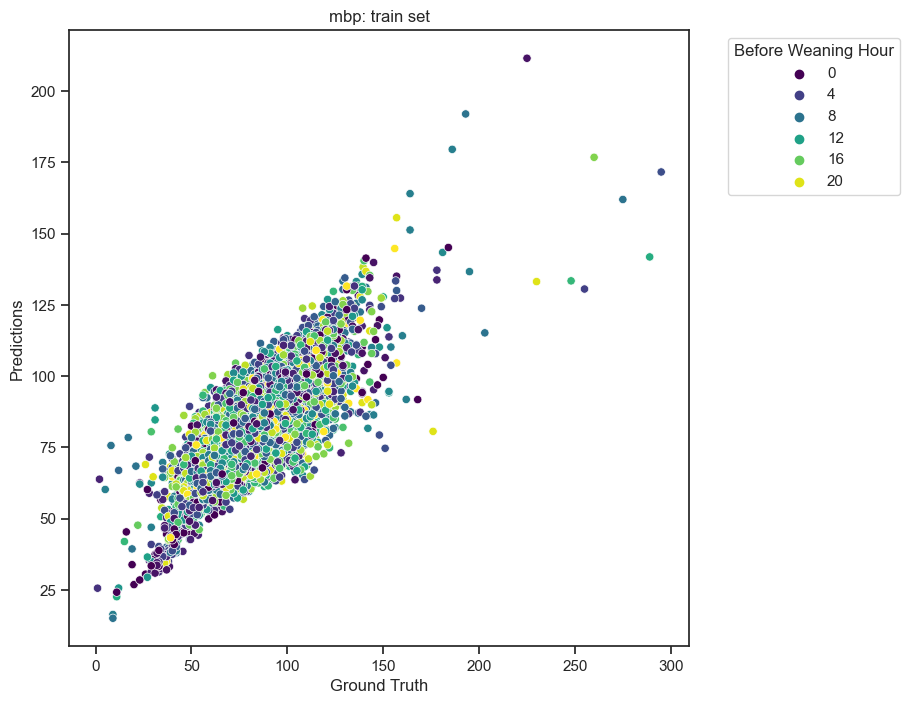

val set Mean Squared Error (MSE): 118.0081
val set Mean Absolute Error (MAE): 7.6424
val set R-squared (R2): 0.5134



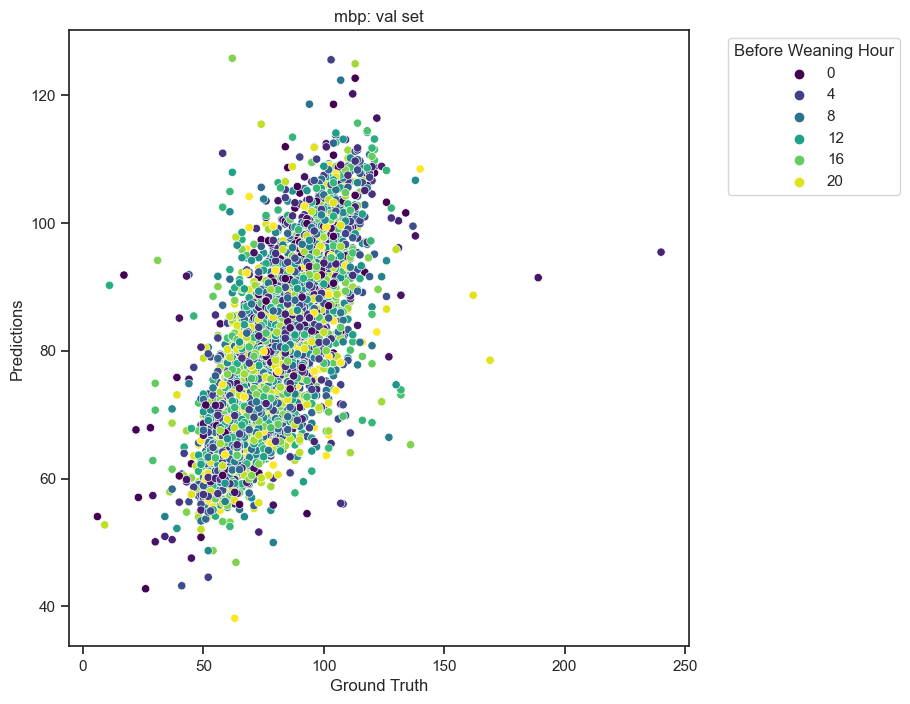

test set Mean Squared Error (MSE): 151.4652
test set Mean Absolute Error (MAE): 8.0427
test set R-squared (R2): 0.4280



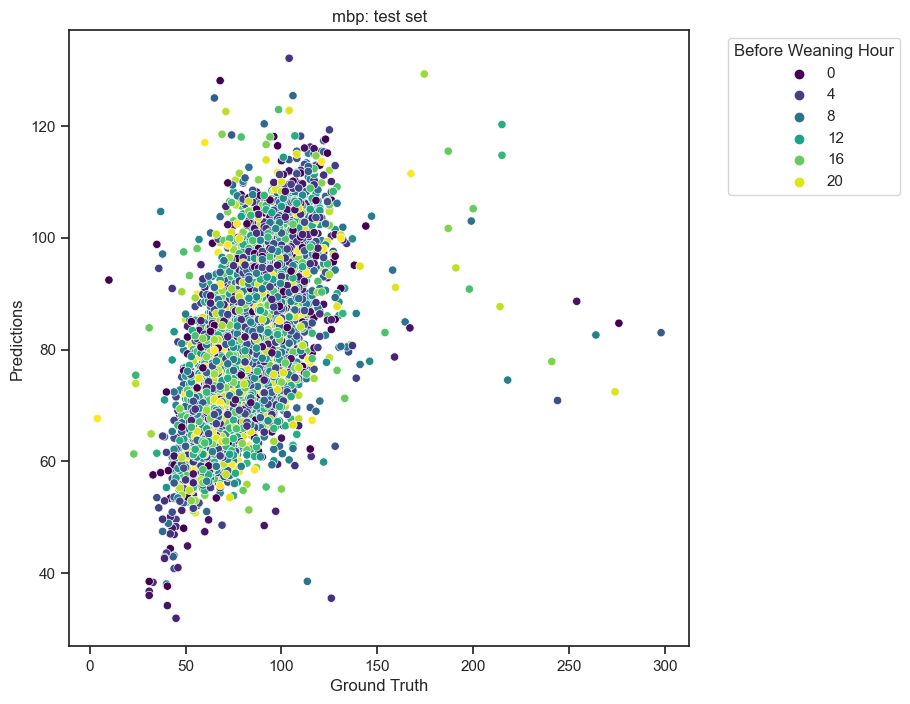

===== feature: spo2 =====
train set Mean Squared Error (MSE): 2.1788
train set Mean Absolute Error (MAE): 0.9958
train set R-squared (R2): 0.8171



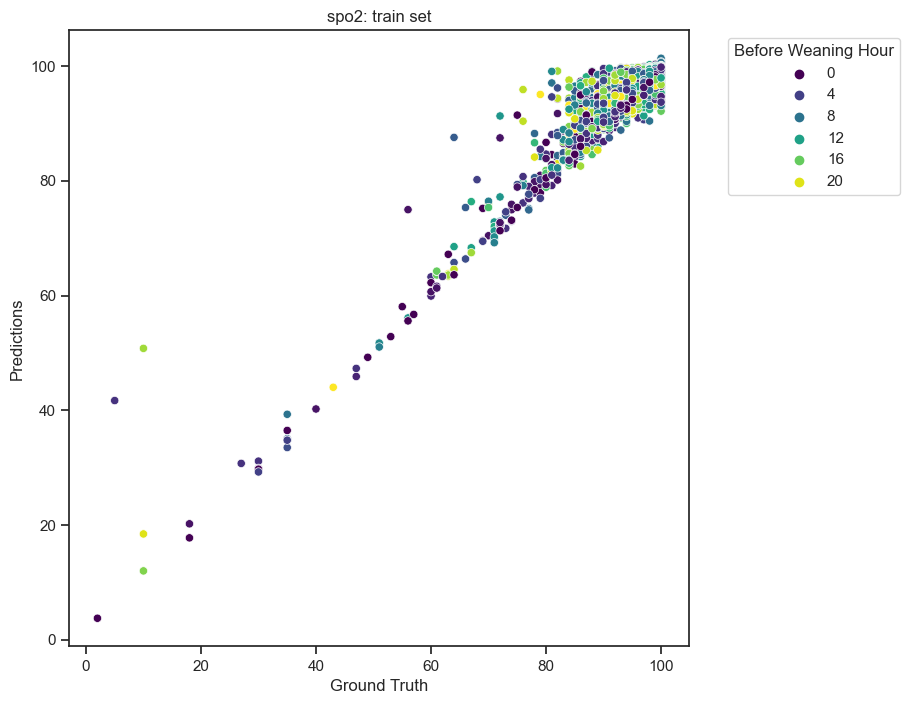

val set Mean Squared Error (MSE): 5.6682
val set Mean Absolute Error (MAE): 1.2926
val set R-squared (R2): 0.3370



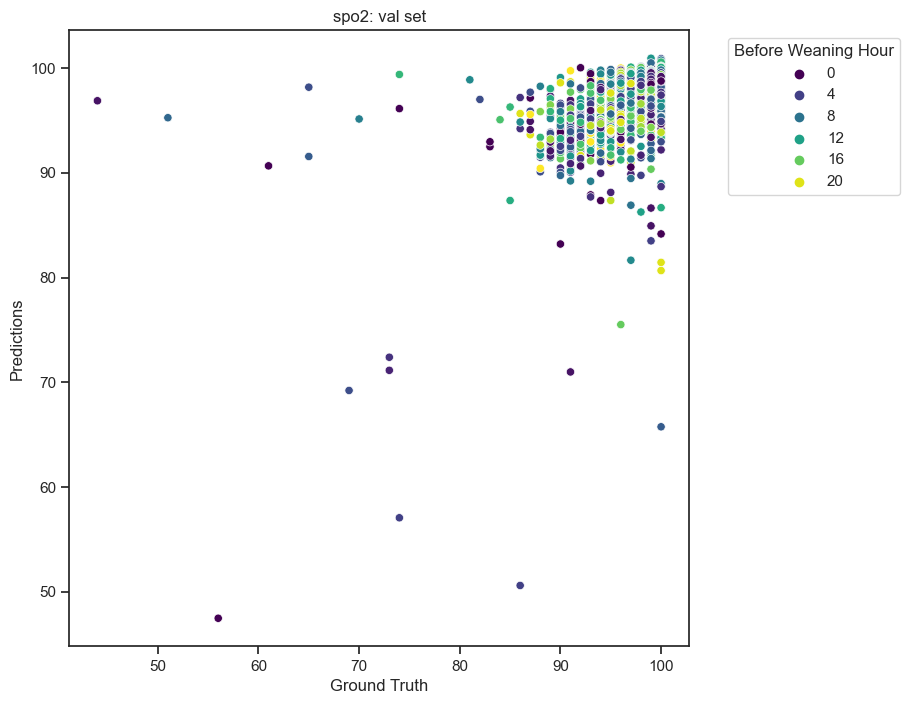

test set Mean Squared Error (MSE): 6.4564
test set Mean Absolute Error (MAE): 1.3177
test set R-squared (R2): 0.4010



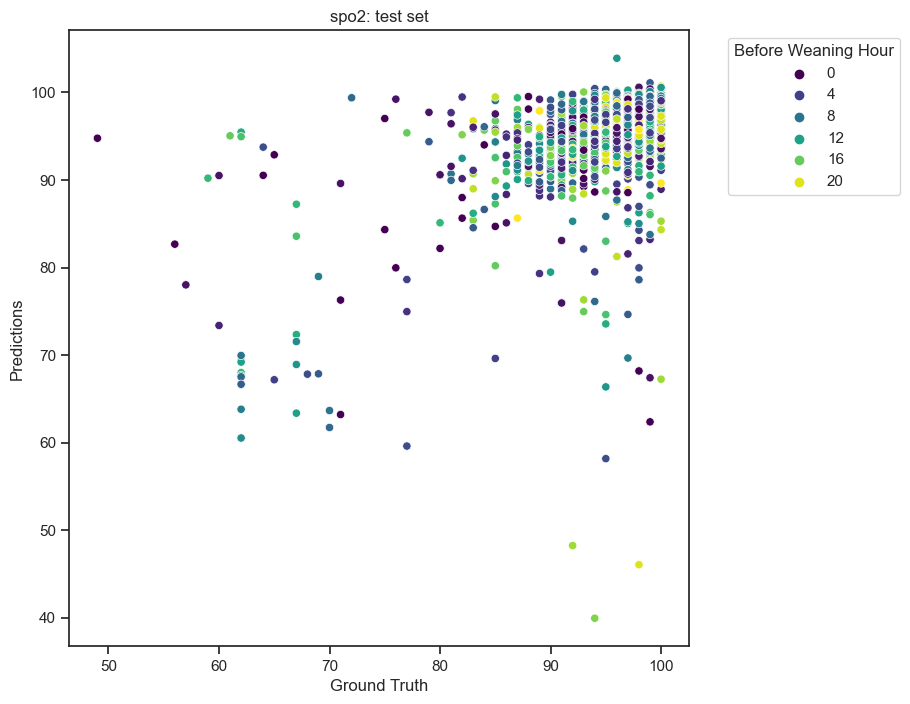

===== feature: resp_rate =====
train set Mean Squared Error (MSE): 10.9982
train set Mean Absolute Error (MAE): 2.3741
train set R-squared (R2): 0.7129



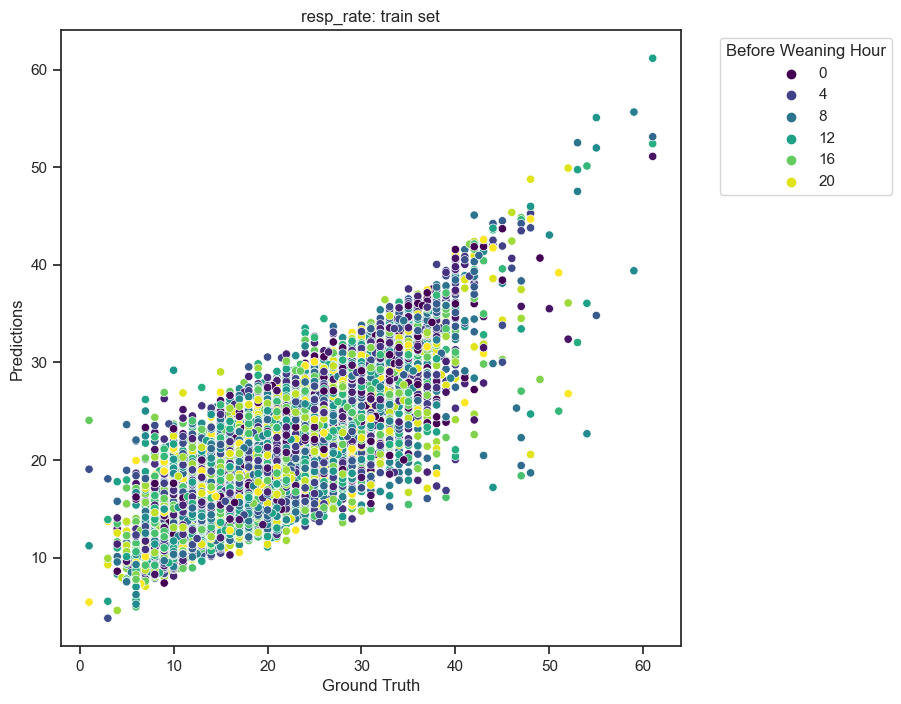

val set Mean Squared Error (MSE): 17.7770
val set Mean Absolute Error (MAE): 3.0236
val set R-squared (R2): 0.5312



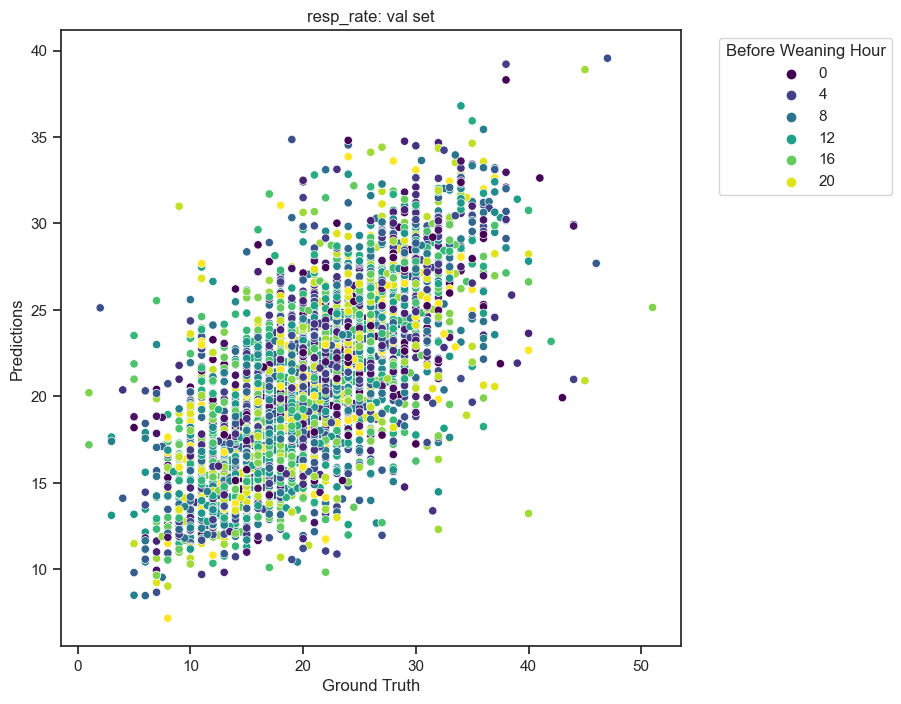

test set Mean Squared Error (MSE): 18.4247
test set Mean Absolute Error (MAE): 3.0715
test set R-squared (R2): 0.5127



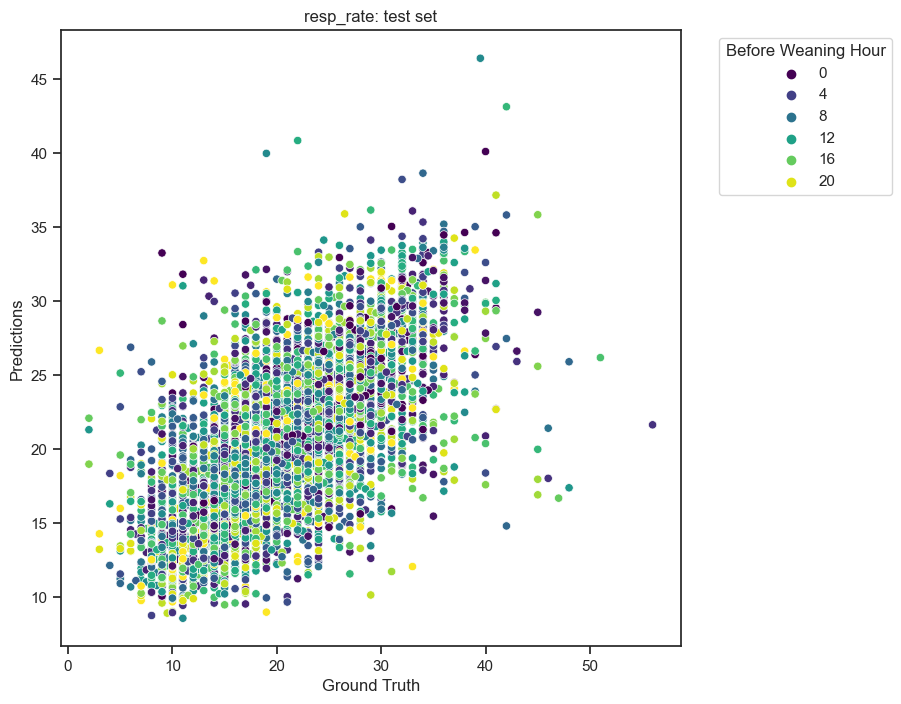

===== feature: tidal_volume_observed =====
train set Mean Squared Error (MSE): 2220.6356
train set Mean Absolute Error (MAE): 22.3453
train set R-squared (R2): 0.8954



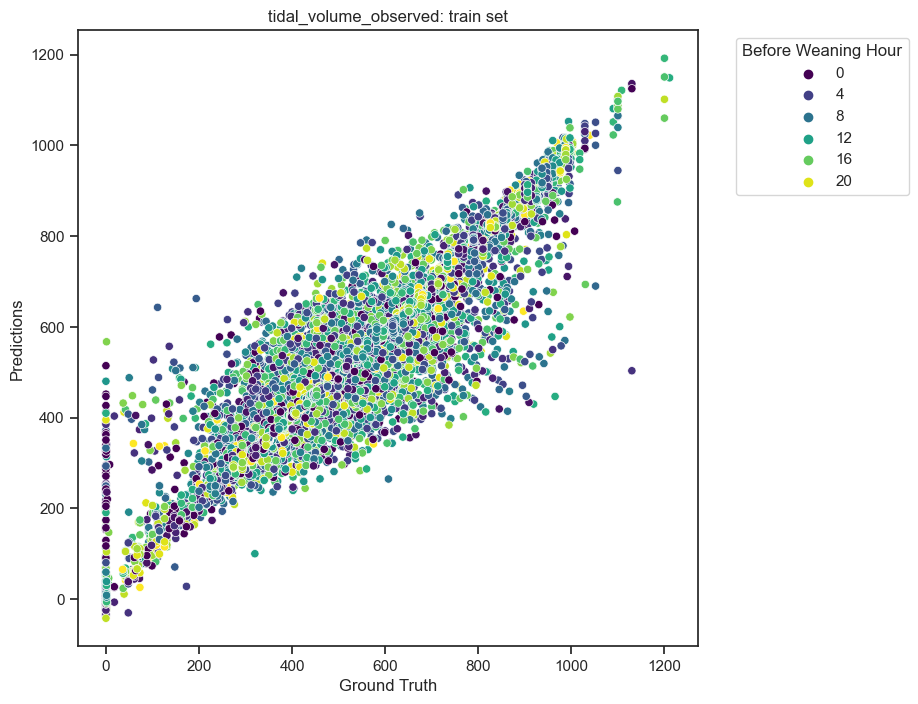

val set Mean Squared Error (MSE): 4401.2470
val set Mean Absolute Error (MAE): 30.8253
val set R-squared (R2): 0.7996



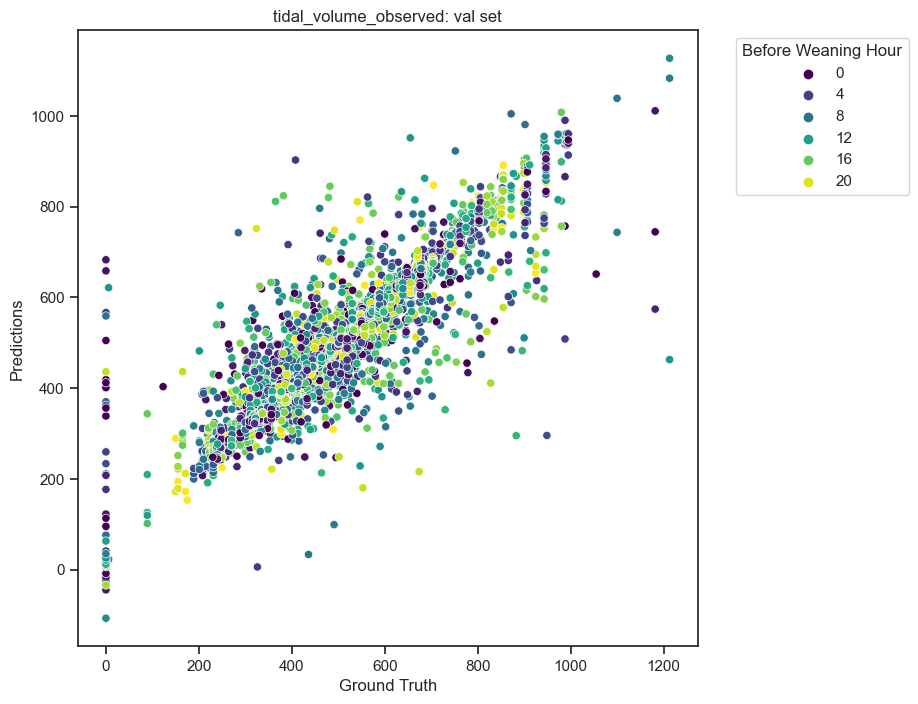

test set Mean Squared Error (MSE): 5116.7231
test set Mean Absolute Error (MAE): 33.0946
test set R-squared (R2): 0.7752



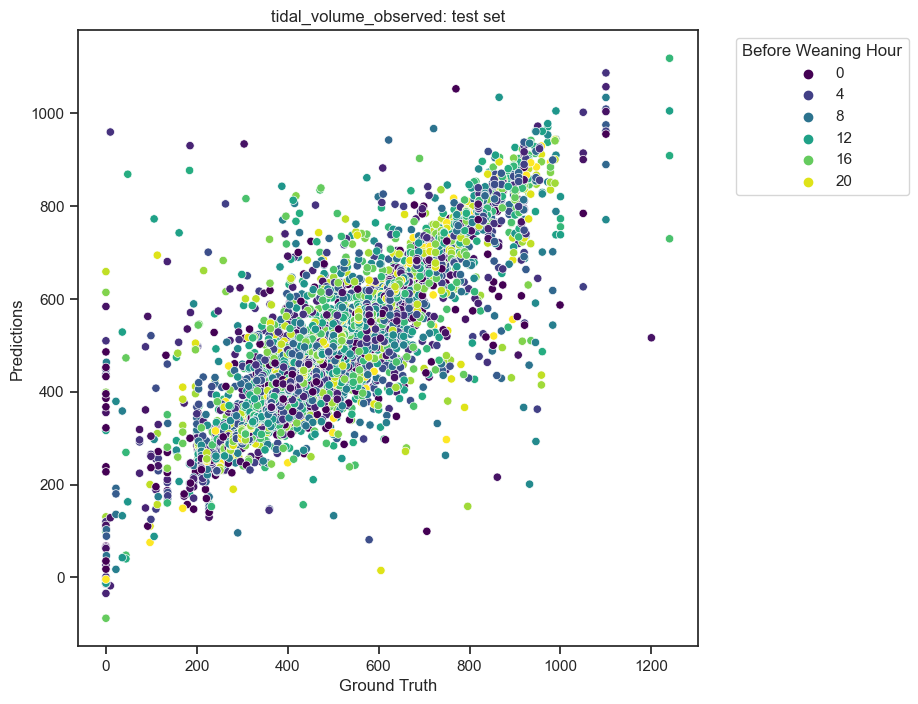

===== feature: RSBI =====
train set Mean Squared Error (MSE): 421.7116
train set Mean Absolute Error (MAE): 9.0155
train set R-squared (R2): 0.9977



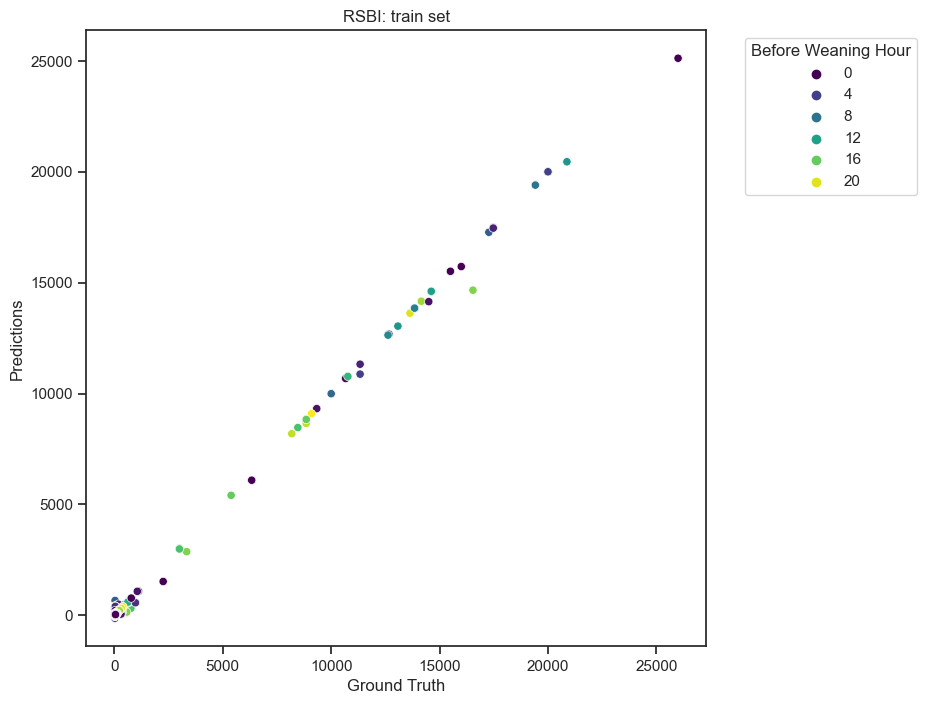

val set Mean Squared Error (MSE): 12856.5155
val set Mean Absolute Error (MAE): 16.7231
val set R-squared (R2): -4.7863



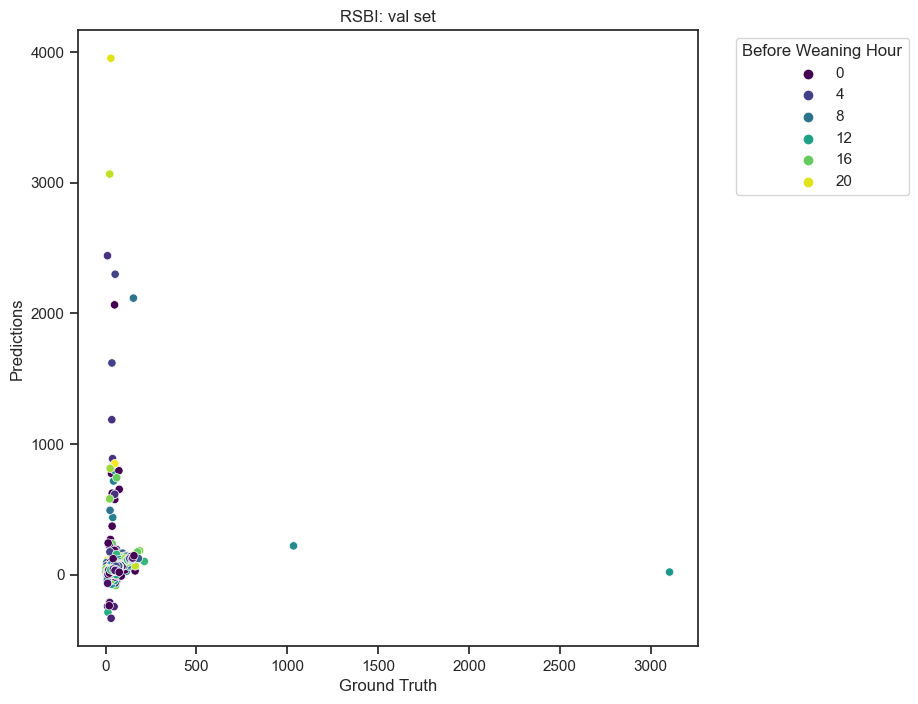

test set Mean Squared Error (MSE): 44086.6201
test set Mean Absolute Error (MAE): 21.1476
test set R-squared (R2): 0.2057



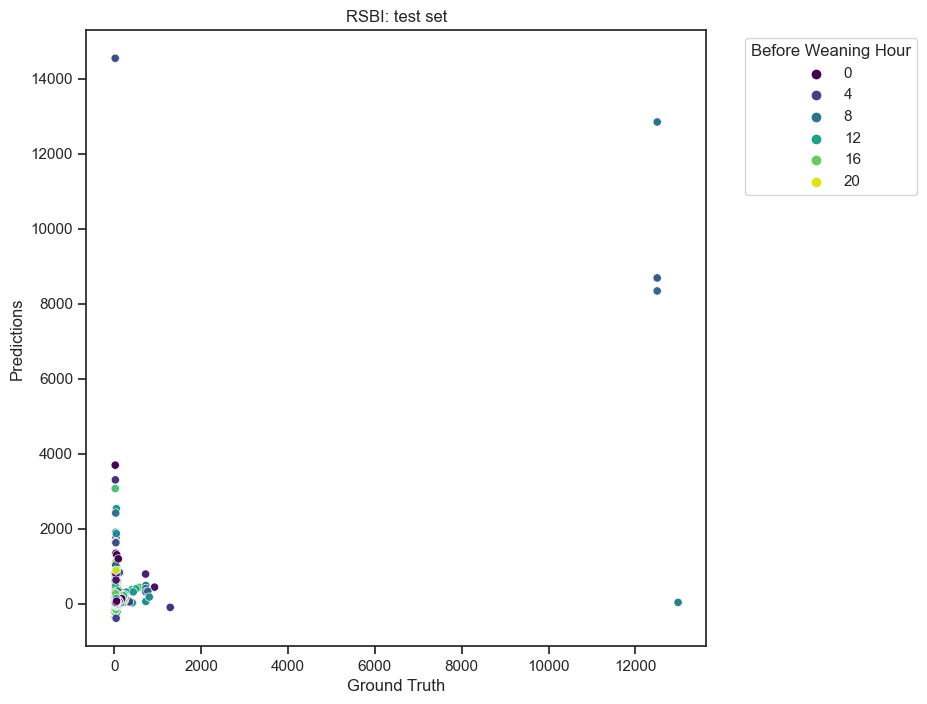

===== feature: minute_ventilation =====
train set Mean Squared Error (MSE): 3.5295
train set Mean Absolute Error (MAE): 1.3134
train set R-squared (R2): 0.7264



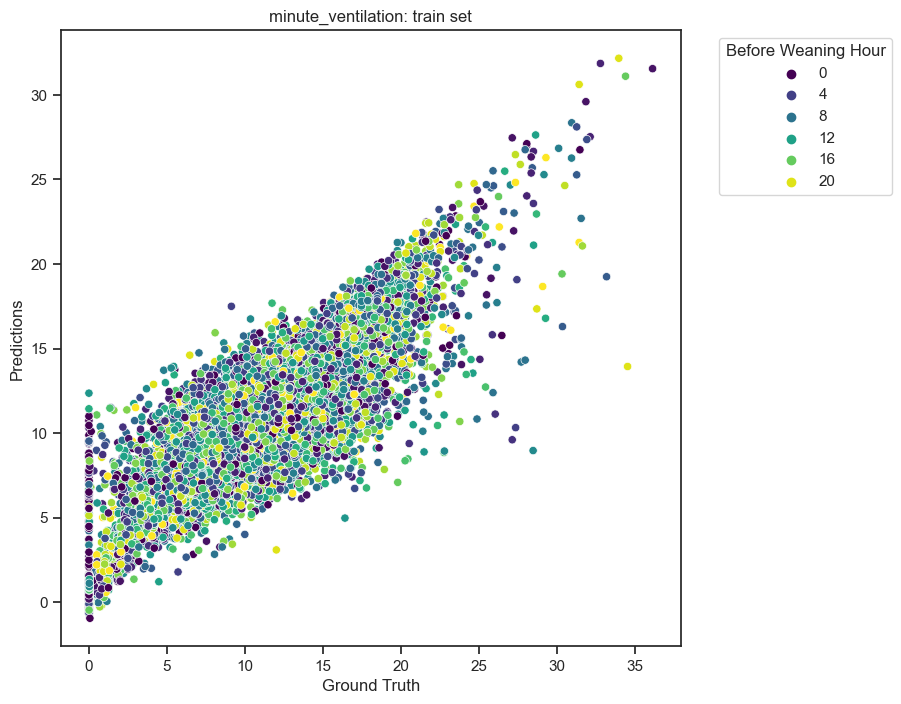

val set Mean Squared Error (MSE): 5.7898
val set Mean Absolute Error (MAE): 1.6486
val set R-squared (R2): 0.5144



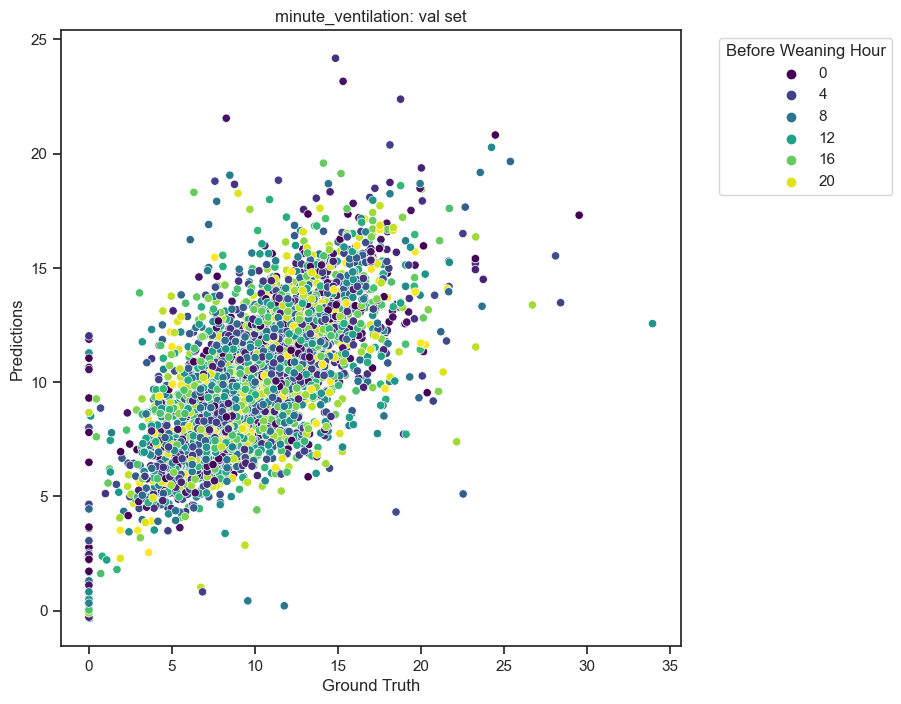

test set Mean Squared Error (MSE): 6.2392
test set Mean Absolute Error (MAE): 1.7014
test set R-squared (R2): 0.5388



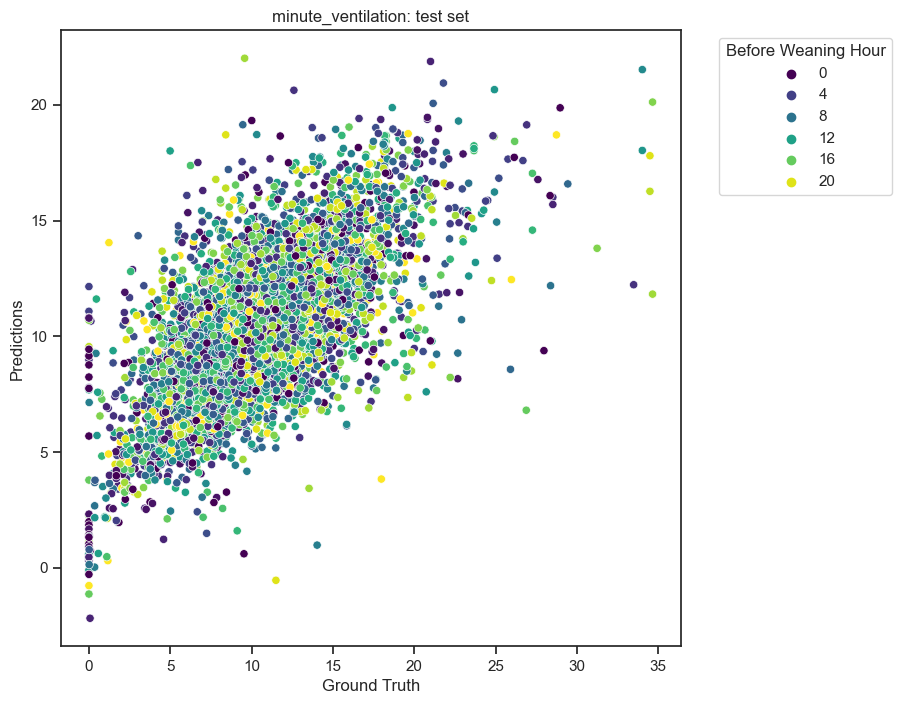

In [564]:
model_B_feature_columns = ['before_weaning_hr', 'age_now', 'weight_kg', 'height_cm', 'tobacco', # 'gender', 
          'peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure',
          'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h',
          'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h',
          'mbp_prev_1h', 'spo2_prev_1h', 'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h',
          'heart_rate_prev_2h', 'sbp_prev_2h', 'dbp_prev_2h',
          'mbp_prev_2h', 'spo2_prev_2h', 'resp_rate_prev_2h', 'tidal_volume_observed_prev_2h', 'RSBI_prev_2h', 'minute_ventilation_prev_2h']
for feature in vitalsign:
    print(f'===== feature: {feature} =====')
    model_B_inference(group_pre_2hr_visi_vese_train_df, model_B_dict, feature, model_B_feature_columns, 'train set')
    model_B_inference(group_pre_2hr_visi_vese_val_df, model_B_dict, feature, model_B_feature_columns, 'val set')
    model_B_inference(group_pre_2hr_visi_vese_test_df, model_B_dict, feature, model_B_feature_columns, 'test set')

In [269]:
model_B_feature_columns = ['before_weaning_hr', 'age_now', 'weight_kg', 'height_cm', 'tobacco', # 'gender', 
          'peep', 'fio2', 'respiratory_rate_set', 'plateau_pressure',
          'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h',
          'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h',
          'mbp_prev_1h', 'spo2_prev_1h', 'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h',
          'heart_rate_prev_2h', 'sbp_prev_2h', 'dbp_prev_2h',
          'mbp_prev_2h', 'spo2_prev_2h', 'resp_rate_prev_2h', 'tidal_volume_observed_prev_2h', 'RSBI_prev_2h', 'minute_ventilation_prev_2h']
for feature in vitalsign:
    print(f'===== feature: {feature} =====')
    model_B_inference(group_pre_2hr_visi_vese_train_df, model_B_dict, feature, model_B_feature_columns, 'train set')
    model_B_inference(group_pre_2hr_visi_vese_val_df, model_B_dict, feature, model_B_feature_columns, 'val set')
    model_B_inference(group_pre_2hr_visi_vese_test_df, model_B_dict, feature, model_B_feature_columns, 'test set')

===== feature: heart_rate =====
----- whole set -----
whole set Mean Squared Error (MSE): 54.0094
whole set Mean Absolute Error (MAE): 4.9582
whole set R-squared (R2): 0.8379

----- positive label -----
positive label Mean Squared Error (MSE): 54.4959
positive label Mean Absolute Error (MAE): 5.0320
positive label R-squared (R2): 0.8261

----- negative label -----
negative label Mean Squared Error (MSE): 53.1617
negative label Mean Absolute Error (MAE): 4.8295
negative label R-squared (R2): 0.8518

===== feature: sbp =====
----- whole set -----


whole set Mean Squared Error (MSE): 178.0720
whole set Mean Absolute Error (MAE): 9.7045
whole set R-squared (R2): 0.6524

----- positive label -----
positive label Mean Squared Error (MSE): 182.9524
positive label Mean Absolute Error (MAE): 9.8470
positive label R-squared (R2): 0.6161

----- negative label -----
negative label Mean Squared Error (MSE): 169.5677
negative label Mean Absolute Error (MAE): 9.4562
negative label R-squared (R2): 0.6956

===== feature: dbp =====
----- whole set -----
whole set Mean Squared Error (MSE): 65.8016
whole set Mean Absolute Error (MAE): 5.6472
whole set R-squared (R2): 0.6659

----- positive label -----
positive label Mean Squared Error (MSE): 68.0276
positive label Mean Absolute Error (MAE): 5.7672
positive label R-squared (R2): 0.6454

----- negative label -----
negative label Mean Squared Error (MSE): 61.9228
negative label Mean Absolute Error (MAE): 5.4381
negative label R-squared (R2): 0.6883

===== feature: mbp =====
----- whole set -----
who

## Save model dictionary in pickle files

In [394]:
model_A_dict

{'peep': {'classifier': XGBClassifier(base_score=None, booster=None, callbacks=None,
                colsample_bylevel=None, colsample_bynode=None,
                colsample_bytree=0.9, early_stopping_rounds=None,
                enable_categorical=False, eval_metric=None, feature_types=None,
                gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
                interaction_constraints=None, learning_rate=0.1, max_bin=None,
                max_cat_threshold=None, max_cat_to_onehot=None,
                max_delta_step=None, max_depth=4, max_leaves=None,
                min_child_weight=None, missing=nan, monotone_constraints=None,
                n_estimators=300, n_jobs=None, num_parallel_tree=None,
                predictor=None, random_state=None, ...),
  'regressor': MLPRegressor(hidden_layer_sizes=(100, 50), max_iter=500, random_state=42),
  'scaler_classifier': StandardScaler(),
  'scaler_regressor': StandardScaler()},
 'fio2': {'classifier': XGBClassifie

In [395]:
model_B_dict

{'heart_rate': XGBRegressor(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...),
 'sbp': XGBRegressor(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False,

In [396]:
import pickle

def save_dict_to_pickle(dictionary, file_path):
    with open(file_path, 'wb') as file:
        pickle.dump(dictionary, file)

def load_dict_from_pickle(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

In [397]:
import os
from datetime import datetime

# Get the current date in the format 'MM_DD'
date = datetime.now().strftime('%m_%d')

# Create the full path for the date folder
date_folder_path = os.path.join('./model', date)

# Check if the folder already exists
if not os.path.exists(date_folder_path):
    # If not, create the folder
    os.makedirs(date_folder_path)
    print(f"Folder created: {date_folder_path}")
else:
    print(f"Folder already exists: {date_folder_path}")

# Construct file paths for model A and model B dictionaries
model_A_dict_file_path = os.path.join(date_folder_path, 'model_A_dict.pkl')
model_B_dict_file_path = os.path.join(date_folder_path, 'model_B_dict.pkl')


save_dict_to_pickle(model_A_dict, model_A_dict_file_path)
save_dict_to_pickle(model_B_dict, model_B_dict_file_path)


Folder created: ./model\12_20


In [299]:
# TODO: reload the model
model_A_dict = load_dict_from_pickle(model_A_dict_file_path)
model_B_dict = load_dict_from_pickle(model_A_dict_file_path)
# model_A_dict_reload = load_dict_from_pickle(model_A_dict_file_path)
# model_B_dict_reload = load_dict_from_pickle(model_A_dict_file_path)

In [ ]:
# for feature in ventilator_settings:
#     c = model_A_dict_reload[feature]["classifier"]
#     r = model_A_dict_reload[feature]["regressor"]
#     scaler_c = model_A_dict_reload[feature]["scaler_classifier"]
#     scaler_r = model_A_dict_reload[feature]["scaler_regressor"]

In [305]:
# X_cols = ['before_weaning_hr', 'age_now', 'weight_kg', 'height_cm', 'tobacco', # 'gender', 
#           'heart_rate', 'sbp', 'dbp', 'mbp', 'spo2', 'resp_rate', 'tidal_volume_observed', 'RSBI', 'minute_ventilation', 
#           'heart_rate_prev_1h', 'sbp_prev_1h', 'dbp_prev_1h',
#           'mbp_prev_1h', 'spo2_prev_1h', 'resp_rate_prev_1h', 'tidal_volume_observed_prev_1h', 'RSBI_prev_1h', 'minute_ventilation_prev_1h',
#           'peep_prev_1h', 'fio2_prev_1h', 'respiratory_rate_set_prev_1h', 'plateau_pressure_prev_1h']
# X_train, y_train, X_val, y_val, X_test, y_test = split_data(group_pre_1hr_visi_vese_df, X_cols, vese)

In [307]:
# model_A_dict_reload["peep"]["classifier"].predict(X_train)

array([0, 0, 0, ..., 0, 1, 1])

# pairplot

In [398]:
group_pre_1hr_visi_vese_positive_train_df[feature_columns]

,before_weaning_hr,age_now,weight_kg,height_cm,tobacco,heart_rate,sbp,dbp,mbp,spo2,resp_rate,tidal_volume_observed,RSBI,minute_ventilation,heart_rate_prev_1h,sbp_prev_1h,dbp_prev_1h,mbp_prev_1h,spo2_prev_1h,resp_rate_prev_1h,tidal_volume_observed_prev_1h,RSBI_prev_1h,minute_ventilation_prev_1h,peep_prev_1h,fio2_prev_1h,respiratory_rate_set_prev_1h,plateau_pressure_prev_1h
0,22.0,83,72.0,169.333333,0,73.0,112.0,41.0,67.0,95.0,17.0,530.0,32.075472,9.010,67.0,115.0,54.0,74.0,94.0,11.0,530.0,20.754717,5.830,5.0,40.0,10.0,17.0
1,21.0,83,72.0,169.333333,0,72.0,117.0,51.0,72.0,96.0,15.0,530.0,28.301887,7.950,73.0,112.0,41.0,67.0,95.0,17.0,530.0,32.075472,9.010,5.0,40.0,10.0,17.0
2,20.0,83,72.0,169.333333,0,73.0,123.0,50.0,74.0,95.0,15.0,530.0,28.301887,7.950,72.0,117.0,51.0,72.0,96.0,15.0,530.0,28.301887,7.950,5.0,40.0,10.0,17.0
3,19.0,83,72.0,169.333333,0,72.0,133.0,57.0,83.0,97.0,17.0,498.0,34.136546,8.466,73.0,123.0,50.0,74.0,95.0,15.0,530.0,28.301887,7.950,5.0,40.0,10.0,17.0
4,18.0,83,72.0,169.333333,0,63.0,115.0,48.0,71.0,96.0,14.0,498.0,28.112450,6.972,72.0,133.0,57.0,83.0,97.0,17.0,498.0,34.136546,8.466,5.0,40.0,10.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27181,4.0,54,134.1,185.000000,1,85.0,94.0,56.0,69.0,98.0,15.0,591.0,25.380711,8.865,91.0,115.0,67.0,82.0,97.0,25.0,591.0,42.301184,14.775,5.0,40.0,0.0,24.0
27182,3.0,54,134.1,185.000000,1,84.0,103.0,60.0,74.0,99.0,16.0,620.0,25.806452,9.920,85.0,94.0,56.0,69.0,98.0,15.0,591.0,25.380711,8.865,5.0,40.0,0.0,24.0
27183,2.0,54,134.1,185.000000,1,89.0,121.0,69.0,85.0,97.0,24.0,620.0,38.709677,14.880,84.0,103.0,60.0,74.0,99.0,16.0,620.0,25.806452,9.920,5.0,40.0,0.0,24.0
27184,1.0,54,134.1,185.000000,1,103.0,125.0,69.0,86.0,98.0,25.0,620.0,40.322581,15.500,89.0,121.0,69.0,85.0,97.0,24.0,620.0,38.709677,14.880,5.0,40.0,0.0,24.0


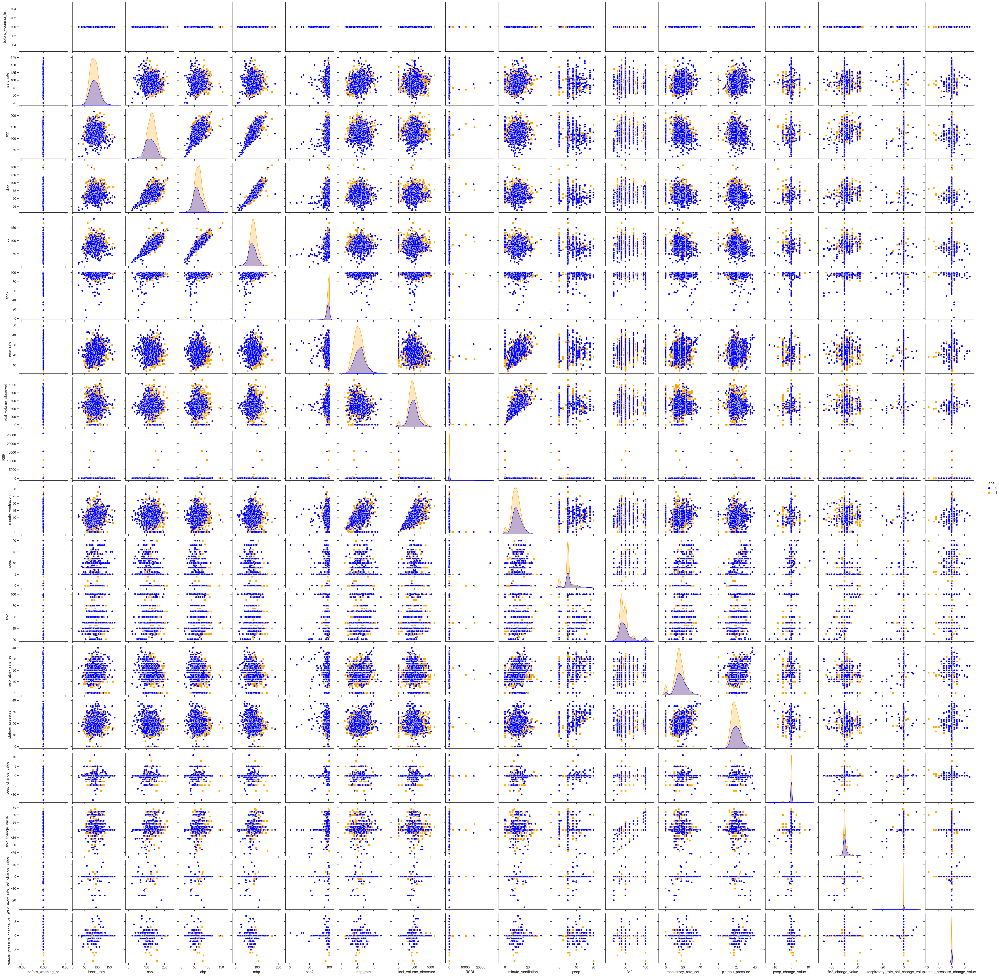

In [399]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming your DataFrame is named 'group_pre_1hr_visi_vese_positive_train_df'
# Replace 'group_pre_1hr_visi_vese_df' with the actual name of your DataFrame
# feature_columns = ["before_weaning_hr", "age_now", "gender", "insurance", "race", "first_careunit", "admission_type", "weight_kg", "height_cm", "tobacco", "heart_rate", "sbp", "dbp", "mbp", "spo2", "resp_rate", "tidal_volume_observed", "RSBI", "minute_ventilation", "peep", "fio2", "respiratory_rate_set", "plateau_pressure", "ventilator_mode", "ventilator_mode_group", "peep_change_value", "fio2_change_value", "respiratory_rate_set_change_value", "plateau_pressure_change_value"]
# feature_columns = ["label", "before_weaning_hr", "heart_rate", "sbp", "dbp", "mbp", "spo2", "resp_rate", "tidal_volume_observed", "RSBI", "minute_ventilation", "peep", "fio2", "respiratory_rate_set", "plateau_pressure", "ventilator_mode", "ventilator_mode_group", "peep_change_value", "fio2_change_value", "respiratory_rate_set_change_value", "plateau_pressure_change_value"]
feature_columns = ["label", "before_weaning_hr", "heart_rate", "sbp" , "dbp", "mbp", "spo2", "resp_rate", "tidal_volume_observed", "RSBI", "minute_ventilation", "peep", "fio2", "respiratory_rate_set", "plateau_pressure", "ventilator_mode", "ventilator_mode_group", "peep_change_value", "fio2_change_value", "respiratory_rate_set_change_value", "plateau_pressure_change_value"]
# Select relevant columns for pairplot (excluding non-numeric and identifier columns)
# df = group_pre_1hr_visi_vese_df[feature_columns]
# numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns
# plot_data = df[numeric_columns + ['label']]
concat_df = pd.concat([group_pre_1hr_visi_vese_positive_train_df, group_pre_1hr_visi_vese_negative_train_df], axis=0)
filter_df = concat_df[concat_df["before_weaning_hr"] == 0]
# Set style
sns.set(style="ticks")

# Create pairplot
sns.pairplot(filter_df[feature_columns], hue='label', markers=["o", "s"], palette={0: 'blue', 1: 'orange'})
plt.show()


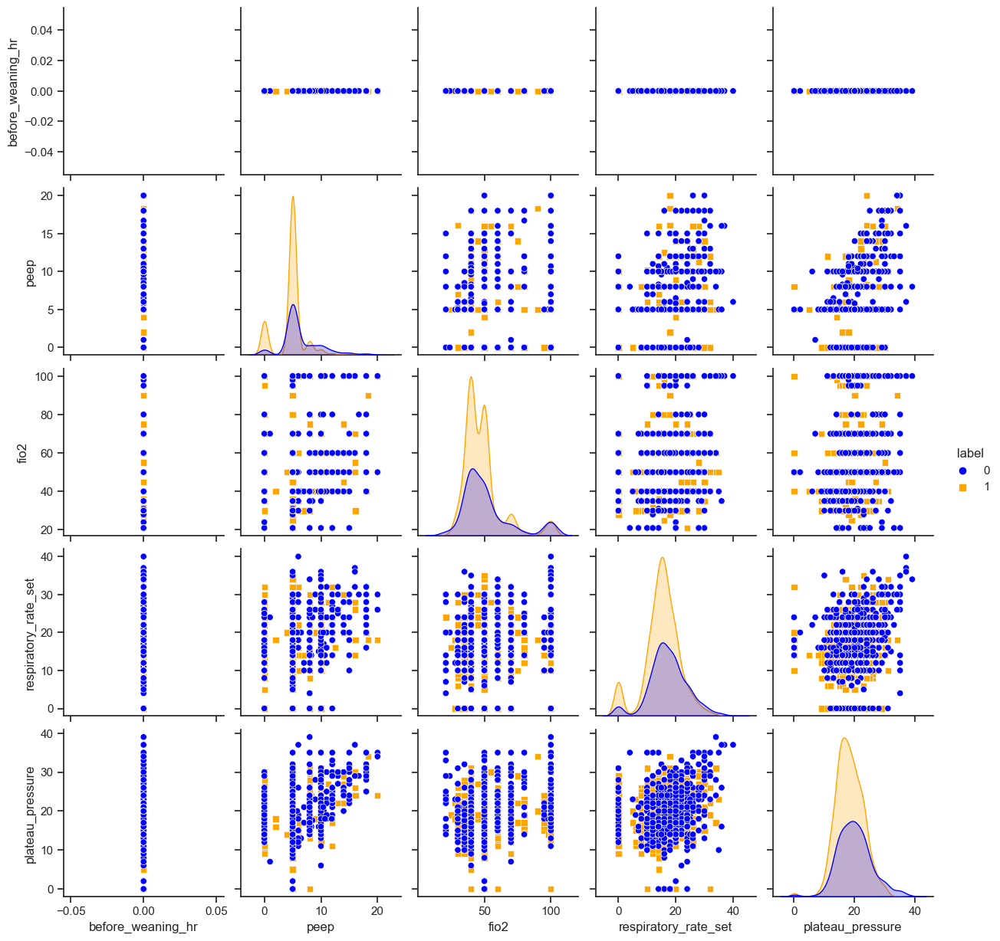

In [400]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming your DataFrame is named 'group_pre_1hr_visi_vese_df'
# Replace 'group_pre_1hr_visi_vese_df' with the actual name of your DataFrame
# feature_columns = ["before_weaning_hr", "age_now", "gender", "insurance", "race", "first_careunit", "admission_type", "weight_kg", "height_cm", "tobacco", "heart_rate", "sbp", "dbp", "mbp", "spo2", "resp_rate", "tidal_volume_observed", "RSBI", "minute_ventilation", "peep", "fio2", "respiratory_rate_set", "plateau_pressure", "ventilator_mode", "ventilator_mode_group", "peep_change_value", "fio2_change_value", "respiratory_rate_set_change_value", "plateau_pressure_change_value"]
# feature_columns = ["label", "before_weaning_hr", "heart_rate", "sbp", "dbp", "mbp", "spo2", "resp_rate", "tidal_volume_observed", "RSBI", "minute_ventilation", "peep", "fio2", "respiratory_rate_set", "plateau_pressure", "ventilator_mode", "ventilator_mode_group", "peep_change_value", "fio2_change_value", "respiratory_rate_set_change_value", "plateau_pressure_change_value"]
feature_columns = ["label", "before_weaning_hr", "peep", "fio2", "respiratory_rate_set", "plateau_pressure", "ventilator_mode", "ventilator_mode_group"]
# Select relevant columns for pairplot (excluding non-numeric and identifier columns)
# df = group_pre_1hr_visi_vese_df[feature_columns]
# numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns
# plot_data = df[numeric_columns + ['label']]
concat_df = pd.concat([group_pre_1hr_visi_vese_positive_train_df, group_pre_1hr_visi_vese_negative_train_df], axis=0)
filter_df = concat_df[concat_df["before_weaning_hr"] == 0]
# Set style
sns.set(style="ticks")

# Create pairplot
sns.pairplot(filter_df[feature_columns], hue='label', markers=["o", "s"], palette={0: 'blue', 1: 'orange'})
plt.show()
